In [1]:
import torch
import torch.nn as nn
import time
import argparse

import os
import datetime

from torch.distributions.categorical import Categorical

# visualization 
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

device = torch.device("cpu"); gpu_id = -1 # select CPU

gpu_id = '0' # select a single GPU  
#gpu_id = '2,3' # select multiple GPUs  
os.environ["CUDA_VISIBLE_DEVICES"] = str(gpu_id)  
if torch.cuda.is_available():
    device = torch.device("cuda")
    print('GPU name: {:s}, gpu_id: {:s}'.format(torch.cuda.get_device_name(0),gpu_id))   
    
print(device)
print('pytorch version = ',torch.__version__)

GPU name: NVIDIA GeForce RTX 2080 Ti, gpu_id: 0
cuda
pytorch version =  1.10.0


In [2]:
import math
import numpy as np
import torch.nn.functional as F
import random
import torch.optim as optim
from torch.autograd import Variable
from torch.optim import lr_scheduler
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
class TransEncoderNet(nn.Module):
    """
    Encoder network based on self-attention transformer
    Inputs :  
      h of size      (bsz, nb_nodes, dim_emb)    batch of input cities
    Outputs :  
      h of size      (bsz, nb_nodes, dim_emb)    batch of encoded cities
      score of size  (bsz, nb_nodes, nb_nodes+1) batch of attention scores
    """
    
    def __init__(self, nb_layers, dim_emb, nb_heads, dim_ff, batchnorm):
        super(TransEncoderNet, self).__init__()
        assert dim_emb == nb_heads* (dim_emb//nb_heads) # check if dim_emb is divisible by nb_heads
        self.MHA_layers = nn.ModuleList( [nn.MultiheadAttention(dim_emb, nb_heads) for _ in range(nb_layers)] )
        self.linear1_layers = nn.ModuleList( [nn.Linear(dim_emb, dim_ff) for _ in range(nb_layers)] )
        self.linear2_layers = nn.ModuleList( [nn.Linear(dim_ff, dim_emb) for _ in range(nb_layers)] )   
        if batchnorm:
            self.norm1_layers = nn.ModuleList( [nn.BatchNorm1d(dim_emb) for _ in range(nb_layers)] )
            self.norm2_layers = nn.ModuleList( [nn.BatchNorm1d(dim_emb) for _ in range(nb_layers)] )
        else:
            self.norm1_layers = nn.ModuleList( [nn.LayerNorm(dim_emb) for _ in range(nb_layers)] )
            self.norm2_layers = nn.ModuleList( [nn.LayerNorm(dim_emb) for _ in range(nb_layers)] )
        self.nb_layers = nb_layers
        self.nb_heads = nb_heads
        self.batchnorm = batchnorm
        
    def forward(self, h):      
        # PyTorch nn.MultiheadAttention requires input size (seq_len, bsz, dim_emb) 
        h = h.transpose(0,1) # size(h)=(nb_nodes, bsz, dim_emb)  
        # L layers
        for i in range(self.nb_layers):
            h_rc = h # residual connection, size(h_rc)=(nb_nodes, bsz, dim_emb)
            h, score = self.MHA_layers[i](h, h, h) # size(h)=(nb_nodes, bsz, dim_emb), size(score)=(bsz, nb_nodes, nb_nodes)
            # add residual connection
            
            h = h_rc + h # size(h)=(nb_nodes, bsz, dim_emb)
            if self.batchnorm:
                # Pytorch nn.BatchNorm1d requires input size (bsz, dim, seq_len)
                h = h.permute(1,2,0).contiguous() # size(h)=(bsz, dim_emb, nb_nodes)
                h = self.norm1_layers[i](h)       # size(h)=(bsz, dim_emb, nb_nodes)
                h = h.permute(2,0,1).contiguous() # size(h)=(nb_nodes, bsz, dim_emb)
            else:
                h = self.norm1_layers[i](h)       # size(h)=(nb_nodes, bsz, dim_emb) 
            # feedforward
            h_rc = h # residual connection
            h = self.linear2_layers[i](torch.relu(self.linear1_layers[i](h)))
            h = h_rc + h # size(h)=(nb_nodes, bsz, dim_emb)
            if self.batchnorm:
                h = h.permute(1,2,0).contiguous() # size(h)=(bsz, dim_emb, nb_nodes)
                h = self.norm2_layers[i](h)       # size(h)=(bsz, dim_emb, nb_nodes)
                h = h.permute(2,0,1).contiguous() # size(h)=(nb_nodes, bsz, dim_emb)
            else:
                h = self.norm2_layers[i](h) # size(h)=(nb_nodes, bsz, dim_emb)
        # Transpose h
        h = h.transpose(0,1) # size(h)=(bsz, nb_nodes, dim_emb)
        return h, score
    

class Attention(nn.Module):
    def __init__(self, n_hidden):
        super(Attention, self).__init__()
        self.size = 0
        self.batch_size = 0
        self.dim = n_hidden
        
        v  = torch.FloatTensor(n_hidden)
        self.v  = nn.Parameter(v)
        self.v.data.uniform_(-1/math.sqrt(n_hidden), 1/math.sqrt(n_hidden))
        
        # parameters for pointer attention
        self.Wref = nn.Linear(n_hidden, n_hidden)
        self.Wq = nn.Linear(n_hidden, n_hidden)
    
    
    def forward(self, q, ref):       # query and reference
        self.batch_size = q.size(0)
        self.size = int(ref.size(0) / self.batch_size)
        q = self.Wq(q)     # (B, dim)
        ref = self.Wref(ref)
        ref = ref.view(self.batch_size, self.size, self.dim)  # (B, size, dim)
        
        q_ex = q.unsqueeze(1).repeat(1, self.size, 1) # (B, size, dim)
        # v_view: (B, dim, 1)
        v_view = self.v.unsqueeze(0).expand(self.batch_size, self.dim).unsqueeze(2)
        
        # (B, size, dim) * (B, dim, 1)
        u = torch.bmm(torch.tanh(q_ex + ref), v_view).squeeze(2)
        
        return u, ref
    
class LSTM(nn.Module):
    def __init__(self, n_hidden):
        super(LSTM, self).__init__()
        
        # parameters for input gate
        self.Wxi = nn.Linear(n_hidden, n_hidden)    # W(xt)
        self.Whi = nn.Linear(n_hidden, n_hidden)    # W(ht)
        self.wci = nn.Linear(n_hidden, n_hidden)    # w(ct)
        
        # parameters for forget gate
        self.Wxf = nn.Linear(n_hidden, n_hidden)    # W(xt)
        self.Whf = nn.Linear(n_hidden, n_hidden)    # W(ht)
        self.wcf = nn.Linear(n_hidden, n_hidden)    # w(ct)
        
        # parameters for cell gate
        self.Wxc = nn.Linear(n_hidden, n_hidden)    # W(xt)
        self.Whc = nn.Linear(n_hidden, n_hidden)    # W(ht)
        
        # parameters for forget gate
        self.Wxo = nn.Linear(n_hidden, n_hidden)    # W(xt)
        self.Who = nn.Linear(n_hidden, n_hidden)    # W(ht)
        self.wco = nn.Linear(n_hidden, n_hidden)    # w(ct)
    
    
    def forward(self, x, h, c):       # query and reference
        
        # input gate
        i = torch.sigmoid(self.Wxi(x) + self.Whi(h) + self.wci(c))
        # forget gate
        f = torch.sigmoid(self.Wxf(x) + self.Whf(h) + self.wcf(c))
        # cell gate
        c = f * c + i * torch.tanh(self.Wxc(x) + self.Whc(h))
        # output gate
        o = torch.sigmoid(self.Wxo(x) + self.Who(h) + self.wco(c))
        
        h = o * torch.tanh(c)
        
        return h, c

class HPN(nn.Module):
    def __init__(self, n_feature, n_hidden):

        super(HPN, self).__init__()
        self.city_size = 0
        self.batch_size = 0
        self.dim = n_hidden
        
        # lstm for first turn
        #self.lstm0 = nn.LSTM(n_hidden, n_hidden)main_training - Jupyter Notebook
        
        # pointer layer
        self.pointer = Attention(n_hidden)
        self.TransPointer = Attention(n_hidden)
        
        # lstm encoder
        self.encoder = LSTM(n_hidden)
        
        # trainable first hidden input
        h0 = torch.FloatTensor(n_hidden)
        c0 = torch.FloatTensor(n_hidden)
        # trainable latent variable coefficient
        print('here') 
        alpha = torch.ones(1)
        self.h0 = nn.Parameter(h0)
        self.c0 = nn.Parameter(c0)
        
        self.alpha = nn.Parameter(alpha)
        self.h0.data.uniform_(-1/math.sqrt(n_hidden), 1/math.sqrt(n_hidden))
        self.c0.data.uniform_(-1/math.sqrt(n_hidden), 1/math.sqrt(n_hidden))
        
        r1 = torch.ones(1)
        r2 = torch.ones(1)
        r3 = torch.ones(1)
        self.r1 = nn.Parameter(r1)
        self.r2 = nn.Parameter(r2)
        self.r3 = nn.Parameter(r3)
        
        # embedding
        self.embedding_x = nn.Linear(n_feature, n_hidden)
        self.embedding_all = nn.Linear(n_feature, n_hidden)
        self.Transembedding_all = TransEncoderNet(6, 128, 8, 512, batchnorm=True)#6,128,8,512
        
        # vector to start decoding 
        self.start_placeholder = nn.Parameter(torch.randn(n_hidden))
        
        # weights for GNN
        self.W1 = nn.Linear(n_hidden, n_hidden)
        self.W2 = nn.Linear(n_hidden, n_hidden)
        self.W3 = nn.Linear(n_hidden, n_hidden)
        
        # aggregation function for GNN
        self.agg_1 = nn.Linear(n_hidden, n_hidden)
        self.agg_2 = nn.Linear(n_hidden, n_hidden)
        self.agg_3 = nn.Linear(n_hidden, n_hidden)
    
    
    def forward(self,context,Transcontext, x, X_all, mask,if_check_u, h=None, c=None, latent=None):
        '''
        Inputs (B: batch size, size: city size, dim: hidden dimension)
        
        x: current city coordinate (B, 2)
        X_all: all cities' cooridnates (B, size, 2)
        mask: mask visited cities
        h: hidden variable (B, dim)
        c: cell gate (B, dim)
        latent: latent pointer vector from previous layer (B, size, dim)
        
        Outputs
        
        softmax: probability distribution of next city (B, size)
        h: hidden variable (B, dim)
        c: cell gate (B, dim)
        latent_u: latent pointer vector for next layer
        '''
        
        self.batch_size = X_all.size(0)
        self.city_size = X_all.size(1)
        # Check if this the first iteration loop
        if h is None or c is None:
            x          = self.start_placeholder  
            context = self.embedding_all(X_all)
            Transcontext,_ = self.Transembedding_all(context)
            
            # =============================
            # graph neural network encoder
            # =============================

            # (B, size, dim)
            Transcontext = Transcontext.reshape(-1, self.dim)

            h0 = self.h0.unsqueeze(0).expand(self.batch_size, self.dim)
            c0 = self.c0.unsqueeze(0).expand(self.batch_size, self.dim)

            h0 = h0.unsqueeze(0).contiguous()
            c0 = c0.unsqueeze(0).contiguous()
            
            # let h0, c0 be the hidden variable of first turn
            h = h0.squeeze(0)
            c = c0.squeeze(0)
        else:
            x          = self.embedding_x(x)
        # LSTM encoder1900/2500
        h, c = self.encoder(x, h, c)
        # query vector
        q = h
        # pointer
        u2 ,_ = self.TransPointer(q, Transcontext)
        # Avg Agg between the two attention vector
        u = u2
        latent_u = u.clone()
        if if_check_u is True:
            print(latent_u[0])
        u = 10 * torch.tanh(u)
        u = u + mask
        return context, Transcontext,F.softmax(u, dim=1), h, c, latent_u
# params= list(HPN(n_feature = 2, n_hidden = 128).parameters())
# print(len(params))
# for name,parameters in HPN(n_feature = 2, n_hidden = 128).named_parameters():
#     print(name,':',parameters.size())

In [3]:
#test network 
Actor = HPN(n_feature = 2, n_hidden = 128)
print(Actor)
nb_param = 0
for param in Actor.parameters():
    nb_param += np.prod(list(param.data.size()))
print('Number of parameters:', nb_param)

here
HPN(
  (pointer): Attention(
    (Wref): Linear(in_features=128, out_features=128, bias=True)
    (Wq): Linear(in_features=128, out_features=128, bias=True)
  )
  (TransPointer): Attention(
    (Wref): Linear(in_features=128, out_features=128, bias=True)
    (Wq): Linear(in_features=128, out_features=128, bias=True)
  )
  (encoder): LSTM(
    (Wxi): Linear(in_features=128, out_features=128, bias=True)
    (Whi): Linear(in_features=128, out_features=128, bias=True)
    (wci): Linear(in_features=128, out_features=128, bias=True)
    (Wxf): Linear(in_features=128, out_features=128, bias=True)
    (Whf): Linear(in_features=128, out_features=128, bias=True)
    (wcf): Linear(in_features=128, out_features=128, bias=True)
    (Wxc): Linear(in_features=128, out_features=128, bias=True)
    (Whc): Linear(in_features=128, out_features=128, bias=True)
    (Wxo): Linear(in_features=128, out_features=128, bias=True)
    (Who): Linear(in_features=128, out_features=128, bias=True)
    (wco): Lin

# daniel rectangle feature handle

In [4]:
'''
This part I designed the rectangle-characterized TSP, that means for every step the agent walk through a corner,
then he travel through the whole rectangle using zig-zag, finally he ends up at one of the rest corners of 
the rextangle, so, it equals the agent walk through three points at one step, in practice, I add three points into 
mask to make them unselectable.
'''
def rectangle_process(temp,idx,Y,Y0,mask,k,B,i,path_gazebo,if_actor):
    Y1 = Y[zero_to_bsz, idx.data].clone()
    rectangle_inf = idx/4
    feature_table = temp.outcorner_getout(rectangle_inf,B,mask_list_num)
    feature_table = torch.Tensor(feature_table).type(torch.long)
    if torch.cuda.is_available():
        feature_table = feature_table.cuda()
    else:
        feature_table = feature_table
    Y_corner = Y[zero_to_bsz, feature_table[:,0].data].clone()
    if (i % 100 == 0)and(if_actor):
        path_gazebo.append([idx.data[0].tolist(),feature_table[:,0].data[0].tolist()])
    if k ==0:
        if torch.cuda.is_available():
            reward = torch.zeros(B).cuda()
        else:
            reward = torch.zeros(B)
    if k > 0:
        reward = torch.sum((Y1[:,(0,1)] - Y0[:,(0,1)])**2 , dim=1 )**0.5
        reward += torch.sum((Y_corner[:,(0,1)] - Y1[:,(0,1)])**2 , dim=1 )**0.5
        #dis = (Y1 - Y0)**2
        #dis_1 = (Y_corner - Y1)**2
        #reward = torch.maximum(dis[:,0],dis[:,1])**0.5
        #reward += torch.maximum(dis_1[:,0],dis_1[:,1])**0.5  
    mask[zero_to_bsz, idx.data] += -np.inf
    mask[zero_to_bsz, feature_table[:,0].data] += -np.inf
    mask[zero_to_bsz, feature_table[:,1].data ] += -np.inf    
    mask[zero_to_bsz, feature_table[:,2].data ] += -np.inf
    return reward, Y_corner, Y_corner

In [5]:
import torch
import numpy as np
from listofpathpoint import input_handler
import cnc_input
import copy
import json
def produce_random_data(boundry_recs, randomseed):
    for i in range(0,len(boundry_recs),4):
        np.random.seed(randomseed)
        width = boundry_recs[i+2][0] - boundry_recs[i][0]
        length = boundry_recs[i+2][1] - boundry_recs[i][1]
        original_x,original_y = boundry_recs[i][0].clone(), boundry_recs[i][1].clone()
        points_x = np.random.choice(int(width),2,replace=False)
        points_y = np.random.choice(int(length),2,replace=False)
        points_x.sort()
        points_y.sort()
        boundry_recs[i][0],boundry_recs[i][1] = (original_x + points_x[0]), (original_y + points_y[0])
        boundry_recs[i+1][0],boundry_recs[i+1][1] = (original_x + points_x[1]), (original_y + points_y[0])
        boundry_recs[i+2][0],boundry_recs[i+2][1] = (original_x + points_x[1]), (original_y + points_y[1])
        boundry_recs[i+3][0],boundry_recs[i+3][1] = (original_x + points_x[0]), (original_y + points_y[1])
    return boundry_recs
def random_data_generator(origin_recs, batch_size):
    result_X = torch.Tensor([])
    for seed in range(batch_size):
        temp_recs = origin_recs.clone()
        temp_x = produce_random_data(temp_recs,seed)
        result_X = torch.cat((result_X, temp_x),0)
    result_X = result_X.reshape(batch_size,-1,temp_x.size(1))
    return result_X

# test = input_handler('10&15data/25_chips/25_general.json')
# X_temp, mask_list_num = test.final_ver_points()
# X_temp = torch.FloatTensor(X_temp)
# result = produce_random_data(X_temp,2)
# result_1 = produce_random_data(X_temp,2)
# now we have the produce_random_data, to produce single random data, but we need a batch of data...
# X_result = random_data_generator(X_temp, 128)
# for map_num in range(128):
#     gluewidth =[[354.0,320.0],[354.0,331.0],[387.0,330.0],[387.0,320.0]]
#     d = {
#     "version": "4.6.0",
#     "flags": {},
#     "shapes": [{"label":"gluewidth","points":gluewidth}]
#     }
#     for i in range(25):
#         dict = {}
#         dict["label"] = str(i)
#         dict["points"] = X_result[map_num][:,(0,1)][4*i:4*i+4].tolist()
#         d["shapes"].append(dict)

#     with open('10&15data/25_chips/25_generate'+str(map_num)+'.json', 'w') as f:
#         json.dump(d, f)

prepare to train
Hyper parameters:
learning rate 1e-05
batch size 128
steps 2500
epoch 100
here
here
[[533, 166, 0], [633, 166, 0], [633, 152, 0], [533, 152, 0], [198, 105, 0], [236, 105, 0], [236, 80, 0], [198, 80, 0], [198, 105, 10], [236, 105, 10], [236, 80, 10], [198, 80, 10], [171, 311, 0], [213, 311, 0], [213, 280, 0], [171, 280, 0], [410, 134, 0], [436, 134, 0], [436, 122, 0], [410, 122, 0], [410, 134, 10], [436, 134, 10], [436, 122, 10], [410, 122, 10], [410, 134, 20], [436, 134, 20], [436, 122, 20], [410, 122, 20], [367, 83, 0], [384, 83, 0], [384, 71, 0], [367, 71, 0], [367, 83, 10], [384, 83, 10], [384, 71, 10], [367, 71, 10], [367, 83, 20], [384, 83, 20], [384, 71, 20], [367, 71, 20], [592, 462, 0], [687, 462, 0], [687, 450, 0], [592, 450, 0], [592, 462, 10], [687, 462, 10], [687, 450, 10], [592, 450, 10], [592, 462, 20], [687, 462, 20], [687, 450, 20], [592, 450, 20], [592, 462, 30], [687, 462, 30], [687, 450, 30], [592, 450, 30], [747, 148, 0], [777, 148, 0], [777, 131, 0

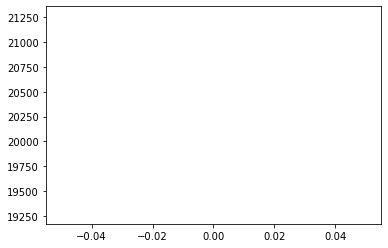

record the last path to gazebo for showing up


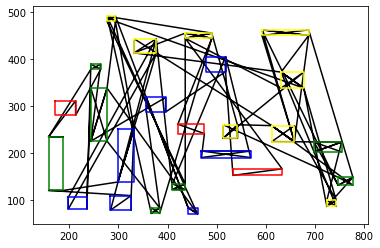

tensor([13., 14., 20.,  6., 20., 23., 13.,  6., 20., 23.,  5.,  6., 13.,  8.,
         5., 14.,  5.,  8.,  0., 20., 23., 14., 14.,  8., 21., 23., 17.,  7.,
        22.,  5., 12., 17., 21.,  4., 15.,  8., 22., 17., 11., 17.,  3.,  7.,
        11.,  3.,  3., 16., 12.,  2.,  7., 18.,  4., 18., 24., 12., 24.,  4.,
        12.,  7.,  9., 19., 10., 16., 10., 24., 19., 18.,  9.,  1.,  1.,  9.],
       device='cuda:0')
epoch:0, batch:200/2500, reward:18894.6015625


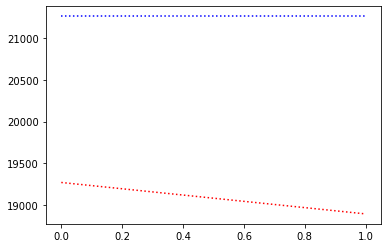

record the last path to gazebo for showing up


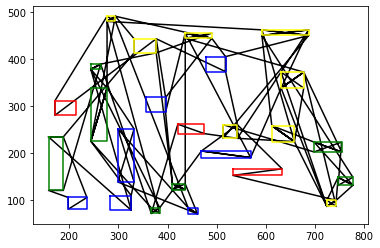

tensor([13.,  6., 20., 20., 13.,  5., 14., 20., 23., 20.,  6., 14., 14., 13.,
        21., 23.,  5., 17., 23.,  6.,  8.,  8., 14.,  8., 23., 22.,  5.,  0.,
        21.,  8.,  5., 17.,  7., 17.,  3.,  4.,  7., 15., 12., 12., 11.,  3.,
        22., 16.,  7., 17., 12., 18., 16., 24.,  4.,  7., 10.,  3., 18., 19.,
        24.,  9., 11., 18.,  2.,  9.,  4.,  1., 12.,  9.,  1., 19., 24., 10.],
       device='cuda:0')
epoch:0, batch:300/2500, reward:18730.576171875


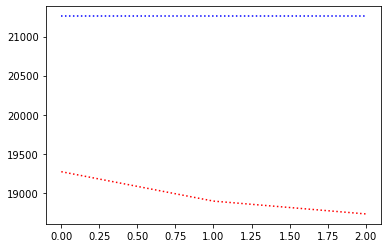

record the last path to gazebo for showing up


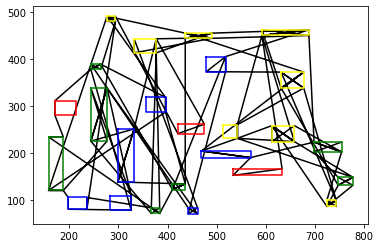

tensor([ 6., 20., 13., 20.,  5.,  6.,  8., 20., 20.,  6., 23., 14., 14., 13.,
         0., 13., 14., 23.,  5., 23., 17., 23., 21., 15.,  5., 17., 14.,  8.,
         5., 21.,  8.,  8., 17., 22.,  7., 17., 22.,  3.,  7.,  7., 12.,  3.,
        12.,  3., 11.,  4., 12., 18., 16.,  7., 10., 10.,  4., 19., 24., 18.,
        11., 12.,  9., 16., 19., 24.,  2., 24.,  9.,  4., 18.,  1.,  1.,  9.],
       device='cuda:0')
epoch:0, batch:400/2500, reward:18506.423828125


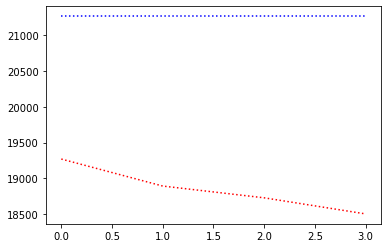

record the last path to gazebo for showing up


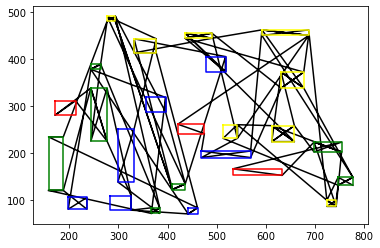

tensor([20., 13., 14., 20., 20.,  6., 23., 13., 14.,  8., 14.,  5.,  6., 23.,
        17.,  6., 13.,  3.,  5.,  8.,  8., 20., 23., 14.,  0., 23., 21.,  5.,
        17.,  5., 22., 21., 18.,  7.,  8.,  7., 12., 15.,  7.,  4., 17., 22.,
        17., 11., 12., 12., 24.,  3.,  7., 16.,  4., 18.,  3., 10., 11., 19.,
        24., 18., 10., 16.,  2.,  9.,  9., 12.,  4., 24.,  1.,  1.,  9., 19.],
       device='cuda:0')
epoch:0, batch:500/2500, reward:18423.46484375


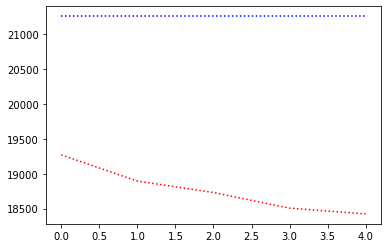

record the last path to gazebo for showing up


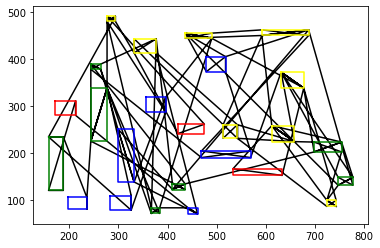

tensor([14.,  6., 14., 20., 13., 20., 13.,  6.,  6., 23.,  5., 20., 13., 23.,
         8., 21., 20., 23.,  0., 14., 14.,  5.,  8., 23., 17.,  5., 22.,  5.,
         8., 21., 15.,  7.,  7., 17., 11., 12.,  7.,  8.,  3., 17., 16.,  4.,
        22., 17., 12.,  3., 18.,  7., 11., 12., 24., 10.,  9., 18., 10.,  9.,
        12.,  2., 24.,  4., 19., 16.,  3., 18.,  4.,  9.,  1., 19.,  1., 24.],
       device='cuda:0')
epoch:0, batch:600/2500, reward:18243.396484375


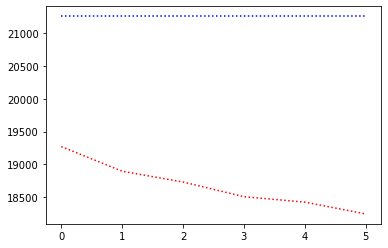

record the last path to gazebo for showing up


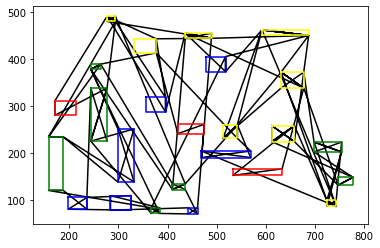

tensor([20.,  6., 20.,  6., 13.,  6., 14., 20., 13., 23.,  0., 14., 23., 14.,
        13., 20.,  8.,  8., 17., 21., 14., 23.,  5.,  5.,  8., 23.,  8.,  5.,
        22., 22.,  5.,  7., 21., 17., 17., 15., 17., 11.,  3.,  7.,  4., 16.,
         3., 12., 12.,  7., 12., 24.,  7., 18., 11., 10.,  4., 24., 18., 12.,
         2.,  4.,  3., 10., 18.,  9.,  9.,  1., 19., 16., 24.,  1.,  9., 19.],
       device='cuda:0')
epoch:0, batch:700/2500, reward:18178.251953125


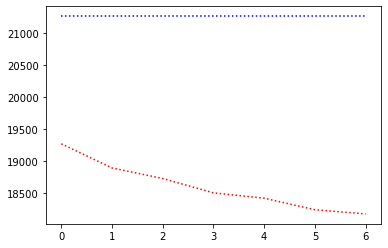

record the last path to gazebo for showing up


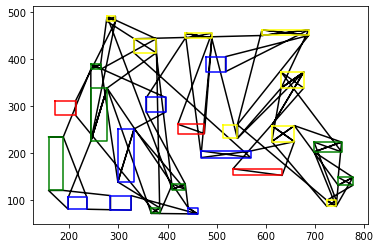

tensor([20.,  6.,  6., 20., 14., 20.,  6., 13., 13., 13., 20., 22., 23., 14.,
         8., 21., 23., 17.,  0., 23.,  5., 14.,  5., 23.,  5.,  8., 15.,  8.,
        14., 17.,  7., 12.,  5., 11., 18.,  8., 21.,  7.,  7., 24.,  3., 16.,
        17., 17., 12., 10.,  3., 22., 12., 24., 12., 18.,  4.,  4.,  9.,  7.,
         2., 19., 11., 18.,  9.,  1., 10.,  3., 24.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:0, batch:800/2500, reward:18317.93359375


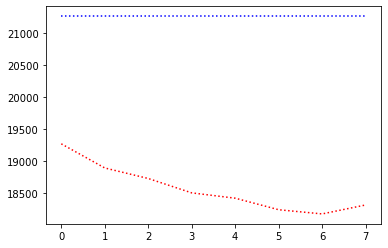

record the last path to gazebo for showing up


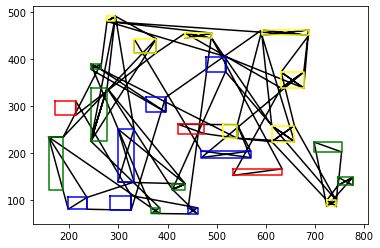

tensor([14.,  6., 20., 13., 13.,  6.,  5., 14., 23., 20., 13., 20.,  6., 20.,
         8., 23.,  0., 21., 22.,  5., 23., 14.,  7., 23.,  8.,  5.,  5., 14.,
        17.,  8., 17., 15.,  7., 17., 11., 21.,  8., 12., 18., 12.,  3., 17.,
        22., 24., 10.,  7.,  3., 16.,  7., 12., 24.,  2., 18., 11.,  4., 12.,
         9., 18.,  4.,  9., 24., 19.,  1.,  1., 16., 10.,  3.,  4.,  9., 19.],
       device='cuda:0')
epoch:0, batch:900/2500, reward:18119.14453125


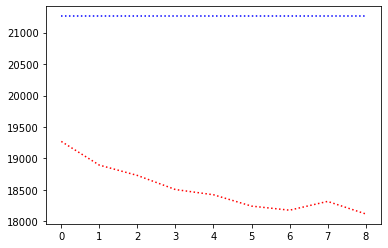

record the last path to gazebo for showing up


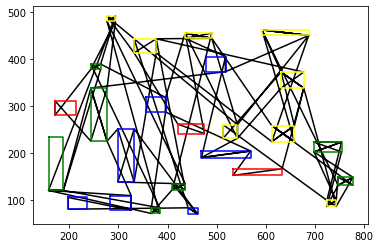

tensor([13., 20., 20.,  8., 23., 20., 20.,  6.,  6., 14.,  6., 23., 13., 14.,
        13., 14., 14.,  0.,  8., 23.,  8., 11.,  5., 23., 21., 22., 17., 15.,
         5.,  5.,  5.,  3., 11.,  7., 21.,  4.,  8., 22., 17., 12.,  3., 16.,
         7.,  7., 17., 12., 18., 17.,  4., 10., 12., 24., 24., 18.,  9.,  7.,
        12., 18.,  2.,  9., 19.,  3., 16.,  4., 24., 10.,  9.,  1.,  1., 19.],
       device='cuda:0')
epoch:0, batch:1000/2500, reward:18128.01171875


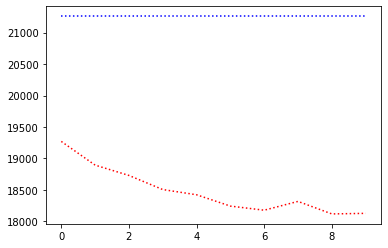

record the last path to gazebo for showing up


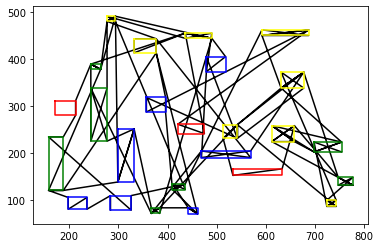

tensor([ 6., 20., 14., 20.,  8.,  6., 13., 20., 23.,  0., 14., 20., 13., 14.,
         6., 23.,  8., 13., 23., 22., 23., 14., 21.,  5.,  5., 15.,  8., 17.,
         5., 11., 17.,  7.,  5., 22., 21., 12.,  7., 16., 24.,  7.,  4., 18.,
        12.,  3., 17., 18.,  3.,  8., 12., 24., 12.,  7., 11., 10., 17.,  4.,
        18.,  2.,  9., 24., 19., 10.,  1., 19.,  9., 16.,  3.,  9.,  4.,  1.],
       device='cuda:0')
epoch:0, batch:1100/2500, reward:18006.42578125


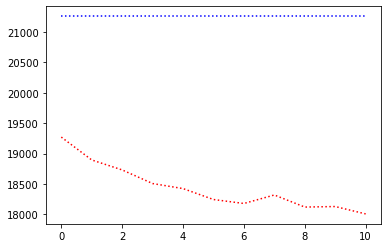

record the last path to gazebo for showing up


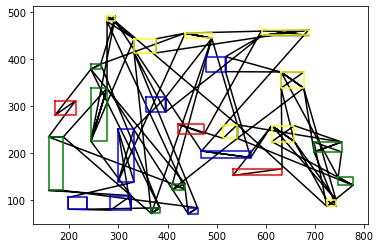

tensor([23., 20., 20.,  6., 14., 23.,  8., 14., 20., 13., 14.,  5.,  6., 23.,
         6.,  0., 13., 20.,  8., 17.,  8., 13., 17., 23.,  5., 15.,  5.,  5.,
        14., 22., 12., 21., 22.,  7.,  7., 17.,  7.,  3., 12., 11., 17., 18.,
        12., 24., 12.,  7.,  3., 18.,  8., 21., 24.,  4.,  4., 16., 10., 11.,
        18.,  2.,  9.,  1., 19., 24.,  9.,  9.,  1., 16., 10.,  4.,  3., 19.],
       device='cuda:0')
epoch:0, batch:1200/2500, reward:18123.6484375


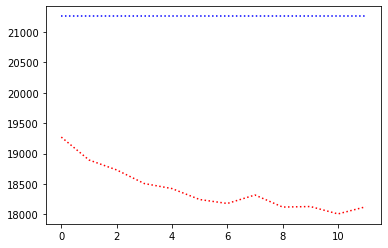

record the last path to gazebo for showing up


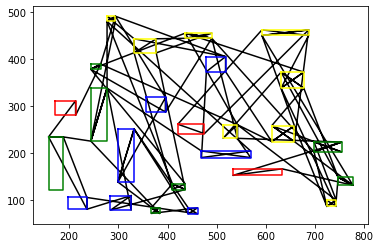

tensor([20., 13., 13., 20.,  5.,  6.,  6.,  6., 23.,  5., 20., 14., 20., 23.,
        14., 13.,  0., 21., 14.,  8., 14.,  8., 23.,  5.,  8., 23., 22.,  5.,
        17.,  7., 17., 15., 22., 21., 17., 12.,  7., 17.,  7., 11., 12., 12.,
         4.,  8.,  7., 18., 24.,  3., 12., 18., 18., 10.,  3., 16., 11., 24.,
         4.,  2., 24.,  9., 16.,  3.,  9., 10.,  4.,  1., 19., 19.,  9.,  1.],
       device='cuda:0')
epoch:0, batch:1300/2500, reward:17838.73046875


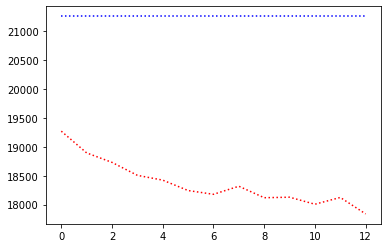

record the last path to gazebo for showing up


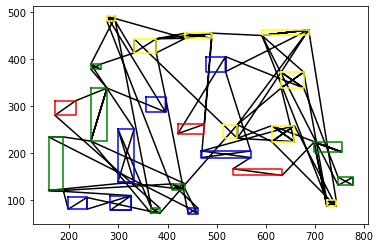

tensor([ 6., 20., 13., 23.,  6., 14., 23., 13., 13., 20.,  6., 20., 20., 14.,
         8.,  5., 14.,  0.,  5.,  8., 14., 23., 21., 23., 17., 12.,  5.,  5.,
        15., 22.,  8.,  7., 17., 11.,  7., 12., 22.,  7., 17., 24., 17., 12.,
        18.,  3., 21., 18.,  8.,  7., 24., 12., 11.,  4., 16.,  3., 10., 18.,
         2.,  9., 16.,  4.,  9., 24.,  1., 10., 19.,  1.,  9.,  4.,  3., 19.],
       device='cuda:0')
epoch:0, batch:1400/2500, reward:17518.12109375


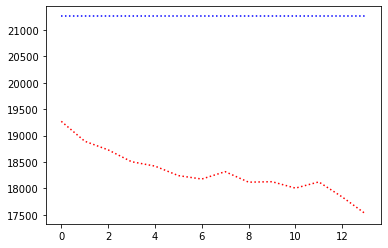

record the last path to gazebo for showing up


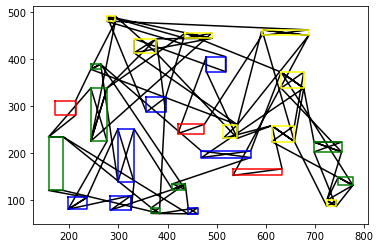

tensor([20., 20.,  6.,  5., 13., 20., 14., 13.,  6., 23., 20.,  0.,  5., 14.,
        23.,  8., 14.,  6., 13., 23., 23.,  8.,  5.,  5., 14.,  8., 17., 21.,
        22., 17., 11., 15., 12.,  7., 17., 22.,  7., 17., 12.,  8.,  2.,  7.,
        12., 16., 18.,  4., 21., 11., 18., 12.,  7.,  3., 10., 24., 24.,  3.,
        18.,  9.,  4., 24.,  9.,  9., 19.,  3., 10., 16.,  1., 19.,  1.,  4.],
       device='cuda:0')
epoch:0, batch:1500/2500, reward:17553.732421875


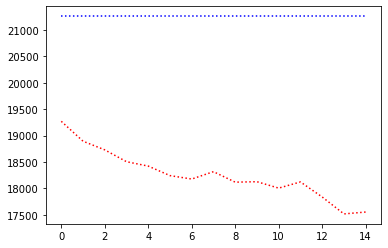

record the last path to gazebo for showing up


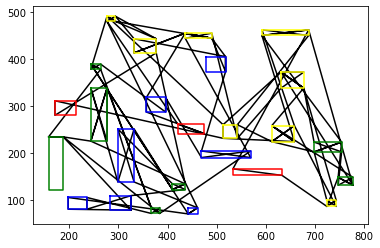

tensor([14., 13., 14.,  6.,  6., 20., 13., 20., 13., 20., 14.,  6., 20., 23.,
         8.,  0., 21.,  8.,  5., 23.,  5., 15., 14., 23.,  8.,  7., 23., 22.,
         5.,  5., 18.,  3.,  8., 11., 17., 24., 17.,  7., 17., 12., 22., 21.,
        16.,  3., 10., 19., 17., 12.,  7.,  7., 12., 12., 24.,  2.,  4., 18.,
         9., 18.,  1.,  9., 24.,  4., 11.,  3., 16., 10.,  1.,  9., 19.,  4.],
       device='cuda:0')
epoch:0, batch:1600/2500, reward:18069.814453125


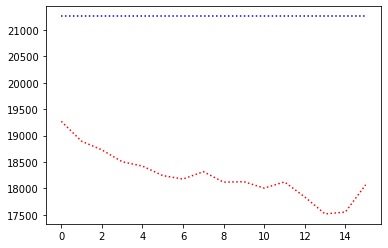

record the last path to gazebo for showing up


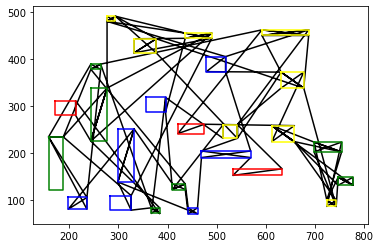

tensor([20.,  6., 14., 14.,  6., 20., 14., 21., 13.,  0., 13., 20.,  5.,  6.,
        20., 23., 14.,  8., 13., 23.,  8., 23., 15., 23.,  5., 17.,  8.,  5.,
         5.,  8., 22., 17.,  7., 17., 12., 22., 21.,  7., 11.,  7.,  7.,  3.,
        16.,  2., 17., 12., 18.,  4., 18., 12., 24., 18.,  3., 12., 11., 24.,
        10., 24.,  9.,  4., 19.,  3., 10.,  1.,  1., 16.,  9.,  4.,  9., 19.],
       device='cuda:0')
epoch:0, batch:1700/2500, reward:17899.30078125


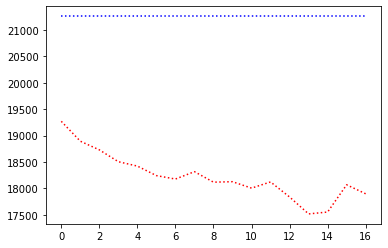

record the last path to gazebo for showing up


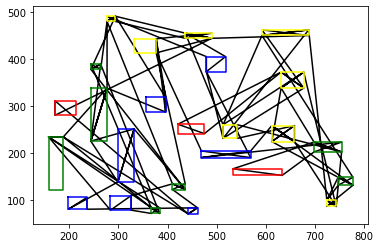

tensor([20.,  6., 13., 23., 14., 20.,  5.,  6., 14., 13., 20., 13.,  8., 20.,
         6.,  8.,  5., 14., 23.,  8.,  0., 23., 21., 23.,  7., 17., 14.,  5.,
        12., 17.,  3.,  5., 22.,  8., 21., 15., 11., 17., 22.,  7., 18., 17.,
        12., 24., 24.,  7., 18.,  4., 10., 11., 12., 12., 24.,  2.,  7., 18.,
         9.,  9., 16.,  3., 19.,  1., 19.,  3.,  4., 16.,  4., 10.,  1.,  9.],
       device='cuda:0')
epoch:0, batch:1800/2500, reward:17769.001953125


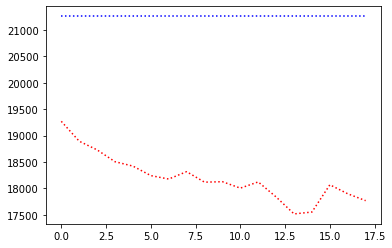

record the last path to gazebo for showing up


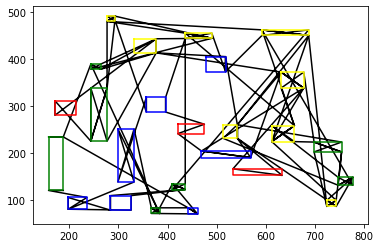

tensor([13.,  6., 20., 14., 23.,  5., 13., 20., 23., 20., 14., 23.,  6.,  8.,
         8., 20.,  5., 23., 13.,  0.,  6.,  8., 14., 15., 22.,  5., 14.,  5.,
        21., 17., 17., 22., 11.,  7., 12., 17.,  7., 12., 17.,  7., 12., 18.,
        11., 18., 21.,  8.,  7., 24., 12.,  2., 24., 10.,  3., 18., 24.,  9.,
         9.,  4., 10.,  3., 16.,  3.,  1.,  4.,  4.,  9., 19., 19.,  1., 16.],
       device='cuda:0')
epoch:0, batch:1900/2500, reward:17440.6640625


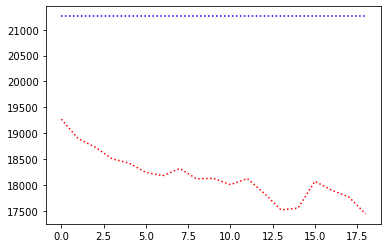

record the last path to gazebo for showing up


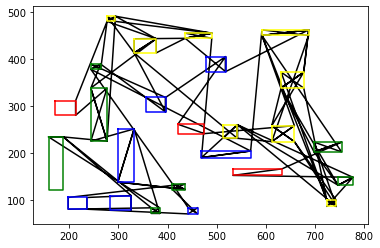

tensor([23., 14., 13., 20.,  5., 13., 20., 14.,  6.,  6.,  5., 20.,  6.,  5.,
        23.,  8., 13., 23., 23., 14.,  5., 20., 14.,  0.,  8., 22., 21.,  7.,
        17., 17., 12., 11., 15.,  7.,  8., 12., 17., 12.,  8., 22., 17., 12.,
         7., 18., 21., 18.,  2.,  7., 24., 24., 10.,  3., 24., 11., 18.,  9.,
         9.,  4., 16.,  3.,  4.,  3., 19.,  1., 10.,  4., 16.,  1.,  9., 19.],
       device='cuda:0')
epoch:0, batch:2000/2500, reward:17481.037109375


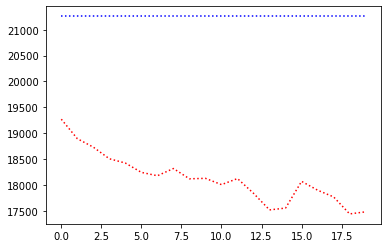

record the last path to gazebo for showing up


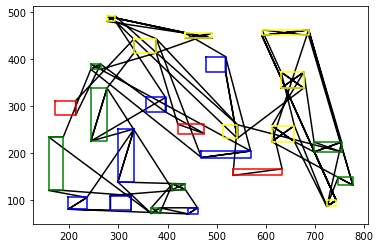

tensor([23., 23., 20., 20.,  6.,  6., 14., 20.,  6.,  0.,  8.,  5., 13., 13.,
        13., 14., 14.,  5., 21., 22., 20., 23., 23.,  8.,  5.,  8., 17.,  7.,
        12.,  5., 14., 24., 12.,  7., 17., 17.,  7., 15., 11., 12.,  8., 17.,
         7., 18., 22.,  3., 18., 18.,  9., 10., 21., 24.,  2., 12.,  9., 11.,
         4., 24.,  3., 16., 19.,  4.,  3.,  1., 16.,  4., 10., 19.,  1.,  9.],
       device='cuda:0')
epoch:0, batch:2100/2500, reward:17569.654296875


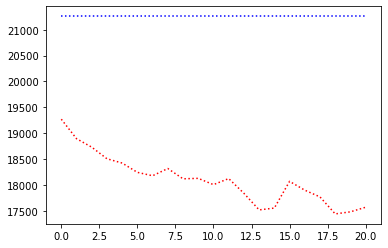

record the last path to gazebo for showing up


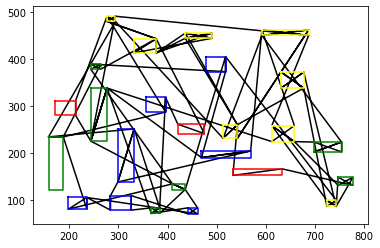

tensor([ 6.,  6., 20., 20., 23., 20.,  6., 14., 14., 13.,  8., 14., 13., 20.,
         0.,  8., 13.,  5., 23., 21.,  5., 14., 23.,  5., 23., 22.,  5., 17.,
         7.,  7.,  8., 12., 17., 22., 12., 17., 18.,  8., 17., 15., 18.,  3.,
         7.,  9., 11., 12., 24., 18., 21., 11., 24.,  7., 12., 24., 16., 10.,
         3., 19.,  9.,  2.,  4.,  1., 10.,  3.,  4.,  4., 16.,  1.,  9., 19.],
       device='cuda:0')
epoch:0, batch:2200/2500, reward:17472.052734375


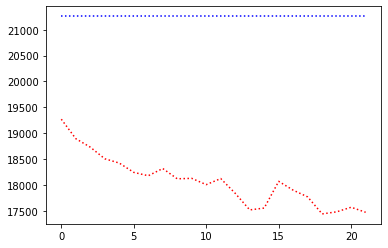

record the last path to gazebo for showing up


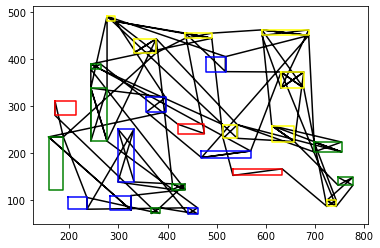

tensor([13., 13., 23., 14., 20., 20.,  6., 20., 13., 23.,  6., 14.,  6., 23.,
        14.,  0.,  8., 20.,  8., 21.,  5., 14.,  5.,  8., 22.,  5., 23.,  5.,
        17.,  7., 12., 17.,  7., 15., 10., 11., 17.,  8., 21., 22., 18.,  7.,
        12., 12., 18., 24., 18.,  7., 17., 12., 24., 24.,  3.,  2.,  9., 16.,
         3., 10., 11.,  9.,  1.,  4., 19.,  4.,  9., 16., 19.,  4.,  3.,  1.],
       device='cuda:0')
epoch:0, batch:2300/2500, reward:17227.21484375


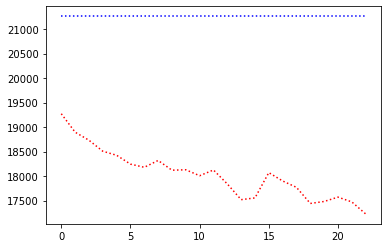

record the last path to gazebo for showing up


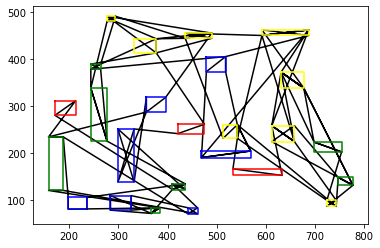

tensor([ 0., 20.,  6., 23., 20., 23., 20., 13., 14., 13.,  6.,  8., 13.,  6.,
        20., 14., 14.,  5.,  5., 17., 23.,  8., 21., 23., 22.,  7., 12.,  5.,
        22., 14., 17.,  5., 11., 15.,  8.,  8., 17., 18., 12.,  7.,  2., 24.,
         7., 18., 12., 24., 18., 17., 12., 11.,  7.,  3., 21., 10.,  9., 16.,
        24., 10.,  9.,  3.,  4., 19.,  4.,  4.,  1.,  9.,  1.,  3., 19., 16.],
       device='cuda:0')
epoch:0, batch:2400/2500, reward:17181.08203125


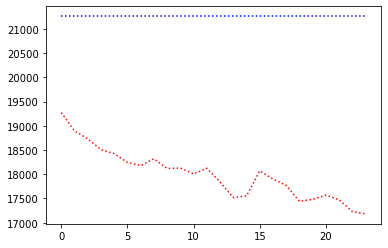

record the last path to gazebo for showing up


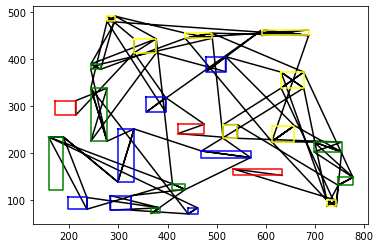

tensor([14.,  6., 13., 13., 20., 20., 20., 23., 21., 14.,  6.,  6., 20.,  5.,
         0., 14.,  8., 13.,  5., 23., 14., 17., 23.,  8., 23., 22.,  5., 17.,
         5.,  7., 12., 21.,  8., 17., 15., 17., 22.,  7.,  8.,  7., 11., 18.,
        18., 12., 24.,  7., 12., 18., 12., 11., 24.,  2., 10.,  3., 24., 16.,
         3.,  4.,  9.,  9., 10.,  3.,  4.,  4., 19.,  1.,  1., 16.,  9., 19.],
       device='cuda:0')
epoch:0, batch:2500/2500, reward:17243.5703125


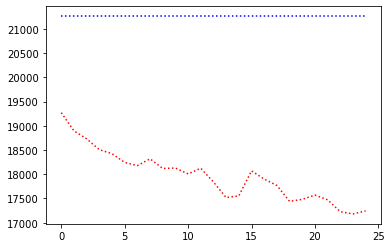

record the last path to gazebo for showing up


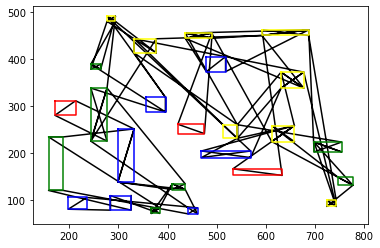

R_val =  tensor(16330.4668, device='cuda:0')
C_val =  21260.380859375
Avg Actor 16330.466796875 --- Avg Critic 21260.380859375
My actor is going on the right road Hallelujah :) Updated
Epoch: 0, epoch time: 155.209min, tot time: 0.108day, L_actor: 16330.467, L_critic: 21260.381, update: True
Save Checkpoints
tensor([20., 13., 13.,  6.,  6., 21., 13.,  0., 20., 14., 23.,  6., 20., 23.,
        14., 14., 20.,  8.,  5.,  8., 23.,  5.,  5., 14., 22., 23., 17.,  7.,
         7., 17.,  5.,  8.,  8., 22., 15., 21., 12.,  7., 12., 17., 17., 18.,
        11., 12., 18.,  9., 12.,  2., 18.,  3., 24.,  7., 24., 10., 16., 11.,
        24.,  1.,  4.,  4.,  9., 10.,  3.,  3.,  4., 19., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:1, batch:100/2500, reward:17095.9609375


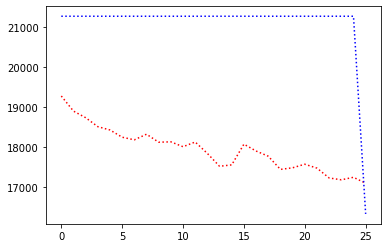

record the last path to gazebo for showing up


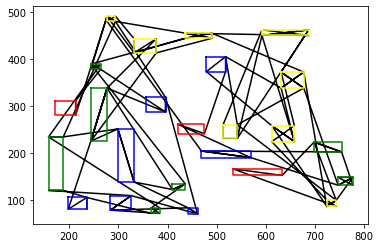

tensor([ 6., 23.,  6., 14., 20., 13., 20., 20., 20., 14., 13.,  6.,  5., 14.,
         8., 13.,  0., 23.,  5., 21.,  8., 23., 14., 21., 23.,  5.,  5., 17.,
        17., 22., 17.,  8.,  7., 12., 18.,  7., 17.,  8., 15., 11., 22.,  7.,
        12., 18.,  2., 24., 12.,  7., 18., 10.,  3.,  4., 24., 11.,  1., 24.,
        12.,  9., 10., 16.,  3.,  9.,  4., 16., 19.,  3.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:1, batch:200/2500, reward:17046.25


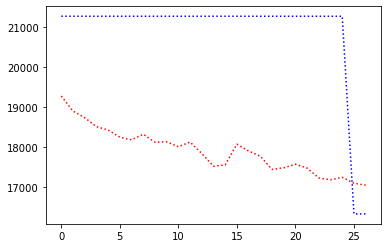

record the last path to gazebo for showing up


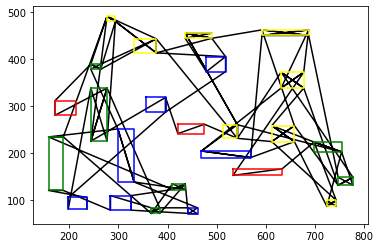

tensor([ 0.,  6., 23., 13., 13., 23., 20., 20.,  6., 13., 14.,  8.,  6., 20.,
        20., 14., 23., 14.,  5., 22., 14.,  5.,  8., 23., 21., 17., 17.,  5.,
         7.,  5., 12., 12.,  8., 15.,  3.,  8., 22., 21., 11., 17., 12.,  7.,
        18., 18., 17.,  7., 12., 11., 24., 18.,  7.,  2., 24.,  9., 10., 24.,
         9., 16.,  3.,  4., 19.,  1., 16.,  3.,  1.,  4., 10.,  9.,  4., 19.],
       device='cuda:0')
epoch:1, batch:300/2500, reward:16949.375


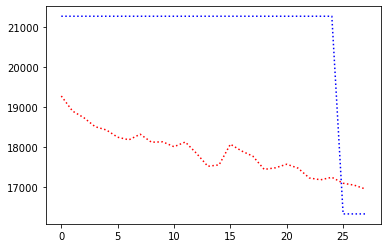

record the last path to gazebo for showing up


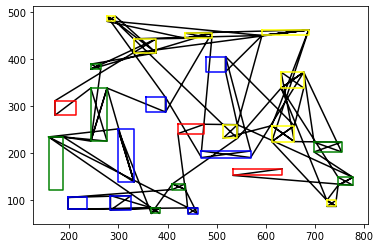

tensor([20.,  6., 20., 20., 14.,  6.,  8., 20., 14., 23.,  0., 13.,  6., 21.,
        23., 14., 13., 13.,  5., 22., 23., 23.,  5., 14.,  8.,  5.,  5.,  7.,
        17., 17.,  8.,  7., 12., 22., 17., 21., 15.,  8., 18., 24.,  7., 12.,
        11.,  7., 11., 12., 12.,  9., 17., 18., 24.,  3.,  9.,  2., 10., 18.,
         3.,  9.,  1., 16., 24.,  4.,  1., 19., 10.,  3., 19., 16.,  4.,  4.],
       device='cuda:0')
epoch:1, batch:400/2500, reward:16931.56640625


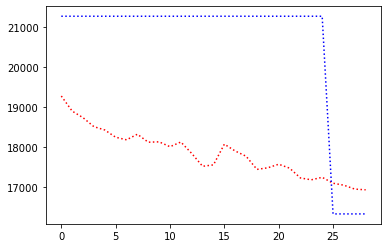

record the last path to gazebo for showing up


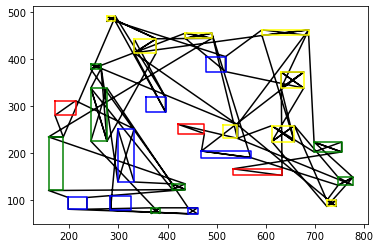

tensor([14.,  0., 20., 13., 14., 13., 20.,  6., 13., 23., 14.,  6.,  6.,  8.,
        20.,  8., 23., 23.,  5.,  5., 20.,  7., 21.,  5.,  5., 14., 17., 23.,
        22., 11., 21.,  8.,  8., 17., 15., 22., 12., 12.,  7., 17., 18., 12.,
         7.,  2.,  7., 17., 24., 18., 12., 18., 11.,  3.,  9., 24., 10., 24.,
         9., 10.,  1.,  3., 16.,  4., 19.,  4.,  3., 16.,  9., 19.,  4.,  1.],
       device='cuda:0')
epoch:1, batch:500/2500, reward:16604.5859375


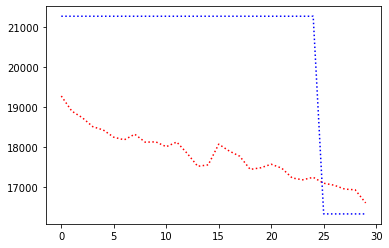

record the last path to gazebo for showing up


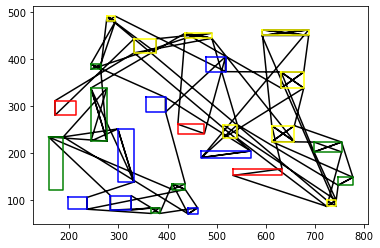

tensor([ 6., 20., 20., 20., 13., 20., 14., 13.,  6., 14.,  5., 23.,  8., 13.,
         0.,  6.,  5.,  5., 23.,  8., 21., 14., 14., 23., 17., 23., 22.,  8.,
         5., 17.,  7.,  7., 15.,  7., 22.,  7., 17., 21.,  8., 12., 18., 24.,
        12., 24., 11., 10., 18., 12.,  2., 17., 16.,  9.,  3., 11., 18., 12.,
         9., 24.,  3.,  4., 19.,  1., 10.,  4.,  4.,  9., 16.,  1.,  3., 19.],
       device='cuda:0')
epoch:1, batch:600/2500, reward:16765.4453125


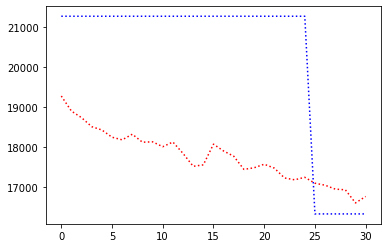

record the last path to gazebo for showing up


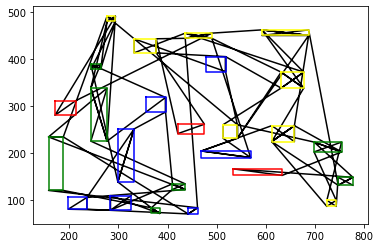

tensor([13., 14., 20.,  6.,  6., 20., 23., 23., 20., 20., 14., 13., 14., 13.,
         6., 14.,  0.,  8., 21.,  5.,  8.,  5., 17., 23.,  7.,  5., 23., 22.,
         5., 17., 15.,  8.,  8., 22., 21., 12., 17., 17.,  7., 24., 18., 12.,
        12.,  7., 11., 18., 24., 16.,  3.,  7., 12., 11., 18., 24.,  4., 10.,
         2.,  9.,  3.,  9.,  1.,  1., 19., 10.,  9.,  3., 19.,  4.,  4., 16.],
       device='cuda:0')
epoch:1, batch:700/2500, reward:16765.0703125


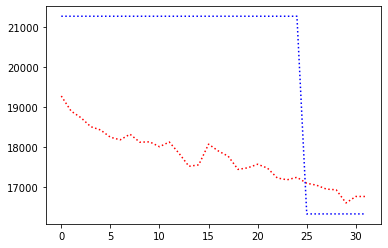

record the last path to gazebo for showing up


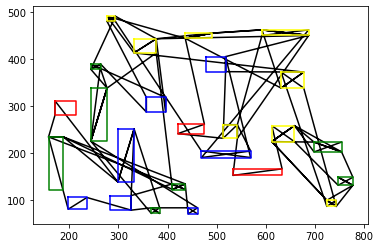

tensor([ 6., 20., 20., 23., 14., 13., 14., 21.,  0., 23., 23., 13.,  6., 20.,
        14.,  5., 14.,  6., 13., 20.,  8.,  5.,  8.,  5., 22.,  8., 23., 17.,
        12., 17.,  7., 22.,  5., 15., 21., 12.,  7., 17., 18., 17., 11.,  3.,
         7.,  8., 24., 18., 12.,  2.,  9., 24., 10., 12., 18.,  7., 11., 24.,
         9.,  1.,  4.,  3., 16., 10.,  9., 19.,  4., 19.,  3.,  4., 16.,  1.],
       device='cuda:0')
epoch:1, batch:800/2500, reward:16606.29296875


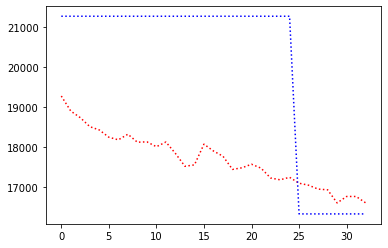

record the last path to gazebo for showing up


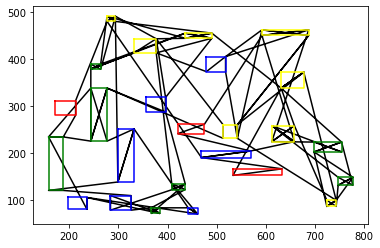

tensor([13.,  6., 14.,  0., 14., 20.,  8., 20.,  6., 23.,  8.,  6., 13., 14.,
        20., 14., 13., 20., 23.,  5., 23., 21.,  5.,  5., 22., 22., 17., 12.,
         7.,  8.,  5., 23.,  8., 15., 17., 11.,  2.,  7., 17., 18., 24., 21.,
         7., 12., 17.,  7., 12., 24., 11., 18., 24., 12., 18.,  3., 10.,  9.,
        10.,  9.,  3.,  4., 16.,  3.,  4.,  1., 19., 16.,  1.,  9.,  4., 19.],
       device='cuda:0')
epoch:1, batch:900/2500, reward:16645.3828125


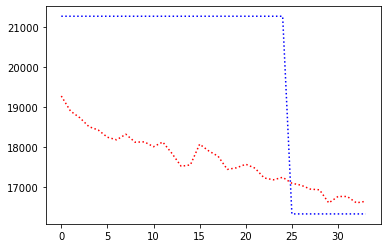

record the last path to gazebo for showing up


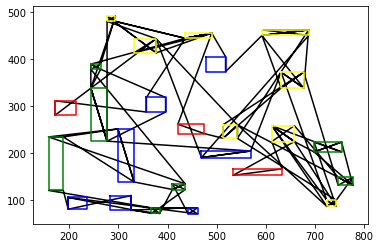

tensor([20.,  6., 20., 14.,  6., 14., 23., 14., 23., 20.,  5., 13.,  8., 13.,
        13., 20., 21., 22.,  0.,  6.,  5.,  5., 14.,  8.,  8., 22., 23., 23.,
         8., 17.,  7., 12., 17.,  5., 15., 12., 21., 17.,  7., 18., 11., 18.,
         7., 24.,  2., 17., 12., 18., 24.,  7., 12.,  4.,  3.,  9., 11., 24.,
        10.,  9., 16.,  3.,  1.,  4., 10., 19.,  4.,  1., 16.,  3.,  9., 19.],
       device='cuda:0')
epoch:1, batch:1000/2500, reward:16597.4453125


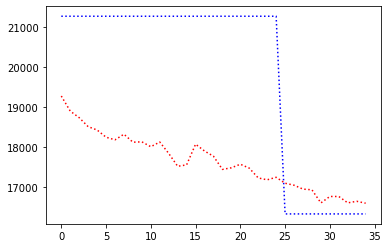

record the last path to gazebo for showing up


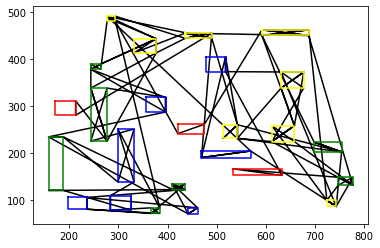

tensor([ 6.,  8., 13., 14.,  6., 14., 20.,  6.,  5., 20.,  0., 20., 13., 14.,
        23., 20., 23.,  5.,  8., 13., 23., 21., 23., 14.,  8.,  5., 17., 12.,
        17., 22.,  7., 17.,  7.,  8., 15.,  5., 22., 21., 11., 12., 18.,  7.,
        12., 12., 18., 24.,  7., 17., 24.,  2., 11., 18., 10.,  3.,  9.,  1.,
         9., 10., 19., 16., 24.,  4.,  3.,  4.,  4.,  1.,  3.,  9., 19., 16.],
       device='cuda:0')
epoch:1, batch:1100/2500, reward:16539.6953125


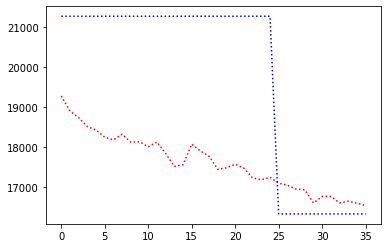

record the last path to gazebo for showing up


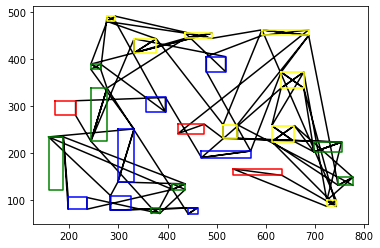

tensor([14., 20., 14., 13.,  0.,  6.,  6., 23., 20.,  6.,  8.,  5., 20., 20.,
         5., 23., 13., 23., 13., 14.,  5., 21.,  8., 14., 22.,  8., 21., 23.,
        17.,  2., 17.,  7., 22.,  5., 12., 24., 12., 17.,  7.,  8., 18., 15.,
        11.,  7., 12., 24., 18.,  9., 17., 12., 24.,  9.,  7., 11., 10.,  3.,
        18., 16.,  4.,  1.,  3., 19.,  4., 10., 19.,  3.,  4.,  1.,  9., 16.],
       device='cuda:0')
epoch:1, batch:1200/2500, reward:16361.8525390625


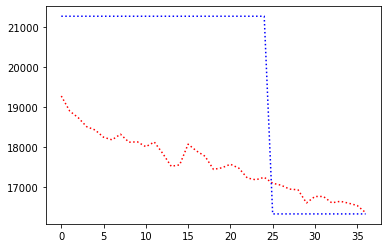

record the last path to gazebo for showing up


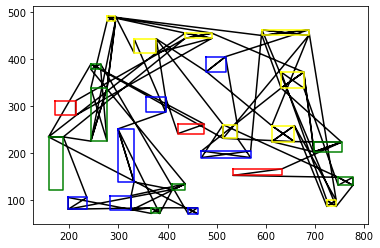

tensor([13.,  6., 20., 14.,  0.,  8., 20., 14., 20.,  8., 23.,  6., 23., 13.,
        20.,  6., 23.,  5., 14., 14.,  5., 17.,  5., 13., 21., 23., 17.,  5.,
        22., 22., 15., 12., 12.,  7.,  8.,  8., 21., 17., 17., 18.,  7.,  9.,
        11., 18., 12.,  7., 24.,  7., 11., 12., 10., 24.,  2., 18.,  3.,  4.,
         1.,  3.,  9., 24., 16., 10.,  4., 19., 19.,  3., 16.,  9.,  4.,  1.],
       device='cuda:0')
epoch:1, batch:1300/2500, reward:16399.6484375


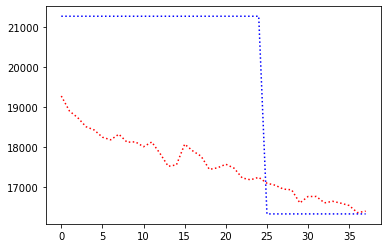

record the last path to gazebo for showing up


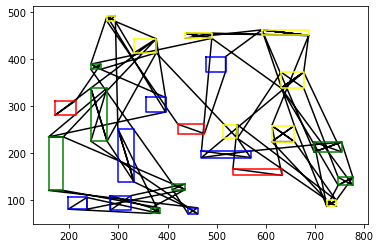

tensor([20.,  8., 23., 14.,  6., 13., 20.,  6., 20., 20., 14., 23., 21.,  5.,
         6., 13., 14., 13.,  8.,  0., 14.,  8., 22., 23.,  5., 23.,  7., 17.,
         7., 12.,  5., 15., 17.,  5., 21., 22., 12., 17., 24., 11., 10., 18.,
        12.,  7.,  8., 17., 12., 18.,  7., 10.,  9., 24.,  2., 11., 24., 18.,
         9.,  4.,  3.,  1., 16.,  3., 19.,  4.,  3.,  9.,  1.,  4., 19., 16.],
       device='cuda:0')
epoch:1, batch:1400/2500, reward:16261.8828125


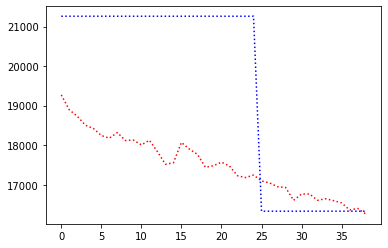

record the last path to gazebo for showing up


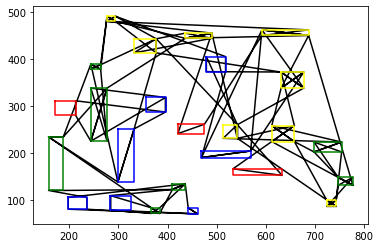

tensor([13.,  0., 20.,  6., 13.,  6., 23., 14., 20., 14.,  8.,  6.,  8., 20.,
        23., 20., 21., 23., 14.,  5., 13., 14.,  8.,  7., 17., 21.,  5., 15.,
        22., 12., 17., 23.,  5., 17.,  5.,  7.,  8., 11., 22., 12.,  7., 18.,
        12., 24., 17.,  7., 18.,  2., 24.,  9., 19., 18., 12.,  3., 11.,  9.,
        24., 10.,  3.,  1.,  4., 16., 10.,  3., 16.,  4.,  4.,  9., 19.,  1.],
       device='cuda:0')
epoch:1, batch:1500/2500, reward:16324.2548828125


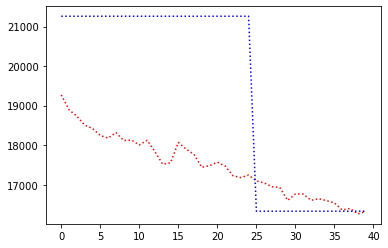

record the last path to gazebo for showing up


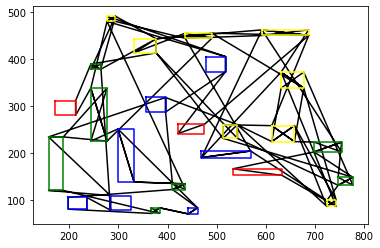

tensor([14., 14., 13., 23., 20.,  6.,  0., 13., 20.,  6., 20.,  8., 13., 14.,
        23., 23.,  6., 12.,  8., 21., 14., 20.,  5.,  5., 22.,  8.,  5., 17.,
        23., 22.,  7., 24., 15., 11.,  8., 17.,  7., 21.,  5.,  7., 17., 18.,
        12., 12., 17., 18.,  7., 24., 12., 18., 11.,  9., 10.,  2.,  1.,  3.,
        24.,  9.,  3.,  4., 16.,  4., 19.,  1.,  9., 10., 19., 16.,  3.,  4.],
       device='cuda:0')
epoch:1, batch:1600/2500, reward:16177.509765625


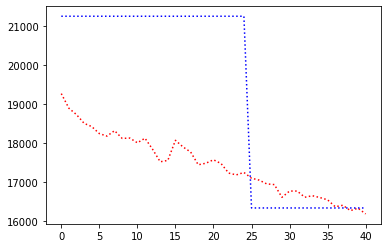

record the last path to gazebo for showing up


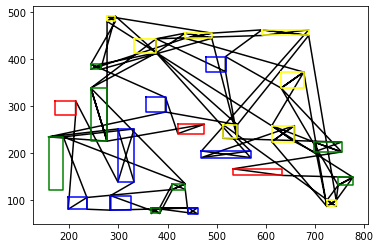

tensor([ 6., 13., 20., 20., 14., 20., 14., 21.,  0.,  6.,  8., 13., 20., 23.,
         6.,  8., 23., 13.,  5., 14., 14.,  5.,  5., 23.,  8., 23., 21.,  5.,
        22.,  7., 17., 17., 22., 17.,  8., 15., 12.,  7., 12., 18., 24.,  7.,
        17., 11., 18., 24., 10.,  2.,  7., 12., 11., 12.,  3., 24., 18., 16.,
         9.,  9., 19.,  4.,  4.,  4.,  1.,  3., 10.,  3., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:1, batch:1700/2500, reward:16287.4775390625


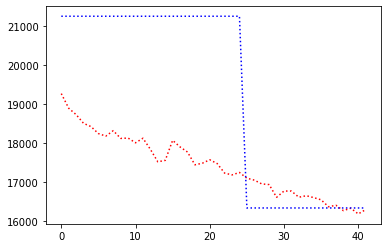

record the last path to gazebo for showing up


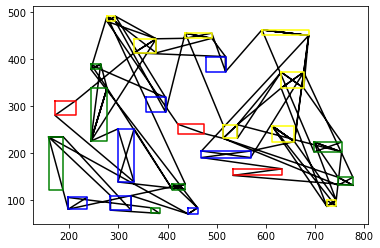

tensor([20., 20., 14.,  6.,  8.,  6., 14., 20., 13., 13., 21.,  0., 14., 13.,
         6., 23., 23.,  5.,  8., 20., 23.,  5., 17., 22., 23.,  5.,  5., 14.,
         8.,  8., 15.,  7., 12., 21., 22., 18., 12., 17.,  7.,  7., 17., 18.,
        12., 11., 17., 12., 11., 24.,  9.,  7.,  9., 24.,  2.,  3.,  4., 18.,
        24., 10., 16.,  3., 19.,  1.,  4., 19., 16.,  4., 10.,  3.,  9.,  1.],
       device='cuda:0')
epoch:1, batch:1800/2500, reward:16074.4423828125


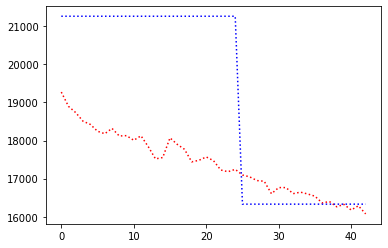

record the last path to gazebo for showing up


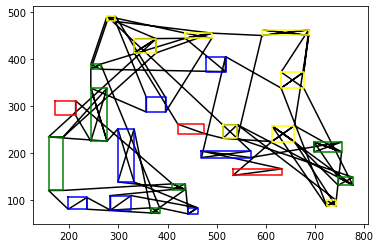

tensor([ 0., 20.,  6., 23., 20., 13., 20., 14., 14.,  6., 23.,  8., 14., 13.,
         8., 20., 23., 21.,  6., 23., 17., 22.,  5., 13., 14.,  5.,  8.,  8.,
         5.,  5., 17., 22., 21., 15., 11., 24.,  2., 12.,  7.,  7.,  7., 12.,
        17., 17., 18., 18., 18., 12., 24., 11.,  7., 24., 12.,  9., 10.,  4.,
        10.,  3.,  4.,  3.,  1.,  3., 16.,  9., 19., 19.,  4., 16.,  9.,  1.],
       device='cuda:0')
epoch:1, batch:1900/2500, reward:16046.189453125


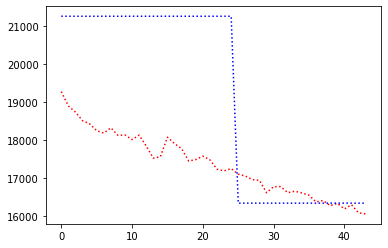

record the last path to gazebo for showing up


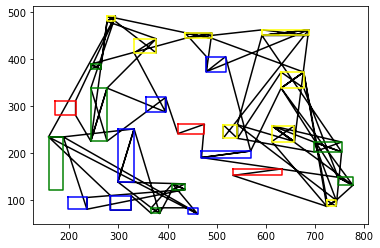

tensor([13., 14.,  0.,  8.,  6., 23., 20.,  6., 20., 21.,  8., 14., 20., 20.,
        13., 23., 14.,  6., 23.,  5., 13., 14.,  5., 23., 22.,  8.,  5., 17.,
         7., 17., 24., 21., 22.,  5.,  7., 12.,  7., 15.,  8., 17., 18., 12.,
        24., 17., 12., 11., 11., 12., 18.,  9.,  2., 16.,  3.,  7., 18.,  9.,
        10.,  3.,  4.,  1., 24.,  4., 19., 10., 19.,  3., 16.,  9.,  4.,  1.],
       device='cuda:0')
epoch:1, batch:2000/2500, reward:15982.361328125


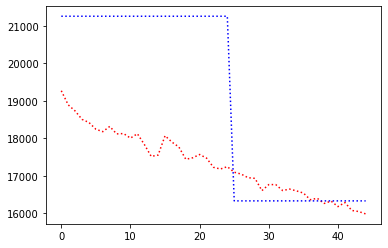

record the last path to gazebo for showing up


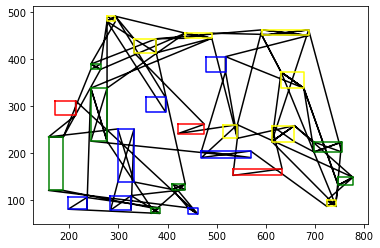

tensor([ 0., 20., 13.,  6., 23., 14.,  6.,  8., 14., 23., 20., 21., 13., 14.,
        20.,  6.,  5., 20., 13., 14., 23.,  5.,  8., 22.,  8.,  7., 17., 12.,
         5.,  5., 23., 22.,  8., 17., 21., 15., 17., 12.,  7., 17.,  7.,  7.,
        11., 12., 18., 24., 11., 12., 18., 24.,  3.,  4.,  2.,  9., 10., 16.,
         9., 18., 24.,  3., 19.,  9., 10.,  4.,  1.,  3.,  1., 19., 16.,  4.],
       device='cuda:0')
epoch:1, batch:2100/2500, reward:15837.5595703125


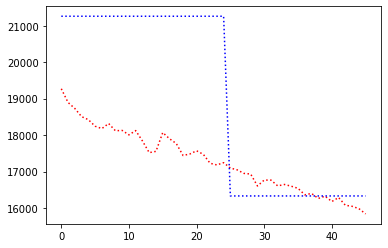

record the last path to gazebo for showing up


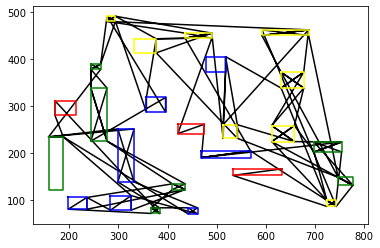

tensor([14., 20., 13.,  0.,  6., 20.,  6.,  8., 13., 20., 14., 14., 23.,  6.,
        23.,  5., 21.,  8., 20., 23., 13.,  5., 14., 23., 22., 12., 18., 17.,
         8.,  5.,  7., 17., 21.,  8.,  5., 15., 17., 22., 12., 24., 12.,  2.,
        11.,  7., 17.,  7., 18., 11.,  7., 12., 24.,  3.,  9., 10.,  4., 16.,
        19., 18., 24.,  9.,  3.,  1.,  4.,  4., 10., 19.,  1.,  3., 16.,  9.],
       device='cuda:0')
epoch:1, batch:2200/2500, reward:15838.21875


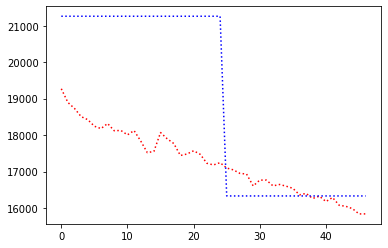

record the last path to gazebo for showing up


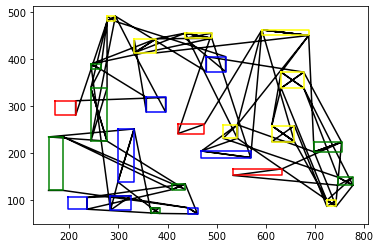

tensor([13., 20.,  8., 20., 14.,  6., 13.,  0., 20., 14.,  8., 23.,  6., 23.,
         6., 20., 21., 14.,  5.,  5., 13., 14., 21.,  5., 22., 23., 23., 17.,
         5.,  8., 17., 11., 15.,  8., 22.,  7., 12., 17.,  7., 12., 17.,  7.,
        18., 12., 11., 18., 24.,  2.,  9., 24., 18., 12.,  7., 24.,  3., 16.,
        10.,  4., 19.,  1.,  3.,  4.,  9., 10., 16.,  3.,  9., 19.,  4.,  1.],
       device='cuda:0')
epoch:1, batch:2300/2500, reward:15632.984375


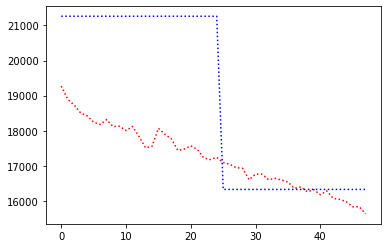

record the last path to gazebo for showing up


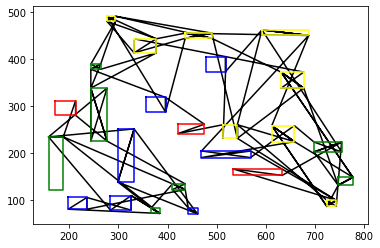

tensor([ 6., 13., 23., 20., 14., 20.,  0., 14., 13.,  6., 20., 21., 20., 23.,
         6., 14.,  8., 13., 14.,  8.,  5.,  8., 23., 23.,  5.,  7., 17., 12.,
         7.,  5., 22., 12.,  5., 22., 17.,  8., 15.,  7., 12., 21., 11., 12.,
        10.,  3., 17., 18., 17., 18.,  2., 24.,  9., 11., 24.,  7.,  9., 19.,
         4., 18., 24.,  3., 16.,  4.,  1., 16., 10., 19.,  4.,  3.,  1.,  9.],
       device='cuda:0')
epoch:1, batch:2400/2500, reward:15744.173828125


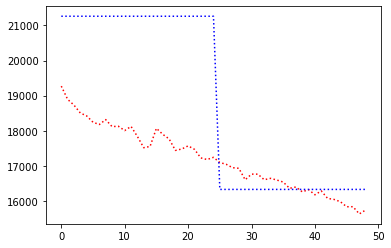

record the last path to gazebo for showing up


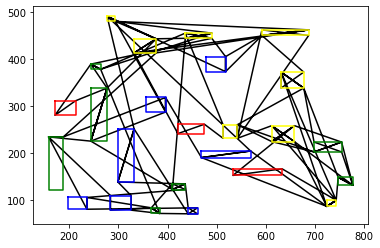

tensor([14.,  6., 20., 20.,  0.,  8., 14., 13.,  6., 20., 23.,  5., 20., 13.,
        21., 23.,  5., 14.,  6., 23., 23., 14.,  8., 13.,  8., 22., 15.,  8.,
        22.,  7., 17., 12.,  5., 17., 21., 17., 12.,  7., 11.,  5., 12., 17.,
         7., 18., 18., 24.,  9., 10.,  4.,  3., 11.,  7., 24., 12., 18.,  2.,
         3., 16., 19.,  9., 24.,  1.,  4., 10.,  1., 16.,  3.,  4.,  9., 19.],
       device='cuda:0')
epoch:1, batch:2500/2500, reward:15576.798828125


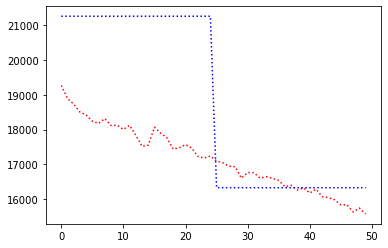

record the last path to gazebo for showing up


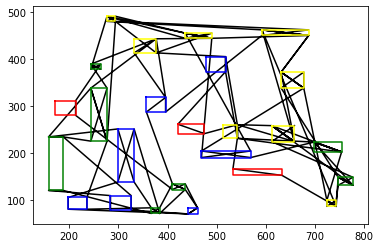

R_val =  tensor(12746.2061, device='cuda:0')
C_val =  16330.466796875
Avg Actor 12746.2060546875 --- Avg Critic 16330.466796875
My actor is going on the right road Hallelujah :) Updated
Epoch: 1, epoch time: 156.319min, tot time: 0.216day, L_actor: 12746.206, L_critic: 16330.467, update: True
Save Checkpoints
tensor([ 6., 20., 20.,  6., 13., 14., 14.,  0., 20., 20.,  6., 14., 23., 13.,
         5.,  8., 13., 14.,  8., 21., 23., 23.,  8.,  5., 22.,  5., 17.,  7.,
        12., 23., 17.,  7., 21.,  8.,  5., 17.,  7., 22., 15., 18., 12., 11.,
         3., 16.,  1.,  4.,  4.,  3., 24.,  9.,  2., 10., 24., 17., 12., 18.,
        12.,  7., 11., 19.,  9., 18., 24.,  1., 16.,  3.,  9., 10.,  4., 19.],
       device='cuda:0')
epoch:2, batch:100/2500, reward:16164.4765625


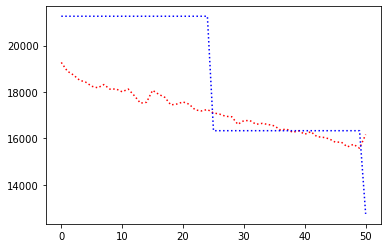

record the last path to gazebo for showing up


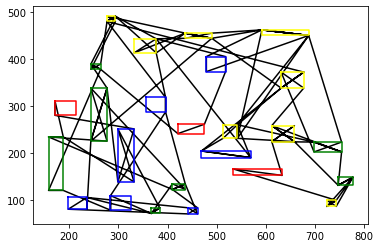

tensor([20.,  6., 13.,  0., 14.,  8., 23., 14., 20., 13., 14.,  6., 20., 20.,
        13., 23.,  8.,  6., 21.,  5.,  5., 23.,  5., 17., 17., 12.,  7., 14.,
         8., 23., 22., 17., 12., 21.,  8., 22.,  5.,  7., 18., 17.,  7., 15.,
         7., 12., 24., 11., 11., 12., 24.,  3., 10.,  2., 18.,  3.,  9.,  4.,
         1., 16., 19., 18.,  4., 24.,  9., 10., 16., 19.,  3.,  4.,  1.,  9.],
       device='cuda:0')
epoch:2, batch:200/2500, reward:15807.392578125


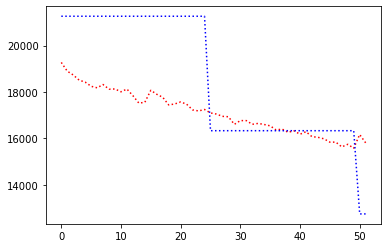

record the last path to gazebo for showing up


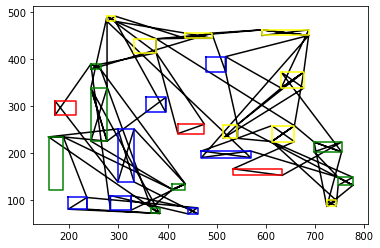

tensor([ 6., 14., 20., 21.,  0., 13., 13., 14., 23., 20., 20.,  8., 14.,  6.,
         8., 23., 15.,  6., 14., 20., 13.,  8., 21., 23., 17., 22.,  5., 23.,
         5.,  7., 17., 12.,  8.,  5.,  5.,  7., 11., 12.,  2., 18., 17., 22.,
         7., 12., 17., 12.,  7., 18., 11., 24., 10.,  3.,  4., 19.,  9., 24.,
        16.,  3.,  1.,  4., 16., 18.,  9., 24., 10., 19.,  3.,  9.,  4.,  1.],
       device='cuda:0')
epoch:2, batch:300/2500, reward:15723.2783203125


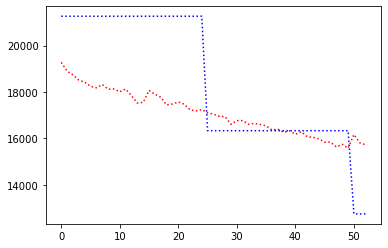

record the last path to gazebo for showing up


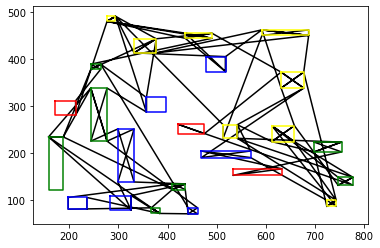

tensor([13., 20.,  6.,  0., 20., 14.,  8., 21., 23., 14., 13., 14.,  6., 23.,
         8., 20.,  6., 13., 20., 14., 23.,  5., 22., 15.,  8.,  8.,  5.,  5.,
        17., 17.,  7., 12., 23.,  5., 21., 22., 17.,  7., 11.,  2., 12., 18.,
        24.,  9., 12., 18.,  7., 17., 10.,  3.,  7., 11., 24., 12., 18., 24.,
         9.,  4.,  4.,  1., 19., 16.,  3., 10.,  3.,  9.,  4., 16.,  1., 19.],
       device='cuda:0')
epoch:2, batch:400/2500, reward:15495.171875


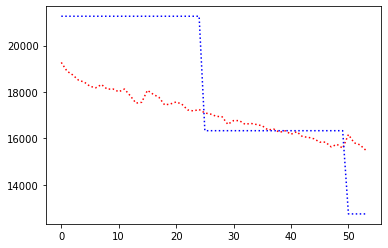

record the last path to gazebo for showing up


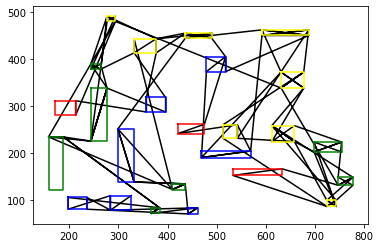

tensor([ 6., 13., 14., 20.,  0., 21.,  8., 13.,  6., 23., 14., 20.,  5., 20.,
         6., 14., 23., 20., 13., 23.,  8.,  5., 14., 21.,  8.,  5., 17., 12.,
        17.,  7., 23., 22.,  5.,  8., 15., 22., 17.,  7., 18., 12., 11.,  7.,
        12., 24., 18., 17., 12.,  7., 18.,  9.,  2., 24.,  3.,  4.,  3., 11.,
        24.,  3.,  9., 10., 16., 19.,  1.,  4., 16., 10., 19.,  1.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:500/2500, reward:15604.8291015625


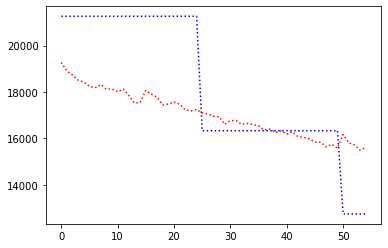

record the last path to gazebo for showing up


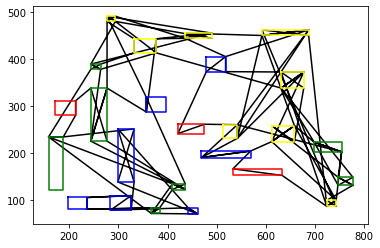

tensor([20.,  0., 14.,  6., 13., 21.,  8.,  6., 13., 14.,  8., 23., 20., 20.,
         6., 23., 14., 13., 20.,  8.,  5., 23., 14.,  5., 22., 23.,  5.,  7.,
        12., 17., 17.,  8., 21.,  5., 17., 15., 17., 22.,  7., 24.,  7., 12.,
        18.,  2., 11.,  3., 12., 18., 24., 11., 12.,  7., 24.,  9.,  4.,  3.,
        10.,  9., 18., 19.,  4., 16.,  1., 10., 16.,  4., 19.,  9.,  3.,  1.],
       device='cuda:0')
epoch:2, batch:600/2500, reward:15414.65625


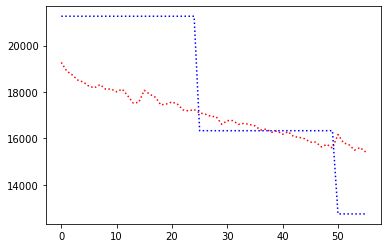

record the last path to gazebo for showing up


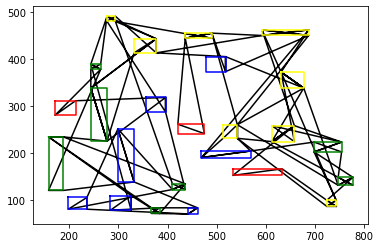

tensor([20.,  6., 13., 14.,  8.,  6., 14., 20.,  0., 13., 23.,  5., 13., 14.,
        20., 20., 14.,  8.,  6., 17., 23.,  8., 21., 23.,  5., 23., 21.,  8.,
         5.,  7., 17., 12., 12.,  5., 22., 12., 17.,  7., 15.,  3.,  7., 22.,
        17., 18., 24., 12., 18.,  9.,  2., 18.,  9., 11., 24., 10.,  4., 11.,
         7., 24.,  1.,  3., 16., 19.,  4., 10.,  3., 16., 19.,  1.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:700/2500, reward:15526.8515625


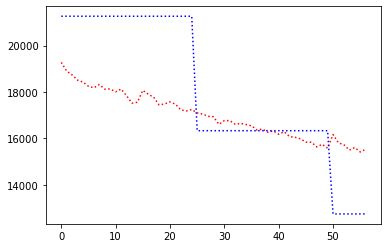

record the last path to gazebo for showing up


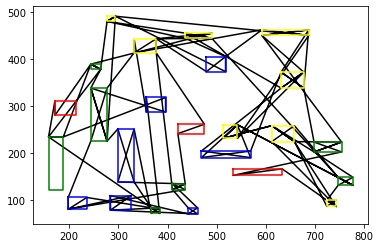

tensor([ 6., 13., 20.,  0., 14., 21.,  6., 13., 14.,  8., 20., 20., 23.,  6.,
        13., 20., 23.,  8., 14., 23., 14.,  5., 17.,  5.,  8., 23.,  5., 15.,
        22., 17., 24.,  8., 22., 21.,  5., 12.,  7.,  7., 17., 17., 12., 11.,
         7., 18., 12.,  9.,  2., 10.,  3., 11.,  7., 18., 18., 24.,  4.,  1.,
        12., 24., 16., 19.,  3.,  4., 16.,  9., 19., 10.,  3.,  1.,  9.,  4.],
       device='cuda:0')
epoch:2, batch:800/2500, reward:15649.4619140625


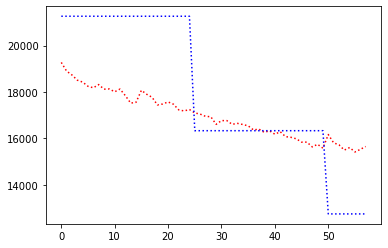

record the last path to gazebo for showing up


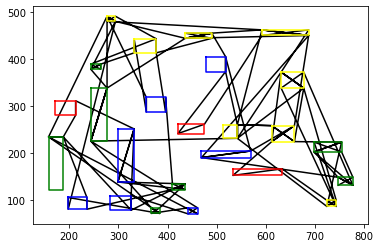

tensor([20.,  6.,  0., 14., 13., 21., 20.,  6.,  6., 14., 20., 13.,  8., 14.,
        23., 23.,  8.,  5., 15.,  8., 23., 13., 20., 14., 21., 22.,  5., 17.,
         7., 22., 17., 12.,  7., 23.,  8.,  5.,  7., 17., 12., 18., 17.,  5.,
        11., 18., 24.,  2., 10.,  3.,  9.,  4.,  3.,  4., 11.,  7., 12., 12.,
        24.,  9., 18., 24., 10., 16.,  1., 19.,  3., 16., 19.,  9.,  1.,  4.],
       device='cuda:0')
epoch:2, batch:900/2500, reward:15424.2666015625


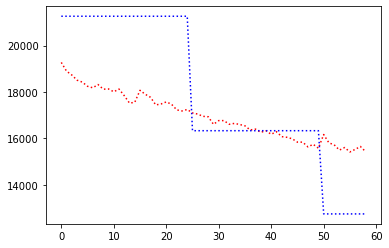

record the last path to gazebo for showing up


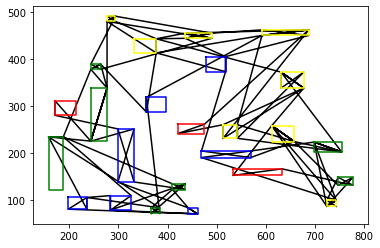

tensor([ 6.,  0., 20., 13., 14., 20.,  8., 14., 13., 20., 14., 23.,  6., 20.,
         6., 21., 13.,  8., 23.,  8.,  5., 17., 23., 14.,  5.,  8., 21.,  7.,
        12.,  7., 17., 23., 17., 12., 22.,  5.,  7., 18., 15.,  5., 22., 24.,
        12.,  7.,  3., 11.,  9.,  2., 24., 17., 18., 11., 18., 12., 24.,  9.,
         1.,  4., 10., 16., 19.,  3.,  4., 10., 16.,  3.,  1., 19.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:1000/2500, reward:15350.7578125


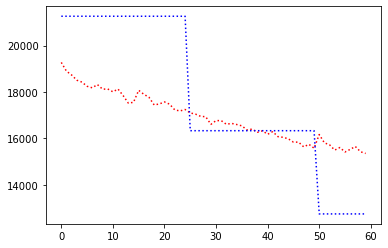

record the last path to gazebo for showing up


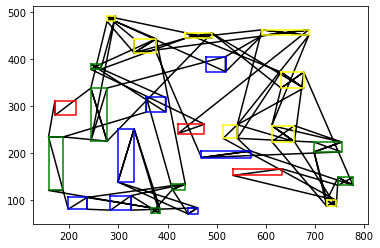

tensor([20.,  6.,  0., 13., 14.,  8., 21.,  6., 20., 13., 14., 23.,  8., 14.,
         6., 20., 13., 14., 20., 23.,  5.,  8., 23.,  5., 17., 21., 23.,  8.,
        17.,  7., 12.,  5., 17.,  5., 22., 11.,  7., 15., 22.,  3., 17., 18.,
         7., 12., 11.,  7., 24., 12., 18., 24.,  2.,  9., 10.,  4., 18., 12.,
        24.,  9.,  3., 16., 19.,  1.,  4., 10.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:2, batch:1100/2500, reward:15143.88671875


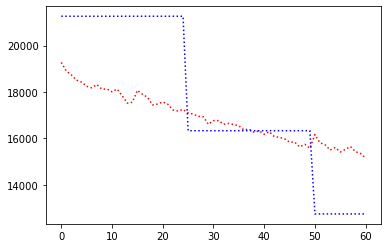

record the last path to gazebo for showing up


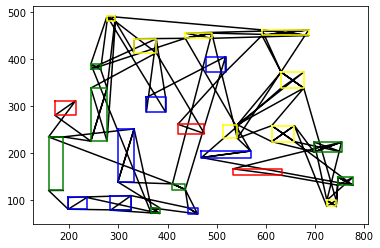

tensor([14., 20.,  6.,  0., 13.,  8., 20., 13.,  6., 14., 20., 14., 21.,  8.,
        23., 13., 17., 23.,  6., 20., 23.,  8.,  5., 14.,  5.,  5.,  7., 17.,
        12., 21., 18.,  8., 22., 17., 15., 23.,  5., 22., 17.,  7., 12., 18.,
        24., 12.,  7., 11.,  2., 24., 10., 16.,  3.,  4., 12., 11.,  7., 18.,
        24., 19.,  9.,  3.,  4.,  1., 10.,  9.,  1.,  3., 16.,  4.,  9., 19.],
       device='cuda:0')
epoch:2, batch:1200/2500, reward:15134.2529296875


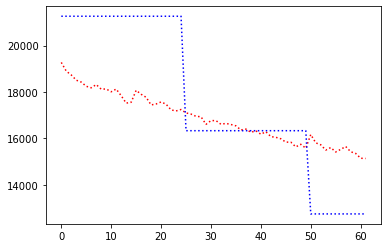

record the last path to gazebo for showing up


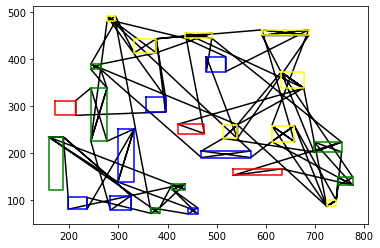

tensor([ 6., 14., 20.,  0., 13., 21., 20.,  6., 14.,  8., 13., 23.,  8., 20.,
        14., 23.,  8., 13., 20., 14.,  6., 23.,  5., 17.,  7., 12.,  5., 21.,
        22.,  8.,  5., 22., 17., 15.,  7., 12.,  9., 23., 11.,  2., 18., 24.,
         5., 17., 17.,  7., 12., 18., 12., 11.,  7., 24., 10.,  3.,  3.,  4.,
         9., 18., 24., 16., 19.,  1.,  4., 16., 10.,  3.,  1., 19.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:1300/2500, reward:15032.169921875


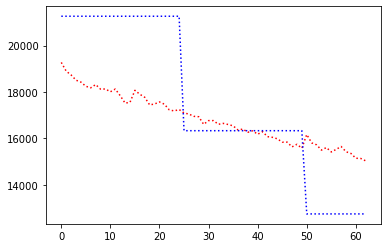

record the last path to gazebo for showing up


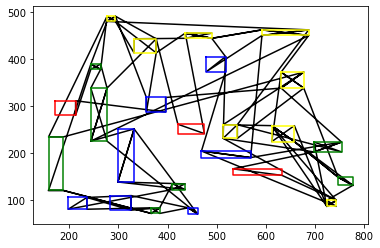

tensor([13.,  6., 20., 14., 21.,  0., 23.,  8.,  8., 20., 20.,  6., 13., 14.,
         6., 20., 14., 23., 13., 14., 23.,  8., 22.,  5., 15., 21., 23.,  5.,
         5., 17., 12.,  7.,  7.,  5., 17.,  8., 22., 17.,  7., 12., 11., 18.,
        17., 12., 24., 18., 12.,  3.,  9., 24.,  2., 11.,  7., 18., 24., 10.,
         3.,  4., 16., 19.,  9.,  1.,  1.,  4.,  3.,  9., 10., 16., 19.,  4.],
       device='cuda:0')
epoch:2, batch:1400/2500, reward:15096.083984375


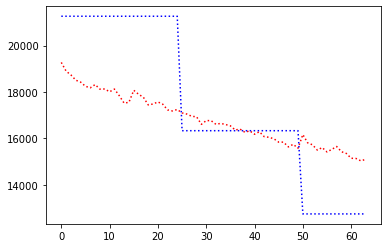

record the last path to gazebo for showing up


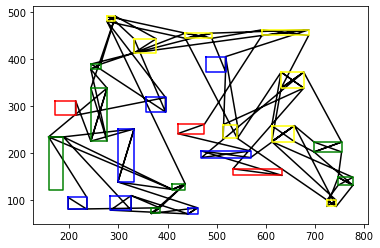

tensor([20., 13.,  6., 14.,  0., 20., 21.,  6., 14.,  8., 13., 20.,  8., 23.,
         5., 14., 23., 20.,  6., 13., 23.,  8.,  8., 21., 15., 14.,  5., 17.,
        12.,  7., 23.,  5.,  5., 22., 17., 22.,  7., 11., 12., 18., 17., 12.,
         7., 18., 17.,  7., 12., 11.,  3.,  2., 24., 10.,  1.,  9.,  4., 24.,
        24., 18., 10., 16.,  3.,  4.,  9., 19., 16., 19.,  9.,  3.,  4.,  1.],
       device='cuda:0')
epoch:2, batch:1500/2500, reward:15004.1279296875


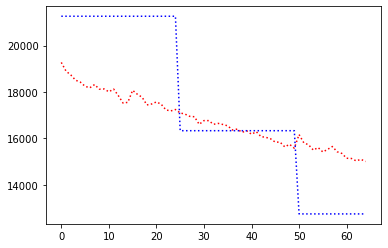

record the last path to gazebo for showing up


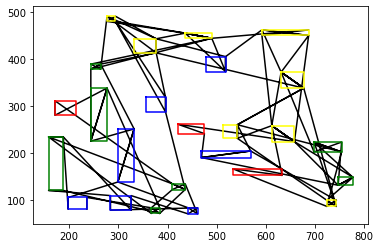

tensor([ 6., 13., 14.,  0., 20., 21.,  8., 14.,  8., 13.,  6., 20., 14., 20.,
        23., 23.,  5., 20.,  6.,  8., 13., 23., 14.,  5., 22., 15., 17., 12.,
         7.,  5., 17., 12.,  7., 23., 21.,  8.,  5., 17.,  7., 22., 24., 12.,
        18., 11., 18., 24.,  9.,  2., 17., 12.,  7., 11.,  3., 10.,  4.,  3.,
         9., 18., 24., 16.,  1., 19.,  4., 16.,  1.,  3., 10.,  9.,  4., 19.],
       device='cuda:0')
epoch:2, batch:1600/2500, reward:14839.8125


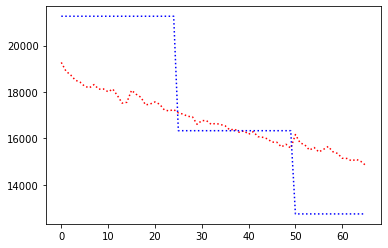

record the last path to gazebo for showing up


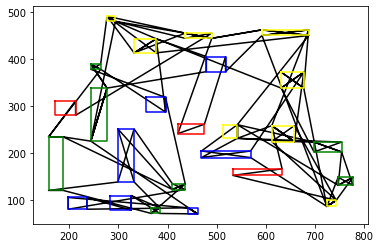

tensor([ 6., 21., 20., 13.,  0., 14.,  8., 23.,  6., 13., 14., 20., 20.,  8.,
         6., 20., 14., 23., 13.,  8., 23., 14., 22.,  5., 15., 17., 11.,  5.,
         8., 23.,  7., 17., 12.,  5., 21., 22.,  5., 17., 18.,  7., 12., 17.,
         7., 12., 24., 11., 24., 10.,  3.,  2., 24.,  7., 18., 12.,  9.,  4.,
        19., 16.,  3.,  4.,  1.,  9., 16., 18., 10.,  3., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:2, batch:1700/2500, reward:14807.9638671875


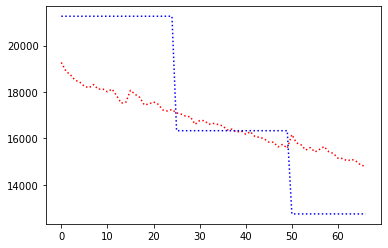

record the last path to gazebo for showing up


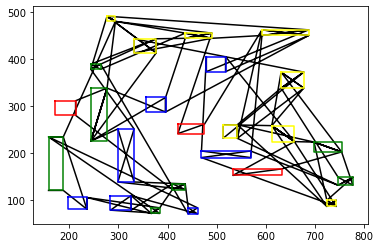

tensor([ 6., 20., 13., 21., 14.,  0., 13., 20.,  6., 23., 14., 20.,  8., 14.,
        23.,  8.,  5., 15., 22., 20., 13.,  6.,  5., 23.,  8., 14., 21., 23.,
         8.,  5., 17.,  7., 12.,  5., 17.,  7., 18., 11., 24., 17., 22., 17.,
         7., 12., 24., 18.,  3.,  4.,  9., 12.,  2., 10., 16.,  4.,  3., 11.,
        18.,  7., 24., 12.,  9.,  1., 19., 16., 10.,  1., 19.,  3.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:1800/2500, reward:14761.134765625


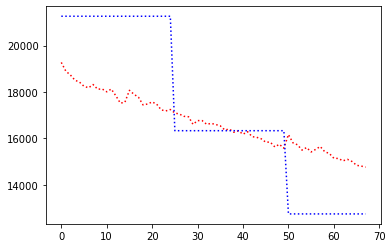

record the last path to gazebo for showing up


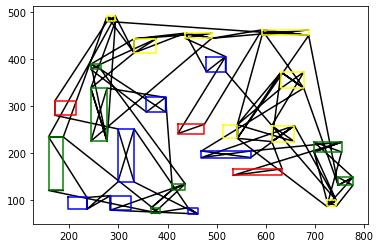

tensor([ 6., 13.,  8., 20., 14.,  0., 21., 23., 20., 14.,  6., 20., 23., 14.,
        13.,  8.,  5.,  6., 20., 13., 23., 14.,  5.,  8., 17.,  7., 12., 22.,
        17.,  7., 23., 15., 21.,  5.,  5., 17., 22.,  8.,  3., 12., 24., 18.,
        11.,  2., 17.,  7., 18., 12., 24.,  4., 12.,  7., 18., 11.,  9., 10.,
         3., 16., 19.,  1.,  4.,  9., 24., 10., 16.,  3.,  4.,  1.,  9., 19.],
       device='cuda:0')
epoch:2, batch:1900/2500, reward:14684.55078125


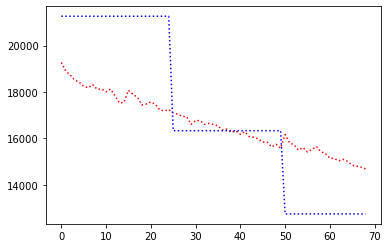

record the last path to gazebo for showing up


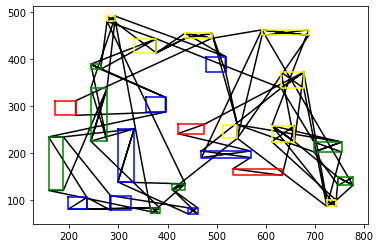

tensor([20.,  6.,  0., 13., 14., 21., 23.,  6., 20., 14., 20.,  8.,  6., 14.,
        13., 23.,  8., 20.,  5., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5.,
        17.,  7., 12.,  5., 21.,  8., 23., 22., 17., 17.,  7., 18., 12., 11.,
         7., 12.,  9., 18., 10., 24.,  2., 19.,  3.,  4., 16.,  3.,  1.,  4.,
        11., 24., 24.,  9., 12.,  7., 18.,  3., 16., 19.,  1., 10.,  4.,  9.],
       device='cuda:0')
epoch:2, batch:2000/2500, reward:14772.640625


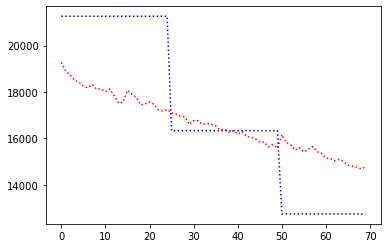

record the last path to gazebo for showing up


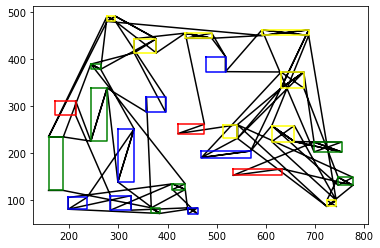

tensor([13.,  6.,  0., 20., 14., 21., 23.,  8., 22.,  5.,  6., 14., 20.,  6.,
        20., 13.,  8., 14., 23., 23., 20., 13.,  5.,  5., 17.,  7., 23., 14.,
         8., 21.,  7., 12., 17., 22.,  8., 18., 17.,  7., 11., 15.,  5., 11.,
        12., 17., 18., 12., 24., 16.,  3., 12.,  2., 24.,  9., 10.,  4.,  3.,
         7., 24., 18.,  9., 19.,  1.,  4., 10., 16.,  4.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:2, batch:2100/2500, reward:14693.3544921875


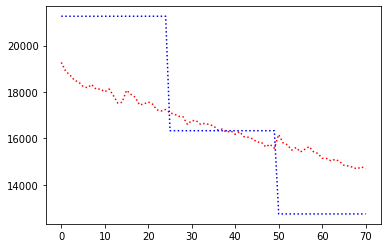

record the last path to gazebo for showing up


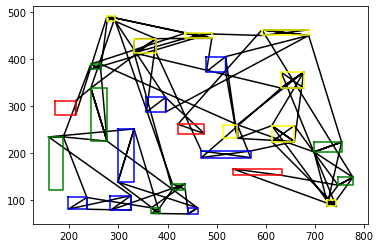

tensor([20.,  6., 13.,  0., 14.,  8., 20.,  6., 14., 13., 21., 23.,  8., 20.,
        23., 14., 20.,  6., 13.,  5., 14.,  5., 23., 21.,  8., 17.,  7., 12.,
         5., 22., 22.,  5., 15., 17.,  7., 12., 11., 23.,  8., 17., 12.,  7.,
        17., 18., 24.,  9., 18., 24.,  2., 12.,  7., 11.,  3., 18., 24.,  4.,
        10., 16.,  3.,  1., 19., 16.,  3.,  9.,  4., 10.,  4.,  9., 19.,  1.],
       device='cuda:0')
epoch:2, batch:2200/2500, reward:14620.4921875


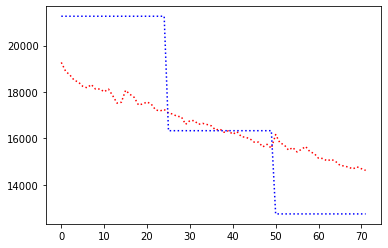

record the last path to gazebo for showing up


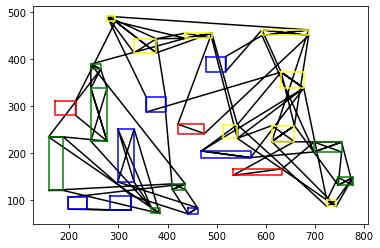

tensor([ 6., 20.,  0., 13., 14., 21.,  8., 23.,  6., 20., 14., 13., 14., 20.,
         8., 23., 20.,  6., 14., 13.,  8., 23., 21.,  5., 22., 17., 15.,  5.,
         7., 12., 17.,  5., 23.,  8.,  5., 22.,  7., 17., 12.,  7., 17., 11.,
        18.,  7., 12.,  2., 24., 10.,  3.,  4.,  9., 11., 24., 18., 18., 12.,
        24.,  9., 19., 16.,  3.,  4.,  1., 10.,  3., 16.,  1.,  9.,  4., 19.],
       device='cuda:0')
epoch:2, batch:2300/2500, reward:14622.318359375


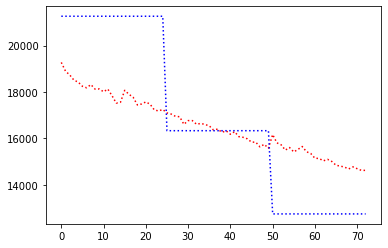

record the last path to gazebo for showing up


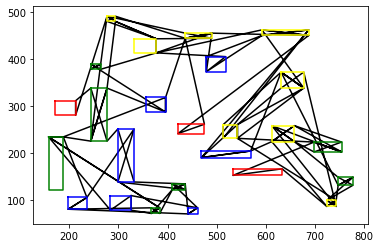

tensor([13., 20.,  6., 14.,  0., 21., 23.,  8., 20., 14.,  6., 13., 14., 20.,
         8., 23., 20., 13.,  6.,  5., 17., 23.,  8., 23., 22.,  5., 17.,  7.,
        15., 14.,  8., 21.,  5.,  7., 12., 17.,  7., 12., 18., 22.,  5., 17.,
        12., 18., 11., 24.,  9.,  2.,  3.,  4., 12., 24.,  7., 11.,  9., 18.,
        24., 10., 16., 19.,  1.,  3.,  4., 10.,  3., 16.,  9.,  1.,  4., 19.],
       device='cuda:0')
epoch:2, batch:2400/2500, reward:14502.439453125


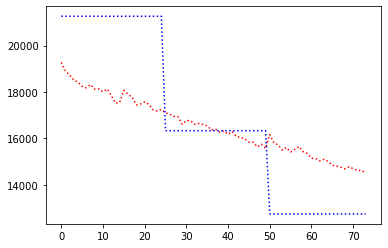

record the last path to gazebo for showing up


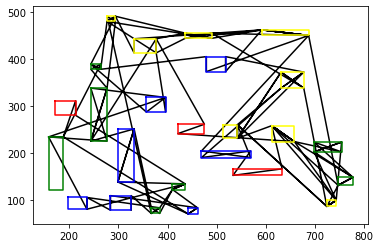

tensor([13., 20.,  6., 21.,  0., 14.,  8., 23., 20., 13.,  6., 14., 23., 20.,
         8., 14.,  6., 13., 20.,  5., 23., 14.,  8., 17.,  7., 12., 12., 22.,
         5., 17., 15.,  8., 11.,  5., 17., 23., 21., 17.,  5., 22.,  7., 18.,
        11., 12., 24.,  7., 18.,  9.,  2., 10.,  3.,  4., 16.,  3.,  1., 24.,
         7., 12., 18., 10.,  9., 24.,  9.,  3., 19.,  4., 16.,  4.,  1., 19.],
       device='cuda:0')
epoch:2, batch:2500/2500, reward:14470.234375


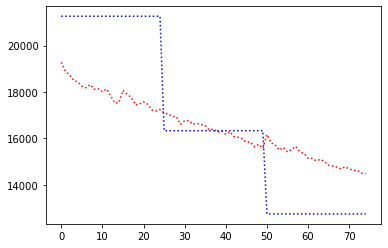

record the last path to gazebo for showing up


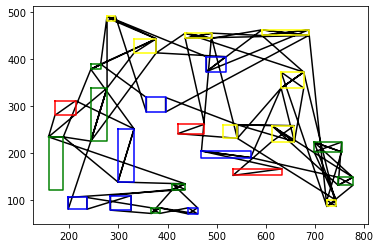

R_val =  tensor(12527.6201, device='cuda:0')
C_val =  12746.2060546875
Avg Actor 12527.6201171875 --- Avg Critic 12746.2060546875
My actor is going on the right road Hallelujah :) Updated
Epoch: 2, epoch time: 156.060min, tot time: 0.325day, L_actor: 12527.620, L_critic: 12746.206, update: True
Save Checkpoints
tensor([ 6., 20., 13., 14.,  0., 21.,  8., 23., 20., 13.,  6., 20., 14., 14.,
        23.,  8.,  6., 13., 20., 14.,  5.,  5., 17.,  8., 23., 21., 22., 17.,
         7., 11., 15., 23.,  8.,  5.,  7.,  5., 12., 17.,  7., 12., 22., 17.,
        18., 12., 11., 12., 18.,  2., 24.,  9., 10.,  3.,  7., 18., 24.,  4.,
        16.,  3.,  4.,  1., 19.,  9., 24., 10., 16.,  3.,  1., 19.,  4.,  9.],
       device='cuda:0')
epoch:3, batch:100/2500, reward:14408.083984375


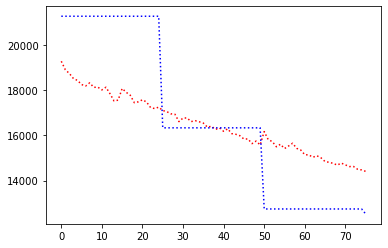

record the last path to gazebo for showing up


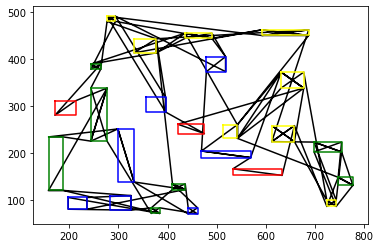

tensor([13., 20.,  6.,  0., 14.,  8., 21., 23., 14., 20., 20.,  6., 13.,  8.,
        23., 14., 20.,  6., 13., 14.,  8., 23.,  5., 15., 22., 17., 17.,  5.,
        17.,  5.,  8., 21.,  7., 23., 22., 12., 17.,  5., 12., 11.,  7.,  2.,
        12., 18., 24.,  7., 18., 24.,  3.,  9., 10.,  4.,  1., 16.,  3., 11.,
         7., 12., 18., 24.,  9., 16., 19.,  4.,  3., 10.,  9.,  1., 19.,  4.],
       device='cuda:0')
epoch:3, batch:200/2500, reward:14425.984375


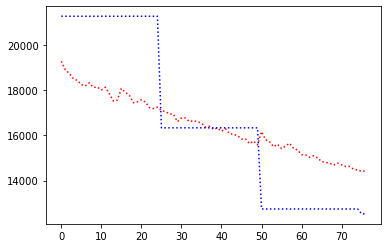

record the last path to gazebo for showing up


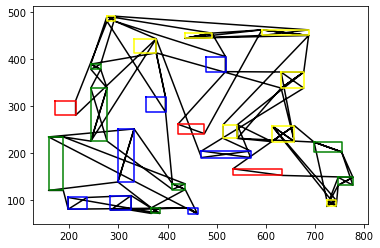

tensor([ 6., 20.,  8., 13.,  0., 14., 21., 23., 14., 20., 20.,  6., 13., 23.,
        14.,  8.,  8., 13.,  6., 20., 14., 23.,  5.,  5.,  5., 22., 17.,  7.,
        15., 21.,  8., 23., 17.,  7., 12., 17., 12.,  5., 11., 12.,  2., 18.,
         9., 24., 10.,  4.,  3.,  3., 22., 17.,  7., 18., 24., 11., 18.,  7.,
        12.,  9.,  4., 16., 19., 24., 10.,  1., 16.,  3.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:3, batch:300/2500, reward:14218.21484375


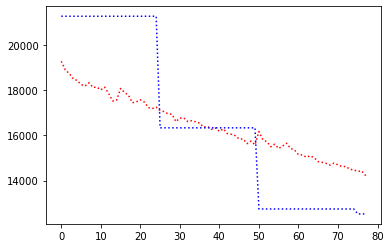

record the last path to gazebo for showing up


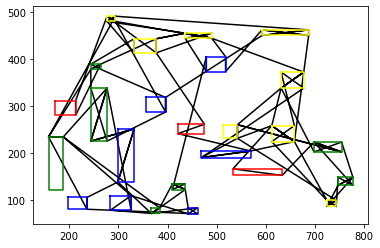

tensor([13.,  6., 20., 14.,  0.,  8., 21.,  6., 13., 14., 20., 20.,  8., 23.,
         5., 17.,  7., 22., 23., 14., 20., 13.,  6., 23., 17.,  5.,  8.,  5.,
        14., 21.,  8., 23.,  5.,  7., 12., 17.,  7., 17., 22., 15., 11., 12.,
        18.,  2., 24.,  9., 18., 12.,  3.,  4.,  7., 11., 10.,  9., 24., 18.,
        12., 24.,  4.,  3., 16., 19.,  1., 16.,  3.,  4., 10.,  1.,  9., 19.],
       device='cuda:0')
epoch:3, batch:400/2500, reward:14241.7890625


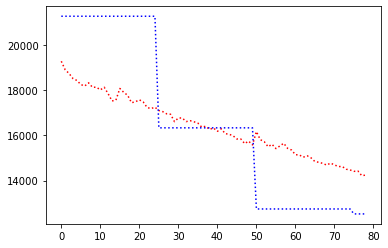

record the last path to gazebo for showing up


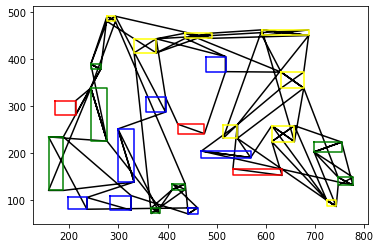

tensor([13.,  6., 14., 20.,  0., 21.,  8.,  8., 20., 14.,  6., 13., 20., 23.,
         5., 22., 23., 14.,  6., 13., 20., 23.,  5., 14., 15.,  8., 17.,  7.,
        12., 21.,  5., 17.,  7., 12., 17.,  8., 23.,  5., 22., 11., 18.,  9.,
        24.,  2., 12., 17.,  7., 18., 24.,  3.,  4., 10., 16.,  4.,  3., 19.,
        11.,  7., 12., 24., 18.,  9., 10.,  1., 16.,  1.,  9., 19.,  4.,  3.],
       device='cuda:0')
epoch:3, batch:500/2500, reward:14355.83203125


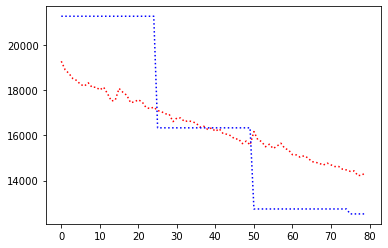

record the last path to gazebo for showing up


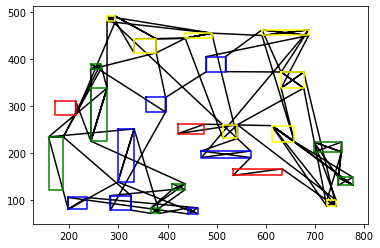

tensor([13.,  6., 20., 14.,  0.,  8., 21., 20., 20.,  6., 13., 14.,  8., 23.,
        14.,  6., 20., 13., 23.,  5., 22., 17.,  7.,  5., 17., 12., 23., 14.,
        21.,  8.,  5., 18., 12., 15.,  3.,  8., 23.,  5.,  7., 17., 18., 22.,
         2., 11., 24., 10.,  4.,  9., 17.,  7., 12., 12.,  7., 11., 24., 24.,
        18.,  9.,  1., 16., 19.,  3.,  4., 16.,  3., 10.,  1.,  4., 19.,  9.],
       device='cuda:0')
epoch:3, batch:600/2500, reward:14434.625


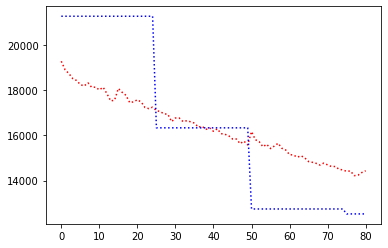

record the last path to gazebo for showing up


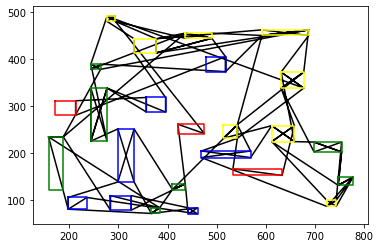

tensor([ 6., 20.,  0., 13., 14., 21., 14., 20.,  6., 13., 20.,  6., 20.,  8.,
        23.,  5., 22., 23.,  8., 14., 13., 14.,  8.,  8., 23.,  5., 17.,  5.,
        23., 21., 17., 11., 12., 15.,  7., 18.,  5., 22., 17.,  7., 12., 17.,
        18.,  7., 24., 12., 10., 24.,  2.,  9.,  3.,  4., 16.,  3., 19.,  4.,
        11.,  7., 12., 18., 24., 10.,  9.,  1.,  4., 16.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:3, batch:700/2500, reward:14405.013671875


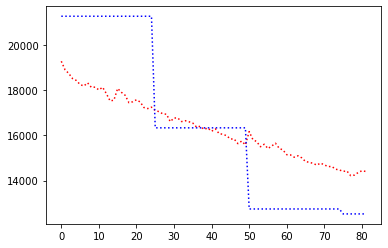

record the last path to gazebo for showing up


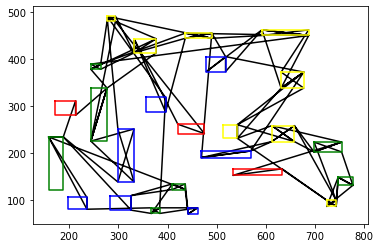

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14.,  6., 20., 20., 13.,  8., 14.,
        23., 14.,  6., 13., 20., 23.,  5., 17., 22.,  5.,  7., 17.,  8., 23.,
         8., 21., 15.,  5., 12.,  5., 23., 22., 17.,  7., 12., 18., 17., 11.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  3.,  4., 16.,  3.,  7., 24.,
        12., 24., 18.,  9.,  3.,  4., 19.,  1., 19., 10., 16.,  1.,  4.,  9.],
       device='cuda:0')
epoch:3, batch:800/2500, reward:14234.9912109375


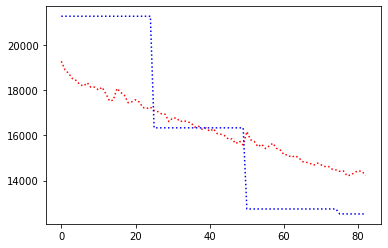

record the last path to gazebo for showing up


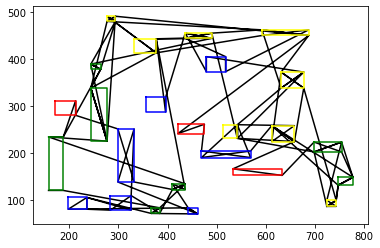

tensor([20., 13., 14.,  6.,  0., 21.,  8., 20., 14.,  6., 13.,  8., 20., 14.,
         6., 23., 23.,  5., 20., 23., 13., 14.,  8.,  5.,  5.,  7., 17., 12.,
        22., 17.,  7., 23., 15.,  8., 21.,  5., 17., 12.,  7., 18., 22., 17.,
        11., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 24.,  7., 18., 12., 11.,
         9.,  4.,  3., 16.,  1., 19.,  4., 16., 10., 24.,  3.,  9., 19.,  1.],
       device='cuda:0')
epoch:3, batch:900/2500, reward:14168.0244140625


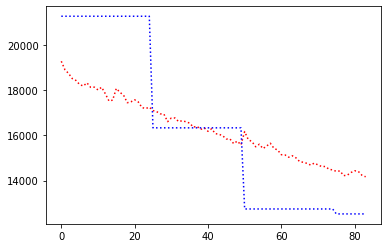

record the last path to gazebo for showing up


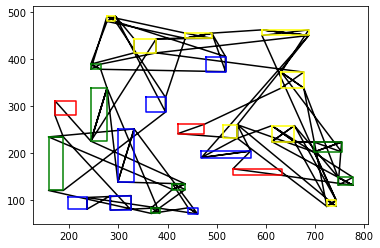

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 23., 23., 14., 20.,  6., 20., 13.,
         8., 14., 20., 13.,  6., 14., 17.,  5., 15.,  5.,  8., 23., 12.,  7.,
         5., 17.,  8., 21., 22.,  7., 17., 12., 11., 18.,  5., 23., 22., 17.,
        11.,  4.,  3.,  9., 24.,  2., 10., 16., 24.,  7., 12., 18., 12.,  7.,
        18., 24.,  9., 19.,  4.,  3.,  1., 16.,  3., 10., 19.,  1.,  4.,  9.],
       device='cuda:0')
epoch:3, batch:1000/2500, reward:14069.9140625


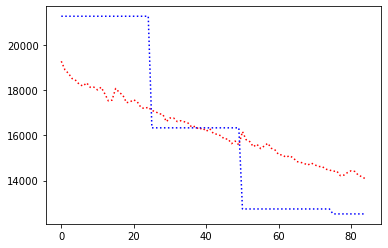

record the last path to gazebo for showing up


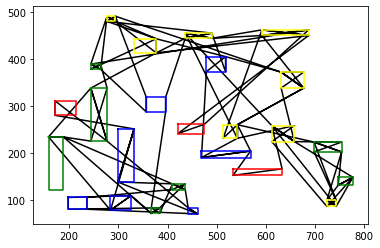

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 20., 13.,  8., 14.,
        23., 13., 14.,  6., 20., 23.,  8., 23.,  5., 22., 17.,  5., 17., 12.,
         7.,  8., 21.,  5., 22., 15., 11.,  7., 12., 17.,  5., 23., 17., 12.,
         7., 18., 24.,  9., 18., 24.,  2., 10.,  4.,  3., 11., 24., 18.,  7.,
        12.,  9.,  1., 16.,  3.,  4., 19., 10.,  3.,  9., 19., 16.,  4.,  1.],
       device='cuda:0')
epoch:3, batch:1100/2500, reward:14155.69140625


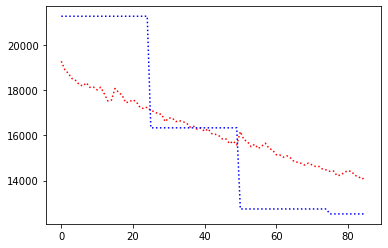

record the last path to gazebo for showing up


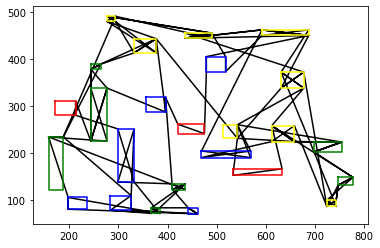

tensor([14., 20.,  0.,  6., 14.,  6., 13., 21.,  8., 20., 13., 14., 20.,  8.,
        23., 20., 13., 23., 15.,  5., 22., 17.,  6., 14., 23.,  5.,  8.,  5.,
        21.,  8., 23., 22., 17.,  7., 12.,  7.,  5.,  7., 12., 11., 18., 17.,
        17., 12., 18., 24.,  2.,  9., 24., 10.,  4.,  3., 16.,  3., 11.,  7.,
        18., 12.,  9., 24., 10.,  4., 19.,  1.,  3., 16.,  4.,  9., 19.,  1.],
       device='cuda:0')
epoch:3, batch:1200/2500, reward:14011.982421875


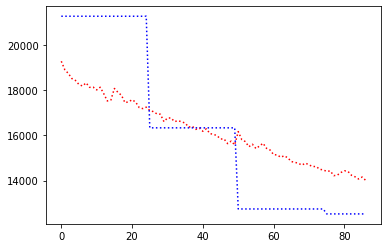

record the last path to gazebo for showing up


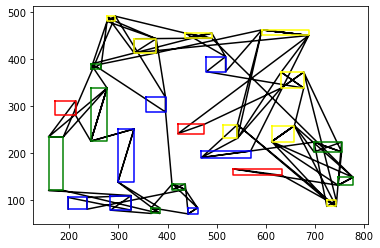

tensor([20., 13.,  6., 14.,  0., 21.,  8., 20.,  6., 13., 14., 20., 14.,  8.,
        23., 13.,  6., 20., 14., 23.,  5., 22.,  8.,  5., 17.,  7., 23.,  8.,
        21.,  5., 15.,  5., 12., 17., 11., 17.,  7., 12., 18., 23., 22., 12.,
         7., 18., 17.,  7., 24.,  2., 24.,  3.,  4., 11., 10., 16.,  3.,  9.,
         9.,  3., 24., 18., 12., 10.,  4.,  1., 19., 16.,  1.,  4., 19.,  9.],
       device='cuda:0')
epoch:3, batch:1300/2500, reward:14095.19140625


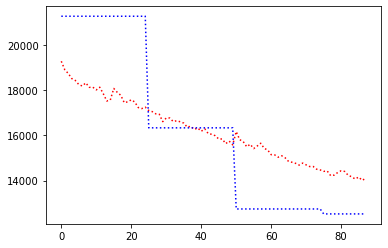

record the last path to gazebo for showing up


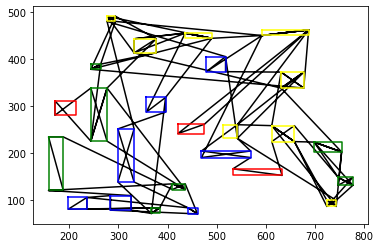

tensor([ 6., 20., 13.,  0., 14., 21.,  8.,  6., 14., 13., 20., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15., 18.,  5., 23., 21.,
         8.,  8., 23.,  5., 17., 17.,  7., 12.,  5., 22., 17.,  7., 24., 12.,
         7., 12., 18., 11., 24.,  2.,  9., 10.,  4.,  3., 16., 11.,  7., 12.,
        18., 24.,  9., 10., 19.,  4.,  3.,  1.,  4., 16.,  3.,  1., 19.,  9.],
       device='cuda:0')
epoch:3, batch:1400/2500, reward:13948.85546875


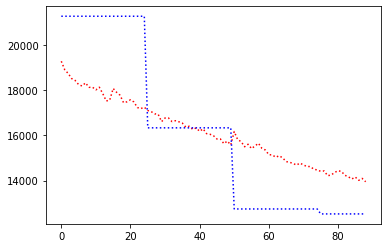

record the last path to gazebo for showing up


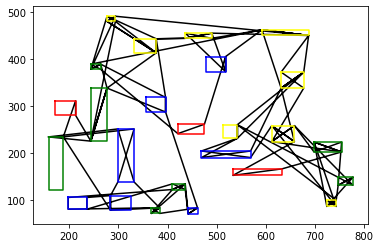

tensor([20.,  6., 13.,  0., 14., 21.,  8.,  6., 14., 20., 13., 20., 14.,  8.,
        23.,  6., 13., 20., 23.,  5., 22., 17., 15., 23., 23., 14.,  8.,  5.,
        17., 12.,  7.,  5., 21.,  8.,  5., 22., 17.,  7., 12., 18., 17., 11.,
         7., 12., 11., 18.,  9., 24.,  2., 10.,  4.,  3., 24.,  9.,  7., 12.,
        18., 24., 16.,  3.,  4.,  1., 19.,  1.,  4., 16., 10.,  3.,  9., 19.],
       device='cuda:0')
epoch:3, batch:1500/2500, reward:13924.771484375


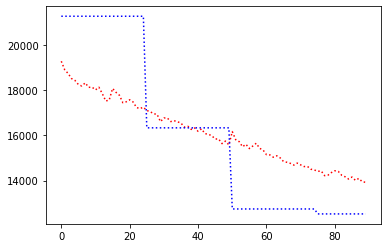

record the last path to gazebo for showing up


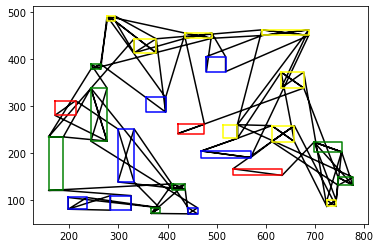

tensor([20., 14.,  0.,  6., 13., 21.,  8.,  5., 23., 20., 14., 14.,  6., 13.,
         8., 23., 20.,  6., 20., 13., 14.,  5., 23., 21.,  8., 22., 17., 17.,
         7., 12.,  5., 23.,  8., 15., 11.,  7.,  5., 22., 17.,  7., 12., 18.,
        17., 24., 12., 18.,  2.,  9., 11.,  7., 18., 24.,  4.,  3., 12.,  9.,
        10.,  4., 16.,  3., 19.,  1.,  3., 16., 10., 24.,  4.,  9.,  1., 19.],
       device='cuda:0')
epoch:3, batch:1600/2500, reward:13973.09375


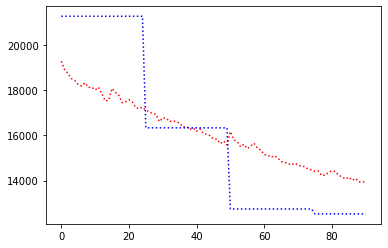

record the last path to gazebo for showing up


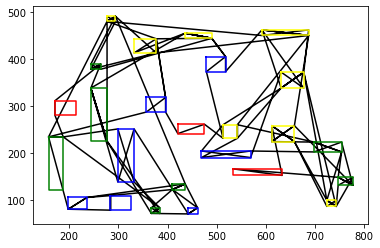

tensor([ 6., 13., 20.,  0., 14., 21.,  8., 20., 14.,  6.,  8., 23., 13., 20.,
         6., 14., 13., 14., 20.,  8., 23.,  5., 15., 22., 17.,  7., 11.,  5.,
        23., 17., 12.,  7., 17.,  7.,  5., 21., 23.,  8.,  5., 22., 17., 18.,
        12., 10., 12., 18.,  2., 24.,  9., 24., 11., 12.,  7., 18., 24.,  3.,
         4.,  9., 16.,  3.,  1.,  4., 19., 16.,  3., 10., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:3, batch:1700/2500, reward:13845.140625


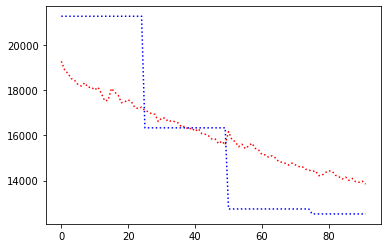

record the last path to gazebo for showing up


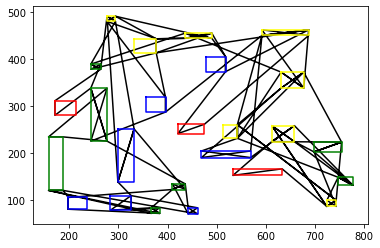

tensor([ 6., 20., 13.,  0., 21., 14.,  8., 14., 20.,  8.,  6., 13., 20.,  6.,
        14., 20., 13., 23.,  5., 17., 22., 23.,  5., 17.,  7., 23., 14., 21.,
         8.,  8., 15.,  5., 23.,  5., 17., 12.,  7., 12., 22., 17., 11.,  7.,
        12., 18., 24.,  2.,  9., 10.,  4.,  3., 18., 24., 11.,  7., 12., 18.,
        24.,  9., 10., 16.,  3.,  4., 19.,  3.,  1., 16.,  4.,  9.,  1., 19.],
       device='cuda:0')
epoch:3, batch:1800/2500, reward:13723.044921875


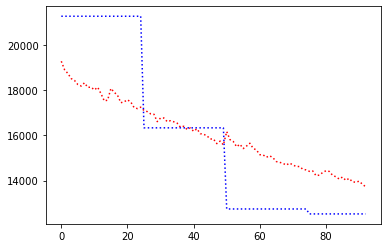

record the last path to gazebo for showing up


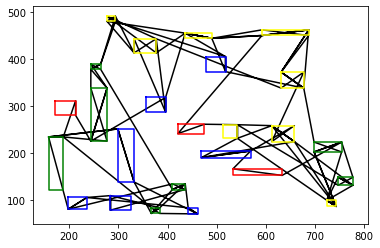

tensor([20., 13.,  6.,  0., 14.,  8., 21., 14., 20., 13.,  6., 20., 23.,  8.,
        14.,  6., 20., 13., 14., 23.,  5., 22., 17., 15.,  8., 23., 17.,  5.,
         7., 12.,  5., 21.,  8.,  5., 23., 17., 17., 22.,  7., 12., 18., 11.,
         7., 12., 18., 24.,  2.,  9.,  7., 10.,  3.,  4., 24., 11., 12., 18.,
         9., 19., 16.,  3.,  4.,  1., 10., 24., 16.,  3.,  9.,  1., 19.,  4.],
       device='cuda:0')
epoch:3, batch:1900/2500, reward:13822.0244140625


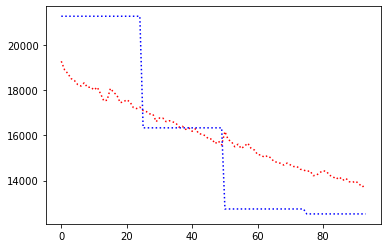

record the last path to gazebo for showing up


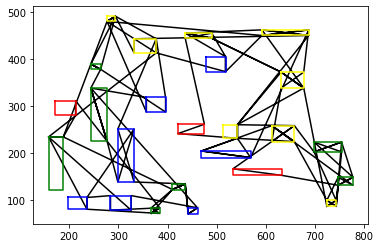

tensor([20.,  6., 13.,  0., 14., 21.,  8., 20., 14., 20.,  6.,  8., 13., 14.,
        23., 20.,  6., 14., 23., 22.,  5., 17., 13.,  8.,  5., 17.,  7.,  5.,
        23.,  8., 21., 15., 11., 23.,  5., 17., 12.,  7., 22., 17., 12., 18.,
        24.,  7., 18., 12., 24.,  9.,  2., 10.,  3.,  4., 11., 12.,  7., 24.,
        18.,  9., 19., 16.,  3.,  1.,  4., 16., 10.,  3., 19.,  9.,  4.,  1.],
       device='cuda:0')
epoch:3, batch:2000/2500, reward:13653.6220703125


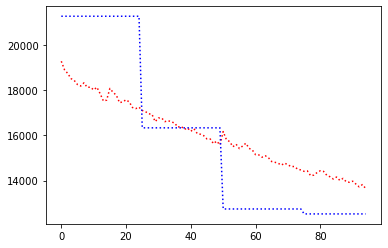

record the last path to gazebo for showing up


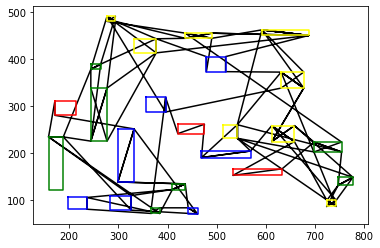

tensor([13., 20.,  6.,  0., 14., 21.,  8., 23., 20., 14., 13., 20.,  6., 13.,
        14., 23.,  8., 20.,  6., 14., 23.,  8.,  5., 17., 12.,  5.,  8.,  5.,
        22., 17., 15., 21., 23.,  5.,  7., 17., 18., 22., 17., 11.,  7., 18.,
        12.,  2., 24.,  9., 10., 24.,  7., 12., 12., 11.,  7., 18., 10.,  3.,
         4., 19., 16.,  3.,  4.,  1.,  9., 24., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:3, batch:2100/2500, reward:13716.53125


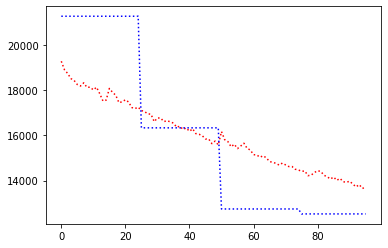

record the last path to gazebo for showing up


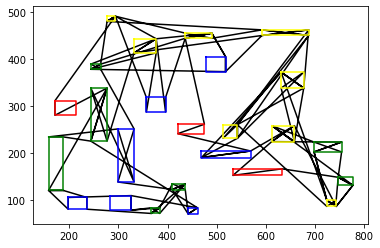

tensor([20.,  6.,  0., 13., 14.,  8., 21., 20., 14., 13., 20.,  6.,  8., 23.,
        14., 13.,  6., 20., 23.,  5., 22., 17.,  5., 17.,  7., 23., 14.,  8.,
         8., 15., 21., 23.,  5., 12., 17., 12.,  7., 17.,  5., 22., 12., 11.,
         7., 18., 24.,  2.,  9., 10.,  4.,  3.,  7., 11., 24., 18., 18., 12.,
        24.,  3.,  9.,  1., 16., 19.,  3.,  4.,  1., 16.,  4., 10., 19.,  9.],
       device='cuda:0')
epoch:3, batch:2200/2500, reward:13680.806640625


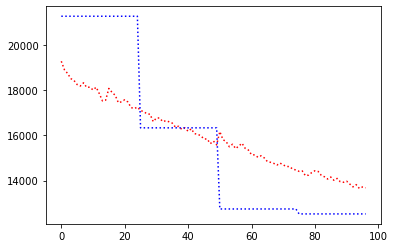

record the last path to gazebo for showing up


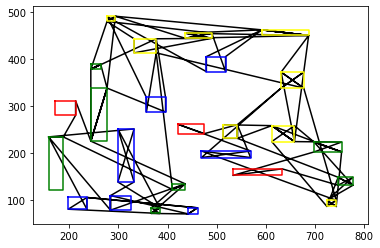

tensor([20., 13.,  6.,  0., 14.,  8., 21., 23., 14., 20.,  6., 13., 23., 14.,
        20.,  8., 20.,  6., 13., 14., 21., 23.,  5., 22., 17., 15.,  3.,  5.,
         8., 17.,  7., 12., 17.,  7.,  5., 23.,  5.,  8., 22., 17., 12., 18.,
        24., 11.,  7., 12., 24., 18.,  9.,  2., 10.,  3.,  4., 16., 11.,  7.,
        12., 18., 24.,  9.,  1., 16., 19.,  4.,  3., 10.,  4.,  9.,  1., 19.],
       device='cuda:0')
epoch:3, batch:2300/2500, reward:13519.46875


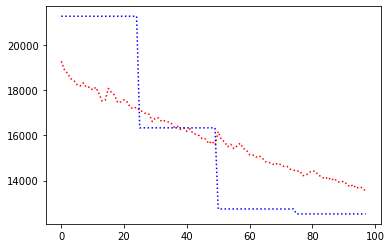

record the last path to gazebo for showing up


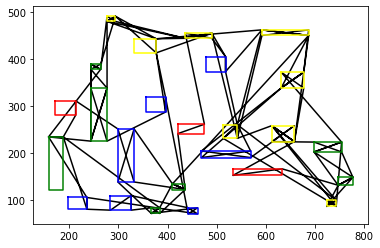

tensor([13.,  6., 20.,  0., 14., 21., 20.,  6., 13., 14., 23.,  8., 14., 20.,
         8.,  6., 20., 13., 14., 23.,  5.,  8., 23.,  5., 22., 17., 15., 21.,
         8., 23.,  5., 17.,  7., 12., 17.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18.,  2., 24.,  9., 10.,  4.,  3., 11., 18.,  7., 12.,
        24.,  1., 16.,  3., 19.,  4.,  9., 10.,  3.,  4., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:3, batch:2400/2500, reward:13504.7265625


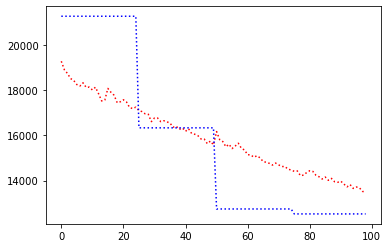

record the last path to gazebo for showing up


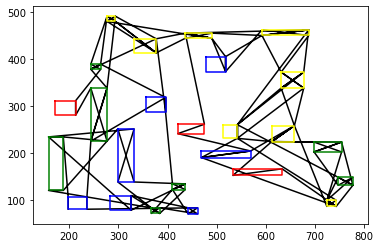

tensor([20., 13.,  0.,  6., 14., 21.,  8., 14., 20.,  6., 20., 13.,  8., 23.,
        14., 13., 20.,  6.,  8., 23., 23.,  5., 22., 17., 15.,  5., 12., 17.,
         7., 14.,  8., 21., 22., 23., 17.,  5.,  5.,  4., 17.,  7., 12., 18.,
         7., 12., 11.,  2., 18., 24.,  9.,  3., 10., 16., 11., 18., 24., 12.,
         7., 24., 10.,  3.,  4., 19.,  1.,  9.,  1.,  3., 16.,  4.,  9., 19.],
       device='cuda:0')
epoch:3, batch:2500/2500, reward:13437.994140625


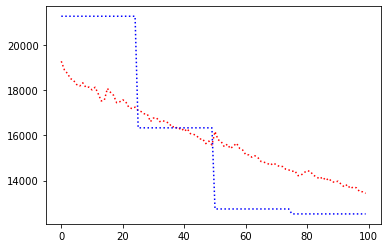

record the last path to gazebo for showing up


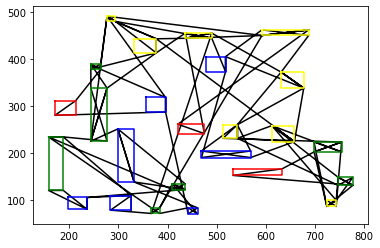

R_val =  tensor(11360.4307, device='cuda:0')
C_val =  12527.6201171875
Avg Actor 11360.4306640625 --- Avg Critic 12527.6201171875
My actor is going on the right road Hallelujah :) Updated
Epoch: 3, epoch time: 155.378min, tot time: 0.433day, L_actor: 11360.431, L_critic: 12527.620, update: True
Save Checkpoints
tensor([ 6., 13., 20., 14.,  0.,  8., 21., 20., 14., 23.,  8., 20.,  6., 13.,
        14.,  6., 20., 13., 23.,  8., 14., 23., 22.,  5., 17., 15., 21.,  8.,
         5., 17.,  7., 12.,  5., 23.,  5., 17., 22., 17., 12., 11.,  7., 18.,
        12., 24.,  2., 10., 11.,  7.,  7., 12., 18., 24.,  9.,  3.,  4., 19.,
        16.,  3.,  4.,  1.,  9., 24., 10., 16.,  3., 18.,  1.,  9., 19.,  4.],
       device='cuda:0')
epoch:4, batch:100/2500, reward:14090.046875


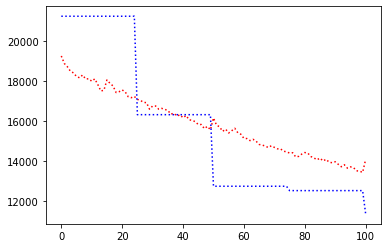

record the last path to gazebo for showing up


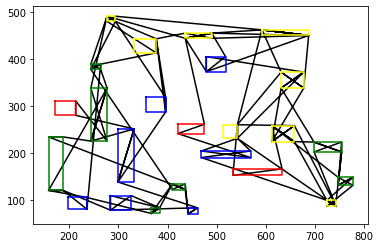

tensor([20., 13.,  6., 14.,  0., 21.,  8., 20., 14., 13.,  6.,  8., 23., 20.,
        14.,  6., 20., 13., 23.,  5., 17., 22., 15.,  5., 14., 23.,  8., 21.,
         8., 23.,  5.,  5., 17., 17., 12.,  7., 18., 12.,  7., 22., 17., 11.,
         7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 24.,  9.,
         4.,  3., 16., 19.,  1.,  9., 18., 24., 10., 16.,  3.,  4.,  1., 19.],
       device='cuda:0')
epoch:4, batch:200/2500, reward:13629.1611328125


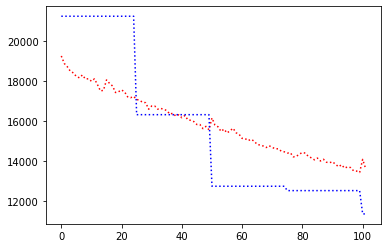

record the last path to gazebo for showing up


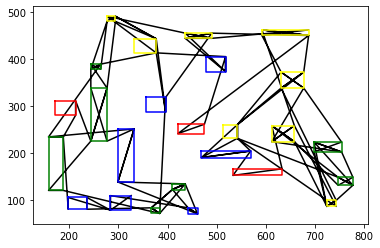

tensor([ 6., 20., 13.,  0., 14., 23., 21.,  8., 20., 14.,  6., 13., 20., 20.,
        14., 23.,  8.,  6., 13., 14., 23.,  8.,  8.,  5., 22.,  5., 17., 15.,
        21.,  5.,  5., 23., 17., 12., 17.,  7.,  7., 22., 17., 12., 18., 11.,
         7., 12., 18.,  9., 24.,  2., 10.,  3.,  4., 11.,  7., 12., 24., 18.,
        24.,  1.,  3., 19.,  4., 16.,  9., 10.,  3.,  4., 16.,  9.,  1., 19.],
       device='cuda:0')
epoch:4, batch:300/2500, reward:13732.181640625


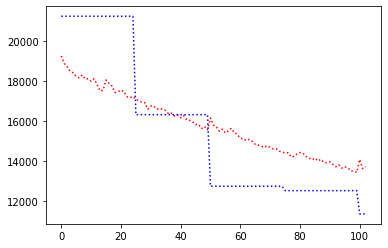

record the last path to gazebo for showing up


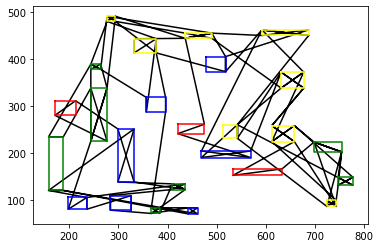

tensor([20., 13.,  6., 14.,  0., 21.,  8., 20., 14., 23., 20.,  6., 13.,  8.,
        20.,  6., 14., 13.,  8., 23., 23.,  5., 22., 17., 15., 21.,  5., 14.,
         8., 23., 11.,  7., 12., 18., 17., 12., 17.,  5.,  7.,  5., 22.,  7.,
        18., 12., 17., 24.,  9.,  2., 24.,  4.,  3., 10., 16., 19.,  3.,  4.,
         7., 11., 12., 18., 24.,  9.,  3.,  1., 16., 10.,  4.,  9., 19.,  1.],
       device='cuda:0')
epoch:4, batch:400/2500, reward:13520.9169921875


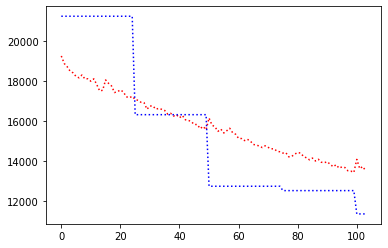

record the last path to gazebo for showing up


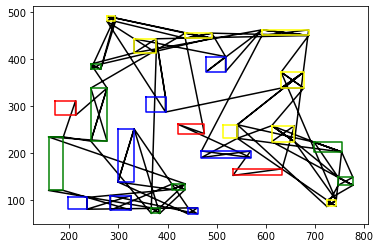

tensor([20.,  6., 13., 14.,  8.,  0., 21., 14., 20.,  6., 13., 20., 20., 23.,
         8., 14.,  6., 23.,  5., 23.,  5., 13., 21.,  8., 14.,  8., 15., 22.,
        17., 17.,  7., 12.,  5., 17.,  5., 23., 22., 12., 18.,  7., 24., 17.,
        11., 11.,  7., 12., 24., 18.,  2.,  9., 10., 18.,  7., 12.,  3.,  4.,
        16., 16.,  4.,  3., 19.,  1.,  9., 24., 10.,  3.,  1., 19.,  4.,  9.],
       device='cuda:0')
epoch:4, batch:500/2500, reward:13606.904296875


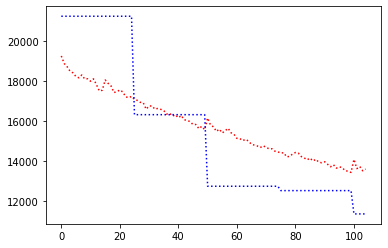

record the last path to gazebo for showing up


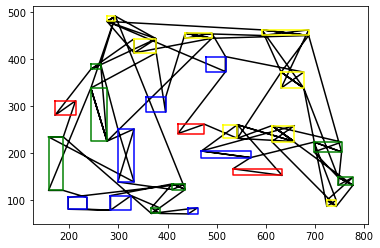

tensor([ 6., 20., 13.,  8., 14.,  0., 21., 20., 14.,  6., 13., 20., 23., 14.,
         8., 23.,  5., 22.,  6., 20., 13., 23.,  5., 17.,  7., 12.,  8., 14.,
        21.,  8., 15., 17.,  7., 12., 11.,  5., 17., 17., 23.,  5., 22.,  7.,
        18., 12., 12., 11.,  7., 24., 18.,  2., 24.,  9., 10.,  3.,  4.,  3.,
        16.,  4., 19.,  1.,  9., 18., 24., 10., 16.,  3.,  4.,  1.,  9., 19.],
       device='cuda:0')
epoch:4, batch:600/2500, reward:13372.4365234375


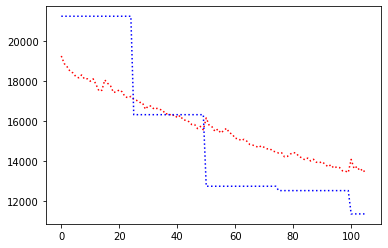

record the last path to gazebo for showing up


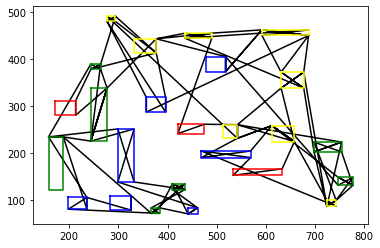

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 20.,  6., 13., 20., 14.,  8., 23.,
        14.,  6., 20., 13., 14., 23.,  5., 22., 17.,  8.,  8., 23., 21.,  3.,
         5., 15., 17., 12., 17.,  5., 23., 22.,  7.,  5.,  7., 12.,  2., 18.,
        11., 24.,  9., 17.,  7., 18., 12., 24., 10.,  4., 11.,  7., 12., 18.,
        24., 10.,  9.,  1., 16.,  3.,  4., 19., 16.,  4.,  3.,  9.,  1., 19.],
       device='cuda:0')
epoch:4, batch:700/2500, reward:13561.6181640625


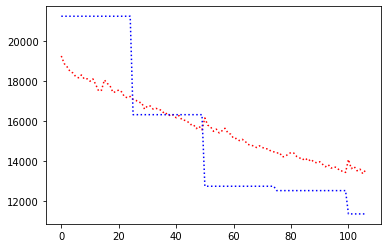

record the last path to gazebo for showing up


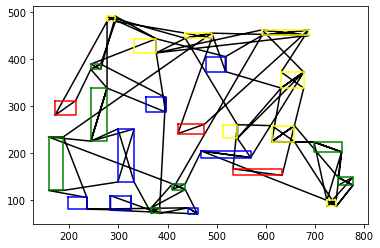

tensor([ 6., 13., 20., 14.,  0., 21.,  8., 20., 14.,  6., 20., 13., 14.,  6.,
        20., 23.,  8., 13.,  5., 23., 17., 22., 15.,  8., 23., 14.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23., 22.,  5., 17.,  7., 24., 12., 18.,
        11.,  9., 18., 11.,  7., 12., 24.,  2.,  4.,  3.,  1.,  3., 10., 16.,
         4.,  9.,  7., 12., 18., 24., 10., 16., 19.,  3., 19.,  1.,  4.,  9.],
       device='cuda:0')
epoch:4, batch:800/2500, reward:13378.7783203125


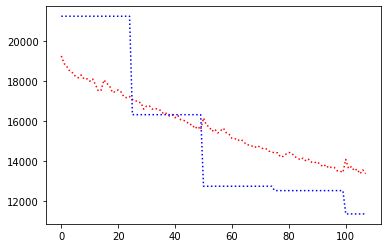

record the last path to gazebo for showing up


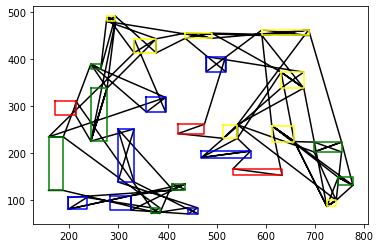

tensor([20.,  6., 13., 14.,  0., 21.,  8., 20.,  6., 14., 23.,  8., 20., 14.,
        13.,  6., 20., 13., 23.,  5., 22., 17., 11., 15.,  7., 12., 18.,  5.,
        17.,  7., 23.,  8., 14., 23., 21.,  3.,  8.,  5., 17., 12., 12.,  7.,
         5., 22., 17.,  9., 24.,  2., 10.,  4.,  9., 18., 24.,  7., 11., 18.,
        12., 24.,  1.,  3., 16., 19.,  4., 10., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:900/2500, reward:13733.1533203125


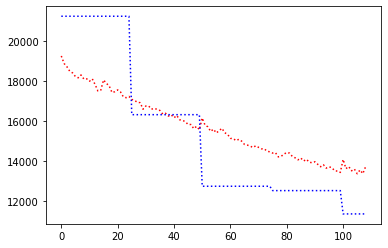

record the last path to gazebo for showing up


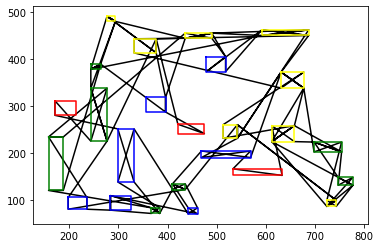

tensor([ 6., 20., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20.,  8., 23.,
        14., 13., 20.,  6., 14., 23.,  5., 22., 17.,  7., 23.,  8.,  5.,  7.,
        12., 17., 17.,  5.,  8., 23.,  5., 15., 21., 22., 17.,  7.,  3., 11.,
        12., 18.,  2., 24., 10.,  4., 12., 18., 24., 11.,  7., 12., 18., 24.,
         9., 16.,  3., 19.,  4.,  9.,  1., 16.,  3., 10.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:4, batch:1000/2500, reward:13547.7421875


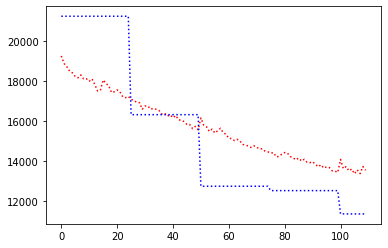

record the last path to gazebo for showing up


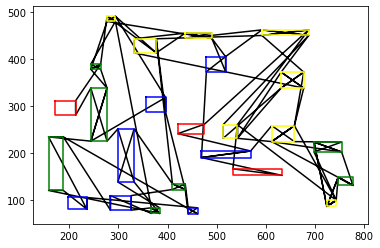

tensor([20.,  6., 13., 14.,  0.,  8., 21., 20., 14., 20.,  6., 13.,  8., 23.,
        14.,  6., 13., 20.,  8., 23.,  5., 22., 15., 17.,  7.,  5., 17., 12.,
         7., 23., 14., 21.,  8., 23.,  5., 17.,  7.,  5., 22., 17., 12., 18.,
        24., 11., 12., 24., 18.,  2.,  9., 11.,  3.,  4., 10.,  3., 16.,  4.,
        19.,  7., 12., 18., 24.,  9.,  1., 10.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:4, batch:1100/2500, reward:13340.59375


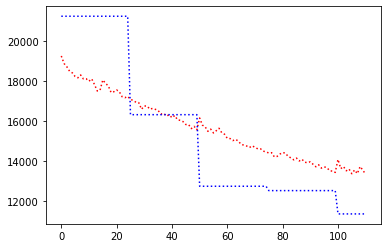

record the last path to gazebo for showing up


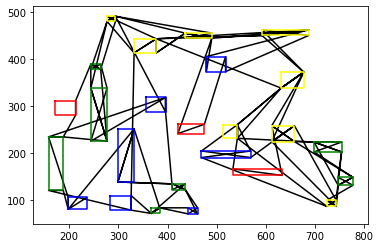

tensor([ 6., 20., 14., 13.,  0., 21.,  8., 14., 20.,  6., 13., 20.,  8., 23.,
        14.,  6., 20., 14., 13., 23.,  5., 22., 17., 15., 23.,  8.,  5., 17.,
         7.,  7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17., 12., 18., 24.,
        11.,  7., 12., 18.,  2., 24., 11.,  4.,  3., 10., 16.,  4.,  9.,  1.,
         3., 19.,  9.,  7., 18., 12., 24., 10.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:1200/2500, reward:13359.4453125


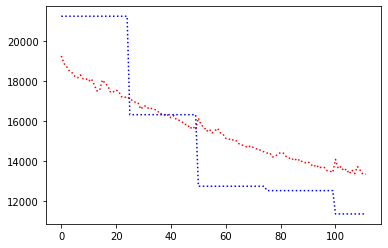

record the last path to gazebo for showing up


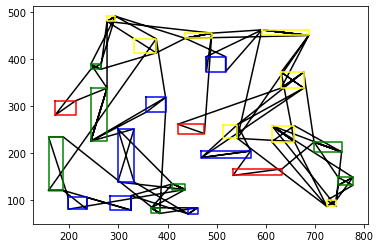

tensor([ 6., 20., 14., 13.,  0., 21.,  8., 20.,  6., 20., 13., 14., 23.,  8.,
        14.,  6., 23., 20., 13., 14., 23., 22.,  5., 17.,  7., 15.,  8.,  5.,
        17., 12.,  7., 17.,  8., 23.,  5., 21.,  5., 22.,  7., 12., 18., 24.,
        17., 11.,  7., 18., 11., 12., 24.,  9., 18., 10.,  3.,  4.,  2.,  9.,
        12., 24.,  1., 16.,  3.,  4., 19., 16., 10.,  3.,  9.,  1.,  4., 19.],
       device='cuda:0')
epoch:4, batch:1300/2500, reward:13222.240234375


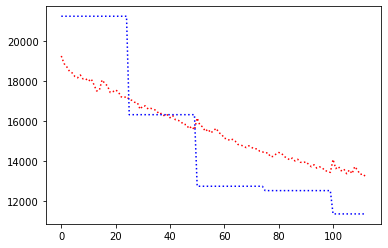

record the last path to gazebo for showing up


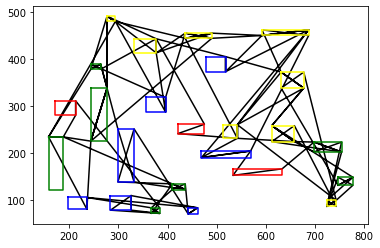

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 23., 14.,
         8.,  6., 23.,  5., 22., 17., 13., 20.,  8., 14., 21., 23.,  5., 17.,
        12.,  7.,  5., 17., 15.,  8., 23.,  5., 22., 17.,  7., 18., 12., 11.,
        12.,  7., 18., 24.,  2.,  9., 10.,  3.,  4.,  4., 16., 24.,  9.,  7.,
        18., 11., 12., 24.,  3., 19.,  1., 10., 16.,  4.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:1400/2500, reward:13244.595703125


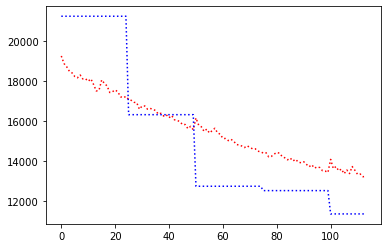

record the last path to gazebo for showing up


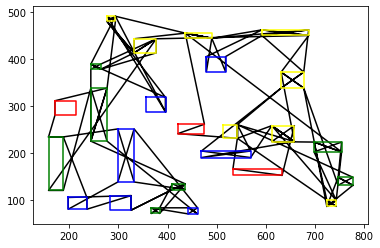

tensor([20.,  6., 14., 13.,  0.,  8., 21., 20.,  6., 14., 13., 20., 20., 23.,
         5., 22., 23.,  8., 14., 13.,  6., 14.,  8., 23., 21., 15., 17., 11.,
         8.,  5.,  7., 12., 17., 17.,  5., 22., 23.,  5., 17., 12.,  7., 18.,
        24.,  9.,  7., 12., 18., 24., 10.,  3., 11.,  7., 12., 18.,  2.,  4.,
        16.,  3., 19.,  4.,  9., 24., 10.,  1.,  3., 16.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:4, batch:1500/2500, reward:13272.0986328125


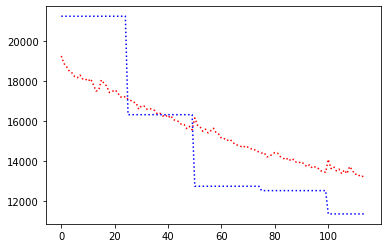

record the last path to gazebo for showing up


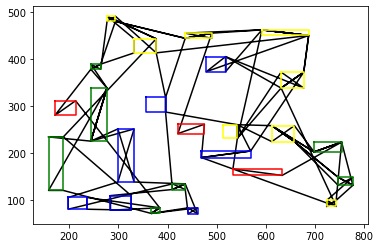

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 23., 14., 20.,  6., 20., 13., 23.,
         8., 14.,  6., 13., 20., 14., 23.,  5.,  8.,  5., 22., 17., 18.,  7.,
        15.,  8., 21., 22.,  5., 17., 12.,  7., 17.,  5., 23., 17.,  7., 11.,
        12., 24.,  2.,  9., 10.,  3.,  4., 24., 18., 12., 11.,  7., 12., 18.,
        24.,  9.,  1.,  3., 16., 19.,  4.,  3., 10., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:1600/2500, reward:13312.4423828125


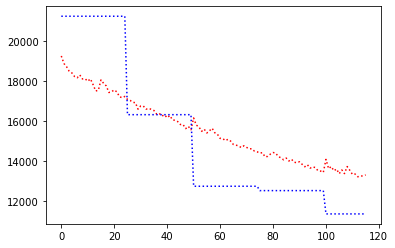

record the last path to gazebo for showing up


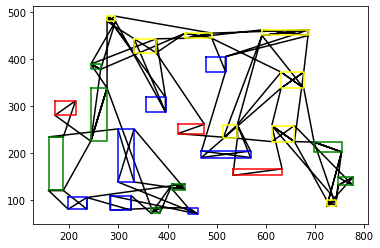

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14.,  8.,
        23.,  5., 23., 17., 22.,  6., 13., 20., 14.,  8., 23.,  5., 15., 21.,
         8., 23.,  5., 17.,  7., 12., 17.,  7., 18., 22.,  5., 17., 12., 24.,
        11.,  7., 12., 18.,  2., 24.,  9., 10.,  4.,  3., 16.,  3.,  4., 11.,
         7., 18., 12., 10., 19.,  1.,  9., 16.,  3., 24.,  1.,  4., 19.,  9.],
       device='cuda:0')
epoch:4, batch:1700/2500, reward:13108.2138671875


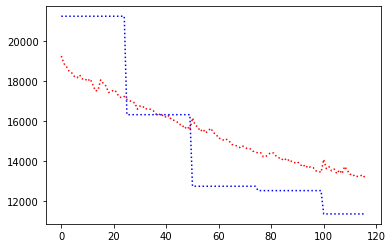

record the last path to gazebo for showing up


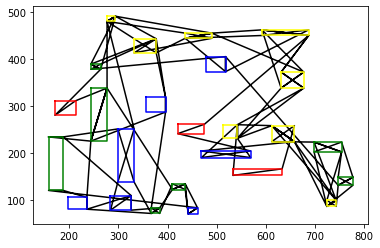

tensor([ 6., 20., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 23.,  8.,
        14., 20.,  6., 13., 23., 14., 23.,  5., 22., 24., 17., 15.,  8., 21.,
         8.,  5., 17., 12.,  7.,  5., 17., 23.,  5., 22., 17.,  7., 18., 12.,
         7., 24., 12., 11.,  3., 11.,  7., 12., 18.,  2.,  9., 10.,  4., 18.,
         3., 16.,  4.,  9.,  1., 19., 19.,  4.,  3., 16., 10., 24.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:1800/2500, reward:13136.6572265625


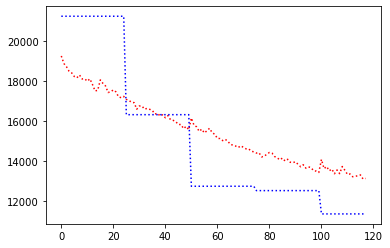

record the last path to gazebo for showing up


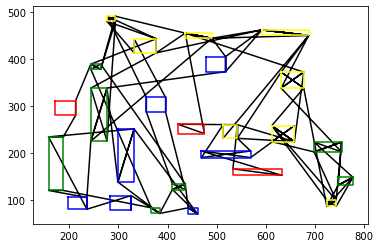

tensor([ 6., 20., 13.,  0., 14.,  8., 20., 14.,  6., 13., 23., 20., 21., 23.,
         5., 20., 14.,  8.,  6.,  8., 23.,  5., 13., 14.,  8., 21., 22., 17.,
        15., 11., 17., 12.,  7.,  5., 23.,  5., 22., 17.,  7., 18., 12.,  3.,
         4., 17.,  7., 12., 18.,  2.,  9., 24., 10.,  3.,  4., 16., 24.,  7.,
        11., 12., 18., 24.,  1., 19.,  9.,  4.,  3., 16., 10., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:1900/2500, reward:13060.4599609375


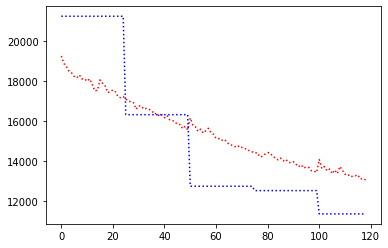

record the last path to gazebo for showing up


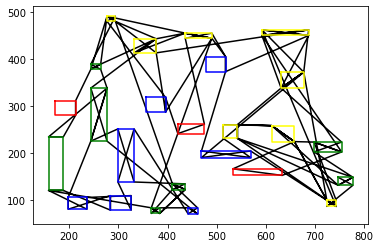

tensor([ 6., 20., 13., 14.,  0., 20.,  6., 14., 21.,  8., 13., 20., 14., 23.,
         8.,  6., 13., 20., 23.,  5., 22., 17., 15.,  8., 23., 14., 21.,  5.,
        17., 12.,  7.,  5.,  5.,  8., 23., 22., 17.,  7., 12., 24., 17.,  7.,
        11., 24., 12., 18.,  2.,  9., 10.,  3.,  4., 18.,  7., 11., 12., 18.,
        24.,  9.,  1., 16.,  3.,  4., 19., 16.,  3.,  4., 10., 19.,  9.,  1.],
       device='cuda:0')
epoch:4, batch:2000/2500, reward:12999.5029296875


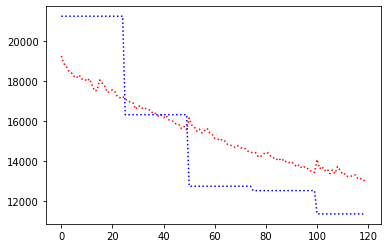

record the last path to gazebo for showing up


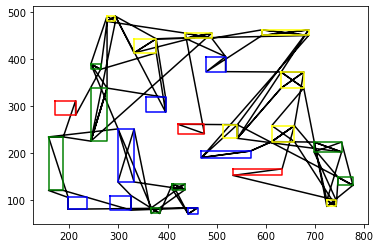

tensor([20.,  6., 13., 14.,  0., 21.,  8., 20., 13., 14.,  6., 20.,  8., 23.,
        14.,  6., 20., 13., 23.,  5., 22., 17.,  8., 14., 21.,  8., 23.,  5.,
        15., 23., 22.,  5., 17.,  7., 12., 17.,  5., 17.,  7., 12., 18.,  7.,
        12., 11., 18.,  9., 24.,  2., 10.,  3.,  4., 11.,  7., 12., 18., 24.,
        24., 10., 16.,  3.,  4., 19.,  1.,  9.,  4., 16.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:4, batch:2100/2500, reward:12956.5537109375


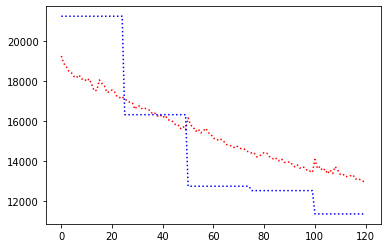

record the last path to gazebo for showing up


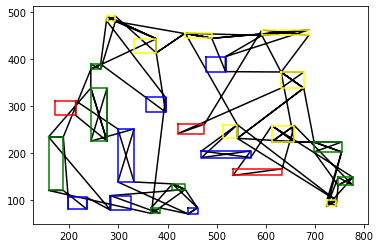

tensor([20.,  6., 13., 14.,  0., 21.,  8., 20., 14.,  6., 13., 20., 14.,  8.,
        23., 23.,  5., 22., 17., 13., 20.,  6., 14.,  8., 23.,  8., 21., 15.,
        11.,  7., 12., 17.,  5.,  7., 12., 17.,  5.,  5., 23., 22., 17.,  7.,
        18., 12., 24., 24., 18.,  2.,  9., 10.,  4.,  3., 11.,  7., 18., 12.,
        24.,  9., 16.,  4.,  3., 19., 16.,  1., 10.,  1.,  4.,  3., 19.,  9.],
       device='cuda:0')
epoch:4, batch:2200/2500, reward:12846.796875


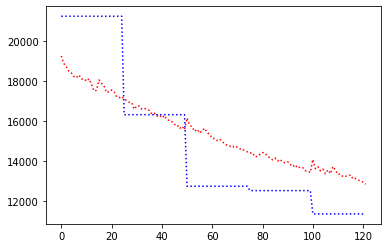

record the last path to gazebo for showing up


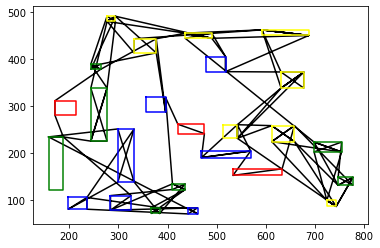

tensor([20.,  6.,  0., 13., 14., 21.,  8., 20., 14., 13.,  6.,  8., 20., 14.,
        13., 20.,  6., 23., 23.,  5., 22., 17., 15.,  8., 23., 14., 21.,  5.,
        17., 12.,  7., 17.,  8., 23.,  5., 22.,  5., 17.,  7., 18., 12., 24.,
        11., 18.,  7., 12.,  2., 24.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  4.,  3., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:4, batch:2300/2500, reward:12915.373046875


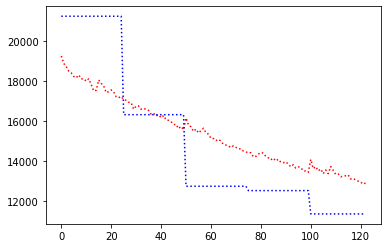

record the last path to gazebo for showing up


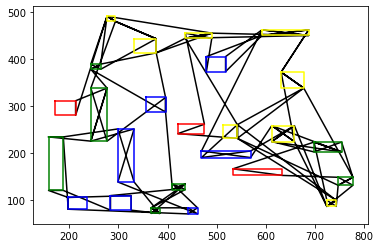

tensor([20.,  6., 13., 14., 21.,  0.,  8.,  6., 20., 14., 20., 13., 20., 14.,
         8.,  6., 23., 13., 23.,  8., 14., 23.,  5., 17., 12.,  7., 17.,  5.,
        22., 17., 15., 21.,  8.,  5.,  5., 23., 22.,  7., 18., 24., 12., 11.,
         7., 12., 18., 24.,  9.,  2., 17., 11.,  7., 18., 12., 24., 10.,  3.,
         4.,  1., 16.,  3.,  4., 19.,  9.,  1.,  4.,  3., 10., 16., 19.,  9.],
       device='cuda:0')
epoch:4, batch:2400/2500, reward:12776.48046875


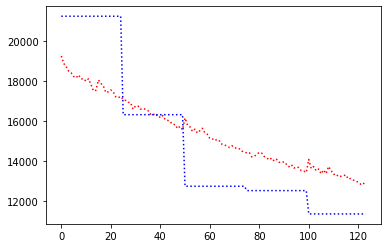

record the last path to gazebo for showing up


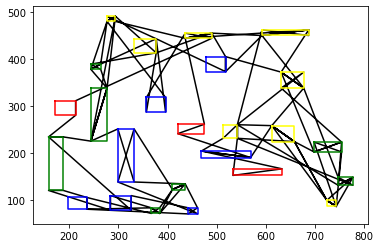

tensor([ 6., 20., 14., 13.,  0., 21.,  8.,  6., 14., 20., 13., 23.,  8., 20.,
        14., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 21., 23.,  5.,
        17., 12.,  7., 17.,  5.,  8.,  5., 23., 22., 17.,  7., 12., 18., 11.,
         7., 12., 18.,  9., 24.,  2., 10.,  3.,  4., 11.,  7., 12., 24., 16.,
         3.,  4.,  9., 18., 24., 10.,  1., 19.,  3.,  4.,  1., 16., 19.,  9.],
       device='cuda:0')
epoch:4, batch:2500/2500, reward:12873.693359375


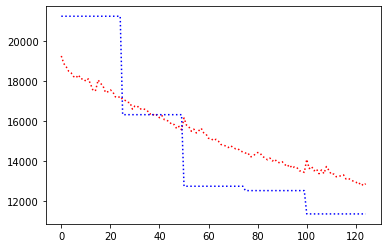

record the last path to gazebo for showing up


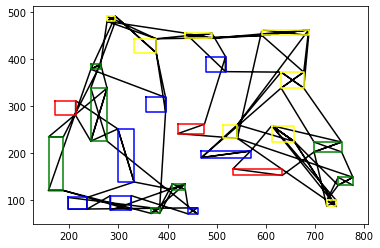

R_val =  tensor(11080.0957, device='cuda:0')
C_val =  11360.4306640625
Avg Actor 11080.095703125 --- Avg Critic 11360.4306640625
My actor is going on the right road Hallelujah :) Updated
Epoch: 4, epoch time: 157.260min, tot time: 0.542day, L_actor: 11080.096, L_critic: 11360.431, update: True
Save Checkpoints
tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 14., 20.,  8.,  6., 13., 20.,
        23., 14., 13.,  6., 20.,  8., 14.,  5., 22., 17., 15.,  8., 23.,  5.,
         7., 17., 12., 17.,  5., 21., 23.,  5., 22., 17., 12.,  7., 18., 24.,
        11.,  7., 12., 18.,  9., 24.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24.,  9.,  1.,  4., 16.,  3., 19., 16., 10.,  3., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:100/2500, reward:12711.73046875


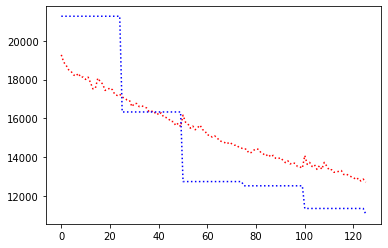

record the last path to gazebo for showing up


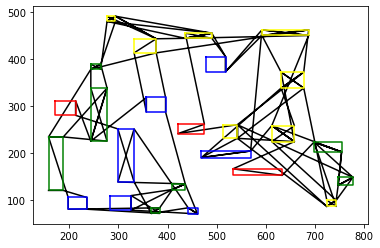

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20., 13.,  8.,  6., 20., 14.,
        23., 20.,  6., 13.,  8., 23.,  5., 22., 17., 15.,  4., 23., 14., 21.,
         5., 17.,  7., 12., 17., 23.,  8.,  5.,  5., 22., 17.,  7., 12., 18.,
        24., 11.,  7., 12., 18., 24.,  2.,  9., 10.,  3., 12.,  7., 11., 18.,
        24., 10., 16.,  3.,  1.,  4., 19.,  9.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:200/2500, reward:12824.3671875


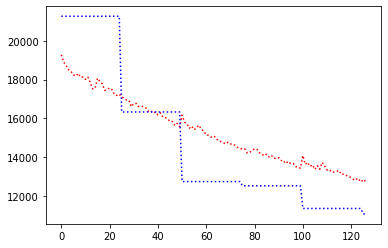

record the last path to gazebo for showing up


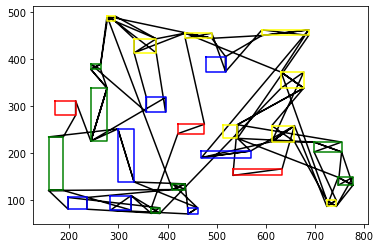

tensor([20.,  6., 14., 13.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14.,  8.,
        23.,  6., 13., 20., 14., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12.,  5., 17., 21., 23.,  8., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:300/2500, reward:12802.109375


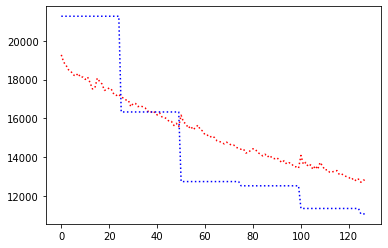

record the last path to gazebo for showing up


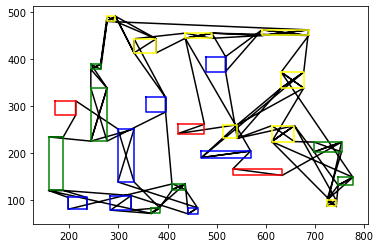

tensor([13., 20.,  6., 14.,  8.,  0., 21., 23., 20., 14., 13., 20.,  6., 14.,
         6., 20., 13.,  8., 23.,  5., 22., 17., 15., 14.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5.,  5., 21.,  8., 23., 22., 17.,  7., 12., 24., 11.,
         7., 12., 18.,  2., 24.,  9., 10.,  3.,  4., 18., 12., 11.,  7., 18.,
        24., 10., 16.,  3.,  4.,  1., 19.,  9., 16.,  4., 19.,  3.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:400/2500, reward:12745.423828125


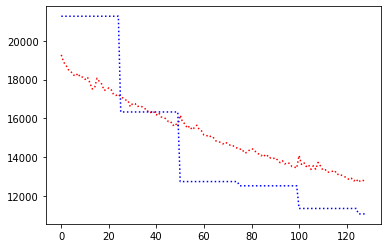

record the last path to gazebo for showing up


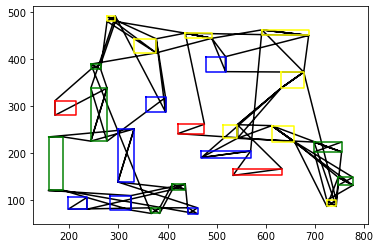

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20., 13.,  6., 20., 23., 14.,
         6., 13., 20., 23.,  5., 22.,  8., 14., 23.,  5.,  8.,  8., 15., 17.,
        11.,  7., 12., 17.,  7., 12., 17., 21., 23.,  5.,  5., 17., 22., 24.,
         7., 12., 18., 12.,  7., 11., 18., 24., 18., 24.,  2.,  9., 10.,  3.,
         4., 16.,  3.,  4., 19.,  1.,  9., 10.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:500/2500, reward:12707.501953125


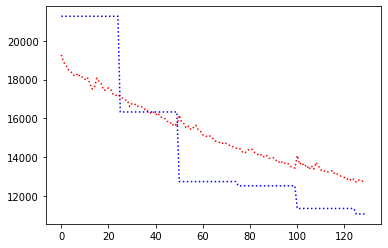

record the last path to gazebo for showing up


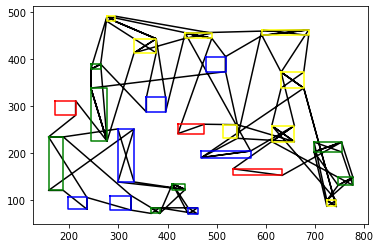

tensor([20., 13.,  6., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20., 13.,  6., 14., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12.,  3., 11.,
         7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11., 18., 24., 12.,  7.,
        18., 24., 10.,  9.,  1., 16., 19.,  4.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:600/2500, reward:12619.3134765625


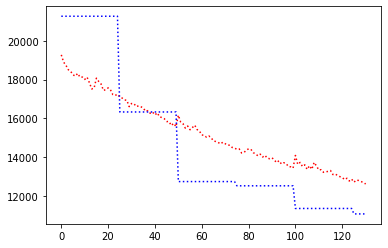

record the last path to gazebo for showing up


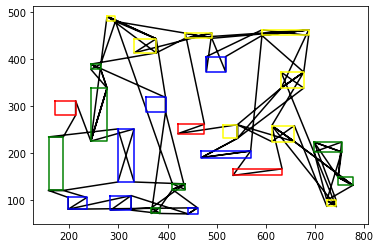

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 20., 14.,  6., 20., 13., 14.,  8.,
        23.,  6., 20., 13., 23.,  5., 17., 22., 15.,  8.,  5., 23., 14., 21.,
         8., 17., 12.,  7., 17.,  5., 23.,  5., 22., 17., 12.,  7., 18., 24.,
        11.,  7., 12., 24., 18.,  9.,  2., 10.,  4.,  3.,  9.,  1., 16.,  3.,
        11.,  7., 12., 18., 24., 10., 16.,  4., 19.,  3., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:700/2500, reward:12582.205078125


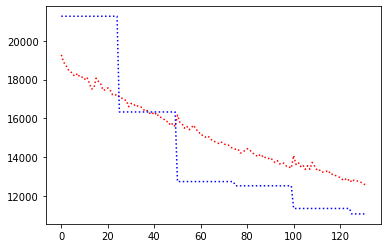

record the last path to gazebo for showing up


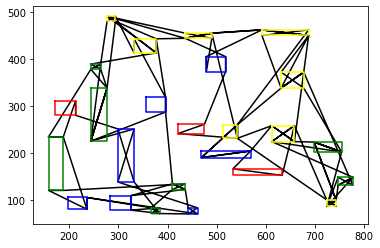

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20.,  6., 13., 14.,  8., 23.,  5., 17., 22., 15.,  7.,  5., 23.,
        17., 12.,  7., 17., 23., 21.,  5.,  5.,  8., 22., 17.,  7., 12., 18.,
        24., 11.,  7., 12., 18.,  2.,  9., 10.,  4.,  3., 19., 16.,  3., 11.,
        24., 24., 12., 18., 10.,  9.,  1.,  4.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:800/2500, reward:12593.193359375


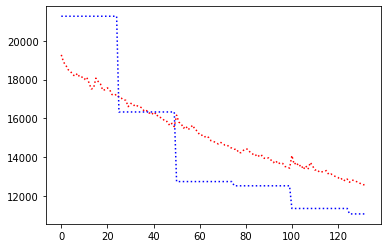

record the last path to gazebo for showing up


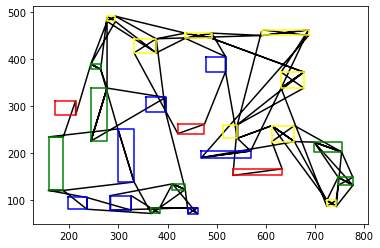

tensor([20.,  6., 13., 14.,  0., 14., 20., 21.,  8., 13.,  6., 14., 23., 20.,
         6., 20., 13.,  8., 23.,  5., 22., 17., 15.,  8., 23.,  5., 14., 21.,
         8., 23.,  5., 17., 12.,  7., 17.,  7., 18., 22.,  5., 17., 12., 24.,
        11.,  7., 12., 24., 18.,  2.,  9., 10.,  4.,  3., 11.,  7., 18., 12.,
        24.,  9.,  4., 16.,  3.,  1., 19., 16.,  3., 10., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:900/2500, reward:12616.3173828125


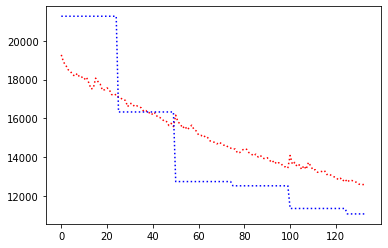

record the last path to gazebo for showing up


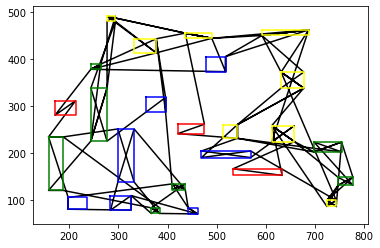

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 20.,  6., 13., 23.,  8.,
        14., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12.,  5., 21.,  8., 23.,  5., 17., 17., 22.,  7., 12., 18., 11.,
         7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11., 12., 24.,  7., 18.,
        24., 10.,  3.,  4., 16., 19.,  1.,  9.,  4.,  3., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1000/2500, reward:12357.8935546875


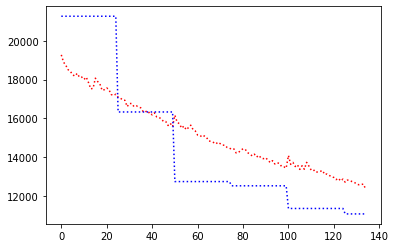

record the last path to gazebo for showing up


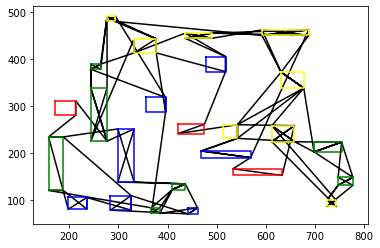

tensor([20.,  6., 13., 14.,  0., 21.,  8., 20., 14., 13.,  6.,  8., 20., 14.,
        20., 23.,  5.,  6., 13., 14., 23.,  5., 22., 17., 15.,  8., 23., 21.,
         8., 23., 17.,  7., 12., 17.,  5., 22.,  5., 17., 12.,  7., 18., 11.,
         7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 24., 12., 18.,
        24.,  3., 16.,  4., 19.,  9.,  1., 10.,  3., 16.,  4.,  9., 19.,  1.],
       device='cuda:0')
epoch:5, batch:1100/2500, reward:12389.2197265625


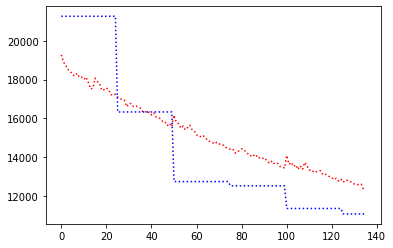

record the last path to gazebo for showing up


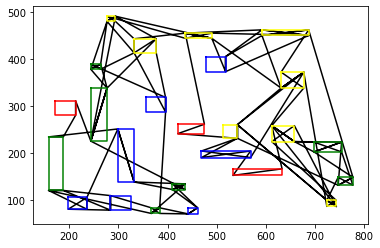

tensor([ 6., 20., 14., 13.,  0., 21.,  8., 14., 20., 20.,  6., 13., 23.,  8.,
        14., 13.,  6., 20., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 23.,  5.,  8., 21., 22.,  5., 17., 17.,  7., 12., 24., 18.,
        24., 11.,  7., 12., 18.,  2., 24.,  9., 10.,  4.,  3., 11., 12.,  7.,
        18., 10.,  3., 16.,  4., 19.,  1.,  9.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:1200/2500, reward:12582.794921875


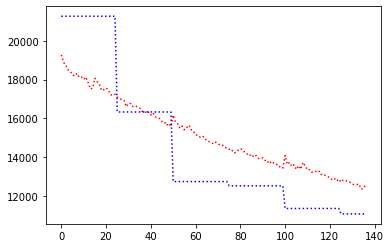

record the last path to gazebo for showing up


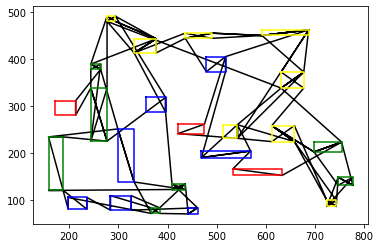

tensor([ 6., 13., 20., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 23., 14.,
        20.,  6., 13.,  8., 23.,  5., 17., 22., 15.,  8., 14.,  5.,  5., 17.,
        12.,  7., 23.,  8., 21., 23.,  5., 17., 12.,  7., 18., 22., 17., 24.,
        11.,  7., 12., 24., 18.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 19., 16.,  4.,  3.,  1.,  9.,  4.,  3., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1300/2500, reward:12430.3759765625


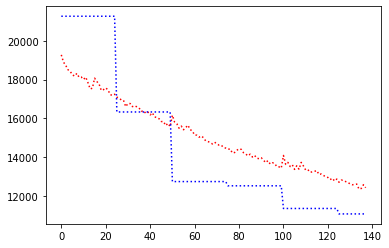

record the last path to gazebo for showing up


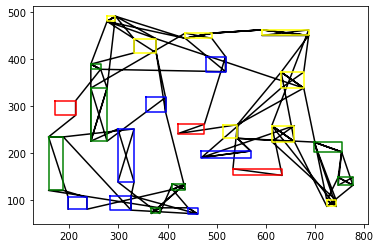

tensor([13.,  6., 20., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 24., 12., 18.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4.,  1.,  9., 19.],
       device='cuda:0')
epoch:5, batch:1400/2500, reward:12433.8583984375


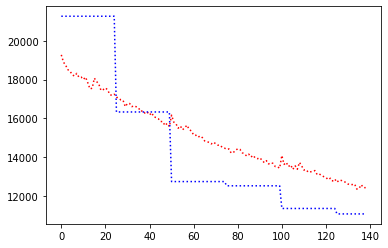

record the last path to gazebo for showing up


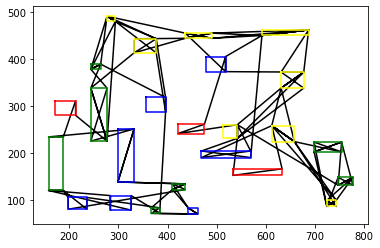

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7.,  7.,  8., 21., 17., 23.,  5., 22.,  5., 17., 12., 18., 24.,
        11.,  2.,  7., 12., 18., 24.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24.,  1., 16.,  3.,  4., 19.,  9., 10.,  3., 16., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1500/2500, reward:12359.9248046875


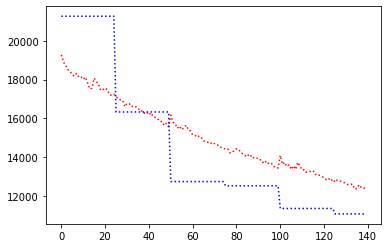

record the last path to gazebo for showing up


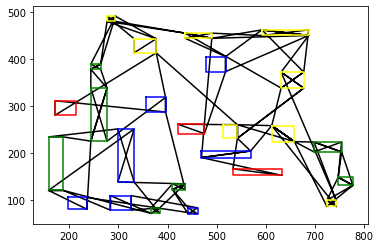

tensor([13., 20.,  6., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 13., 20., 23., 22.,  5., 17., 15.,  8., 14., 23.,  5.,  7.,
        17., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 18., 12., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 18., 12.,
        24.,  9.,  1., 16.,  3.,  4., 19., 10.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1600/2500, reward:12319.96484375


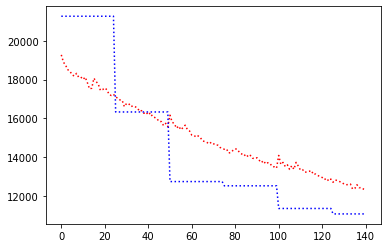

record the last path to gazebo for showing up


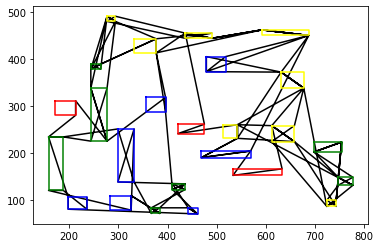

tensor([ 6., 14., 20., 13.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17., 23.,  5., 21.,  8., 17.,  5., 22., 24.,  7., 12., 18.,
        11.,  7., 12., 24.,  2., 18.,  9.,  7., 12., 18., 11.,  9.,  3.,  4.,
         3., 16., 10.,  4., 19.,  1., 16., 24., 10.,  3., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1700/2500, reward:12451.369140625


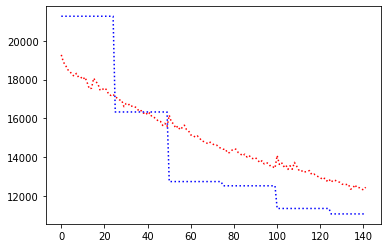

record the last path to gazebo for showing up


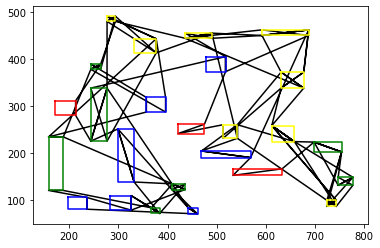

tensor([ 6., 20., 13.,  0., 14., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13.,  8., 23., 14., 23.,  5., 17., 22., 15.,  8.,  5.,
        17.,  7., 17., 12.,  5., 23., 21., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11., 12.,  7., 18.,
        24.,  1.,  3., 16.,  4., 19.,  9.,  3.,  4., 10., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:1800/2500, reward:12357.1376953125


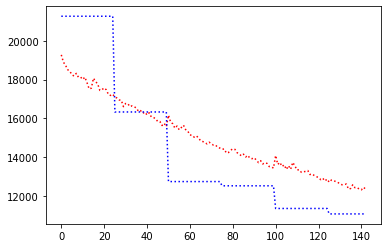

record the last path to gazebo for showing up


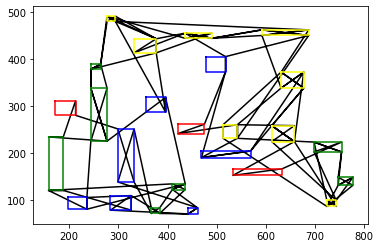

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 14., 20.,  6.,
        20., 23.,  8., 23.,  5., 17., 22., 15., 13., 14.,  8., 23.,  5.,  7.,
        12., 17., 17., 21.,  5., 23.,  8.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11., 12.,  7., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:1900/2500, reward:12305.01171875


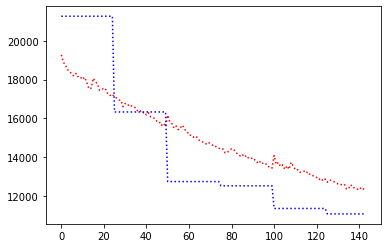

record the last path to gazebo for showing up


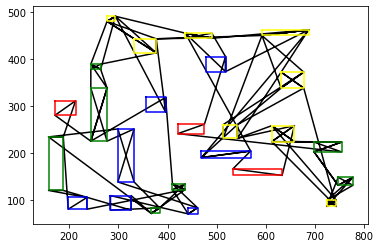

tensor([ 0.,  6., 20., 13., 14., 21.,  8., 14., 20.,  6., 13., 20., 23.,  8.,
        14.,  6., 13., 20., 23.,  5., 22., 17., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 18., 12., 24.,
        11.,  7., 12., 18.,  9.,  2., 24., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  4., 16.,  3., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:2000/2500, reward:12187.6328125


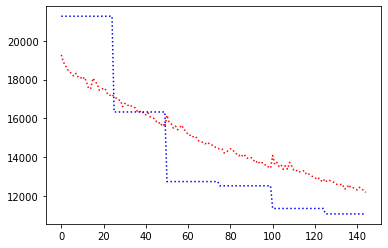

record the last path to gazebo for showing up


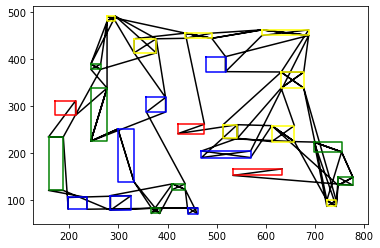

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 14., 13., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 23., 21.,  8., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24., 10.,  3.,  4., 11.,  7., 12., 18.,  9.,  2.,
        16.,  3., 19.,  4.,  9., 24., 10.,  1., 16.,  3., 19.,  4.,  9.,  1.],
       device='cuda:0')
epoch:5, batch:2100/2500, reward:12155.1201171875


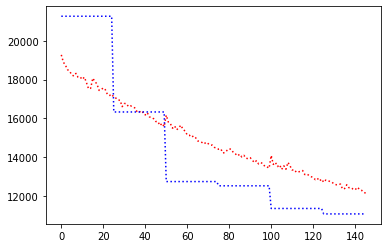

record the last path to gazebo for showing up


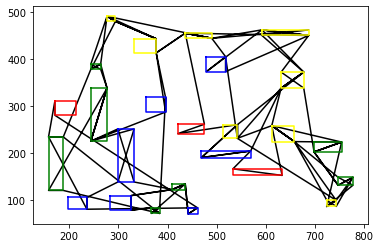

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 17., 12.,  5.,  5., 23., 22., 21.,  8.,  3., 11.,  7., 12., 18.,
         9., 24.,  2., 18.,  7., 12., 17., 12., 24., 11.,  7., 18., 24., 10.,
         4.,  3., 19., 16.,  4.,  9., 10.,  3., 16.,  1.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:5, batch:2200/2500, reward:12110.42578125


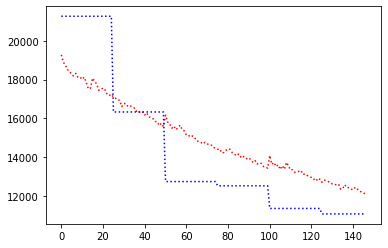

record the last path to gazebo for showing up


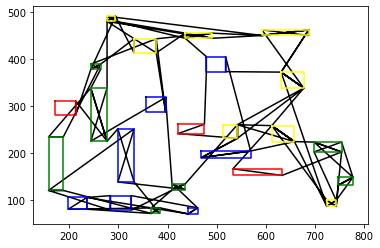

tensor([ 6., 13.,  0., 20., 14., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13.,  5., 23., 22., 17., 15.,  8., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8.,  5., 23., 22., 17., 12.,  7., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
         9., 19., 16.,  3.,  4.,  1., 16.,  3., 10.,  4., 24., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:2300/2500, reward:12007.984375


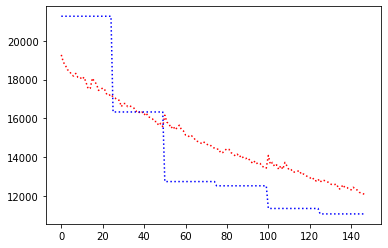

record the last path to gazebo for showing up


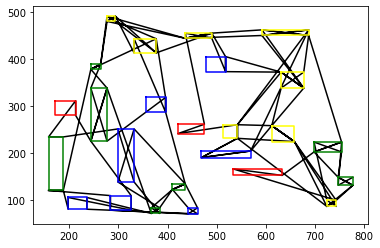

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8.,  6., 20., 13., 23.,  5., 17., 22., 15.,  8., 23., 14.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 11.,
         7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 16.,  3.,  4., 19., 11.,
        24., 18.,  7., 12., 24., 10.,  3., 16.,  1.,  9.,  9., 19.,  4.,  1.],
       device='cuda:0')
epoch:5, batch:2400/2500, reward:12048.7021484375


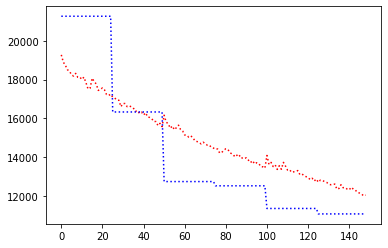

record the last path to gazebo for showing up


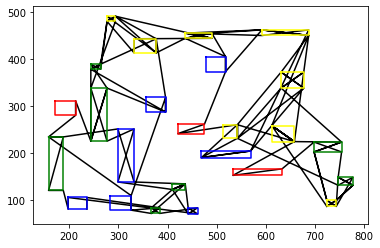

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 14., 23.,  5., 17., 22., 13.,  8., 15., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22., 11.,  7., 18., 12.,
        24.,  2.,  9., 10.,  4.,  7., 12., 18., 24., 11., 12., 18.,  7., 24.,
         3., 16.,  3.,  4., 19.,  9.,  1.,  3.,  4., 10., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:5, batch:2500/2500, reward:12007.7607421875


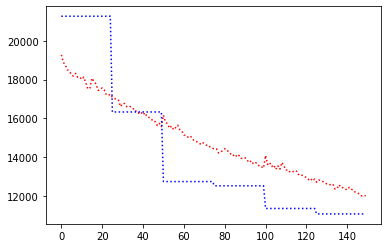

record the last path to gazebo for showing up


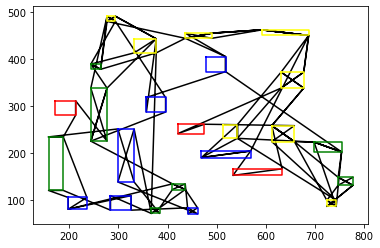

R_val =  tensor(10666.8027, device='cuda:0')
C_val =  11080.095703125
Avg Actor 10666.802734375 --- Avg Critic 11080.095703125
My actor is going on the right road Hallelujah :) Updated
Epoch: 5, epoch time: 158.383min, tot time: 0.652day, L_actor: 10666.803, L_critic: 11080.096, update: True
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8.,  6., 20., 13., 23.,  5., 17., 15., 22.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 24., 18., 12.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10., 19.,  3., 16.,  4.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:100/2500, reward:12129.6630859375


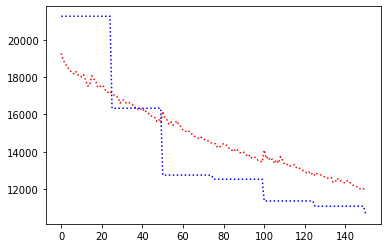

record the last path to gazebo for showing up


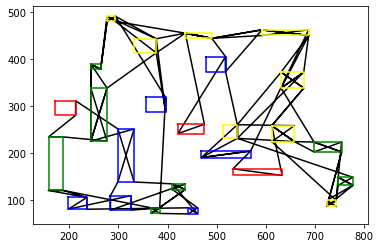

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  8.,  6., 20., 13., 14.,
        23., 23.,  5., 17., 22., 15., 20.,  6., 14., 13.,  8.,  5., 23., 17.,
         7., 12.,  5.,  8., 23., 21., 17.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11., 12.,  7., 18.,
        24., 10.,  4.,  3., 16.,  1., 19.,  9.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:200/2500, reward:12019.6494140625


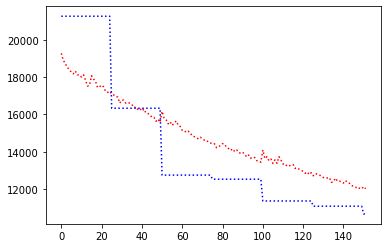

record the last path to gazebo for showing up


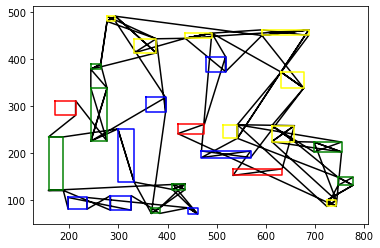

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 23., 14.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 18., 12.,
        24., 10.,  3., 16., 19.,  4.,  1.,  9.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:300/2500, reward:11977.865234375


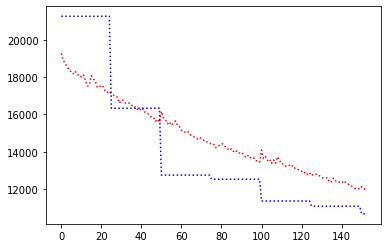

record the last path to gazebo for showing up


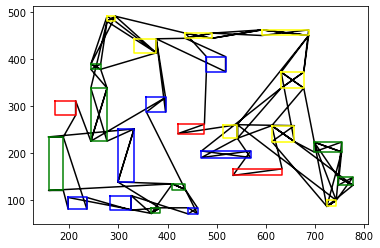

tensor([ 6., 20., 13.,  0., 14., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14.,  8., 23.,  5., 17., 22., 15., 23.,  5., 17.,
        12.,  7., 17., 21.,  8., 23.,  5., 22.,  5., 17., 12.,  7., 18., 24.,
         3.,  4., 18.,  7., 11., 12.,  9., 10., 16., 24.,  2., 11., 12.,  7.,
        18., 24., 10.,  3.,  3.,  4., 19.,  9.,  1.,  4., 16.,  1., 19.,  9.],
       device='cuda:0')
epoch:6, batch:400/2500, reward:11918.33984375


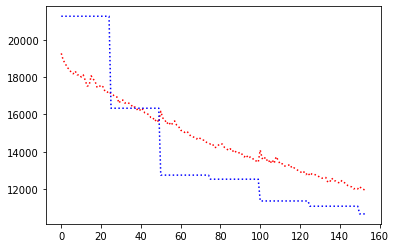

record the last path to gazebo for showing up


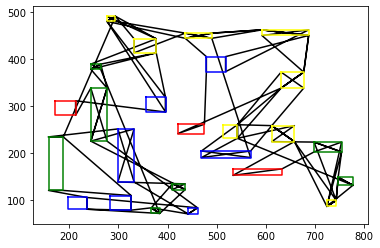

tensor([ 6., 20.,  0., 13., 14.,  8., 21.,  6., 20., 14., 13., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22.,  7., 18., 12., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:500/2500, reward:11871.0283203125


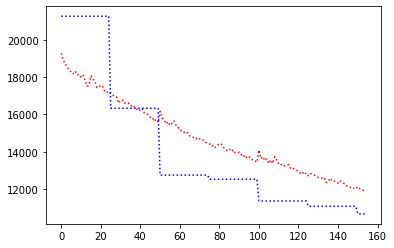

record the last path to gazebo for showing up


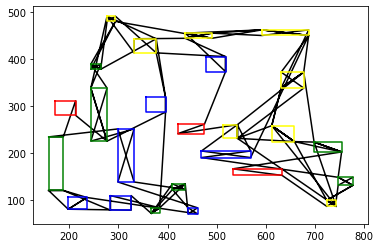

tensor([ 6., 20., 13., 14.,  0., 21.,  8.,  6., 13., 20., 14., 20., 20.,  6.,
        14., 23.,  8., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  7.,  5., 23.,  8., 21., 22.,  5., 17., 12., 18., 24.,
        11., 12.,  7., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24.,  3.,  4., 16., 19.,  1.,  9., 10., 16.,  4.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:600/2500, reward:12010.462890625


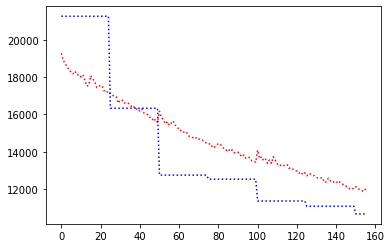

record the last path to gazebo for showing up


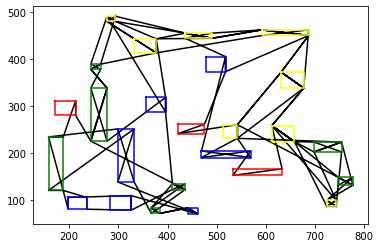

tensor([ 6., 13., 20.,  0., 14., 21.,  8., 13., 14., 20.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 22., 17., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5.,  5., 23., 21.,  8., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 24., 12., 18.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  4.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:6, batch:700/2500, reward:11826.541015625


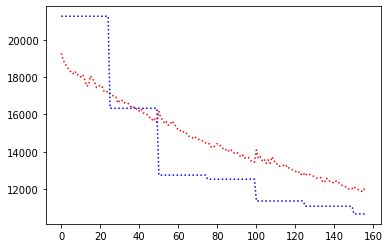

record the last path to gazebo for showing up


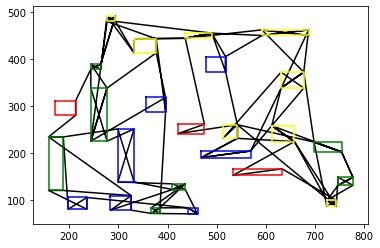

tensor([ 6., 20., 13.,  0., 14., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23., 17.,  5.,
        12.,  7., 17.,  5.,  5.,  8., 21., 23., 22., 17.,  7., 12., 18., 24.,
        18., 12., 11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7.,
        24., 10., 16.,  3., 19.,  4.,  1.,  9., 19., 16.,  3.,  4.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:800/2500, reward:11851.1435546875


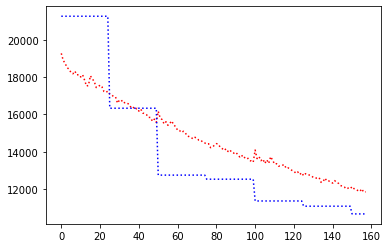

record the last path to gazebo for showing up


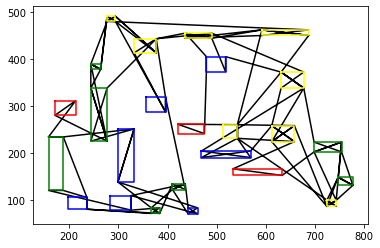

tensor([ 6., 13., 20., 14.,  0., 21.,  8., 14., 13., 20.,  6., 20., 14., 23.,
         8.,  6., 20., 13.,  8., 14., 23.,  5., 22., 17., 15., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11., 12.,  7., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:900/2500, reward:11784.30078125


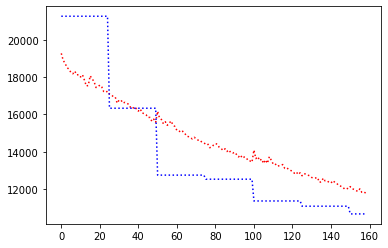

record the last path to gazebo for showing up


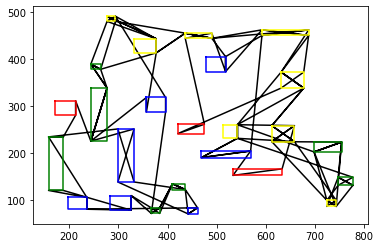

tensor([20., 13.,  6., 14.,  0., 21.,  8., 14., 20.,  6., 13., 14., 23., 20.,
         8.,  6., 20., 13., 23.,  5., 17., 22., 15., 14.,  8., 23.,  5., 17.,
        17.,  7., 12.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1000/2500, reward:11770.9677734375


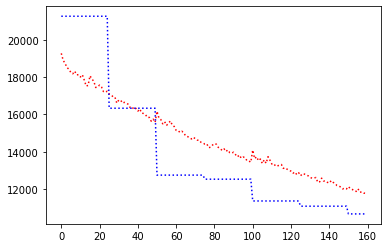

record the last path to gazebo for showing up


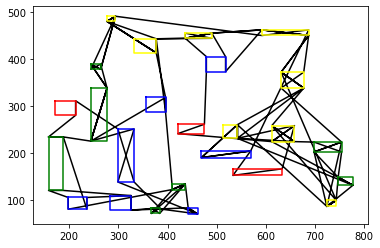

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 14., 20., 13.,  6., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 23.,  8., 21.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3., 16.,  4., 19.,  1.,  9.,  3.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:6, batch:1100/2500, reward:11692.142578125


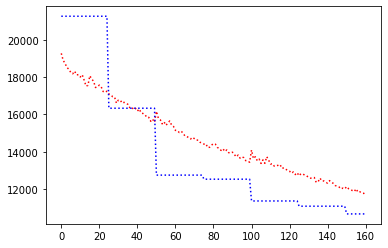

record the last path to gazebo for showing up


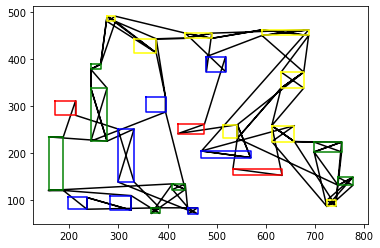

tensor([ 6., 20., 13., 14.,  0., 21., 14., 20.,  6.,  8., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  4.,  3., 16., 19.,  1.,  9.,  4., 16.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1200/2500, reward:11717.9375


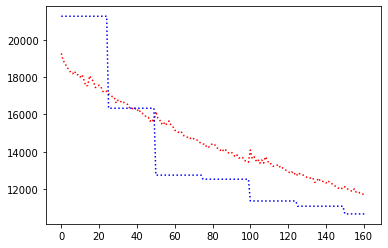

record the last path to gazebo for showing up


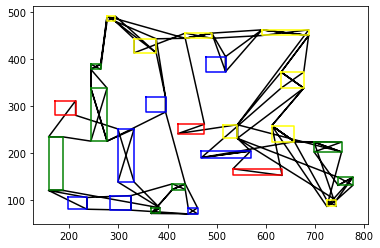

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 24., 18.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1300/2500, reward:11722.328125


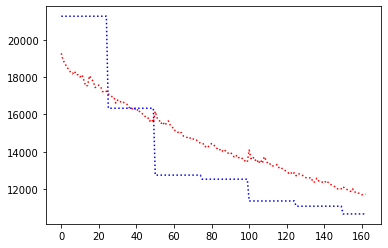

record the last path to gazebo for showing up


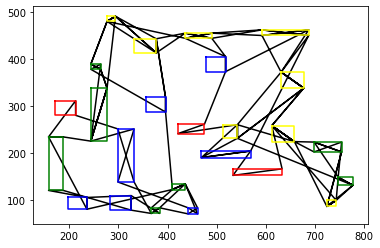

tensor([ 6., 13., 20., 14.,  0.,  8., 21., 14., 20., 13.,  6., 20., 14., 23.,
         8., 23., 22.,  5., 17.,  6., 20., 14., 13.,  8., 23.,  5., 15.,  8.,
        21., 17.,  7., 12.,  5., 23., 17.,  7.,  5., 22., 17., 12., 18., 24.,
        11.,  7., 12., 24., 18.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  1.,  9., 19., 16.,  3.,  4.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1400/2500, reward:11590.27734375


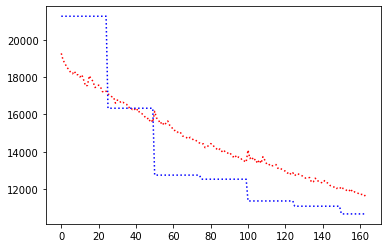

record the last path to gazebo for showing up


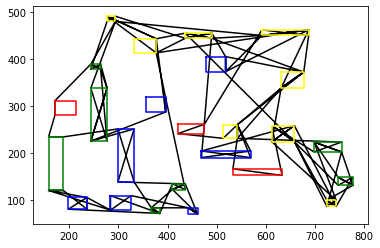

tensor([ 6., 20., 13.,  0., 14., 21.,  8.,  6., 14., 20., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 23.,  8., 21., 22.,  5., 17.,  7., 12., 18., 24.,
         4., 11.,  7., 12., 18., 24.,  9.,  2., 10.,  3., 11.,  7., 12., 18.,
         9.,  1.,  3., 16.,  4., 19.,  4., 16.,  3., 10., 24.,  1., 19.,  9.],
       device='cuda:0')
epoch:6, batch:1500/2500, reward:11655.048828125


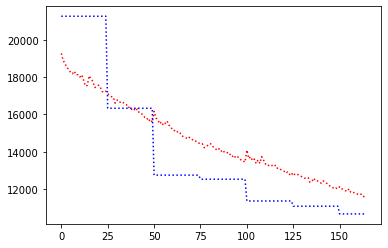

record the last path to gazebo for showing up


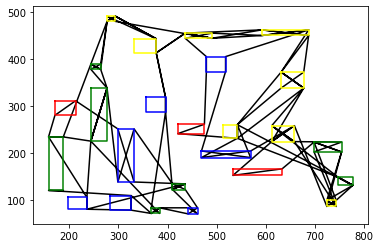

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 23.,  5., 17., 22., 15., 14., 23.,  8., 21.,  5.,
        17.,  7., 12., 17.,  5.,  8., 23., 17., 22.,  5., 11.,  7., 12., 18.,
        24.,  9.,  2.,  7., 12., 24., 18., 11.,  7., 12., 18., 24., 10.,  4.,
         3., 19., 16.,  3., 10.,  4.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1600/2500, reward:11586.087890625


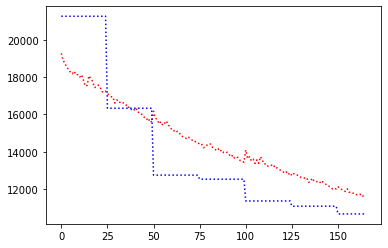

record the last path to gazebo for showing up


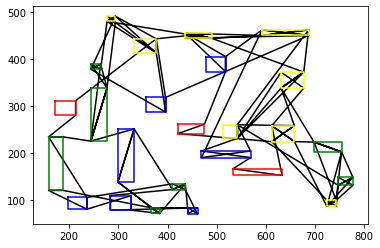

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 12., 17., 18., 24.,
         7., 12., 11., 18., 24.,  2.,  9., 10.,  4.,  3., 11., 12.,  7., 24.,
        18., 16., 19.,  3.,  4.,  1.,  9., 16., 10.,  3.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:6, batch:1700/2500, reward:11489.50390625


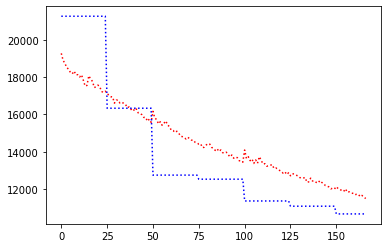

record the last path to gazebo for showing up


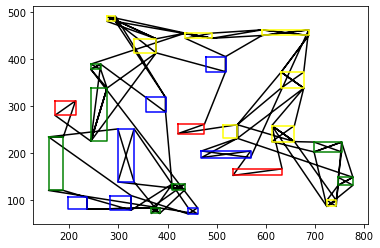

tensor([20.,  6., 13., 14.,  8.,  0., 21., 14., 20.,  6., 20., 13., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 21., 23.,  5.,
        17., 12.,  7.,  5., 17., 23.,  8.,  5., 22., 17., 12.,  7., 18., 11.,
         7., 12., 18.,  9., 24.,  2., 10.,  4.,  3., 11., 24.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:1800/2500, reward:11494.361328125


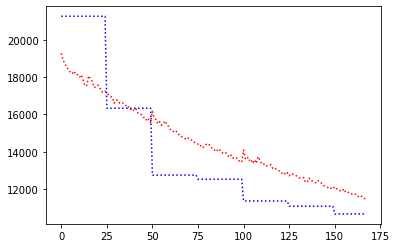

record the last path to gazebo for showing up


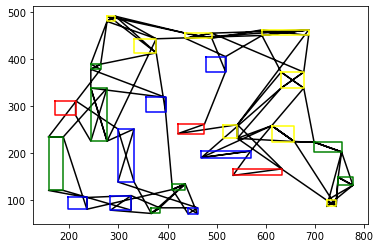

tensor([ 6., 20., 13., 14., 21.,  0.,  8., 14., 20.,  6., 20., 13., 14.,  8.,
        23., 20.,  6., 13., 23.,  5., 22., 17., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4.,  9.,  1., 19.,  4., 16.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:6, batch:1900/2500, reward:11440.875


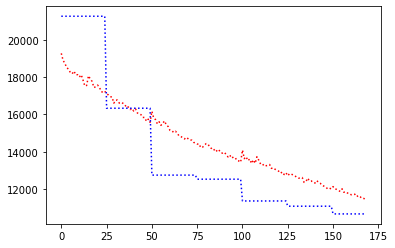

record the last path to gazebo for showing up


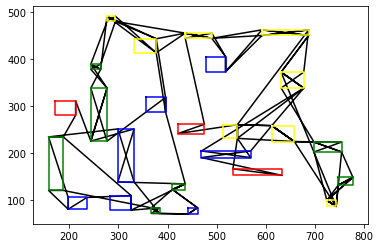

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 18., 12.,
        24., 10., 19.,  4.,  3., 16.,  1.,  9.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:2000/2500, reward:11342.666015625


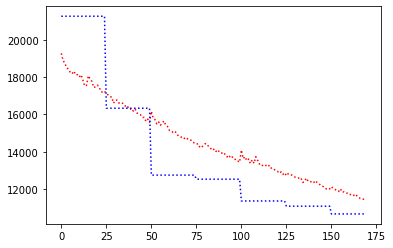

record the last path to gazebo for showing up


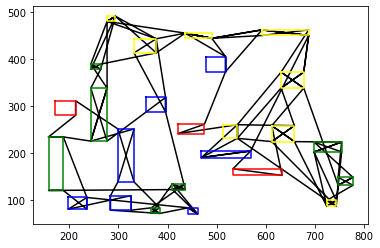

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1., 16.,  4.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:6, batch:2100/2500, reward:11354.615234375


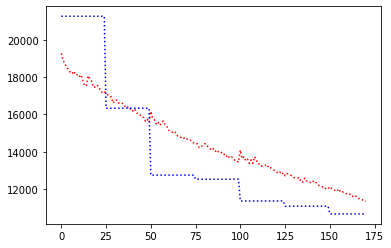

record the last path to gazebo for showing up


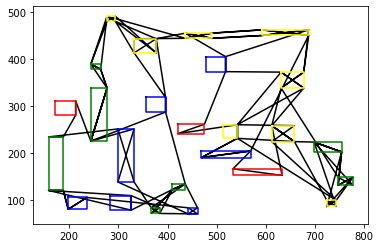

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 23.,  5.,  8., 21., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3.,  3., 16.,  4., 11.,
         7., 12., 18., 24., 10., 19.,  9.,  1.,  4., 16.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:2200/2500, reward:11320.013671875


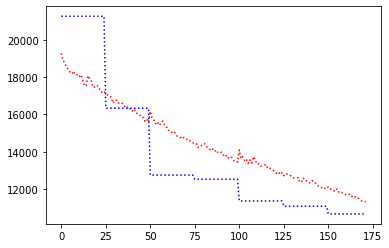

record the last path to gazebo for showing up


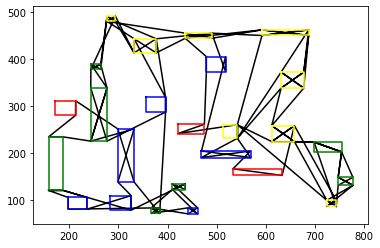

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14.,  8., 23.,  5., 17., 22., 15., 21., 23.,  5.,
        17.,  7., 17., 12.,  5.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19., 16.,  4.,  1.,  9.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:2300/2500, reward:11246.3828125


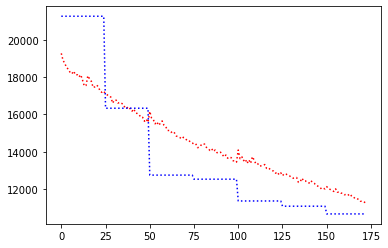

record the last path to gazebo for showing up


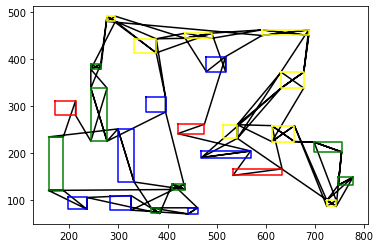

tensor([13., 20.,  6., 14.,  0., 21.,  8., 14.,  6., 20., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5.,  8., 21., 23.,  5., 22., 17., 12.,  7., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 19., 16.,  4.,  3.,  1.,  9.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:2400/2500, reward:11288.7158203125


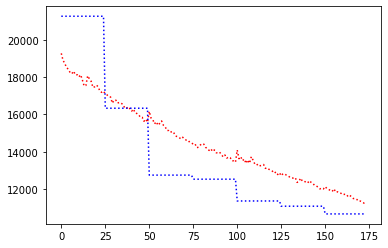

record the last path to gazebo for showing up


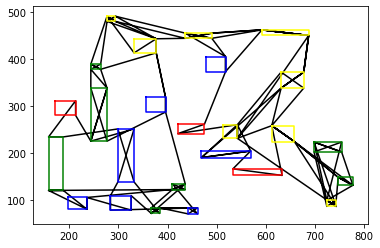

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
        20.,  8.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18.,  9., 24., 10.,  4.,  3., 11.,  7., 18., 12., 24.,
         2., 16.,  3., 19.,  4.,  9.,  1., 16.,  3., 10.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:6, batch:2500/2500, reward:11225.99609375


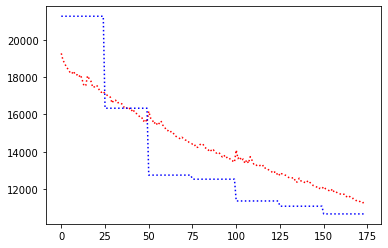

record the last path to gazebo for showing up


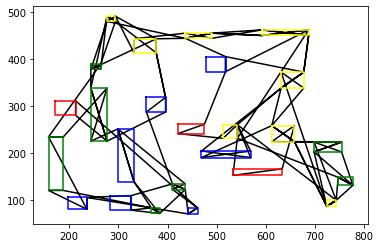

R_val =  tensor(10170.5645, device='cuda:0')
C_val =  10666.802734375
Avg Actor 10170.564453125 --- Avg Critic 10666.802734375
My actor is going on the right road Hallelujah :) Updated
Epoch: 6, epoch time: 155.923min, tot time: 0.760day, L_actor: 10170.564, L_critic: 10666.803, update: True
Save Checkpoints
tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 23.,  8., 21.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3., 16.,  4., 19.,  1.,  9.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:100/2500, reward:11317.8046875


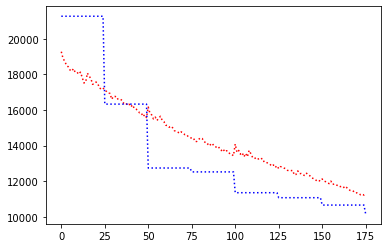

record the last path to gazebo for showing up


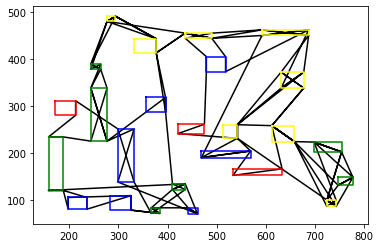

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20., 13., 20.,  6., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15., 14.,  8.,  5., 17.,  7.,
        23., 23.,  8., 21.,  7., 11., 12.,  2., 18., 24., 17., 12.,  5., 22.,
         5., 17.,  7., 18., 12., 24., 18.,  7., 12., 11.,  3.,  4., 10., 16.,
         3.,  4.,  9.,  1., 19.,  9., 10., 24.,  4., 16.,  3., 19.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:200/2500, reward:11225.642578125


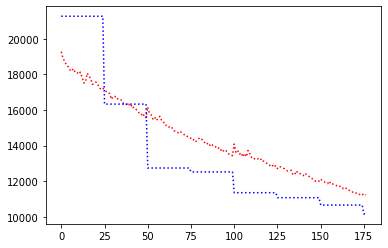

record the last path to gazebo for showing up


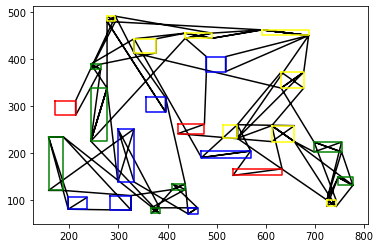

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17., 23.,  5., 21.,  8.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 24.,
        18., 10., 19., 16.,  3.,  4.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:300/2500, reward:11138.908203125


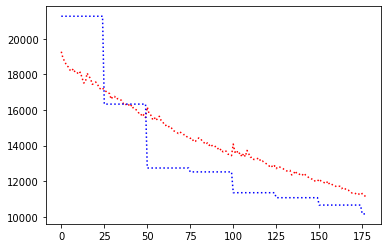

record the last path to gazebo for showing up


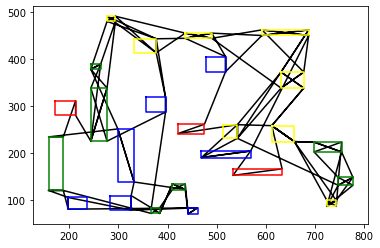

tensor([ 6., 20., 13., 14., 21.,  0.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13.,  8., 23.,  5., 17., 22., 15., 14.,  5., 23., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:400/2500, reward:11224.6953125


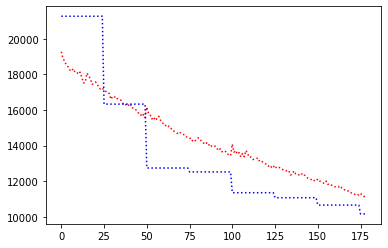

record the last path to gazebo for showing up


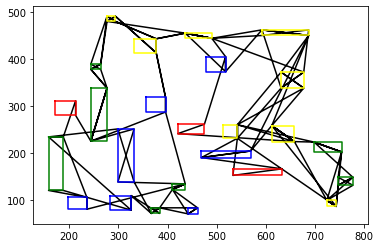

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 23., 21.,  8.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 18., 12.,  2., 24.,  9., 10.,  4.,  3., 11., 12.,  7., 18.,
        24., 10.,  3., 16.,  4., 19.,  1.,  9., 16.,  3., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:500/2500, reward:11166.908203125


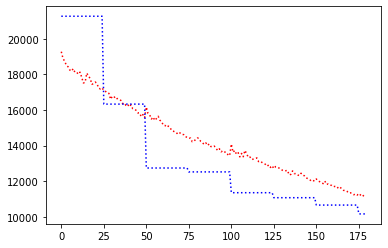

record the last path to gazebo for showing up


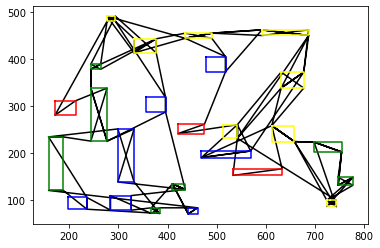

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14.,  8., 23.,  5., 17., 22., 15., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 24., 18.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 24.,
        18., 10., 16.,  3.,  4., 19.,  1.,  9., 19.,  3., 16.,  4.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:600/2500, reward:11170.947265625


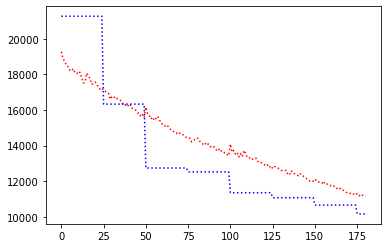

record the last path to gazebo for showing up


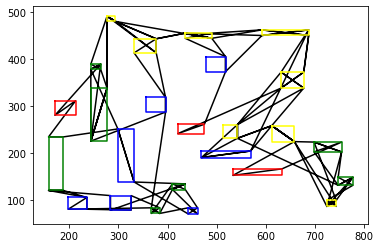

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 14., 20., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22.,  8., 15., 23.,  5., 17.,
         7., 17., 12.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 18., 12.,
        24., 10.,  4., 16.,  3., 19.,  1.,  9., 19., 16.,  4.,  3.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:700/2500, reward:11022.978515625


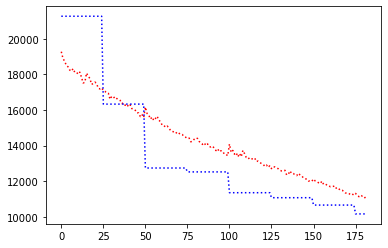

record the last path to gazebo for showing up


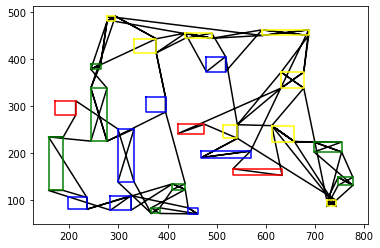

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 24., 18.,
         7., 12., 11., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  4.,  3., 16., 19.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:800/2500, reward:11008.5009765625


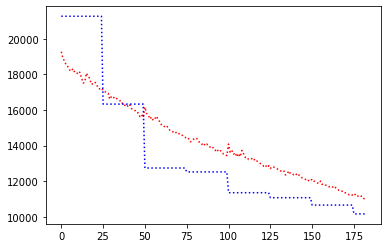

record the last path to gazebo for showing up


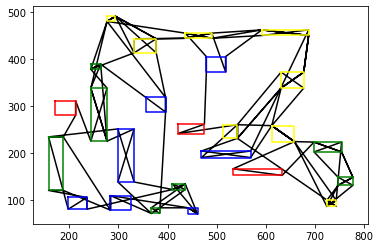

tensor([ 6., 20., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 23.,  8., 21., 22.,  5., 17., 12.,  7., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:900/2500, reward:10938.14453125


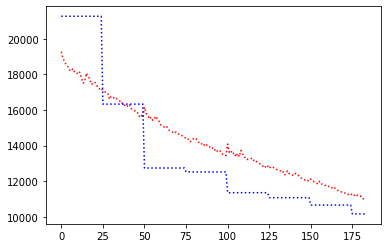

record the last path to gazebo for showing up


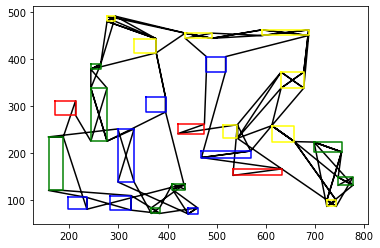

tensor([ 6., 13., 20., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11., 12., 18.,  7.,
        24., 10.,  3.,  4., 16., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1000/2500, reward:10965.376953125


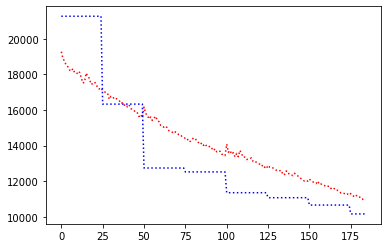

record the last path to gazebo for showing up


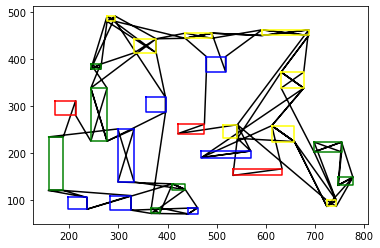

tensor([ 6., 20., 13., 14.,  0.,  8., 21., 14., 20., 13.,  6., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 17., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1100/2500, reward:10881.9013671875


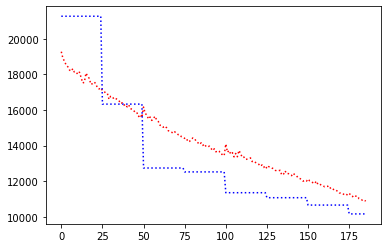

record the last path to gazebo for showing up


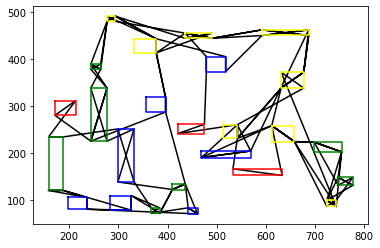

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 24., 18.,  9.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  4.,  3., 16., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1200/2500, reward:10779.123046875


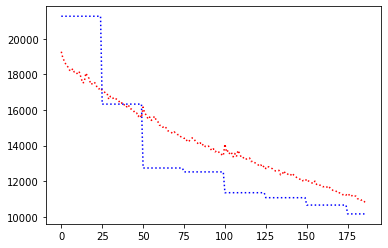

record the last path to gazebo for showing up


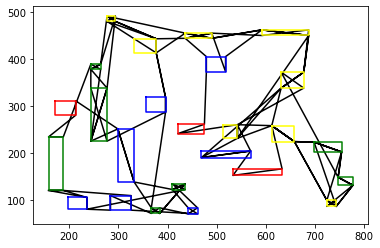

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7.,  5., 17., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 19.,  3., 16.,  4.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:1300/2500, reward:10813.64453125


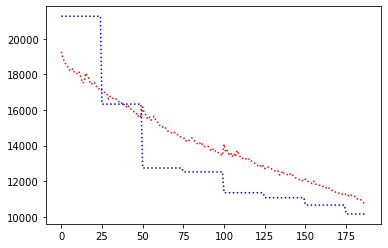

record the last path to gazebo for showing up


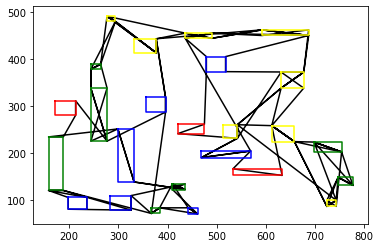

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  4.,  9.,  1.,  3., 16., 19.,  4., 16.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1400/2500, reward:10834.419921875


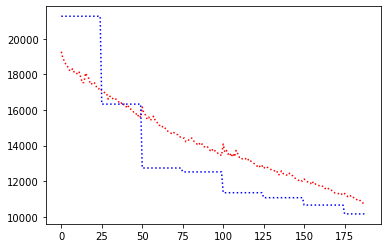

record the last path to gazebo for showing up


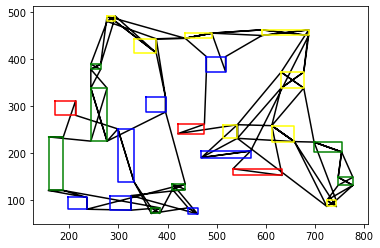

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9., 10.,  3.,  4., 11.,  7., 12., 18., 24.,
         2.,  3., 16.,  4., 19.,  9.,  1., 10.,  4.,  3., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1500/2500, reward:10753.783203125


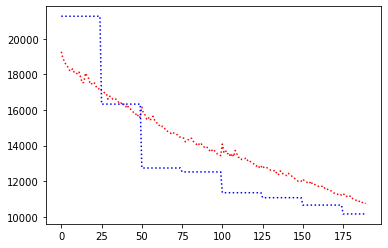

record the last path to gazebo for showing up


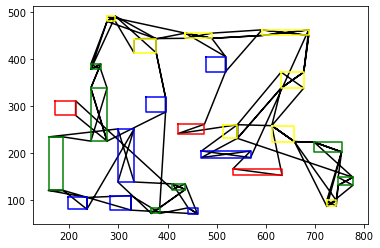

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1600/2500, reward:10732.142578125


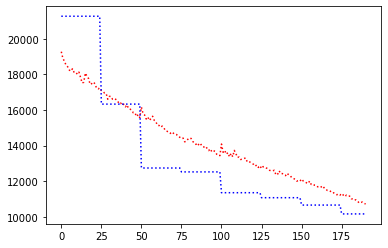

record the last path to gazebo for showing up


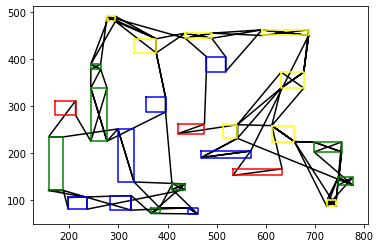

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 19.,  4.,  3., 11.,  7., 12., 18.,
        10., 16.,  3.,  4., 24., 10.,  1.,  9., 19., 16.,  3.,  4.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:1700/2500, reward:10671.1796875


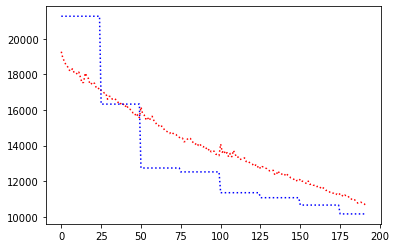

record the last path to gazebo for showing up


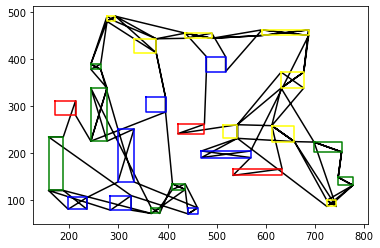

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17., 21.,  8.,  5., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 18., 12.,
        24., 10., 16.,  4.,  3., 19.,  9.,  1.,  4.,  3., 16., 19.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:1800/2500, reward:10704.1484375


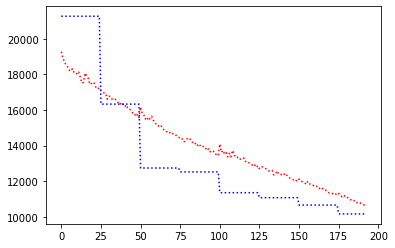

record the last path to gazebo for showing up


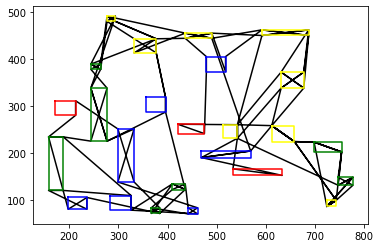

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18.,  9.,  2., 24., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:1900/2500, reward:10751.09375


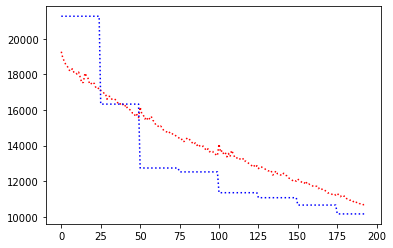

record the last path to gazebo for showing up


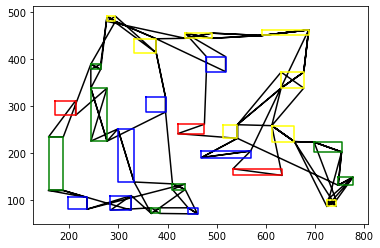

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 19.,  3., 16.,  4.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:2000/2500, reward:10607.0791015625


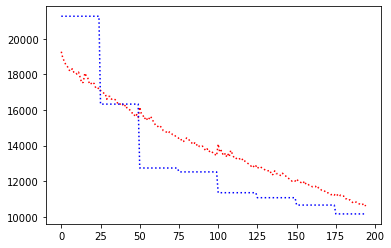

record the last path to gazebo for showing up


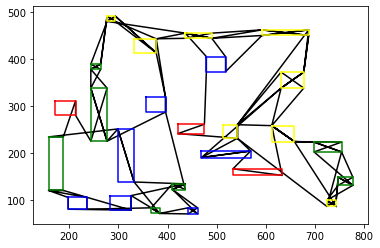

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23., 17.,  5.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  1.,  9.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:7, batch:2100/2500, reward:10658.748046875


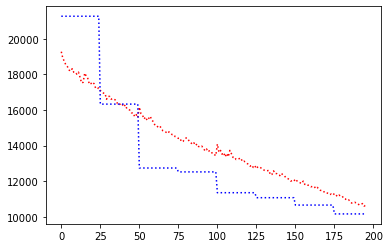

record the last path to gazebo for showing up


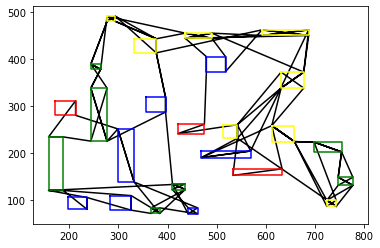

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:2200/2500, reward:10621.892578125


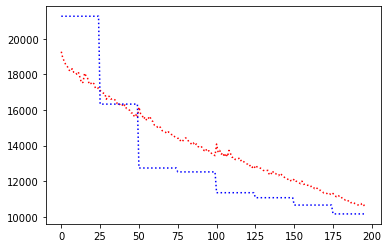

record the last path to gazebo for showing up


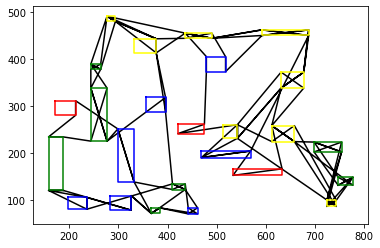

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18.,  9., 24.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:2300/2500, reward:10525.171875


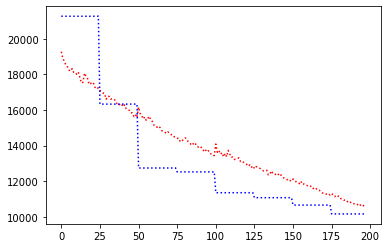

record the last path to gazebo for showing up


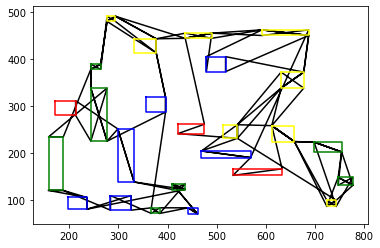

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18.,  2.,  9., 24., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3., 19.,  4.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:2400/2500, reward:10535.142578125


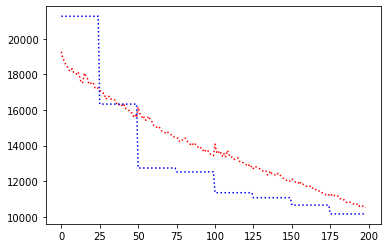

record the last path to gazebo for showing up


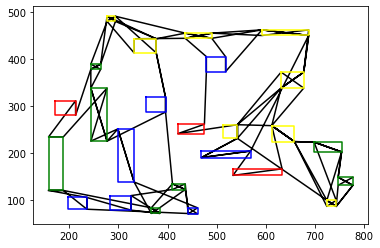

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 24., 18.,
        11.,  7., 12., 24., 18.,  2.,  9., 10., 16.,  4.,  3., 11., 12.,  7.,
        18., 24., 10.,  3.,  4.,  9.,  1., 19., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:7, batch:2500/2500, reward:10522.4775390625


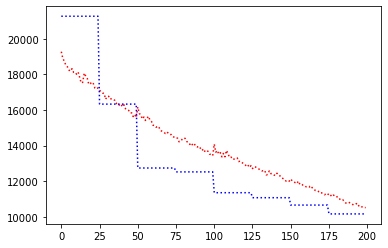

record the last path to gazebo for showing up


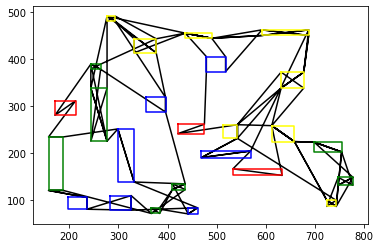

R_val =  tensor(9843.2109, device='cuda:0')
C_val =  10170.564453125
Avg Actor 9843.2109375 --- Avg Critic 10170.564453125
My actor is going on the right road Hallelujah :) Updated
Epoch: 7, epoch time: 157.184min, tot time: 0.870day, L_actor: 9843.211, L_critic: 10170.564, update: True
Save Checkpoints
tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14.,  8., 23.,  5., 22., 17., 15., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:8, batch:100/2500, reward:10728.6396484375


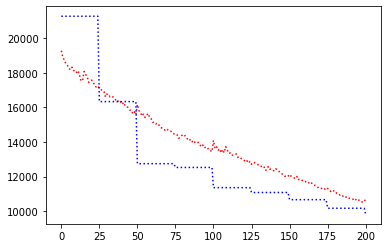

record the last path to gazebo for showing up


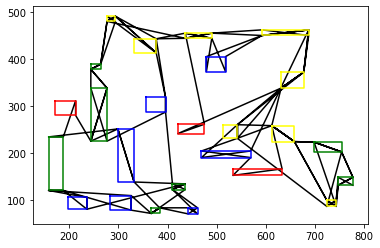

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
         4., 11.,  7., 12., 18., 24.,  9.,  2., 10.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:200/2500, reward:10562.130859375


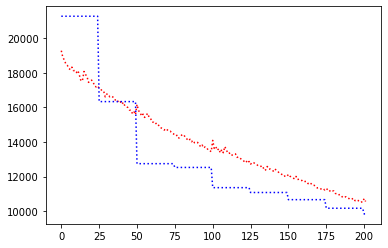

record the last path to gazebo for showing up


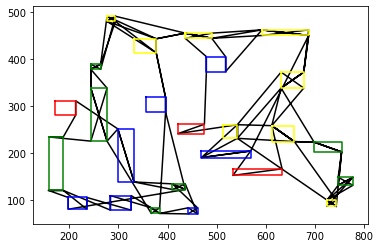

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 18., 12.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:300/2500, reward:10531.4306640625


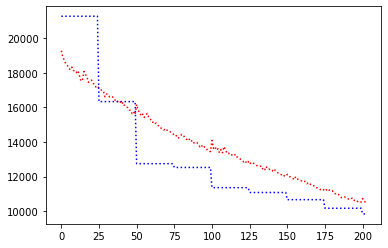

record the last path to gazebo for showing up


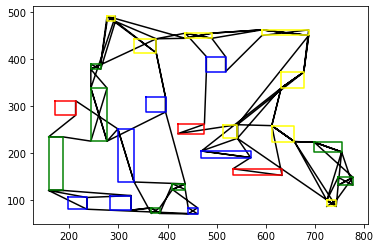

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8.,  6., 20., 14., 13., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:400/2500, reward:10558.7314453125


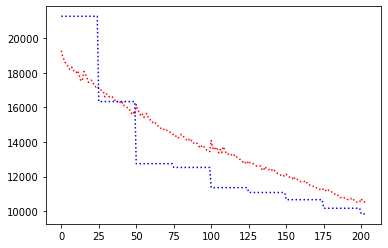

record the last path to gazebo for showing up


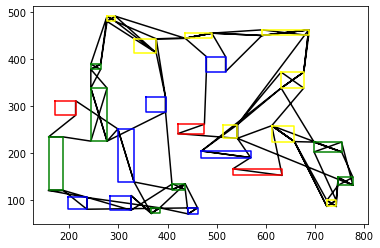

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 20.,  6., 13., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3.,  4., 16., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:500/2500, reward:10547.11328125


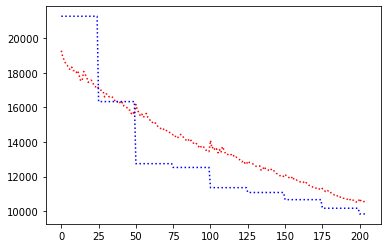

record the last path to gazebo for showing up


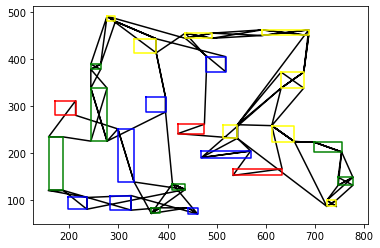

tensor([ 6., 20., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
        20.,  6., 13.,  8., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 24., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:600/2500, reward:10523.517578125


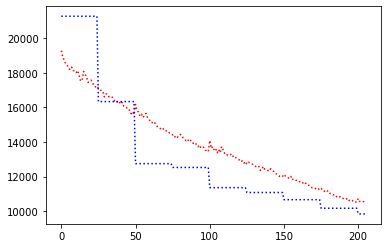

record the last path to gazebo for showing up


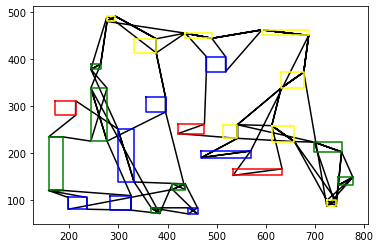

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22.,  8., 23.,  5., 17.,  7.,
        12., 17.,  5., 15.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4.,  9.,  1., 19.,  3., 16.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:8, batch:700/2500, reward:10372.111328125


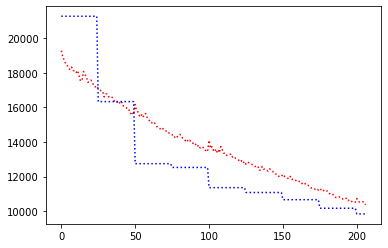

record the last path to gazebo for showing up


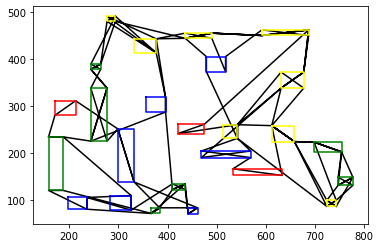

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 11.,
         7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 24., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:800/2500, reward:10491.8720703125


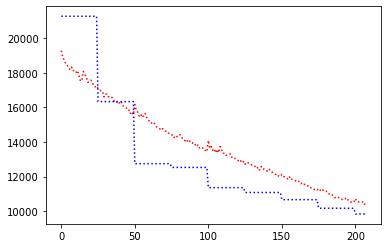

record the last path to gazebo for showing up


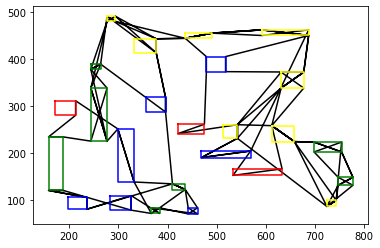

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8.,  6., 20., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 24., 18.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19., 16.,  1.,  9.,  4.,  3., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:900/2500, reward:10382.9169921875


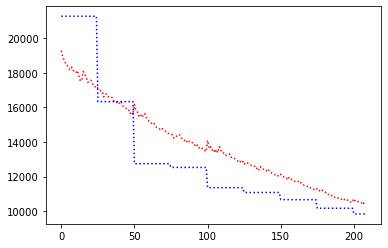

record the last path to gazebo for showing up


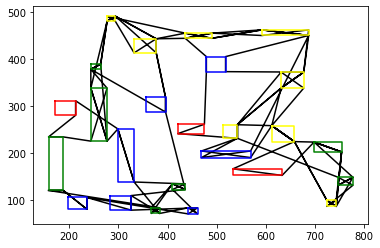

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23., 23.,  5., 17., 22., 15.,  8., 21.,  5.,
        17.,  7., 12., 17.,  5., 23.,  8.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:8, batch:1000/2500, reward:10437.333984375


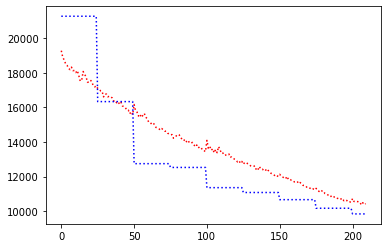

record the last path to gazebo for showing up


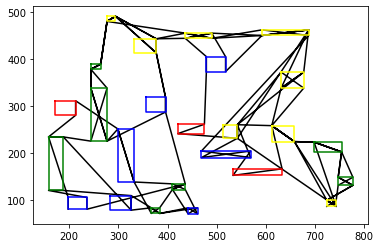

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 14., 13., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  1.,  9.,  1.,  3., 16.,  4., 19.,  9.],
       device='cuda:0')
epoch:8, batch:1100/2500, reward:10466.16796875


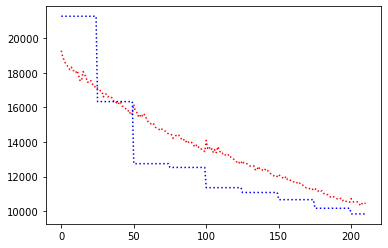

record the last path to gazebo for showing up


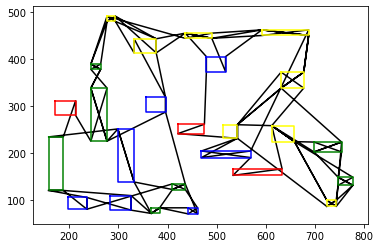

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 23.,  8.,
        14., 20.,  6., 13., 14.,  8., 23.,  5., 17., 22., 15., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 24., 18.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1200/2500, reward:10309.55078125


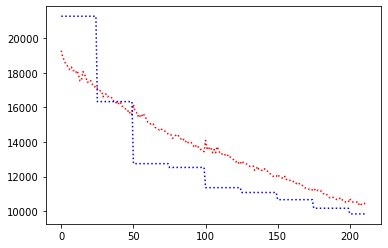

record the last path to gazebo for showing up


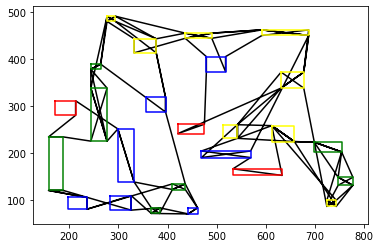

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 18., 12.,  9., 24.,  2., 12.,  7., 18., 11.,  3.,  4.,  3.,
        10., 16.,  4., 19.,  9., 24., 10.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1300/2500, reward:10238.123046875


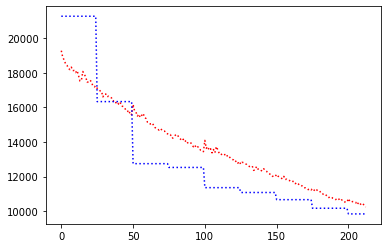

record the last path to gazebo for showing up


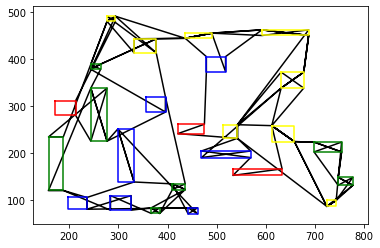

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1400/2500, reward:10281.5361328125


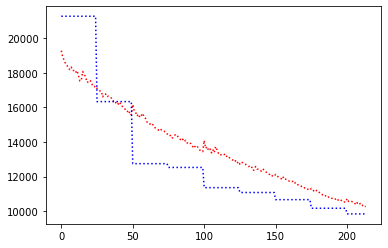

record the last path to gazebo for showing up


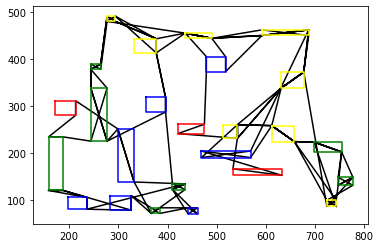

tensor([20.,  6., 13., 14.,  0., 21.,  8.,  6., 20., 14., 20., 13., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 24., 18.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1500/2500, reward:10357.2939453125


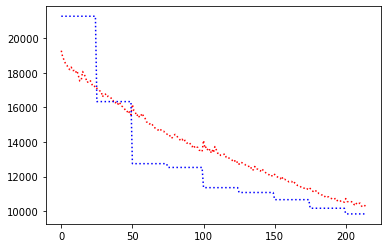

record the last path to gazebo for showing up


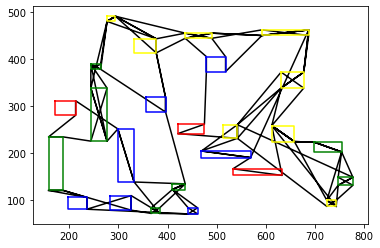

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
         4.,  3., 11.,  7., 12., 18., 24.,  9.,  2., 10.,  3., 16.,  4., 11.,
         7., 12., 18., 24., 10.,  3., 19.,  9.,  1., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:8, batch:1600/2500, reward:10304.2412109375


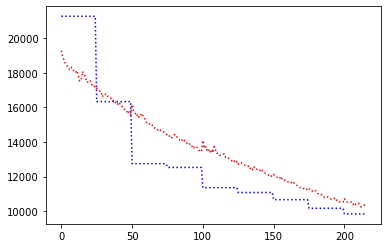

record the last path to gazebo for showing up


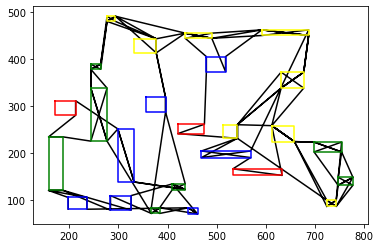

tensor([20.,  6., 13.,  0., 14., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 14., 13., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1700/2500, reward:10256.0859375


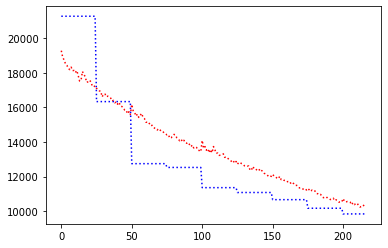

record the last path to gazebo for showing up


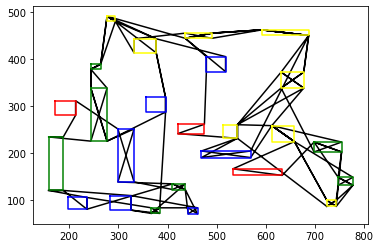

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1800/2500, reward:10202.2734375


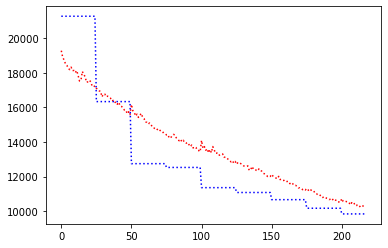

record the last path to gazebo for showing up


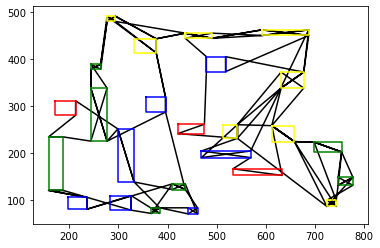

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:1900/2500, reward:10260.119140625


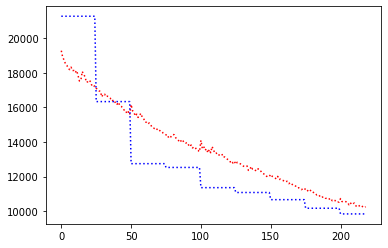

record the last path to gazebo for showing up


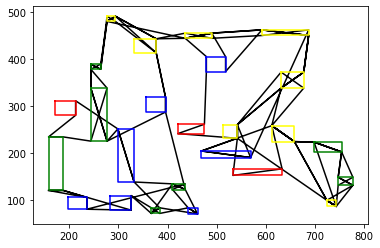

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 24.,
        18., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:2000/2500, reward:10252.5166015625


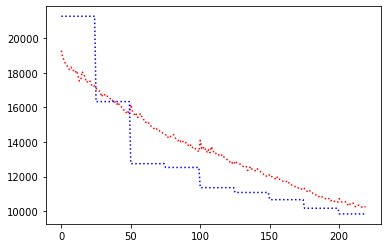

record the last path to gazebo for showing up


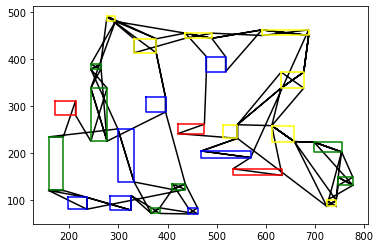

tensor([20.,  6., 13., 14.,  0., 21., 14., 20.,  6., 13., 20.,  8., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24.,  9., 10.,  3., 16., 19.,  4.,  3., 16.,  1.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:8, batch:2100/2500, reward:10195.521484375


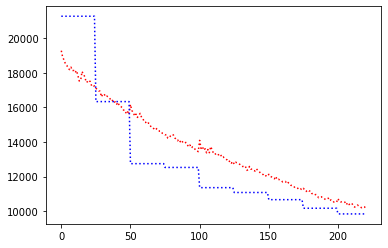

record the last path to gazebo for showing up


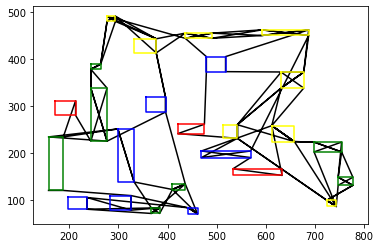

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 23., 14.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17., 12., 18., 24.,
        11., 12.,  7., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:2200/2500, reward:10161.6005859375


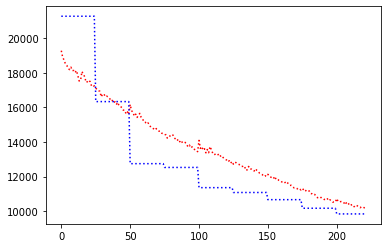

record the last path to gazebo for showing up


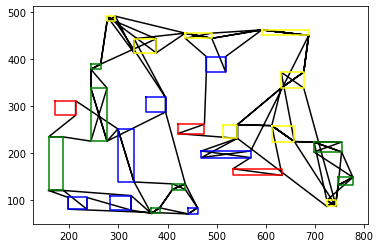

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  3.,  4.,  3., 11.,  7., 12.,
        18., 24., 10.,  4., 16., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:2300/2500, reward:10115.50390625


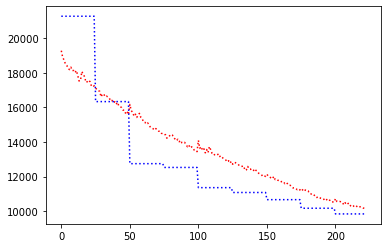

record the last path to gazebo for showing up


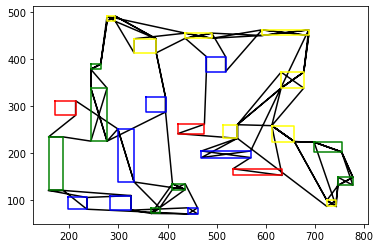

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:2400/2500, reward:10107.5625


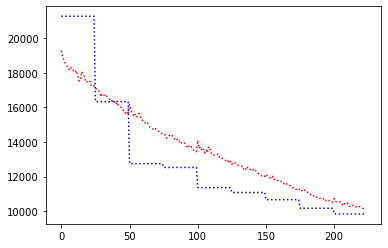

record the last path to gazebo for showing up


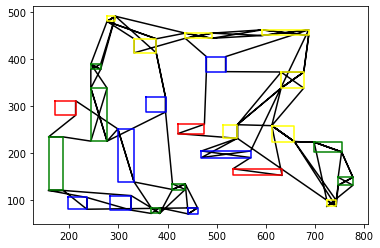

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:8, batch:2500/2500, reward:10103.2705078125


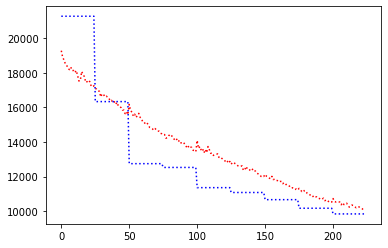

record the last path to gazebo for showing up


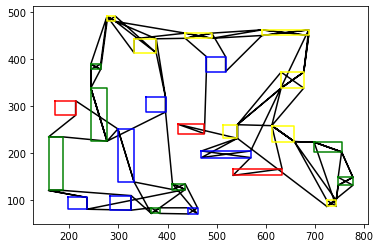

R_val =  tensor(9702.2783, device='cuda:0')
C_val =  9843.2109375
Avg Actor 9702.2783203125 --- Avg Critic 9843.2109375
My actor is going on the right road Hallelujah :) Updated
Epoch: 8, epoch time: 157.276min, tot time: 0.979day, L_actor: 9702.278, L_critic: 9843.211, update: True
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 12.,  7., 17., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 24.,
        18., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:100/2500, reward:10141.0908203125


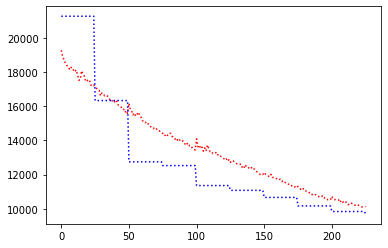

record the last path to gazebo for showing up


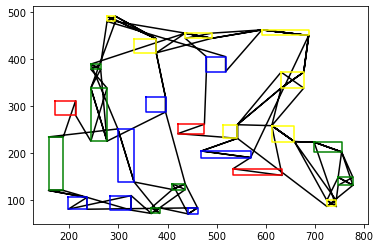

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 11.,  7., 12., 18., 24.,
         9.,  2.,  7., 18., 17., 12., 24.,  4.,  3., 11.,  7., 12., 18., 24.,
        10., 10.,  3.,  4., 16., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:200/2500, reward:10188.892578125


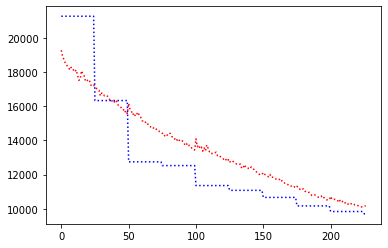

record the last path to gazebo for showing up


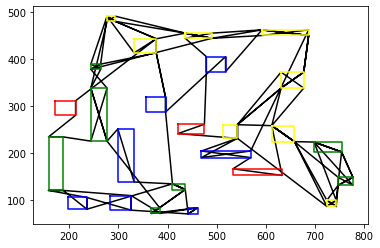

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  9.,  3.,  4., 16., 19.,  1.],
       device='cuda:0')
epoch:9, batch:300/2500, reward:10113.2216796875


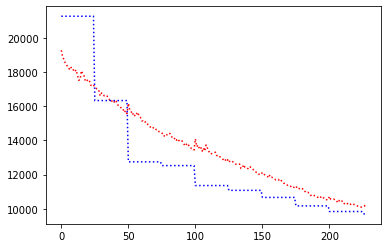

record the last path to gazebo for showing up


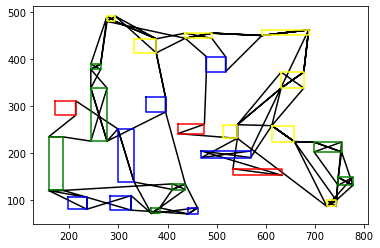

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:400/2500, reward:10137.322265625


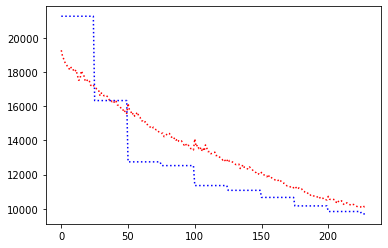

record the last path to gazebo for showing up


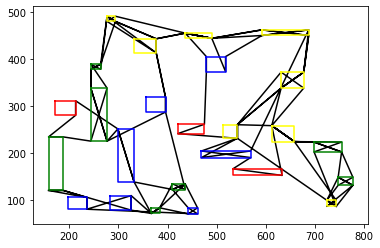

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:500/2500, reward:10158.27734375


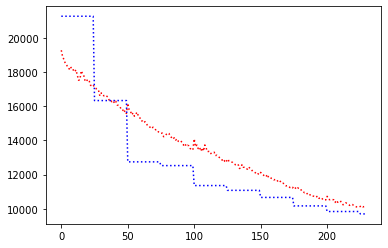

record the last path to gazebo for showing up


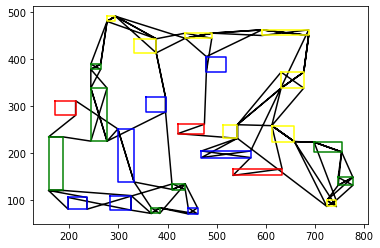

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:9, batch:600/2500, reward:10101.880859375


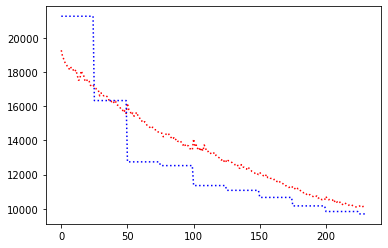

record the last path to gazebo for showing up


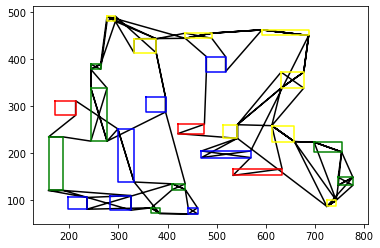

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:700/2500, reward:10055.8486328125


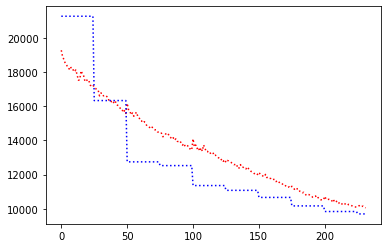

record the last path to gazebo for showing up


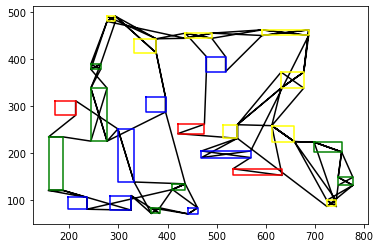

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  4.,  3., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:800/2500, reward:10102.23828125


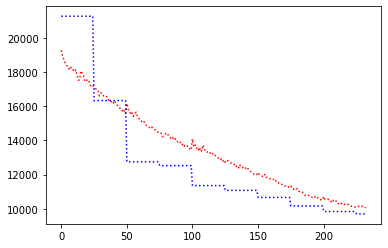

record the last path to gazebo for showing up


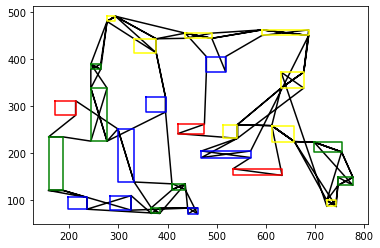

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4.,  9.,  1., 19.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:900/2500, reward:9980.0986328125


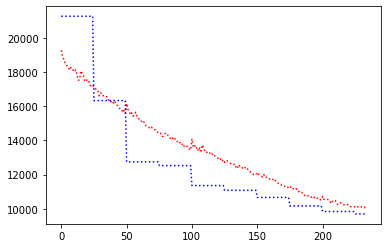

record the last path to gazebo for showing up


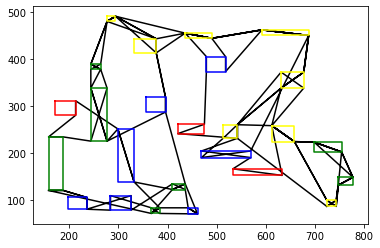

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1000/2500, reward:9959.419921875


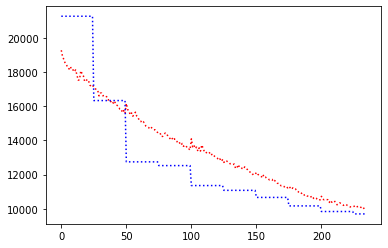

record the last path to gazebo for showing up


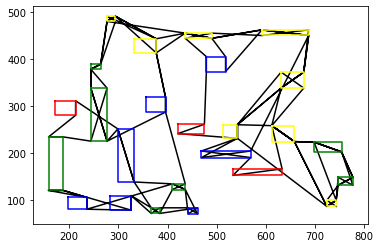

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5.,  8., 21., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1100/2500, reward:10057.583984375


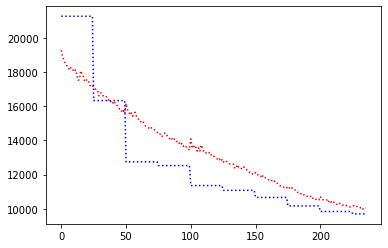

record the last path to gazebo for showing up


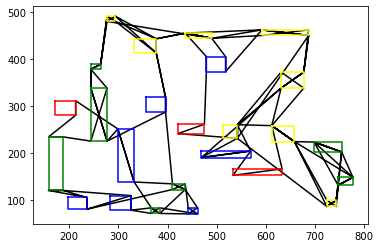

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4.,  9.,  1., 19.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1200/2500, reward:10047.154296875


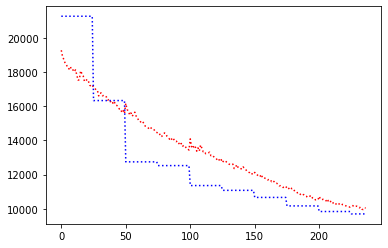

record the last path to gazebo for showing up


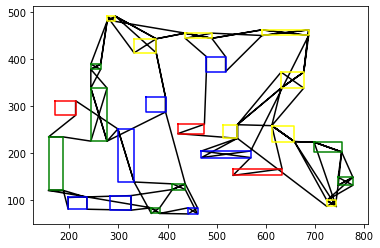

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1300/2500, reward:10111.9462890625


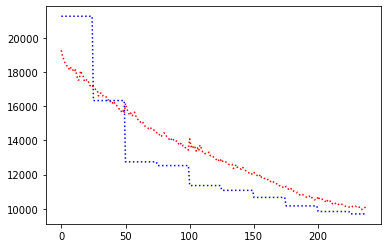

record the last path to gazebo for showing up


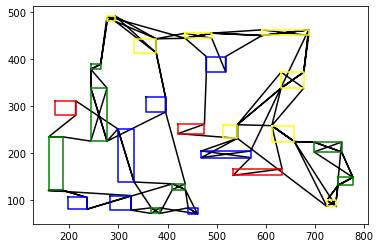

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11., 12., 18.,  7.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1400/2500, reward:10038.6728515625


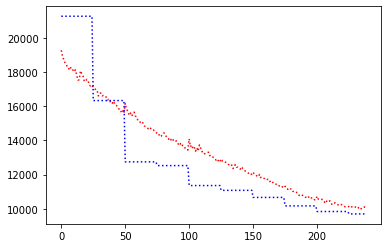

record the last path to gazebo for showing up


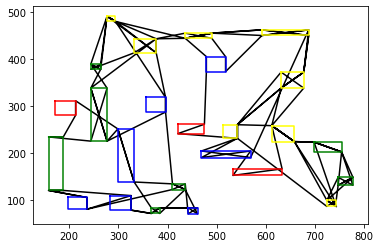

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1500/2500, reward:9983.744140625


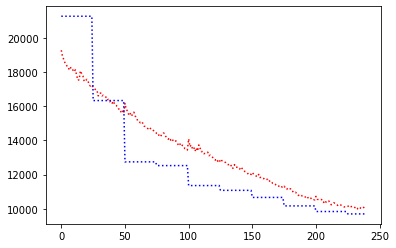

record the last path to gazebo for showing up


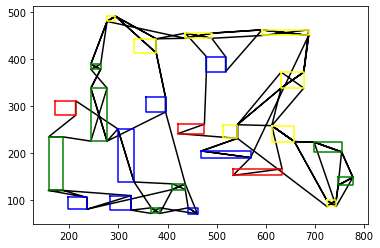

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 18., 12.,  9.,  2., 24., 19.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 10.,  3., 16.,  4.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1600/2500, reward:10006.8447265625


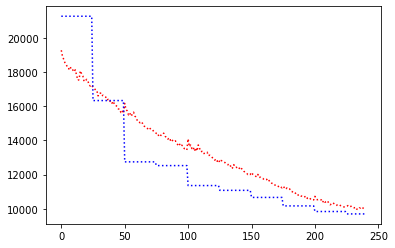

record the last path to gazebo for showing up


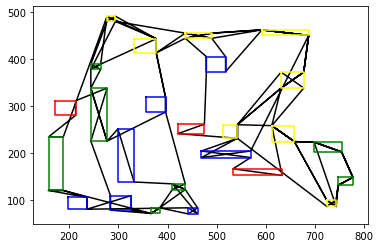

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1700/2500, reward:9961.162109375


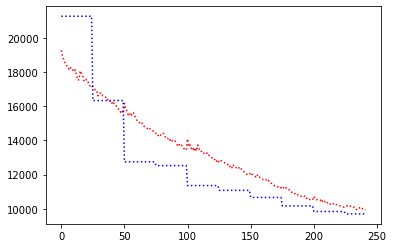

record the last path to gazebo for showing up


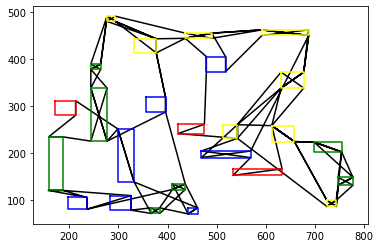

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 20., 13., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1800/2500, reward:10000.8447265625


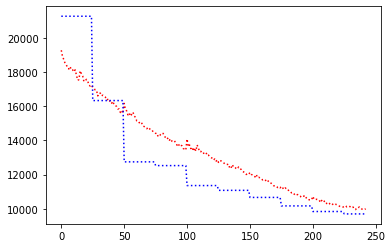

record the last path to gazebo for showing up


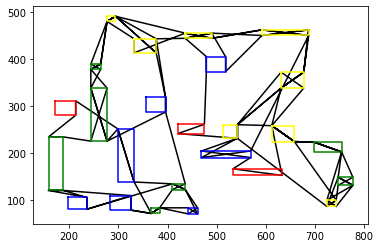

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 23.,  5., 17., 22., 15.,  8., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:1900/2500, reward:9920.9658203125


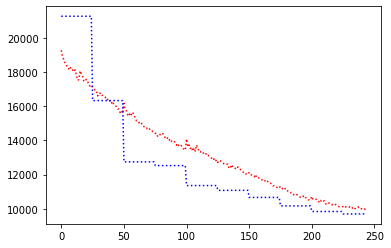

record the last path to gazebo for showing up


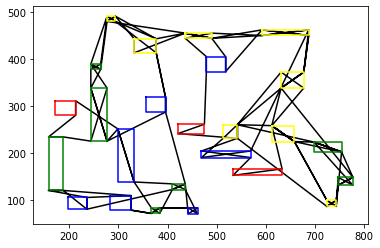

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 23.,  8.,
        14., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2000/2500, reward:9980.978515625


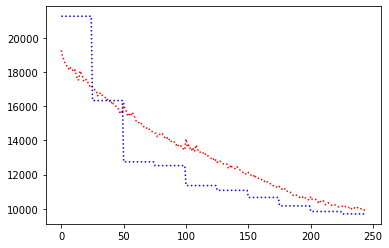

record the last path to gazebo for showing up


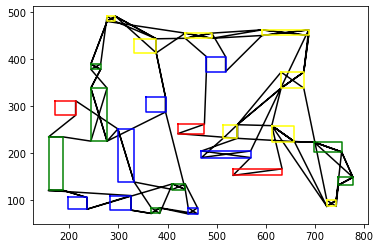

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8.,  5., 23., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2100/2500, reward:9918.7314453125


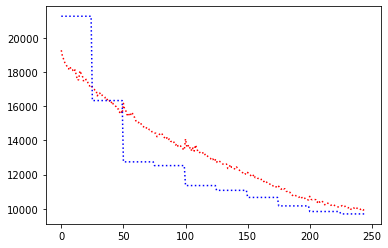

record the last path to gazebo for showing up


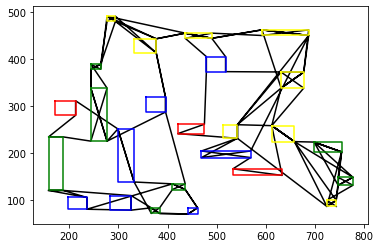

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2200/2500, reward:9928.7421875


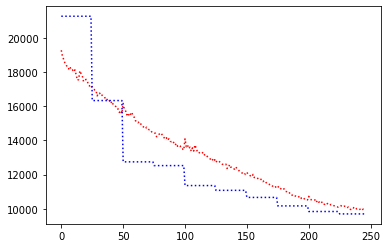

record the last path to gazebo for showing up


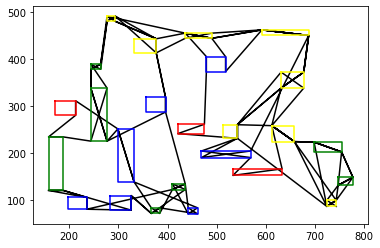

tensor([20.,  6., 13., 14.,  0.,  8., 21., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  4.,  3., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2300/2500, reward:9926.6904296875


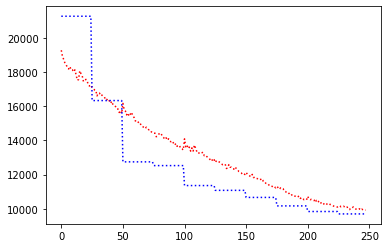

record the last path to gazebo for showing up


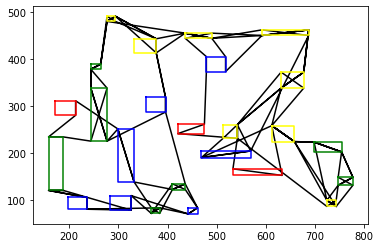

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2400/2500, reward:9913.5791015625


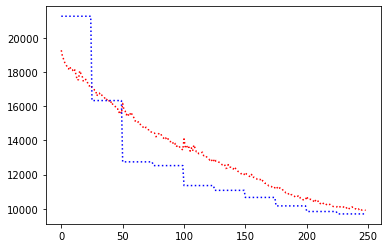

record the last path to gazebo for showing up


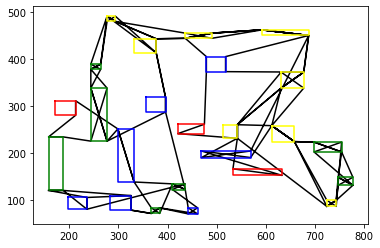

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:9, batch:2500/2500, reward:9882.96875


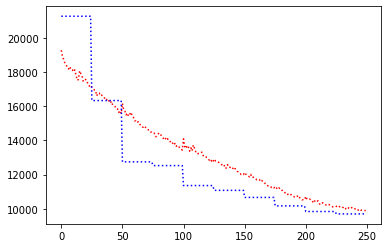

record the last path to gazebo for showing up


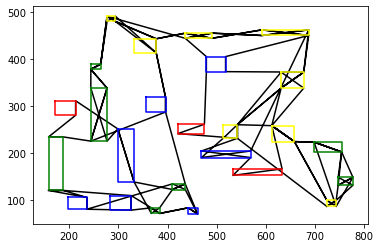

R_val =  tensor(9632.5361, device='cuda:0')
C_val =  9702.2783203125
Avg Actor 9632.5361328125 --- Avg Critic 9702.2783203125
My actor is going on the right road Hallelujah :) Updated
Epoch: 9, epoch time: 157.427min, tot time: 1.088day, L_actor: 9632.536, L_critic: 9702.278, update: True
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:100/2500, reward:9945.095703125


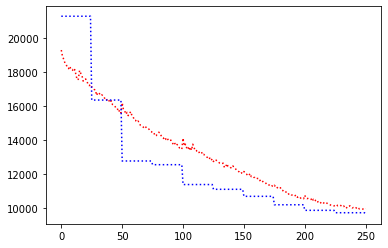

record the last path to gazebo for showing up


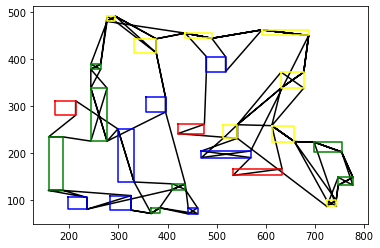

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:200/2500, reward:9962.0234375


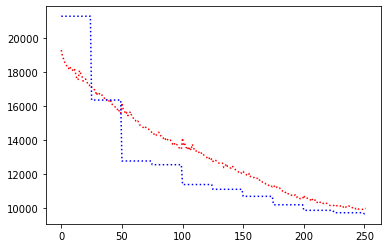

record the last path to gazebo for showing up


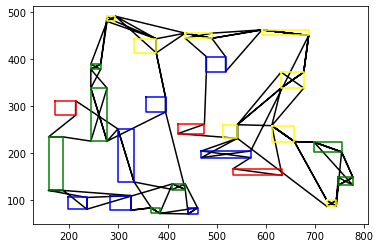

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:300/2500, reward:9876.01171875


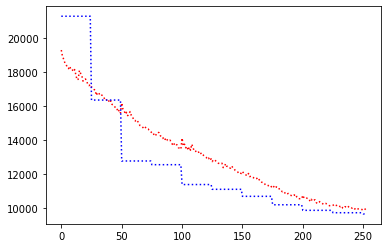

record the last path to gazebo for showing up


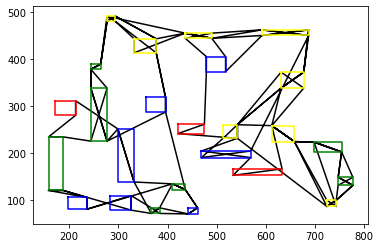

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 21., 23.,  5.,
        17.,  7., 12., 17.,  5.,  8.,  5., 23., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 24., 18.,  9.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:400/2500, reward:10294.2421875


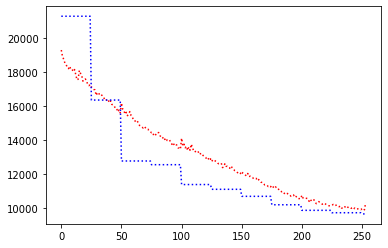

record the last path to gazebo for showing up


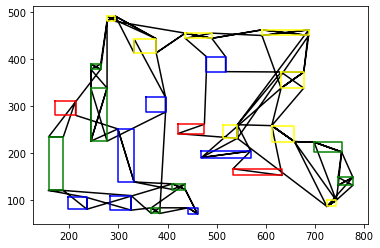

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:500/2500, reward:10006.1181640625


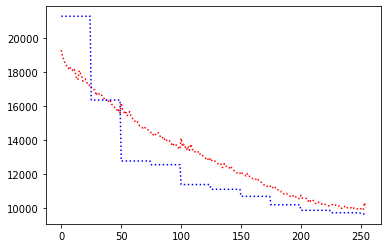

record the last path to gazebo for showing up


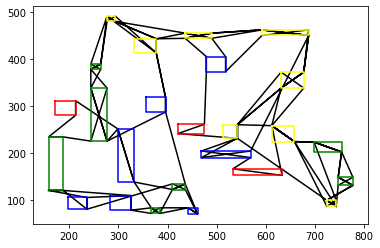

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:600/2500, reward:9910.5810546875


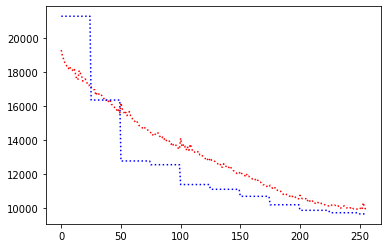

record the last path to gazebo for showing up


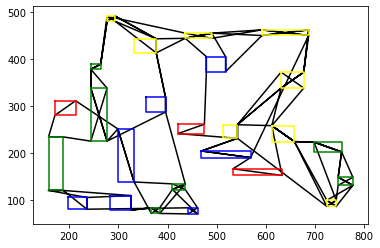

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:700/2500, reward:9939.994140625


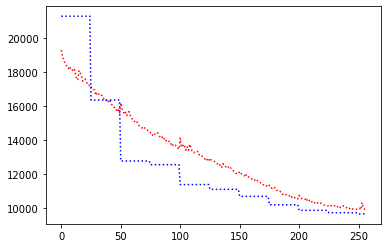

record the last path to gazebo for showing up


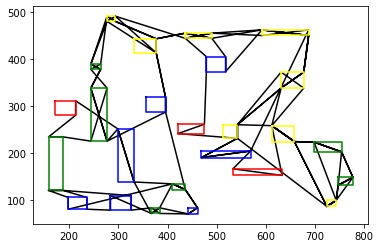

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:800/2500, reward:9899.5869140625


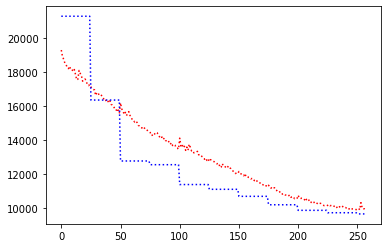

record the last path to gazebo for showing up


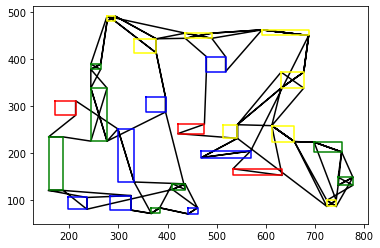

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:900/2500, reward:9902.095703125


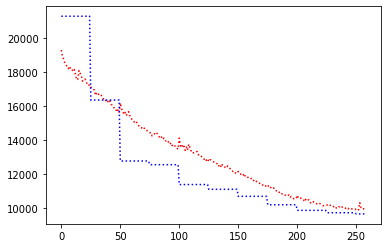

record the last path to gazebo for showing up


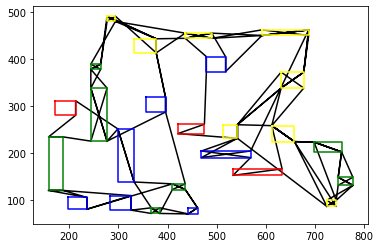

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1000/2500, reward:9849.326171875


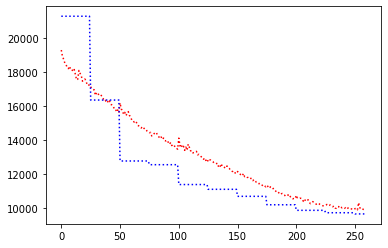

record the last path to gazebo for showing up


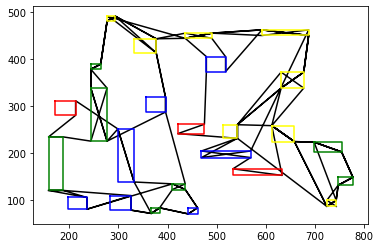

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1100/2500, reward:9876.1298828125


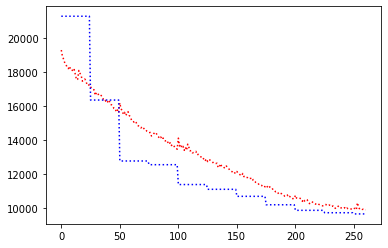

record the last path to gazebo for showing up


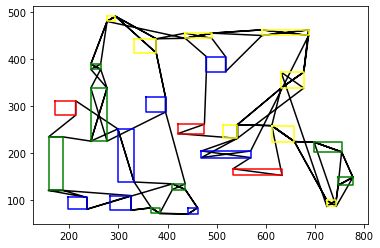

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 14., 20., 20.,
        23.,  8.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8.,  5., 17.,  7.,
        12., 23.,  5., 21.,  8., 23.,  5., 17.,  7., 12., 22., 17., 24.,  7.,
        12., 11., 18.,  9.,  2., 10.,  4.,  3., 11.,  7., 18., 24., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1200/2500, reward:9874.666015625


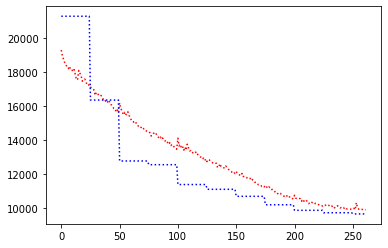

record the last path to gazebo for showing up


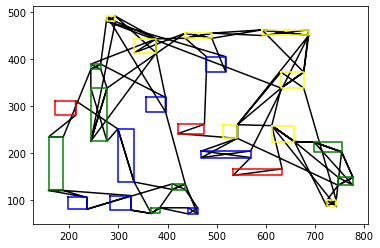

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  3.,  4., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1300/2500, reward:9878.8544921875


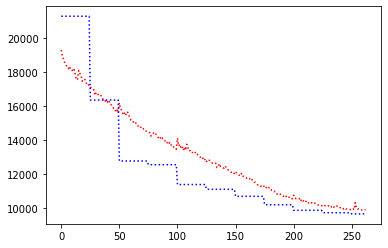

record the last path to gazebo for showing up


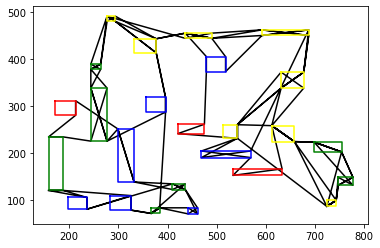

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1400/2500, reward:9857.0458984375


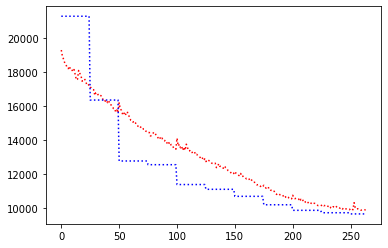

record the last path to gazebo for showing up


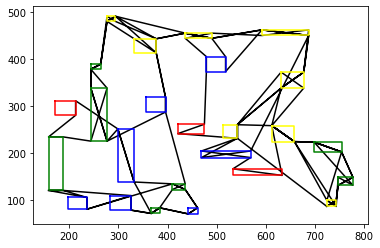

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1500/2500, reward:9832.91796875


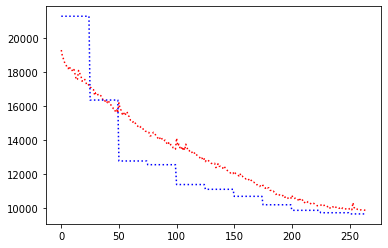

record the last path to gazebo for showing up


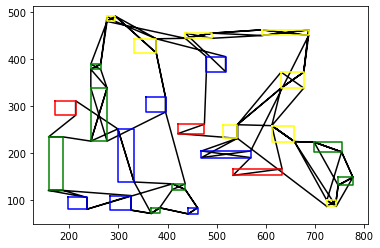

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:10, batch:1600/2500, reward:9838.498046875


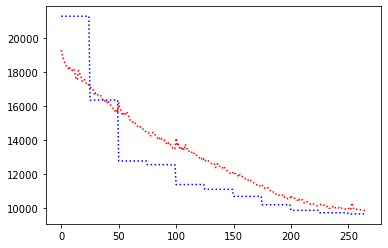

record the last path to gazebo for showing up


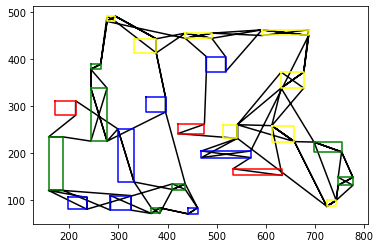

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1700/2500, reward:9870.833984375


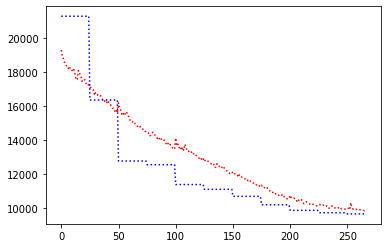

record the last path to gazebo for showing up


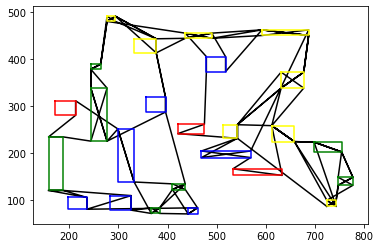

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1800/2500, reward:9815.90625


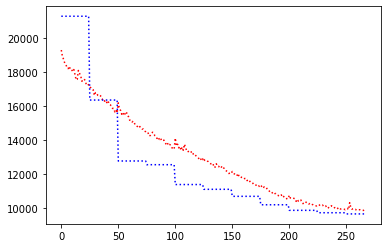

record the last path to gazebo for showing up


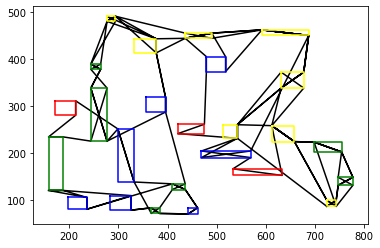

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 14., 20., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:1900/2500, reward:9834.1201171875


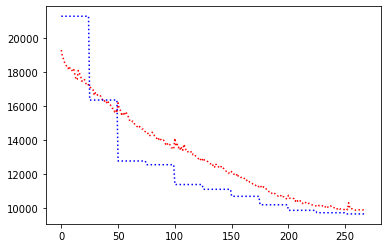

record the last path to gazebo for showing up


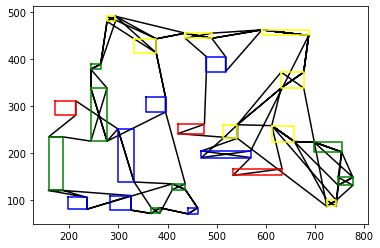

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2000/2500, reward:9830.716796875


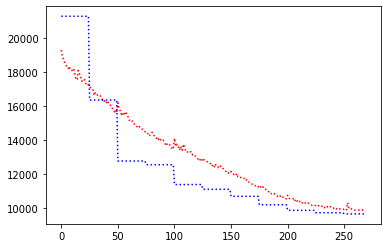

record the last path to gazebo for showing up


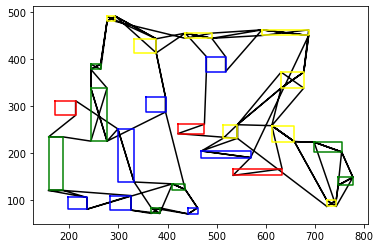

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4.,  9.,  1., 19.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2100/2500, reward:9811.3115234375


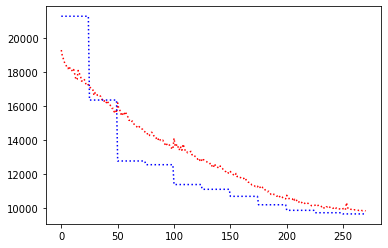

record the last path to gazebo for showing up


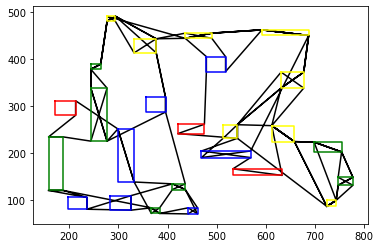

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  4., 16.,  3., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2200/2500, reward:9825.4521484375


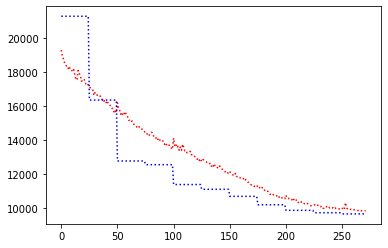

record the last path to gazebo for showing up


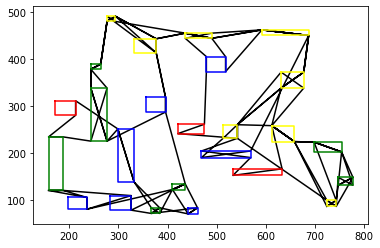

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2300/2500, reward:9802.6826171875


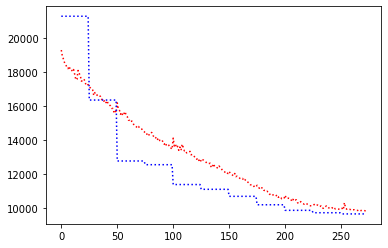

record the last path to gazebo for showing up


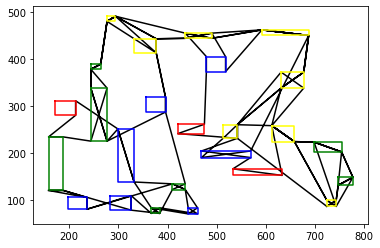

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20., 13.,  6., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2400/2500, reward:9809.998046875


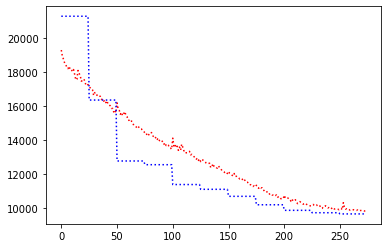

record the last path to gazebo for showing up


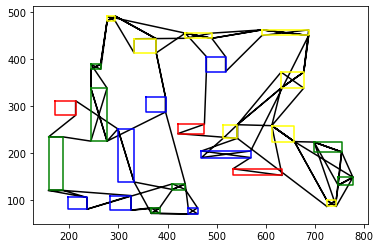

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:10, batch:2500/2500, reward:9784.234375


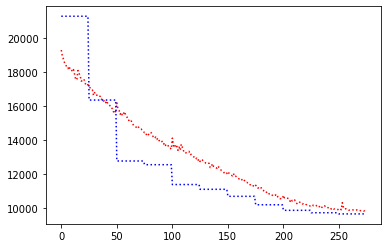

record the last path to gazebo for showing up


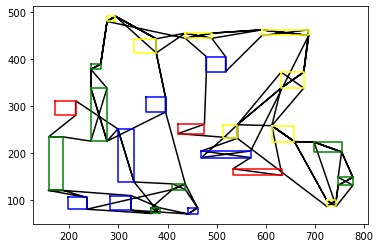

R_val =  tensor(9627.9209, device='cuda:0')
C_val =  9632.5361328125
Avg Actor 9627.9208984375 --- Avg Critic 9632.5361328125
My actor is going on the right road Hallelujah :) Updated
Epoch: 10, epoch time: 156.943min, tot time: 1.197day, L_actor: 9627.921, L_critic: 9632.536, update: True
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:100/2500, reward:9779.3056640625


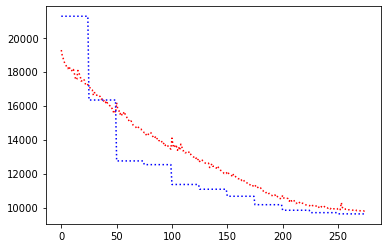

record the last path to gazebo for showing up


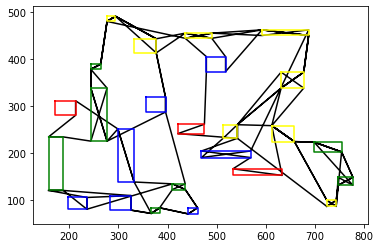

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:200/2500, reward:9839.189453125


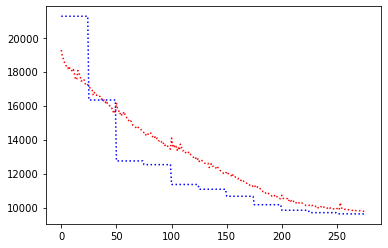

record the last path to gazebo for showing up


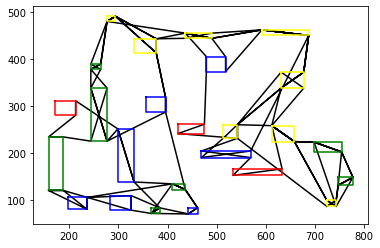

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:300/2500, reward:9785.5517578125


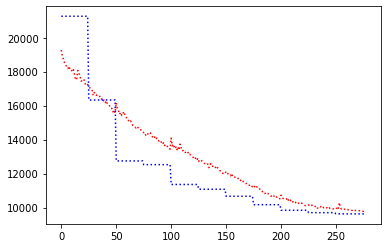

record the last path to gazebo for showing up


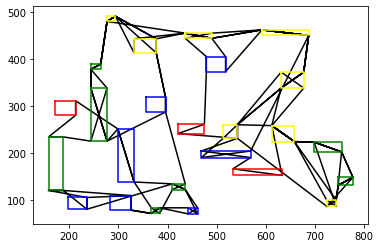

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9., 10.,  4.,  3., 11.,  7., 12., 18., 24.,
        10.,  3., 16.,  4., 19.,  2.,  4.,  3., 16.,  9.,  1., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:400/2500, reward:9824.25


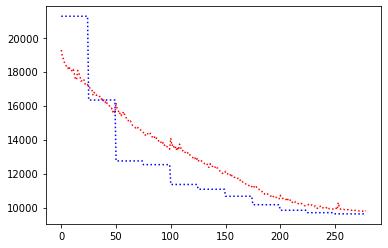

record the last path to gazebo for showing up


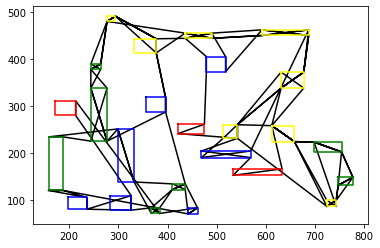

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:500/2500, reward:9811.4921875


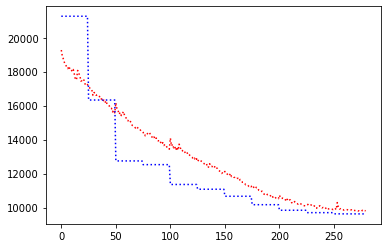

record the last path to gazebo for showing up


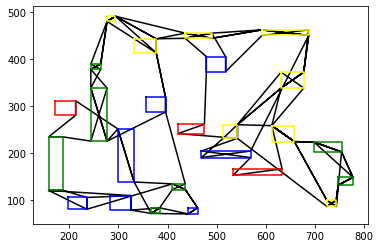

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:600/2500, reward:9799.3125


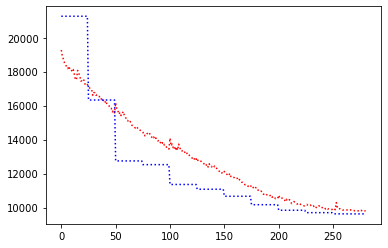

record the last path to gazebo for showing up


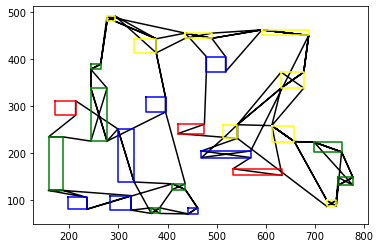

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:700/2500, reward:9831.197265625


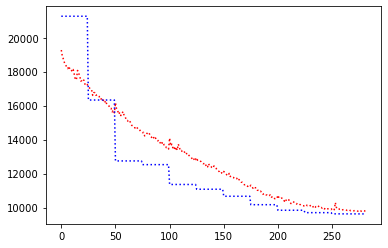

record the last path to gazebo for showing up


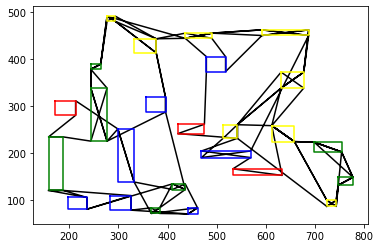

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:800/2500, reward:9811.751953125


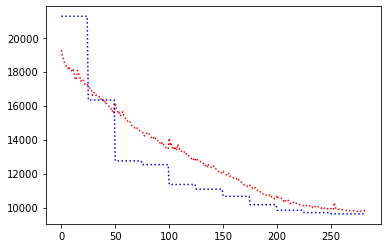

record the last path to gazebo for showing up


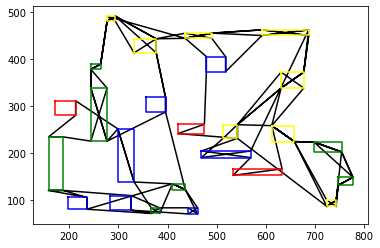

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:900/2500, reward:9781.3330078125


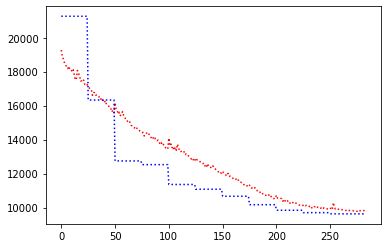

record the last path to gazebo for showing up


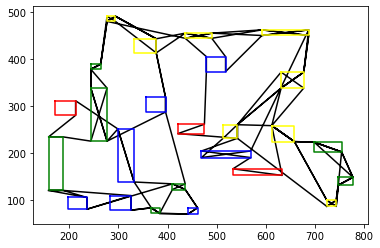

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1000/2500, reward:9804.6474609375


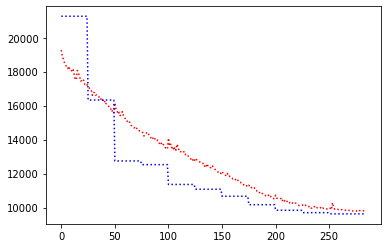

record the last path to gazebo for showing up


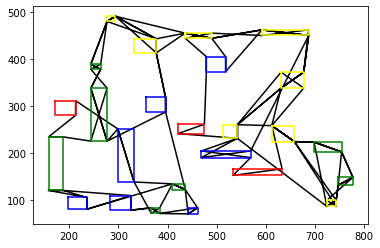

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1100/2500, reward:9802.8408203125


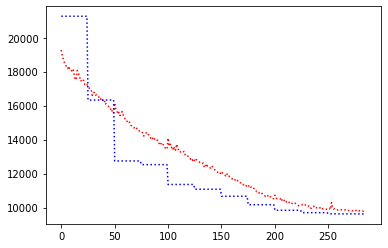

record the last path to gazebo for showing up


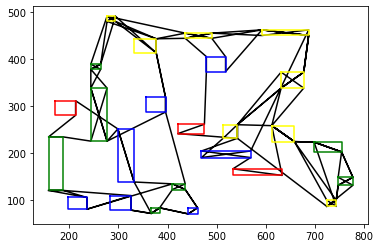

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1200/2500, reward:9779.8134765625


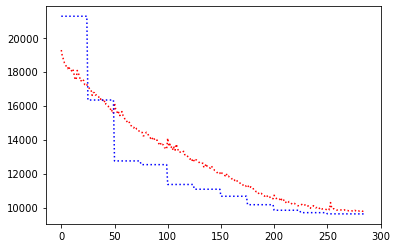

record the last path to gazebo for showing up


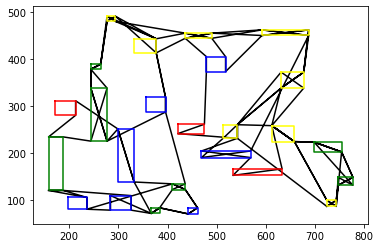

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9., 10.,  4.,  3., 11.,  7., 12., 18., 24.,
         2.,  3., 16.,  4., 19.,  9.,  1., 10.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1300/2500, reward:9761.17578125


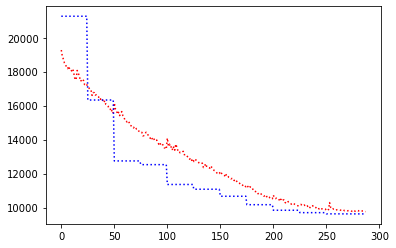

record the last path to gazebo for showing up


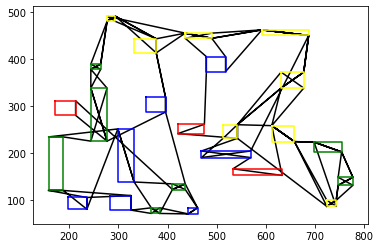

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1400/2500, reward:9780.833984375


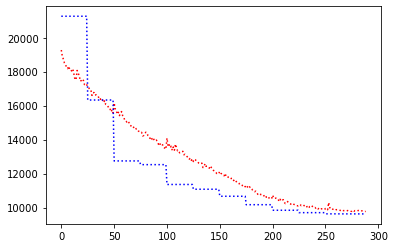

record the last path to gazebo for showing up


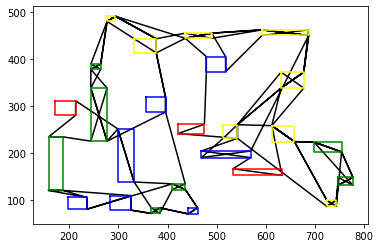

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1500/2500, reward:9782.6708984375


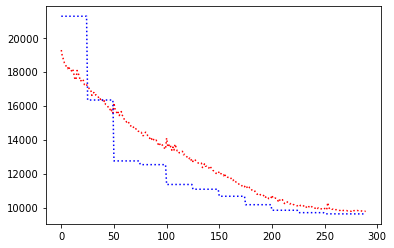

record the last path to gazebo for showing up


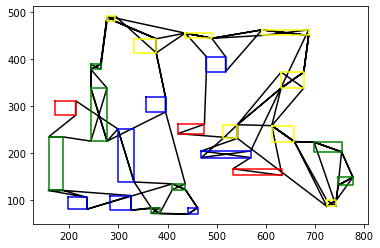

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1600/2500, reward:9734.744140625


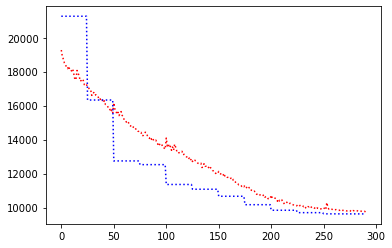

record the last path to gazebo for showing up


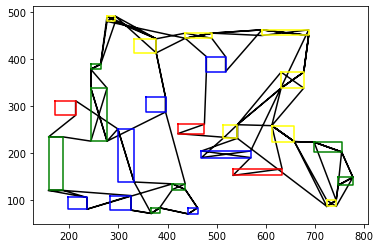

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1700/2500, reward:9786.2314453125


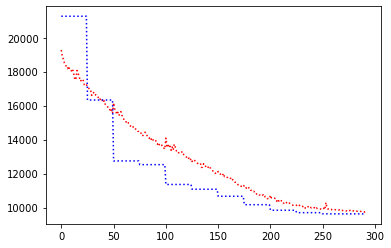

record the last path to gazebo for showing up


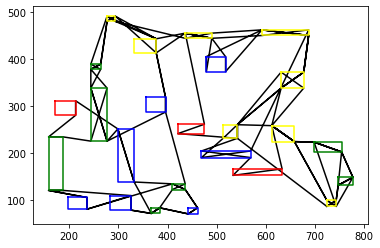

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10., 16.,  3.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1800/2500, reward:9774.7861328125


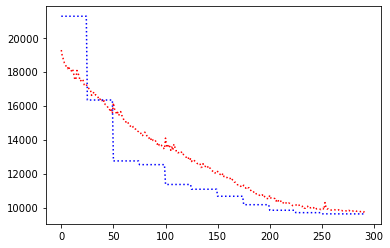

record the last path to gazebo for showing up


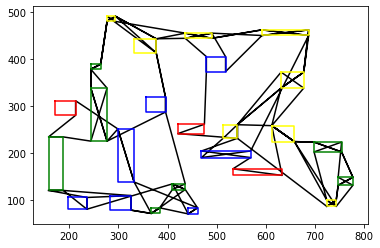

tensor([20.,  6., 13., 14., 21.,  0.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:1900/2500, reward:9787.626953125


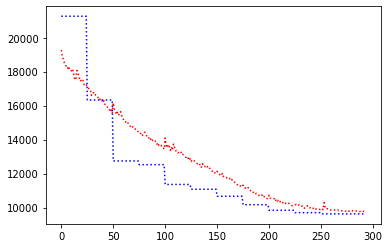

record the last path to gazebo for showing up


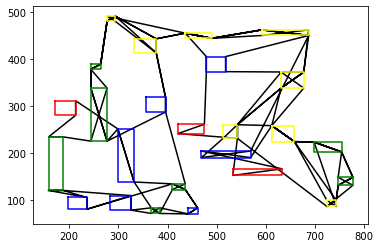

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 12., 18., 24., 11.,
         7., 12., 18., 24.,  9.,  2., 17.,  7., 11.,  4.,  3., 10.,  3., 16.,
         4., 19.,  9.,  1.,  3., 16., 10.,  4., 12., 18., 24.,  1., 19.,  9.],
       device='cuda:0')
epoch:11, batch:2000/2500, reward:9755.98828125


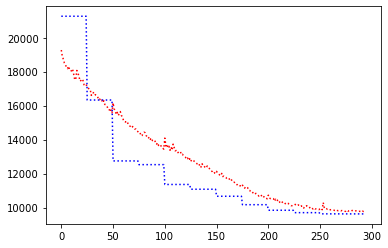

record the last path to gazebo for showing up


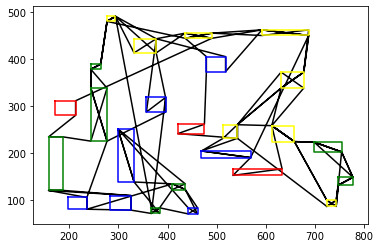

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:2100/2500, reward:9769.07421875


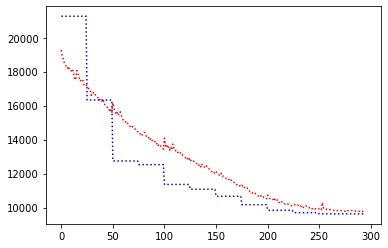

record the last path to gazebo for showing up


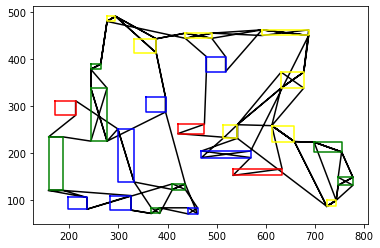

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:2200/2500, reward:9737.08203125


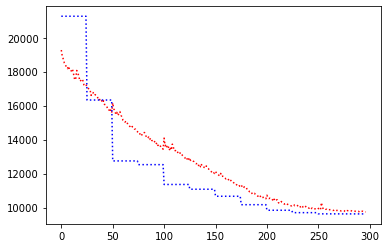

record the last path to gazebo for showing up


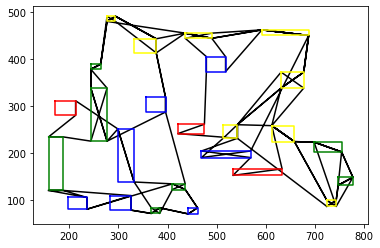

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:2300/2500, reward:9843.4619140625


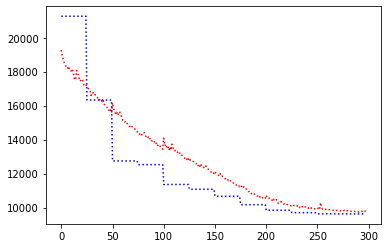

record the last path to gazebo for showing up


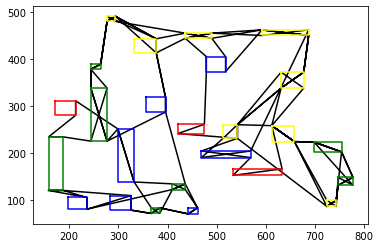

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:2400/2500, reward:9735.677734375


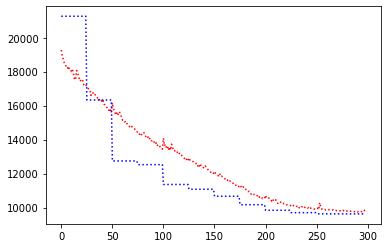

record the last path to gazebo for showing up


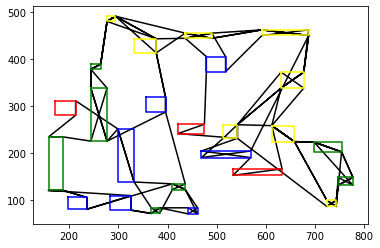

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:11, batch:2500/2500, reward:9818.392578125


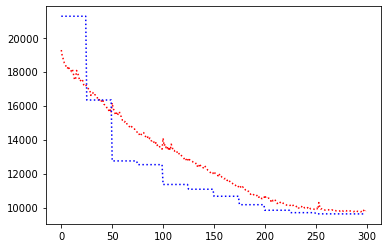

record the last path to gazebo for showing up


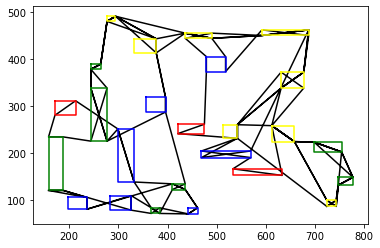

R_val =  tensor(9626.5840, device='cuda:0')
C_val =  9627.9208984375
Avg Actor 9626.583984375 --- Avg Critic 9627.9208984375
My actor is going on the right road Hallelujah :) Updated
Epoch: 11, epoch time: 157.996min, tot time: 1.307day, L_actor: 9626.584, L_critic: 9627.921, update: True
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:100/2500, reward:9817.71484375


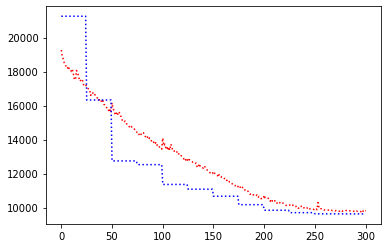

record the last path to gazebo for showing up


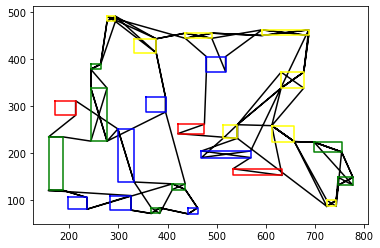

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:200/2500, reward:9733.087890625


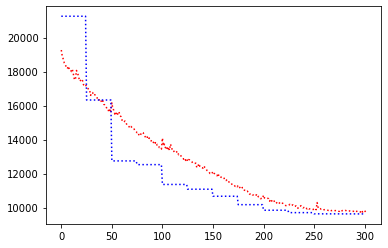

record the last path to gazebo for showing up


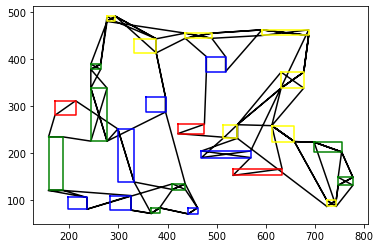

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:300/2500, reward:9774.017578125


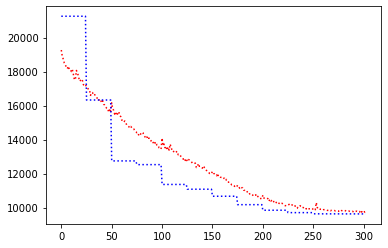

record the last path to gazebo for showing up


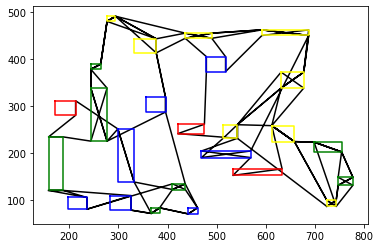

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:400/2500, reward:9749.6875


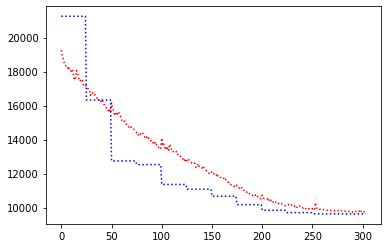

record the last path to gazebo for showing up


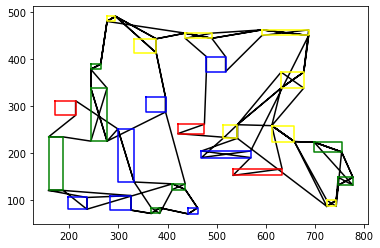

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:500/2500, reward:9786.671875


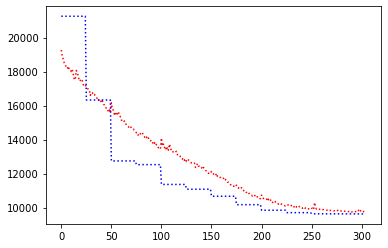

record the last path to gazebo for showing up


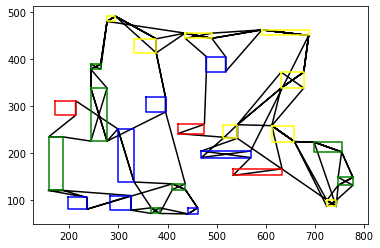

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:600/2500, reward:9726.48828125


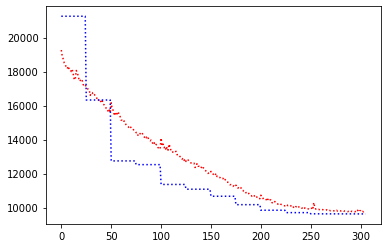

record the last path to gazebo for showing up


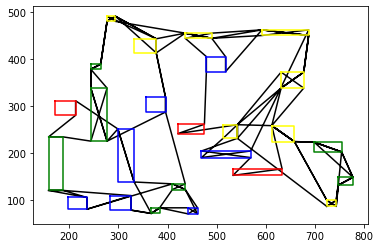

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 14., 20., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:700/2500, reward:9745.6484375


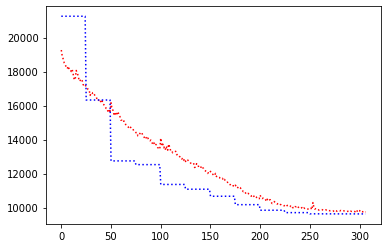

record the last path to gazebo for showing up


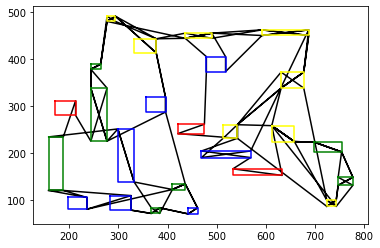

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 23.,  5., 17., 22., 15.,  8., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:800/2500, reward:9729.5390625


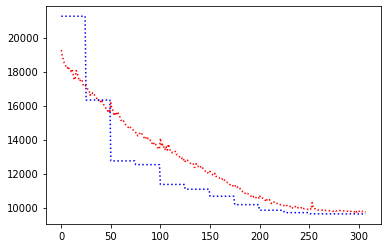

record the last path to gazebo for showing up


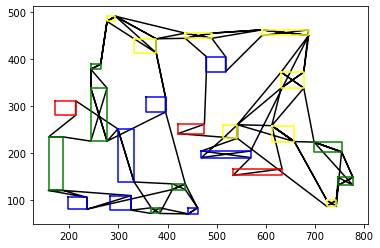

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 14., 20., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:900/2500, reward:9760.8037109375


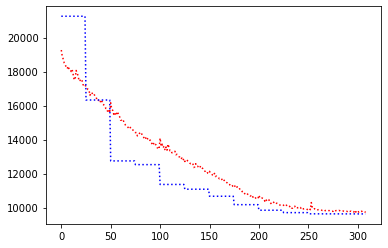

record the last path to gazebo for showing up


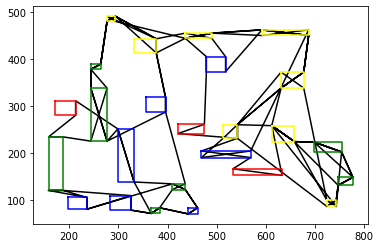

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1000/2500, reward:9729.4921875


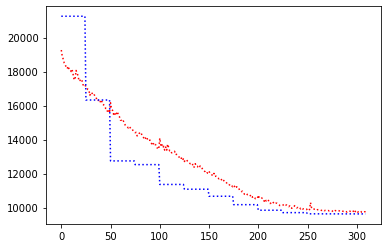

record the last path to gazebo for showing up


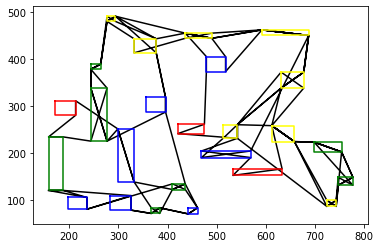

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1100/2500, reward:9694.65234375


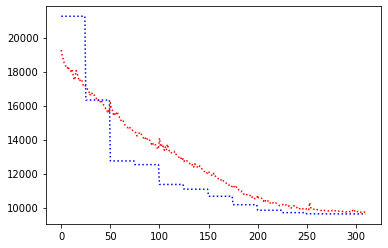

record the last path to gazebo for showing up


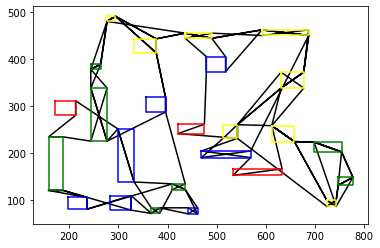

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1200/2500, reward:9764.232421875


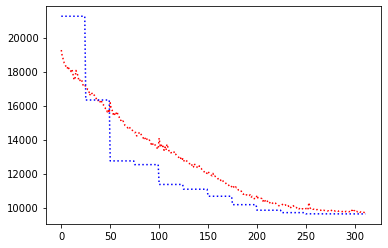

record the last path to gazebo for showing up


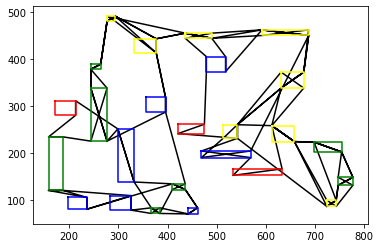

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1300/2500, reward:9720.896484375


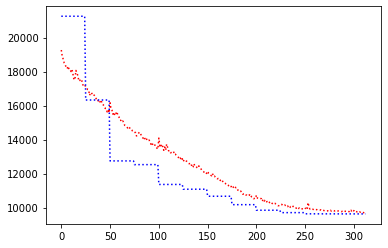

record the last path to gazebo for showing up


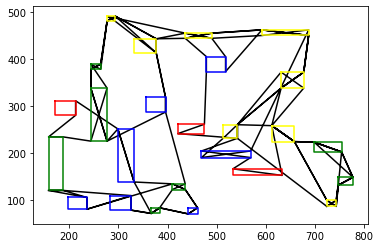

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  2.,  9., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1400/2500, reward:9713.6640625


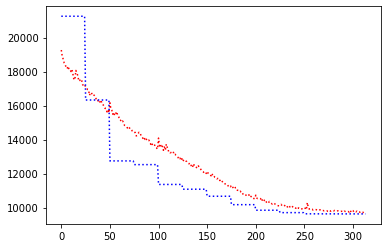

record the last path to gazebo for showing up


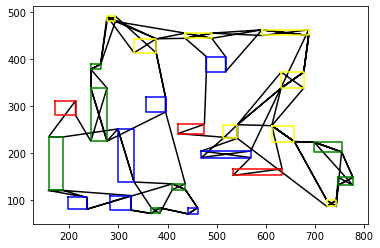

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1500/2500, reward:9715.4033203125


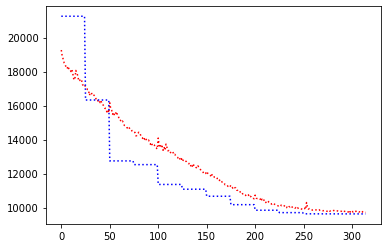

record the last path to gazebo for showing up


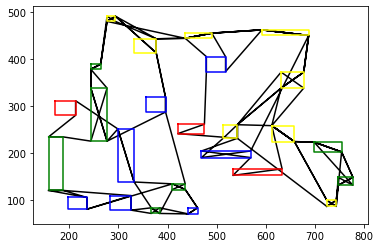

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 23.,  8.,
        14., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1600/2500, reward:9706.56640625


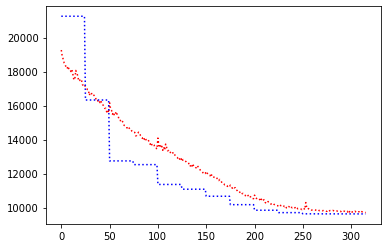

record the last path to gazebo for showing up


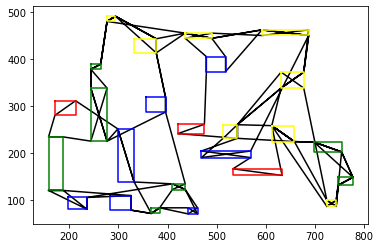

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1700/2500, reward:9745.3720703125


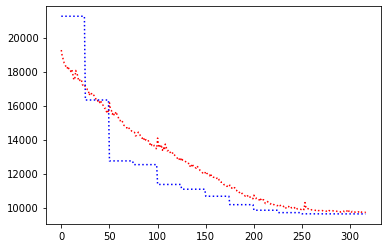

record the last path to gazebo for showing up


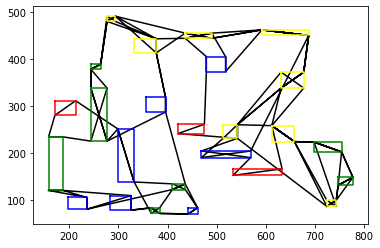

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14.,  8.,
        23.,  8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1800/2500, reward:9722.654296875


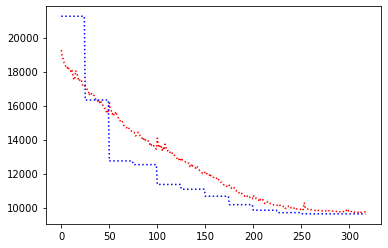

record the last path to gazebo for showing up


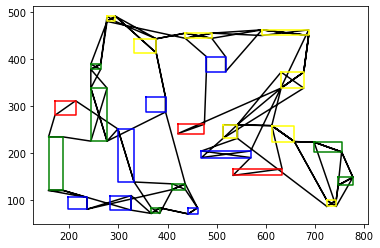

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:1900/2500, reward:9759.6259765625


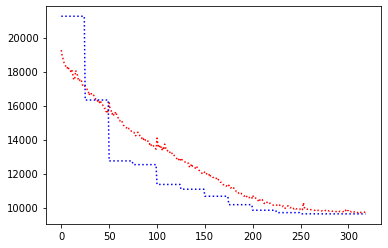

record the last path to gazebo for showing up


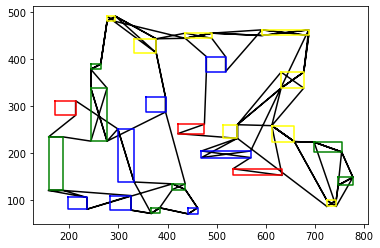

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2000/2500, reward:9736.1865234375


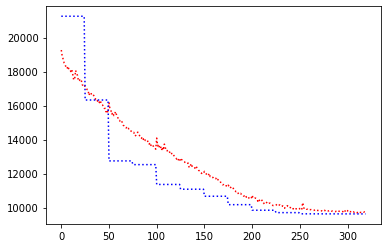

record the last path to gazebo for showing up


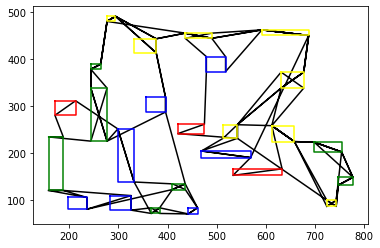

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2100/2500, reward:9744.041015625


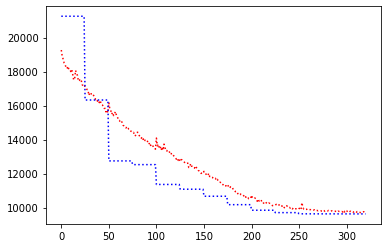

record the last path to gazebo for showing up


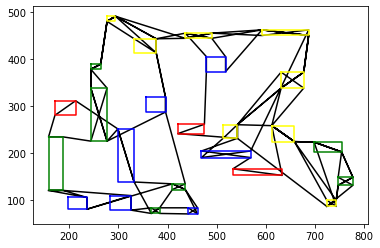

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2200/2500, reward:9707.43359375


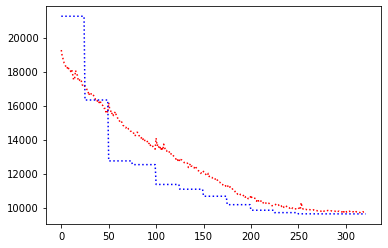

record the last path to gazebo for showing up


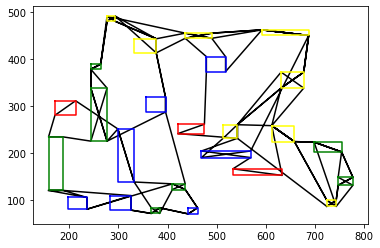

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2300/2500, reward:9755.2041015625


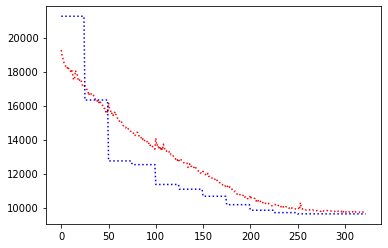

record the last path to gazebo for showing up


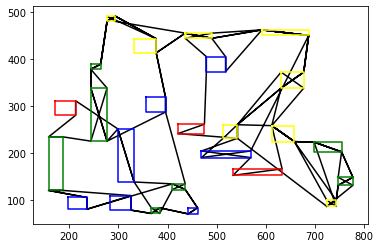

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20., 13.,  6., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2400/2500, reward:9732.4775390625


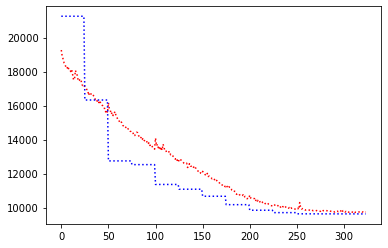

record the last path to gazebo for showing up


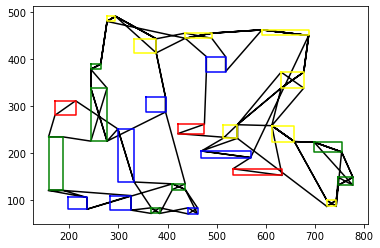

tensor([20.,  6., 13., 14.,  0., 21.,  8., 14., 20.,  6., 13., 20., 14., 23.,
         8., 20.,  6., 13., 14., 23.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  2., 10.,  4.,  3., 11.,  7., 12., 18.,
        24., 10.,  3., 16.,  4., 19.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:12, batch:2500/2500, reward:9714.4658203125


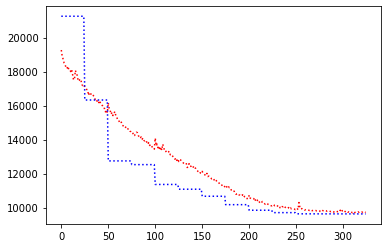

record the last path to gazebo for showing up


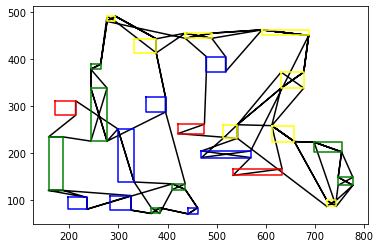

R_val =  tensor(9626.5576, device='cuda:0')
C_val =  9626.583984375
Avg Actor 9626.5576171875 --- Avg Critic 9626.583984375
My actor is going on the right road Hallelujah :) Updated
Epoch: 12, epoch time: 157.942min, tot time: 1.417day, L_actor: 9626.558, L_critic: 9626.584, update: True
Save Checkpoints
tensor([20.,  6., 13.,  0., 14., 21.,  8.,  6., 20., 14., 20., 13., 14., 20.,
         6., 13., 14.,  8., 23., 23.,  5., 17., 22.,  5., 23.,  8., 21.,  8.,
        23.,  5., 17.,  7., 12., 17.,  5., 22., 17.,  7., 12., 18., 15.,  4.,
         3.,  7., 12., 24., 11.,  7., 12., 18., 24.,  3., 11., 16., 16.,  9.,
        18., 24., 10.,  3.,  4., 19., 10.,  9.,  2.,  1.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:100/2500, reward:13781.15234375


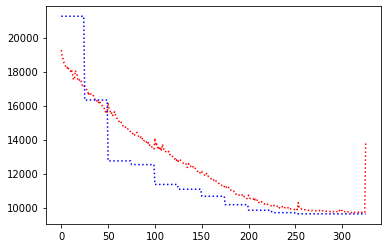

record the last path to gazebo for showing up


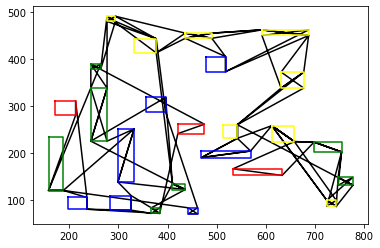

tensor([20.,  6., 13., 14., 21.,  0.,  8., 20.,  6., 14., 20., 20., 13.,  8.,
        14.,  6., 23.,  5., 22., 23., 13., 15.,  8., 14., 21.,  4.,  8.,  9.,
        12., 17.,  7.,  5., 23.,  3., 24., 17.,  7., 18., 12.,  5., 23., 17.,
        16.,  3.,  4., 11.,  3., 16., 22.,  5., 17.,  7., 12.,  9.,  7., 12.,
        18., 19., 10., 24.,  1., 11.,  4., 19.,  1., 10., 18., 24.,  9.,  2.],
       device='cuda:0')
epoch:13, batch:200/2500, reward:14916.525390625


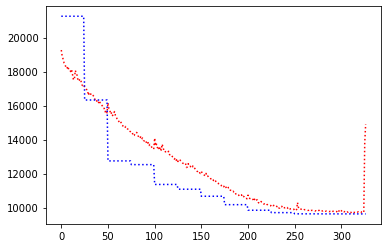

record the last path to gazebo for showing up


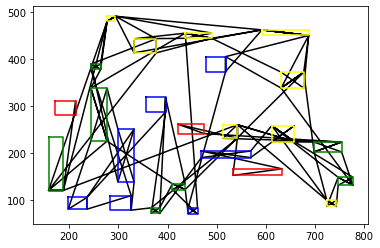

tensor([20., 13.,  6.,  0., 14., 21., 23.,  5.,  8., 20., 14.,  6., 20., 13.,
        20.,  6., 13.,  8., 23., 14., 14., 22., 15., 17.,  8., 23., 17.,  7.,
        12.,  5., 23., 21.,  8.,  5., 17., 22.,  5., 17., 12., 18.,  7., 24.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 10., 19.,  1.,  2.,  9., 19.,  1.,  4.,  3., 16.,  9.],
       device='cuda:0')
epoch:13, batch:300/2500, reward:13736.41796875


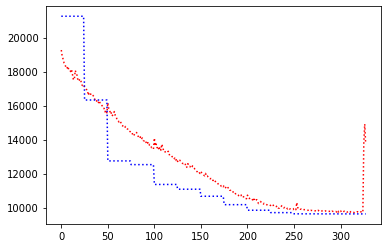

record the last path to gazebo for showing up


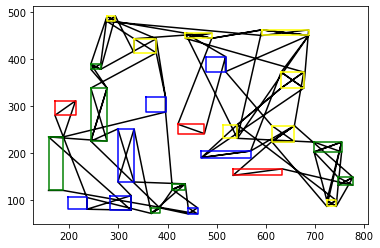

tensor([ 6., 20., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 13., 20., 23.,
         8., 14., 20.,  6., 13., 14., 23.,  5., 22., 17., 15.,  8.,  5., 17.,
         7., 12., 17., 21.,  8., 23.,  5., 22.,  5., 17.,  7., 12., 18., 24.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24.,  9.,
         9.,  2.,  3., 16.,  4., 19., 10.,  1., 10.,  3., 16.,  4., 19.,  1.],
       device='cuda:0')
epoch:13, batch:400/2500, reward:11974.8203125


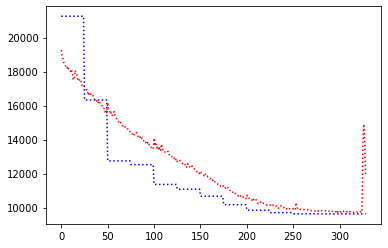

record the last path to gazebo for showing up


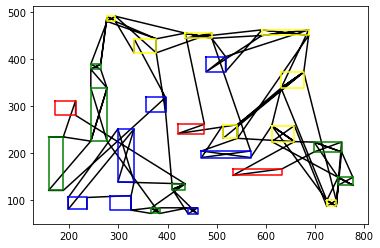

tensor([20., 13.,  0.,  6., 14., 21.,  8., 23.,  6., 20., 13., 14., 20., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
        16.,  3.,  4., 19., 10.,  2.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:500/2500, reward:11659.71875


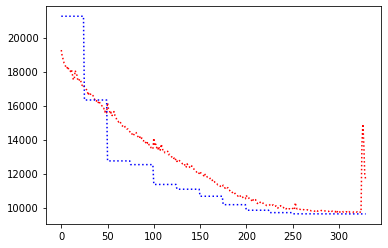

record the last path to gazebo for showing up


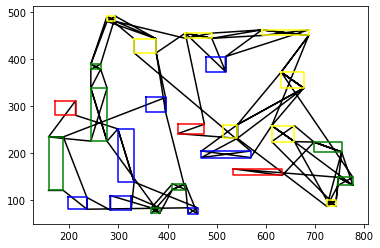

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 14., 20.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  4.,  3., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:600/2500, reward:11521.49609375


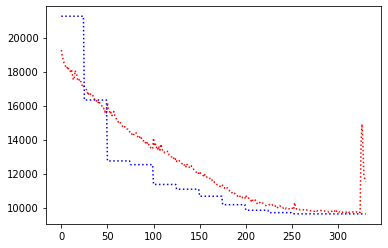

record the last path to gazebo for showing up


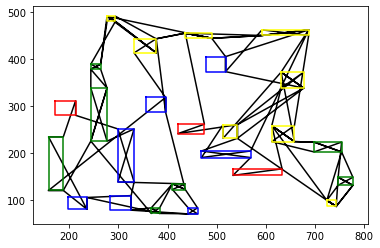

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 24., 18.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24.,  2.,
         9., 16.,  3.,  4., 19., 10.,  1.,  3., 16., 10.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:700/2500, reward:11328.0986328125


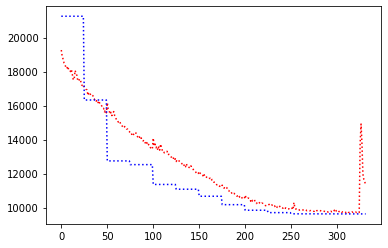

record the last path to gazebo for showing up


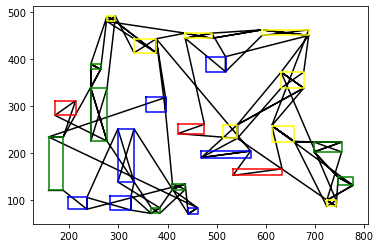

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
         9., 11.,  7., 12., 24., 18.,  2.,  4.,  3., 11.,  7., 12., 18., 24.,
        10.,  3., 16.,  4., 19., 10.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:800/2500, reward:11306.0751953125


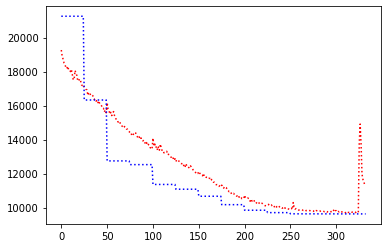

record the last path to gazebo for showing up


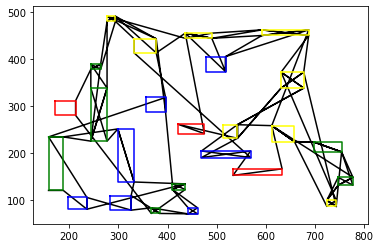

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 17., 21.,  8., 23.,  5., 22.,  5., 17.,  7., 12., 18., 24.,
         9., 11.,  7., 12., 18., 24.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:900/2500, reward:11208.609375


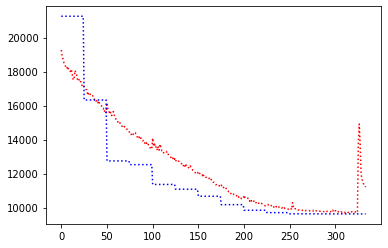

record the last path to gazebo for showing up


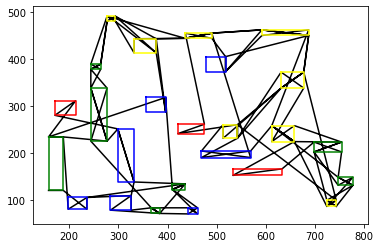

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14., 22.,  5., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1000/2500, reward:11224.63671875


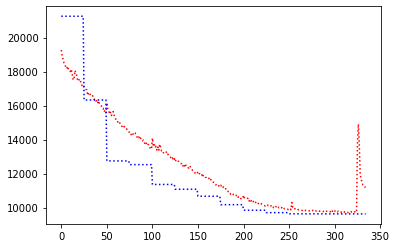

record the last path to gazebo for showing up


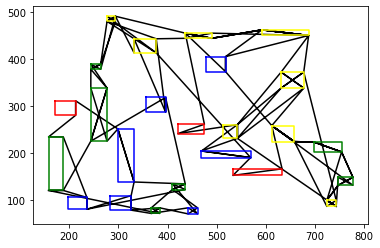

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14., 22., 17.,  5., 15.,  8., 23.,  5., 17.,
        12.,  7., 17., 21.,  8., 23.,  5., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
        16.,  3.,  4., 19., 10.,  2.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1100/2500, reward:11116.130859375


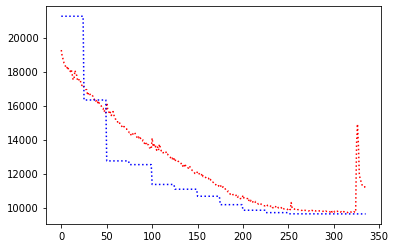

record the last path to gazebo for showing up


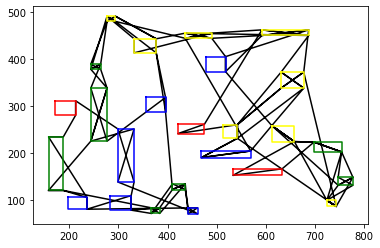

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3.,  4., 16., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1200/2500, reward:11057.009765625


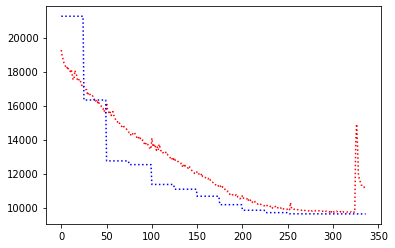

record the last path to gazebo for showing up


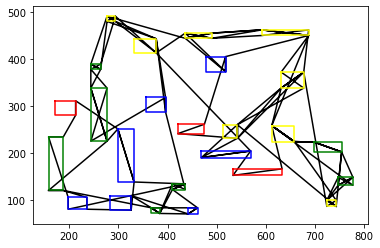

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 23.,
         8., 14.,  6., 20., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
        16.,  3.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1300/2500, reward:11073.1875


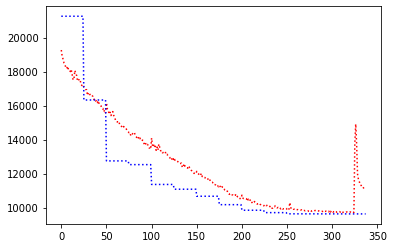

record the last path to gazebo for showing up


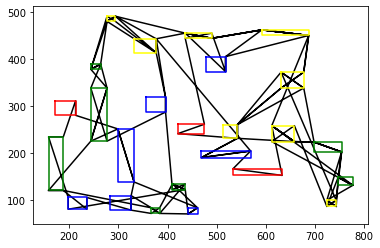

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
         7., 12., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1400/2500, reward:10944.611328125


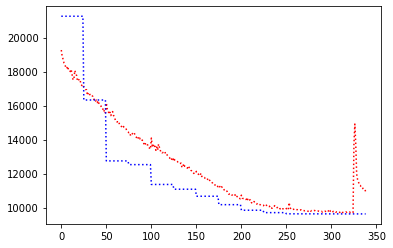

record the last path to gazebo for showing up


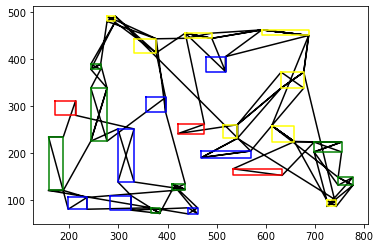

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13.,  5., 22., 17., 15.,  8., 14., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1500/2500, reward:10910.85546875


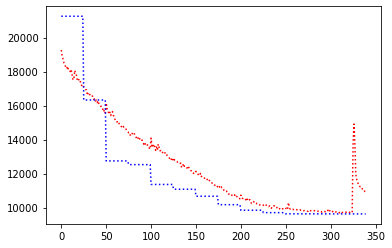

record the last path to gazebo for showing up


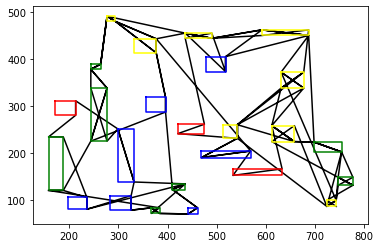

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1600/2500, reward:10839.662109375


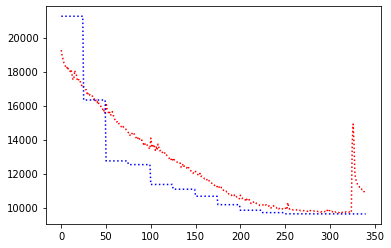

record the last path to gazebo for showing up


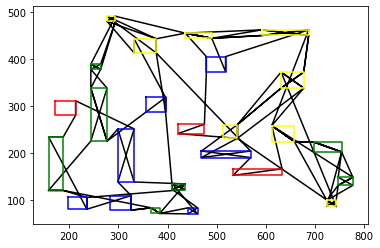

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 22., 17., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3.,  3., 16.,  4.,  3., 11.,  7.,
        12., 18., 24., 10., 16., 19., 10.,  2.,  9.,  1.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1700/2500, reward:10798.97265625


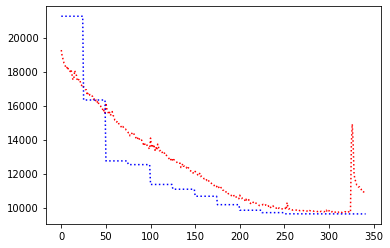

record the last path to gazebo for showing up


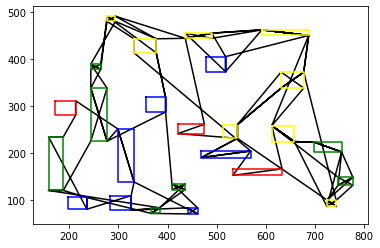

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1800/2500, reward:10768.6171875


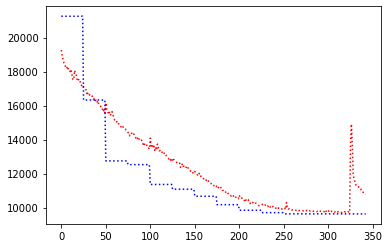

record the last path to gazebo for showing up


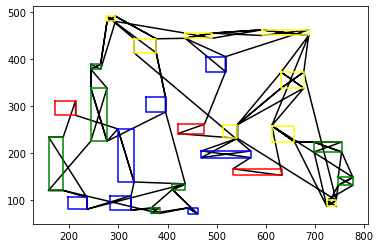

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23., 20.,  6., 13., 14.,  5., 17., 22., 15.,  8., 23., 21.,  8.,
         5., 17., 12.,  7., 17.,  5., 23.,  5., 17., 22.,  7., 12., 18., 11.,
         7., 12., 18., 24.,  9., 24.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
        16.,  3.,  4., 19., 10.,  2.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:1900/2500, reward:10763.546875


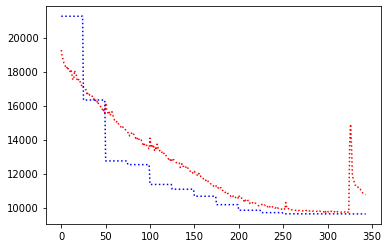

record the last path to gazebo for showing up


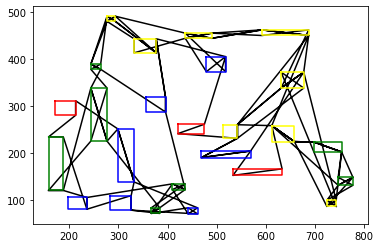

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
        23.,  8., 20.,  6., 13., 14.,  5., 17., 22., 15.,  8., 23.,  5., 17.,
        12.,  7., 21.,  8., 23.,  5., 17., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 24., 18., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2000/2500, reward:10580.8515625


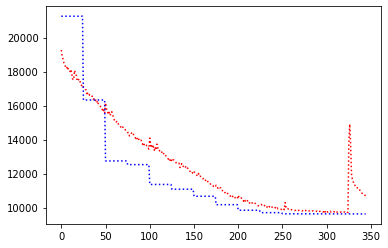

record the last path to gazebo for showing up


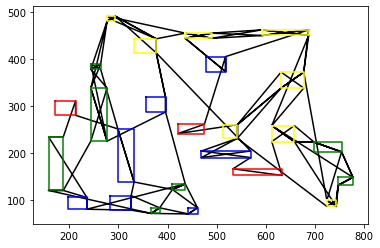

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20., 13.,  6., 14., 23.,  5., 17.,
        12.,  7., 17., 21.,  8., 23.,  5.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2100/2500, reward:10586.5419921875


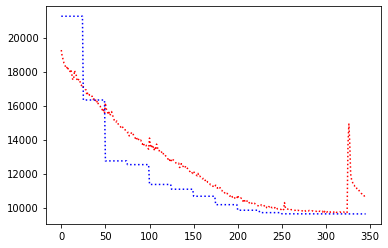

record the last path to gazebo for showing up


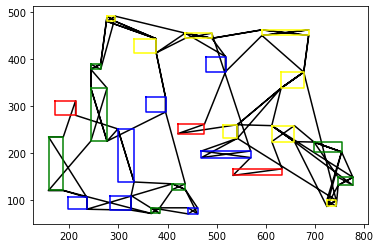

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2200/2500, reward:10303.9365234375


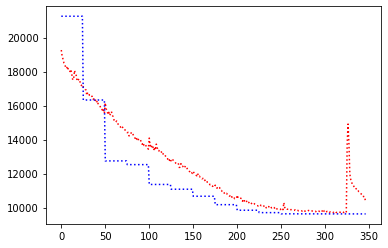

record the last path to gazebo for showing up


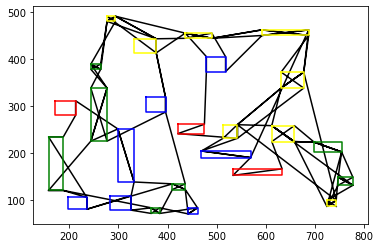

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 14., 13., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2300/2500, reward:10249.0625


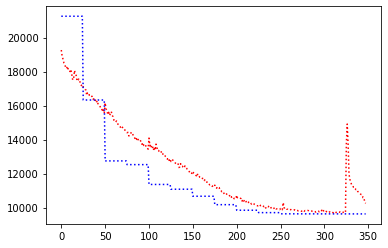

record the last path to gazebo for showing up


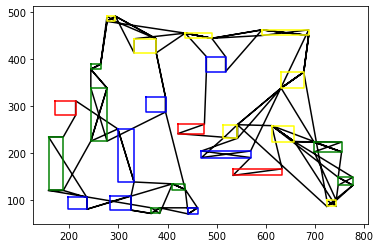

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19.,  2.,  9., 10.,  3., 16.,  4., 19.,  1.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2400/2500, reward:10215.7099609375


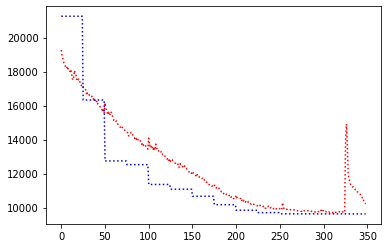

record the last path to gazebo for showing up


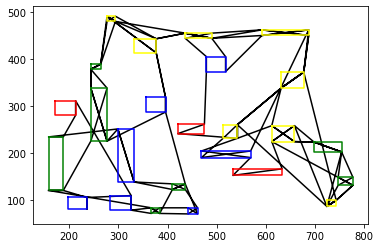

tensor([20.,  6., 13., 14., 21.,  0.,  8., 23., 20., 14., 20.,  6., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:13, batch:2500/2500, reward:10113.7548828125


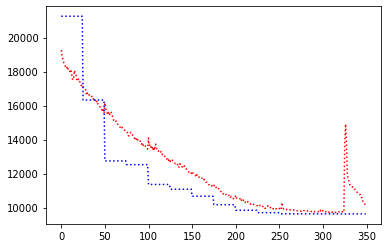

record the last path to gazebo for showing up


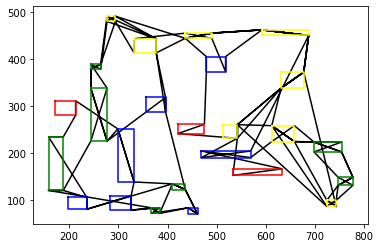

R_val =  tensor(9845.0830, device='cuda:0')
C_val =  9626.5576171875
Avg Actor 9845.0830078125 --- Avg Critic 9626.5576171875
Epoch: 13, epoch time: 157.309min, tot time: 1.526day, L_actor: 9845.083, L_critic: 9626.558, update: False
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:100/2500, reward:10113.072265625


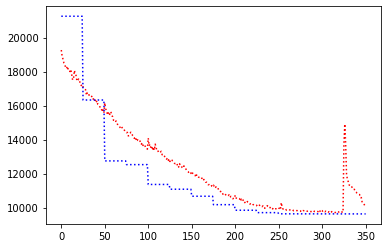

record the last path to gazebo for showing up


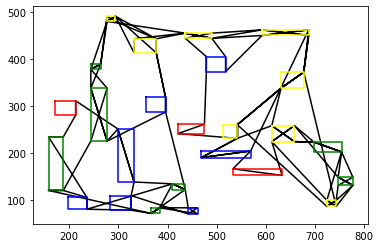

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14., 20.,  6., 13., 14.,
        23.,  8.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:200/2500, reward:10231.447265625


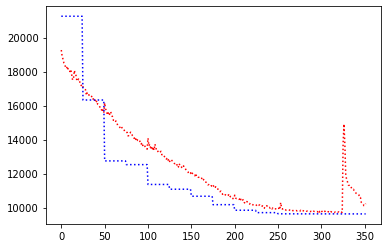

record the last path to gazebo for showing up


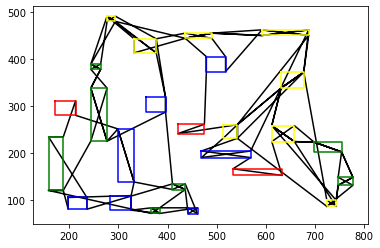

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
         7., 12., 11., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:300/2500, reward:10091.001953125


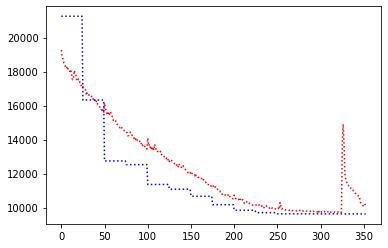

record the last path to gazebo for showing up


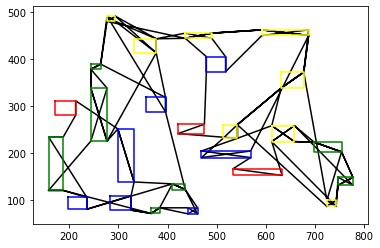

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14., 20.,  6., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8.,  6., 20., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 18., 12., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16., 19.,  4.,  3.,  4., 16., 10.,  2.,  9.,  1., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:400/2500, reward:10081.7685546875


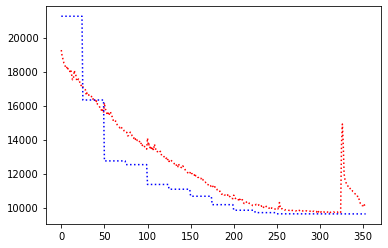

record the last path to gazebo for showing up


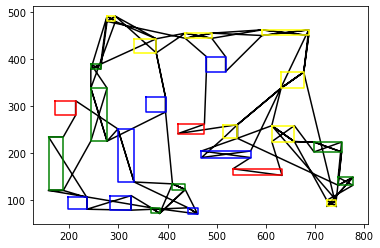

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23., 17., 22.,  5., 15.,  8., 20.,  6., 14., 13., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:500/2500, reward:10079.1943359375


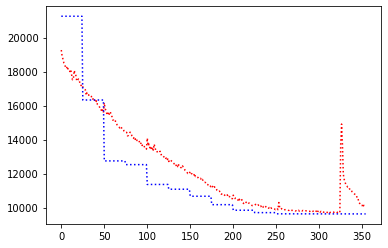

record the last path to gazebo for showing up


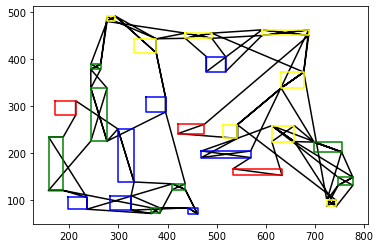

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 17., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  9.,  1.],
       device='cuda:0')
epoch:14, batch:600/2500, reward:10066.697265625


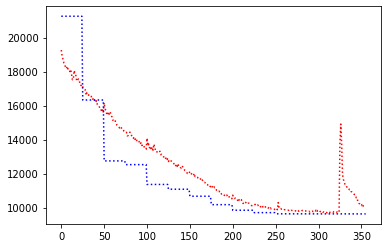

record the last path to gazebo for showing up


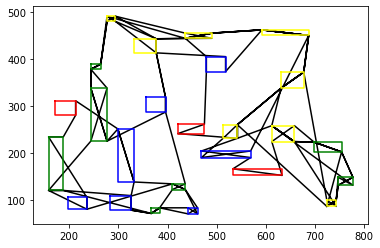

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 17., 22.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:700/2500, reward:10058.779296875


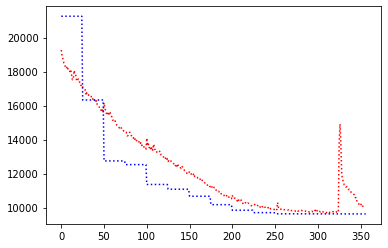

record the last path to gazebo for showing up


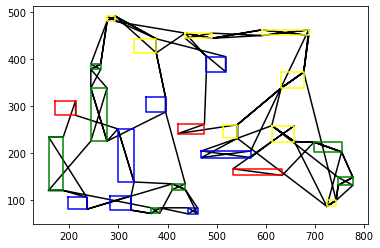

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:800/2500, reward:10037.470703125


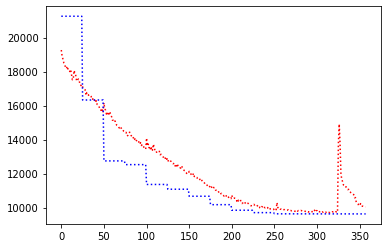

record the last path to gazebo for showing up


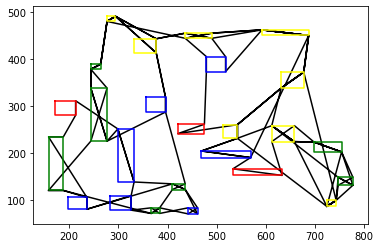

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14.,  5., 23., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 12., 18., 24., 11.,
         7., 12., 18., 24.,  9., 17.,  7.,  4.,  3., 11., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:900/2500, reward:10037.919921875


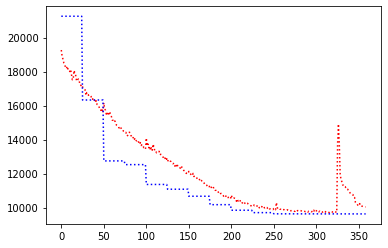

record the last path to gazebo for showing up


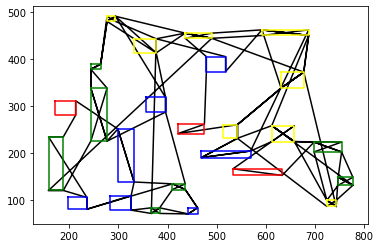

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1000/2500, reward:10006.75


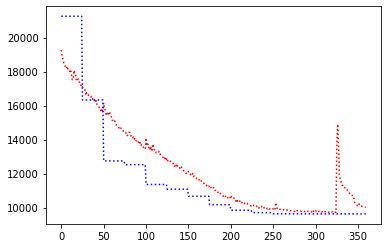

record the last path to gazebo for showing up


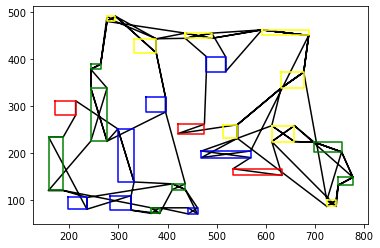

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1100/2500, reward:10061.779296875


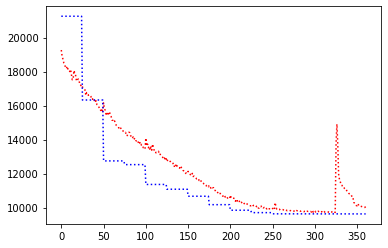

record the last path to gazebo for showing up


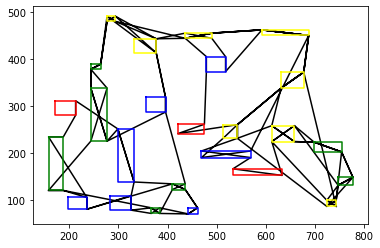

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1200/2500, reward:10008.9912109375


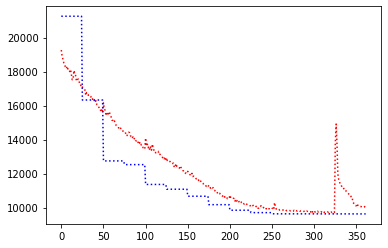

record the last path to gazebo for showing up


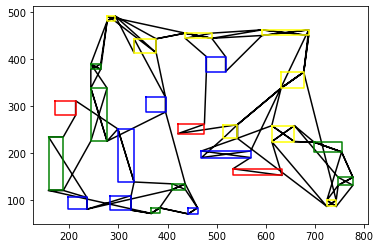

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1300/2500, reward:10021.03515625


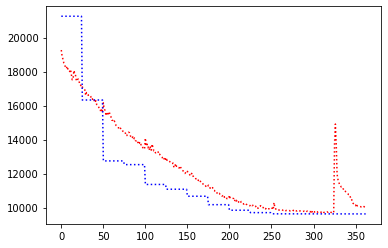

record the last path to gazebo for showing up


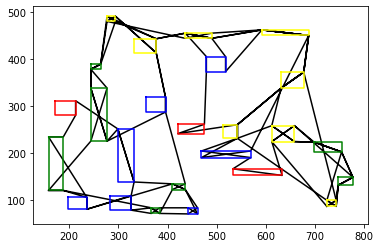

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1400/2500, reward:9952.9375


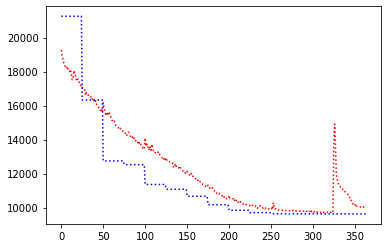

record the last path to gazebo for showing up


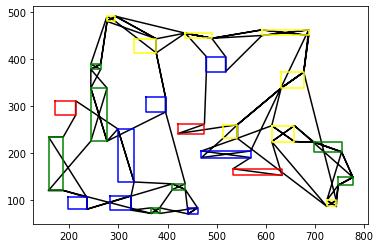

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1500/2500, reward:10054.4423828125


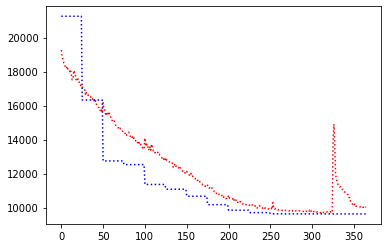

record the last path to gazebo for showing up


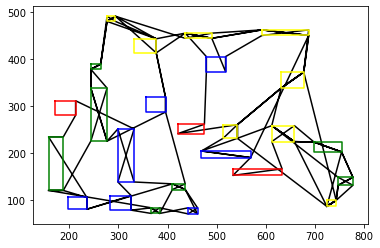

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1600/2500, reward:9975.9482421875


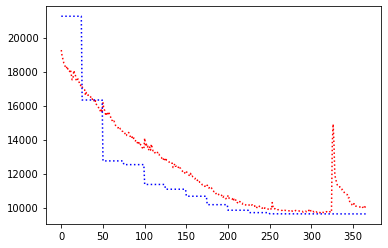

record the last path to gazebo for showing up


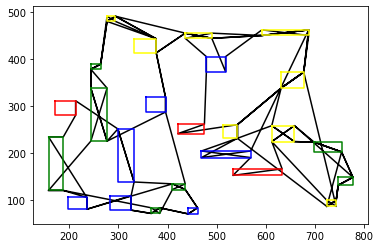

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20.,  6., 14., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1700/2500, reward:9989.283203125


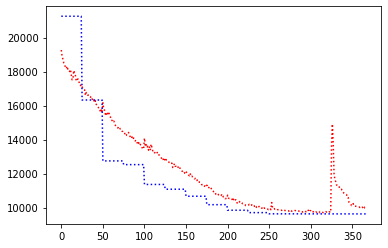

record the last path to gazebo for showing up


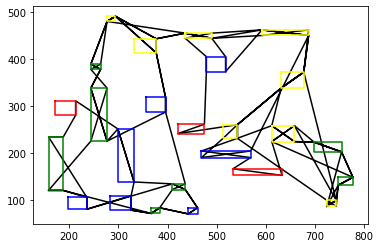

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4.,  1., 19.,  9.],
       device='cuda:0')
epoch:14, batch:1800/2500, reward:9960.5654296875


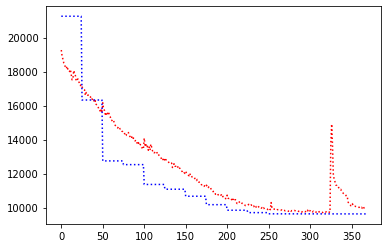

record the last path to gazebo for showing up


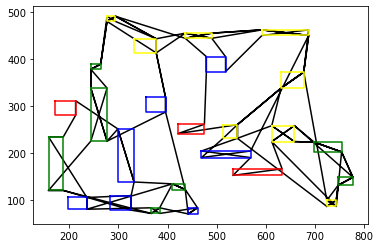

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:1900/2500, reward:9950.5419921875


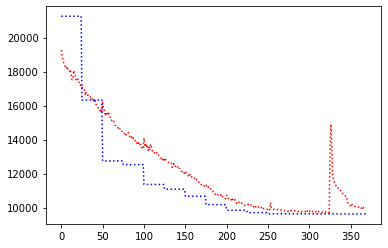

record the last path to gazebo for showing up


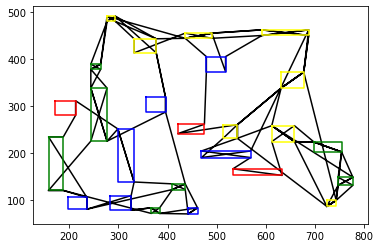

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2000/2500, reward:9995.05859375


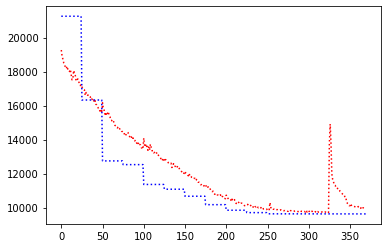

record the last path to gazebo for showing up


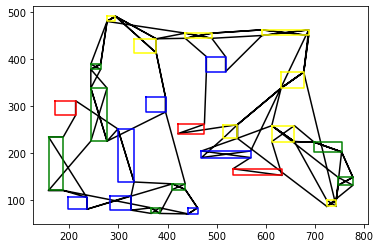

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23., 22.,  5., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2100/2500, reward:9999.79296875


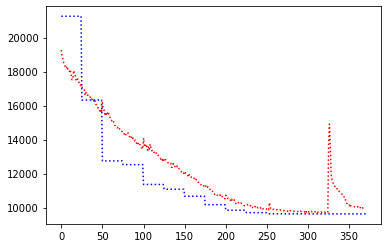

record the last path to gazebo for showing up


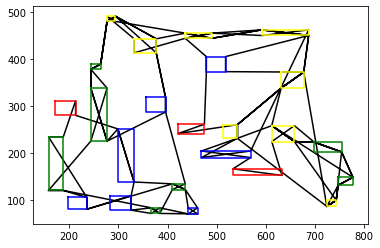

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2200/2500, reward:9972.658203125


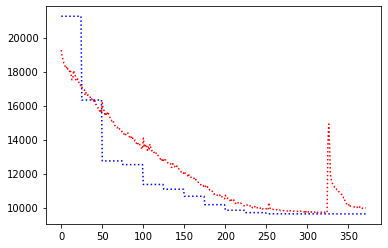

record the last path to gazebo for showing up


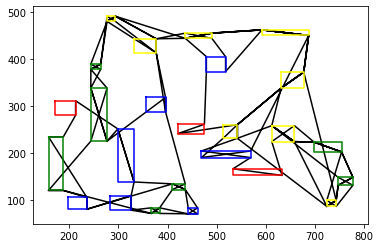

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2300/2500, reward:9977.1640625


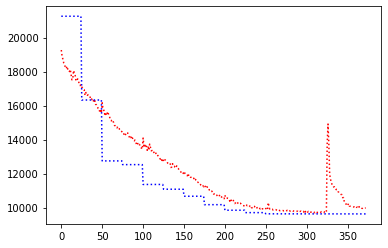

record the last path to gazebo for showing up


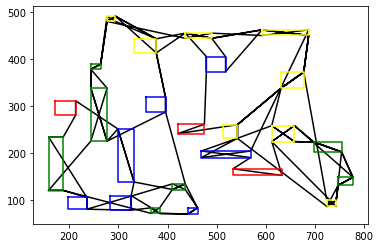

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2400/2500, reward:9959.865234375


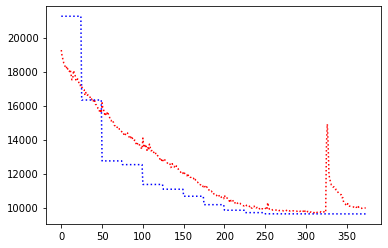

record the last path to gazebo for showing up


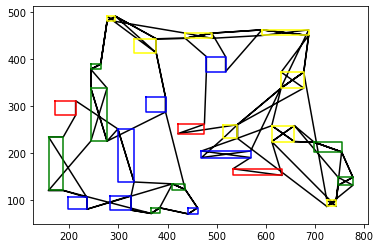

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11., 12.,  7., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:14, batch:2500/2500, reward:10003.451171875


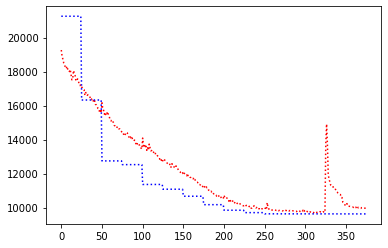

record the last path to gazebo for showing up


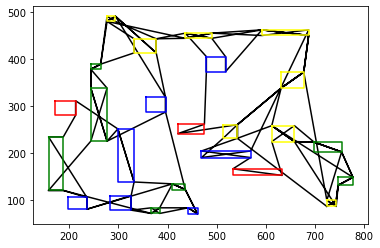

R_val =  tensor(9794.8340, device='cuda:0')
C_val =  9626.5576171875
Avg Actor 9794.833984375 --- Avg Critic 9626.5576171875
Epoch: 14, epoch time: 157.379min, tot time: 1.635day, L_actor: 9794.834, L_critic: 9626.558, update: False
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:100/2500, reward:9931.2822265625


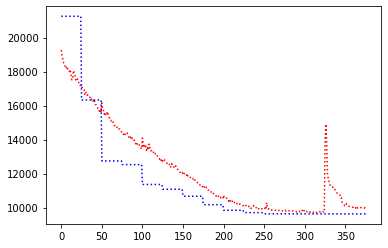

record the last path to gazebo for showing up


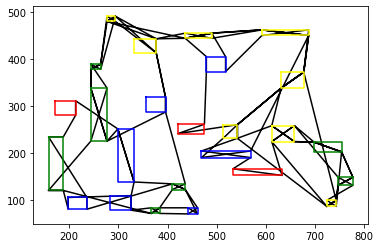

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:200/2500, reward:9953.4150390625


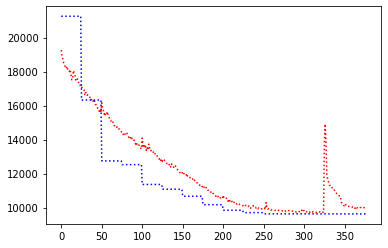

record the last path to gazebo for showing up


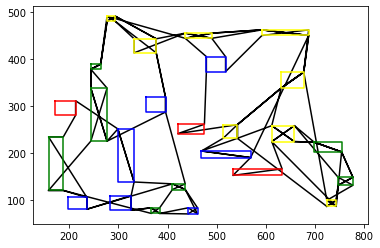

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17., 21.,  8.,  5., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:300/2500, reward:9921.125


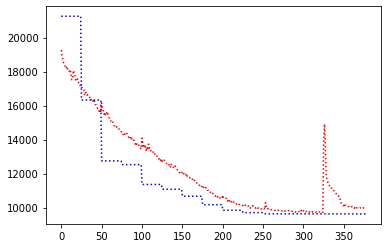

record the last path to gazebo for showing up


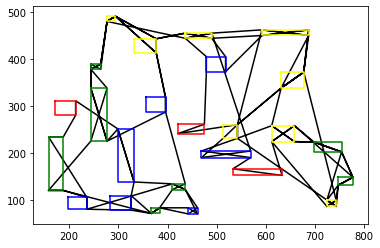

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:400/2500, reward:9926.8994140625


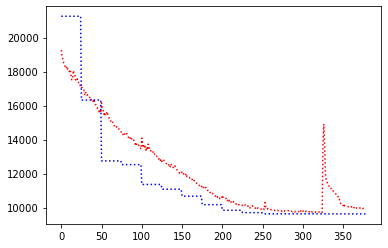

record the last path to gazebo for showing up


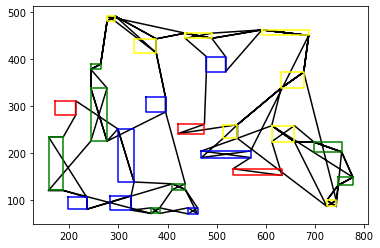

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:500/2500, reward:9908.755859375


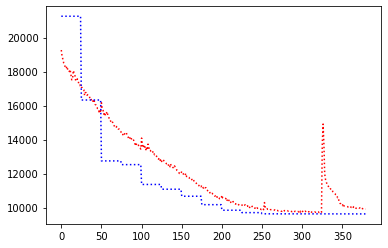

record the last path to gazebo for showing up


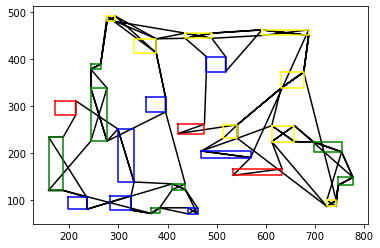

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:600/2500, reward:10166.49609375


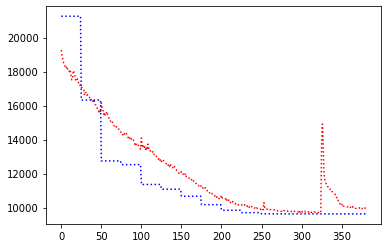

record the last path to gazebo for showing up


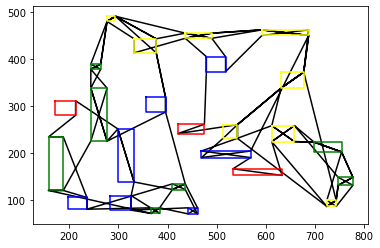

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:700/2500, reward:9932.5244140625


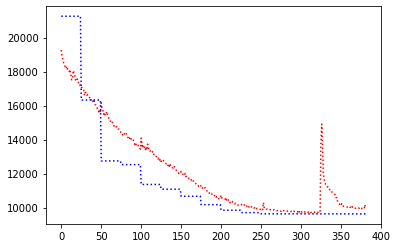

record the last path to gazebo for showing up


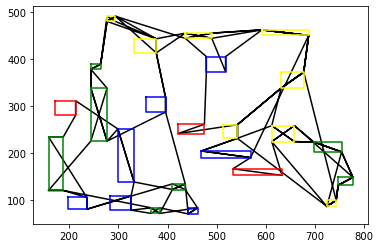

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:800/2500, reward:9907.9140625


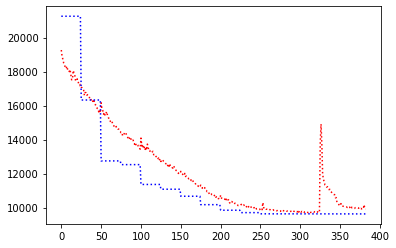

record the last path to gazebo for showing up


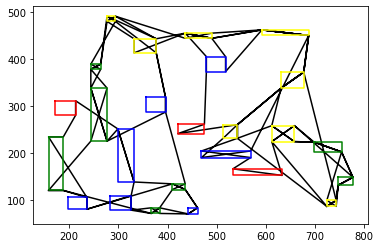

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:900/2500, reward:9916.806640625


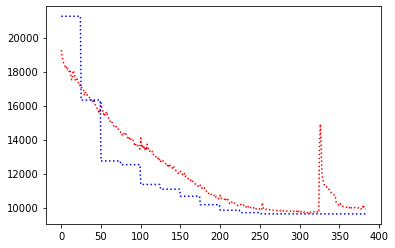

record the last path to gazebo for showing up


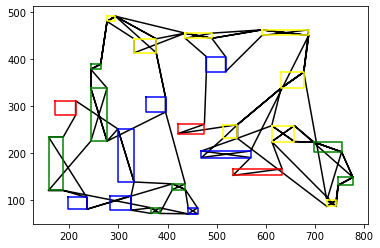

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1000/2500, reward:9977.19140625


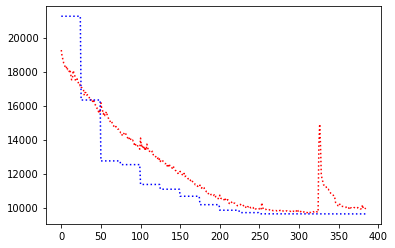

record the last path to gazebo for showing up


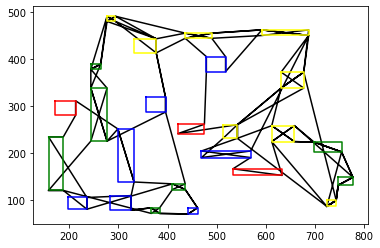

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16., 19.,  4., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1100/2500, reward:9931.650390625


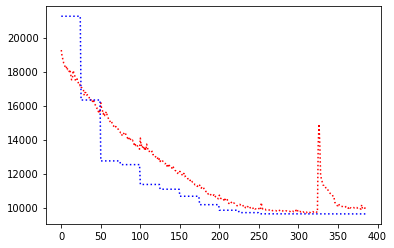

record the last path to gazebo for showing up


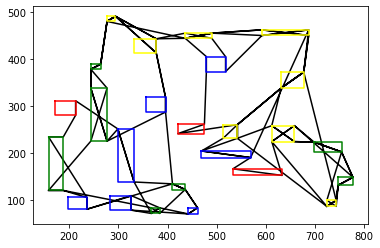

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1200/2500, reward:9945.19921875


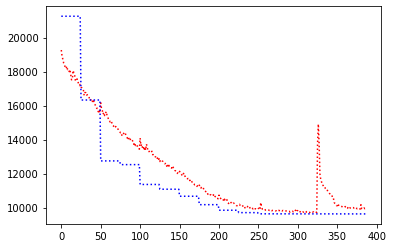

record the last path to gazebo for showing up


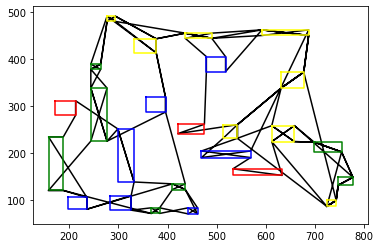

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1300/2500, reward:9897.6982421875


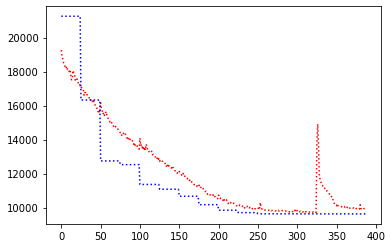

record the last path to gazebo for showing up


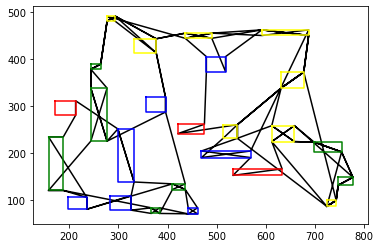

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1400/2500, reward:9968.8203125


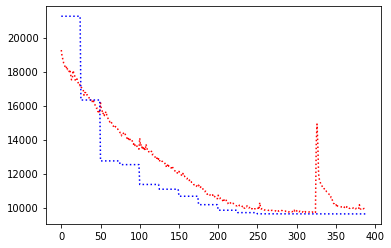

record the last path to gazebo for showing up


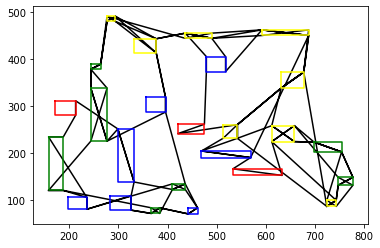

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1500/2500, reward:9902.962890625


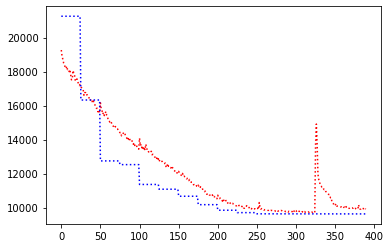

record the last path to gazebo for showing up


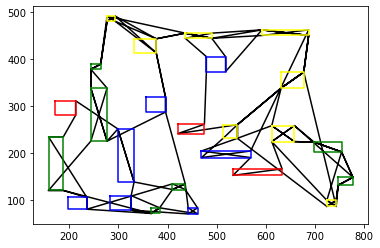

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22.,  7., 12., 17., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1600/2500, reward:9923.046875


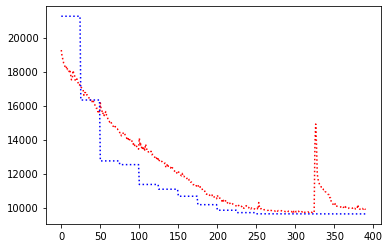

record the last path to gazebo for showing up


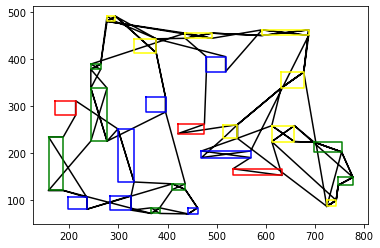

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1700/2500, reward:9922.8701171875


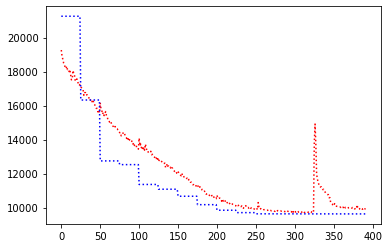

record the last path to gazebo for showing up


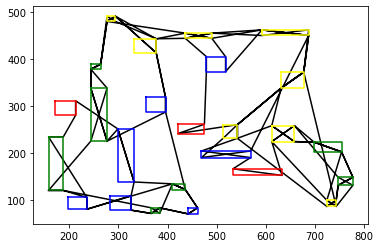

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14.,  5., 17.,  7.,
        12., 23.,  5., 17., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1800/2500, reward:9963.4697265625


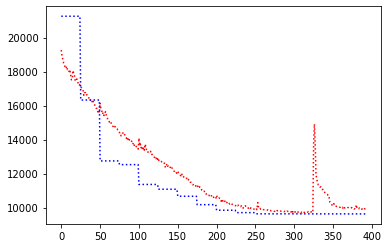

record the last path to gazebo for showing up


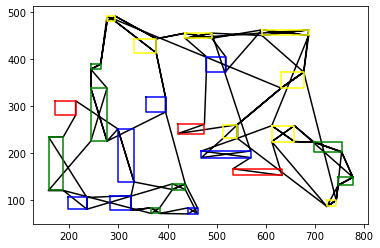

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1., 16.,  3.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:1900/2500, reward:9908.5390625


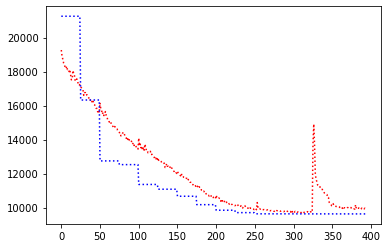

record the last path to gazebo for showing up


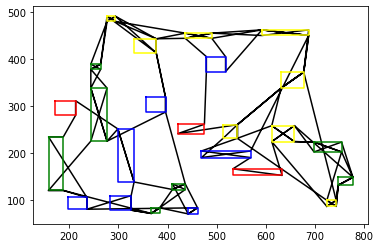

tensor([20.,  6., 13.,  0., 14., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2000/2500, reward:9916.990234375


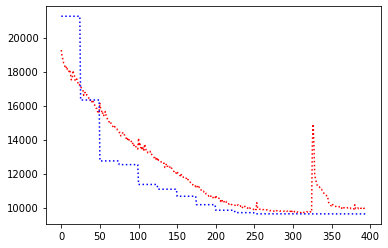

record the last path to gazebo for showing up


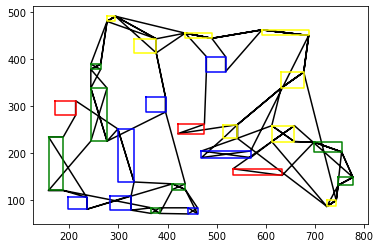

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2100/2500, reward:9915.6884765625


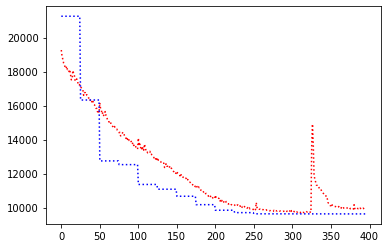

record the last path to gazebo for showing up


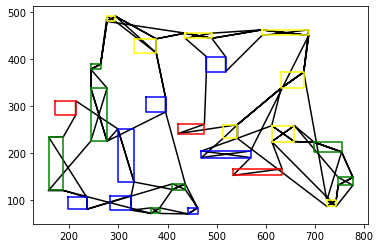

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2200/2500, reward:9909.298828125


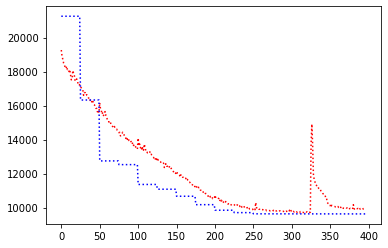

record the last path to gazebo for showing up


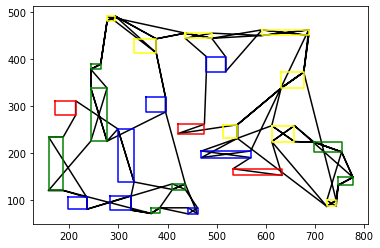

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 14., 13., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16., 19.,  4.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2300/2500, reward:9964.310546875


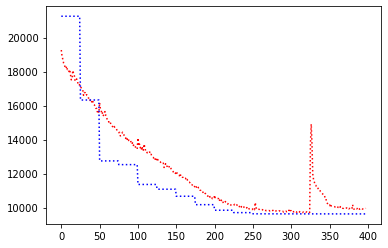

record the last path to gazebo for showing up


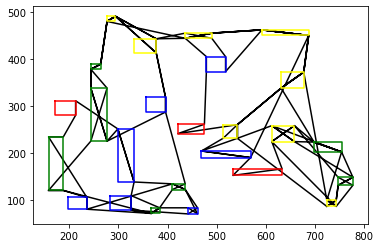

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2400/2500, reward:9896.9580078125


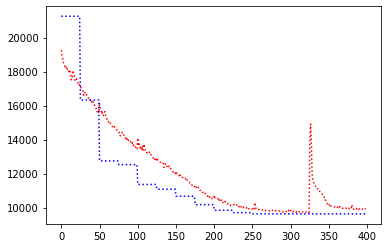

record the last path to gazebo for showing up


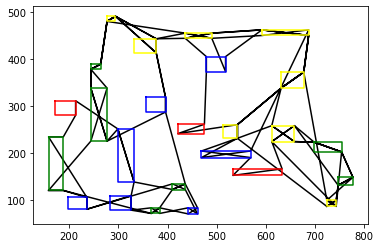

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:15, batch:2500/2500, reward:9911.93359375


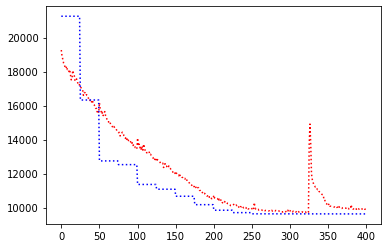

record the last path to gazebo for showing up


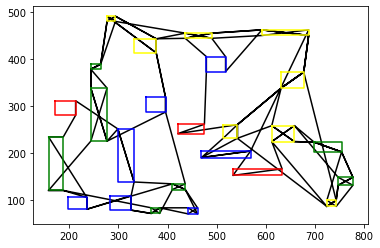

R_val =  tensor(9793.4971, device='cuda:0')
C_val =  9626.5576171875
Avg Actor 9793.4970703125 --- Avg Critic 9626.5576171875
Epoch: 15, epoch time: 158.668min, tot time: 1.746day, L_actor: 9793.497, L_critic: 9626.558, update: False
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:100/2500, reward:9902.7978515625


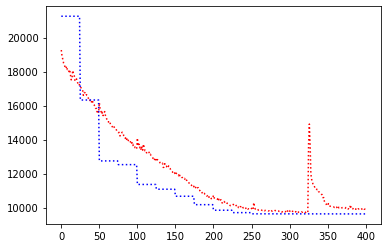

record the last path to gazebo for showing up


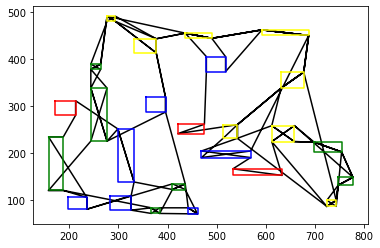

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 23.,  5., 17., 12.,
         7., 17.,  5., 14., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:200/2500, reward:9891.5087890625


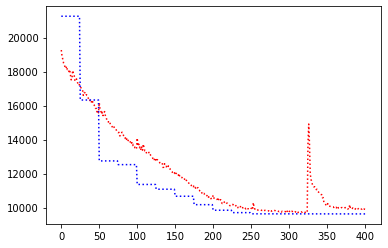

record the last path to gazebo for showing up


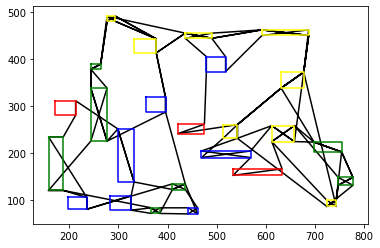

tensor([20.,  6., 13., 14.,  0.,  8., 21., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:300/2500, reward:9873.2109375


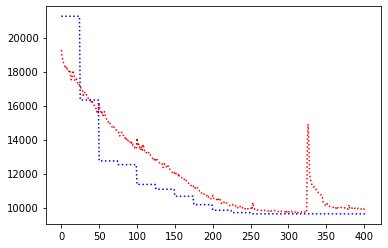

record the last path to gazebo for showing up


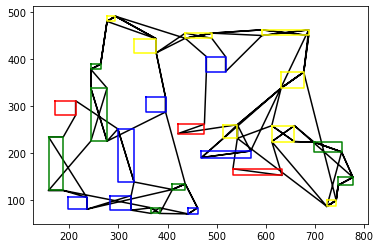

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:400/2500, reward:9858.240234375


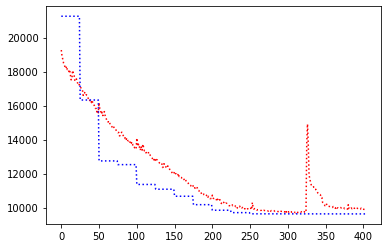

record the last path to gazebo for showing up


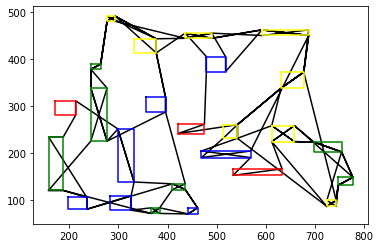

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:500/2500, reward:9873.765625


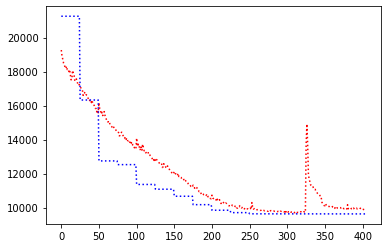

record the last path to gazebo for showing up


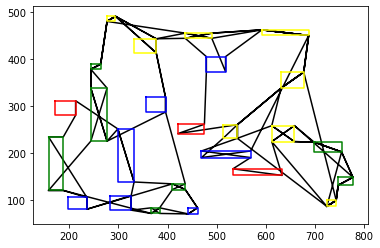

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:600/2500, reward:9894.9150390625


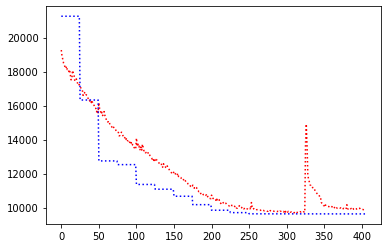

record the last path to gazebo for showing up


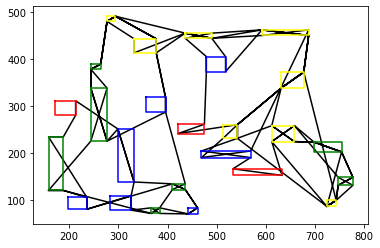

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:700/2500, reward:9888.1640625


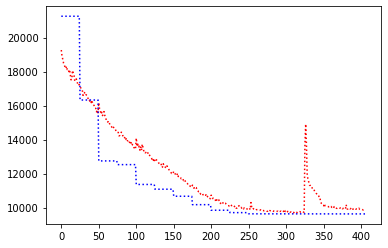

record the last path to gazebo for showing up


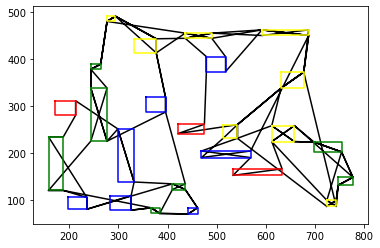

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:800/2500, reward:9870.94140625


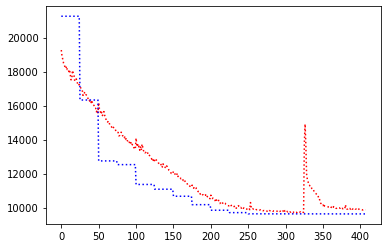

record the last path to gazebo for showing up


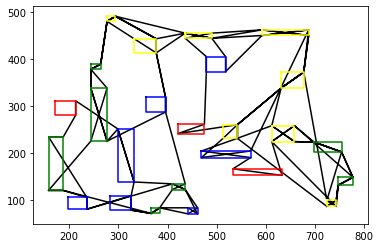

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:900/2500, reward:9858.724609375


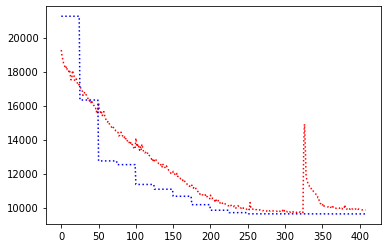

record the last path to gazebo for showing up


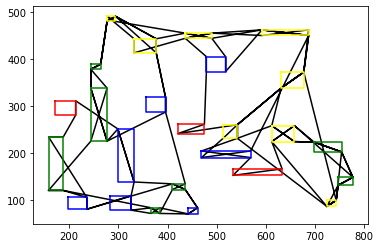

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  9.,  2.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1000/2500, reward:9918.583984375


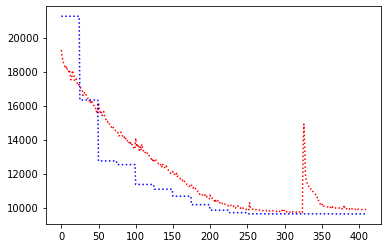

record the last path to gazebo for showing up


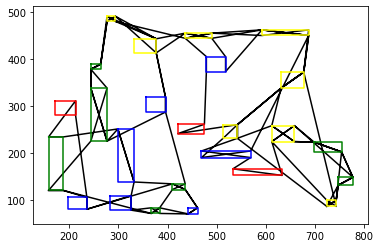

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1100/2500, reward:9856.48046875


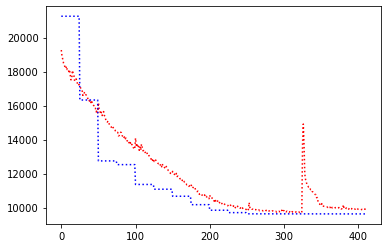

record the last path to gazebo for showing up


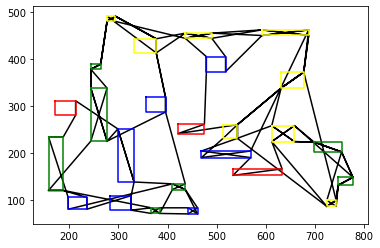

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12.,  1.,  3., 16.,
         4., 19., 10.,  2.,  9., 24., 18., 10., 19.,  3., 16.,  4.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1200/2500, reward:9896.7099609375


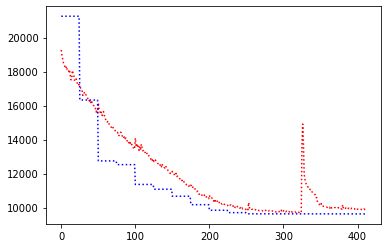

record the last path to gazebo for showing up


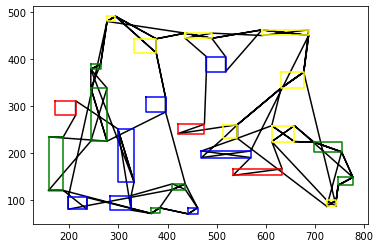

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1300/2500, reward:9920.7802734375


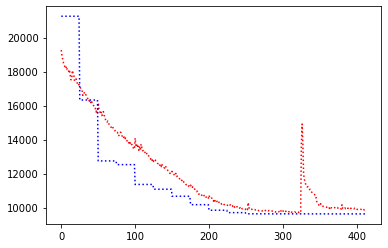

record the last path to gazebo for showing up


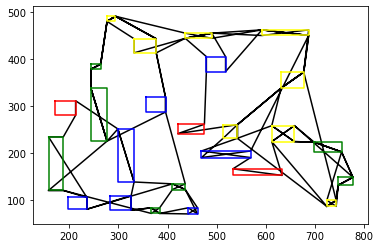

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1400/2500, reward:9906.8623046875


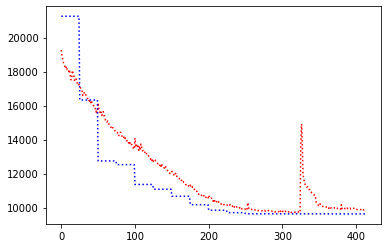

record the last path to gazebo for showing up


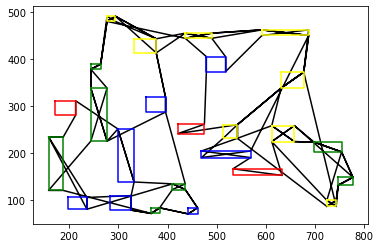

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1500/2500, reward:9891.7333984375


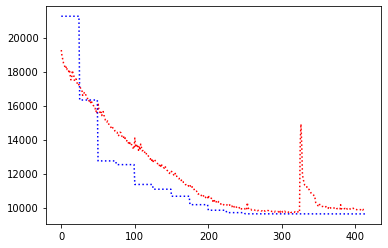

record the last path to gazebo for showing up


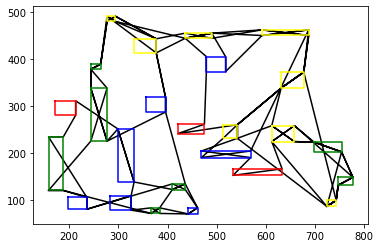

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1600/2500, reward:9878.328125


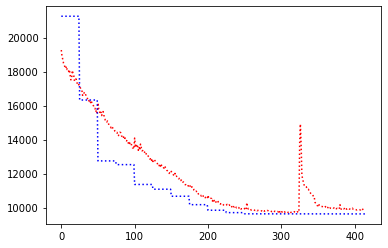

record the last path to gazebo for showing up


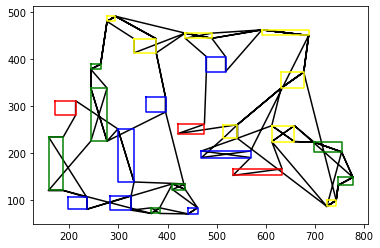

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1700/2500, reward:9860.326171875


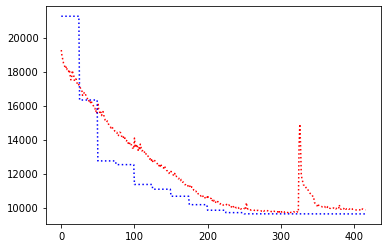

record the last path to gazebo for showing up


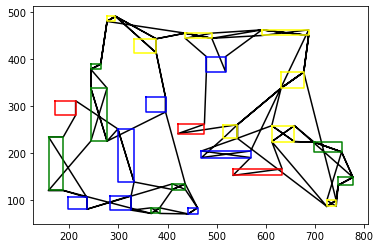

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1800/2500, reward:9854.3974609375


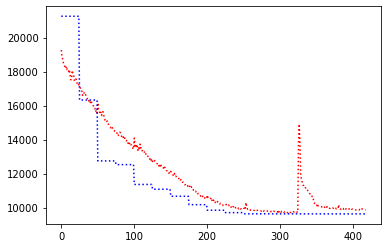

record the last path to gazebo for showing up


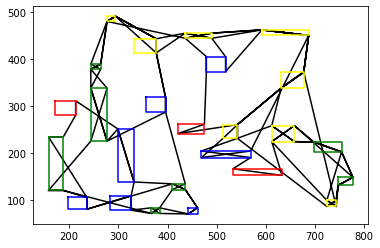

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:1900/2500, reward:9883.4921875


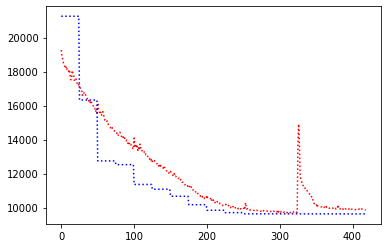

record the last path to gazebo for showing up


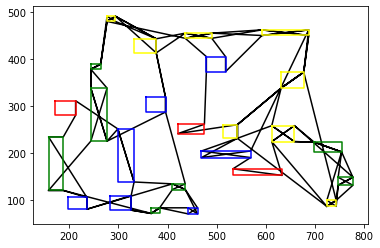

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2000/2500, reward:9912.65234375


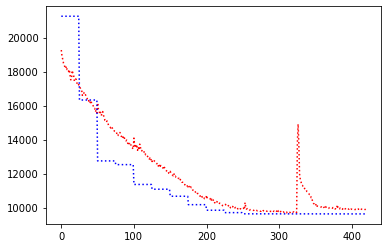

record the last path to gazebo for showing up


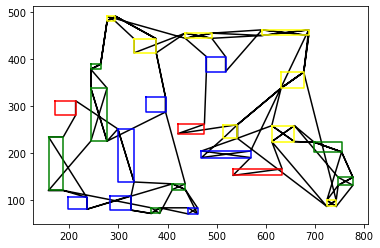

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3.,  4., 16., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2100/2500, reward:9848.13671875


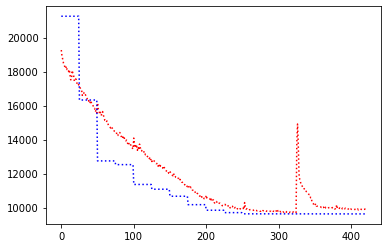

record the last path to gazebo for showing up


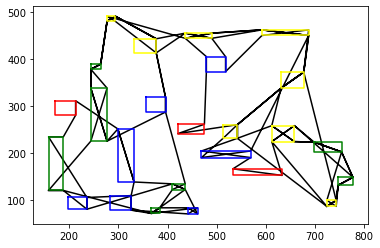

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2200/2500, reward:9857.943359375


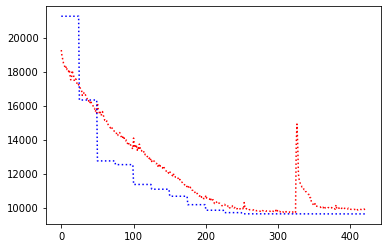

record the last path to gazebo for showing up


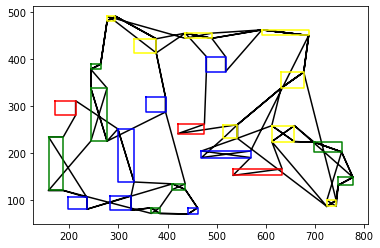

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2300/2500, reward:9872.7060546875


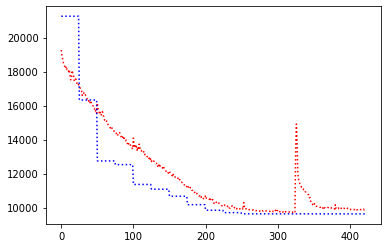

record the last path to gazebo for showing up


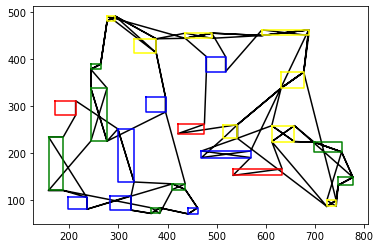

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2400/2500, reward:9878.62890625


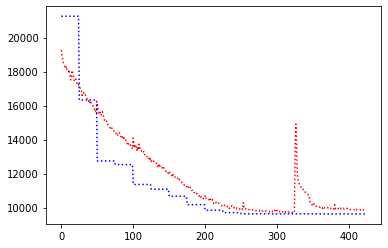

record the last path to gazebo for showing up


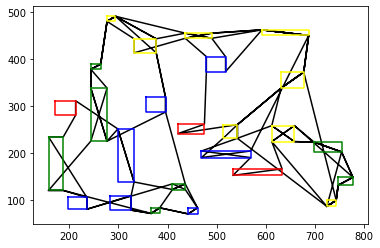

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:16, batch:2500/2500, reward:9898.16796875


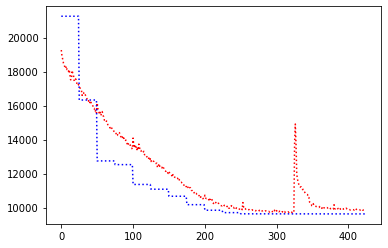

record the last path to gazebo for showing up


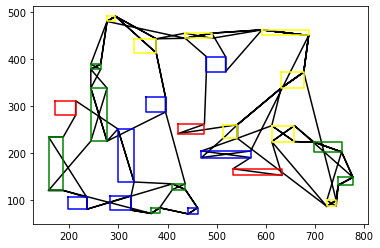

R_val =  tensor(9787.6924, device='cuda:0')
C_val =  9626.5576171875
Avg Actor 9787.6923828125 --- Avg Critic 9626.5576171875
Epoch: 16, epoch time: 157.220min, tot time: 1.855day, L_actor: 9787.692, L_critic: 9626.558, update: False
Save Checkpoints
tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:17, batch:100/2500, reward:9860.3994140625


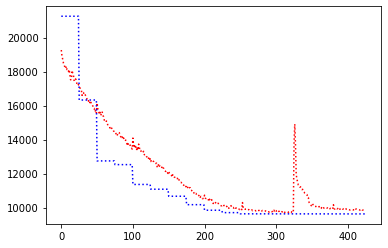

record the last path to gazebo for showing up


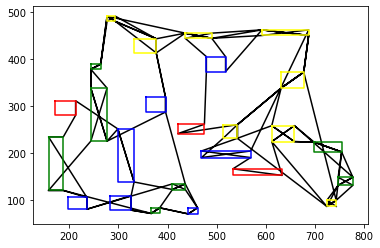

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:17, batch:200/2500, reward:9829.89453125


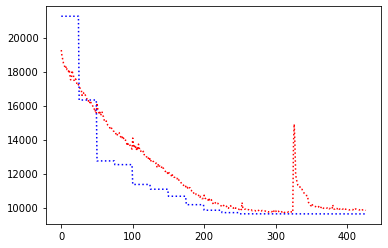

record the last path to gazebo for showing up


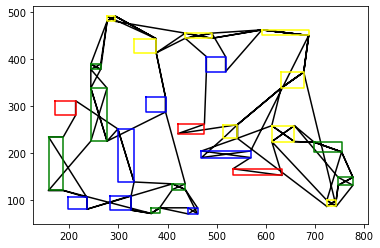

tensor([20.,  6., 13., 14.,  0., 21.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
         7., 12., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:17, batch:300/2500, reward:9863.3701171875


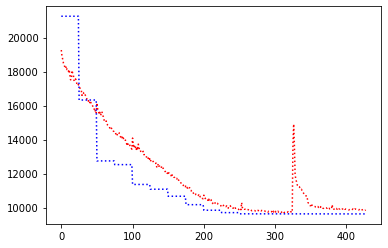

record the last path to gazebo for showing up


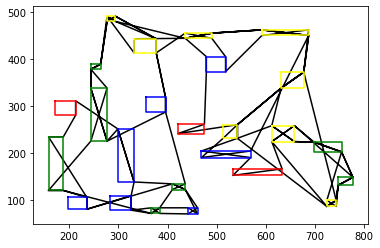

tensor([20.,  6., 13., 14., 21.,  0.,  8., 23., 20., 14.,  6., 20., 13., 14.,
         8., 23.,  5., 17., 22., 15.,  8., 20.,  6., 13., 14., 23.,  5., 17.,
        12.,  7., 17.,  5., 21.,  8., 23.,  5., 22., 17.,  7., 12., 18., 24.,
        11.,  7., 12., 18., 24.,  9.,  4.,  3., 11.,  7., 12., 18., 24., 10.,
         3., 16.,  4., 19., 10.,  2.,  9.,  1.,  3., 16.,  4., 19.,  1.,  9.],
       device='cuda:0')
epoch:17, batch:400/2500, reward:9858.3828125


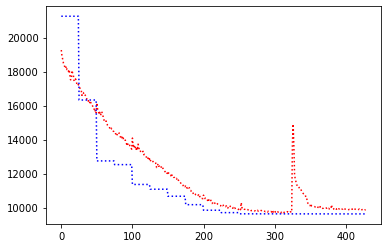

record the last path to gazebo for showing up


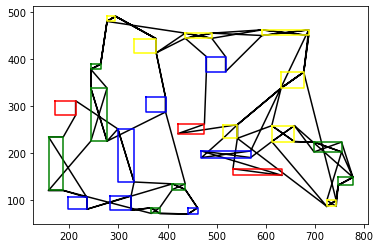

In [ ]:
import yaml
from torch.distributions.categorical import Categorical
# visualization
%matplotlib inline
import matplotlib.pyplot as plt
import warnings
from tqdm import tqdm_notebook
import torch.nn.functional as F
####### my own import file ##########
from listofpathpoint import input_handler
import cnc_input
import copy
#from hybrid_models import HPN
####### my own import file ##########
'''
so, the models we have are TransEncoderNet,
                            Attention
                            LSTM
                            HPN
each one have initial parameters and the forward part, 
once we have the forward part, the back propagation will 
finished automatically by pytorch  
'''
TOL = 1e-3
TINY = 1e-15
learning_rate = 1e-5   #learning rate
B = 128         #batch size
B_valLoop = 1
steps = 2500
n_epoch = 100       # epochs
map_number = 0
record_actor = []
record_critic = []
dimension = 3
speed_of_nozzle = 50
range_of_wait = 20
scale_of_the_map = (800,500,speed_of_nozzle*range_of_wait)

print('======================')
print('prepare to train')
print('======================')
print('Hyper parameters:')
print('learning rate', learning_rate)
print('batch size', B)
print('steps', steps)
print('epoch', n_epoch)
print('======================')

'''
instantiate a training network and a baseline network
'''


try:
    del Actor  # remove existing model
    del Critic # remove existing model
except:
    pass
Actor = HPN(n_feature = dimension, n_hidden = 128)
Critic = HPN(n_feature = dimension, n_hidden = 128)
optimizer = optim.AdamW(Actor.parameters(), lr=learning_rate)

# Putting Critic model on the eval mode
Actor = Actor.to(device)
Critic = Critic.to(device)
Critic.eval()

epoch_ckpt = 0
tot_time_ckpt = 0

val_mean = []
val_std = []
          
plot_performance_train = []
plot_performance_baseline = []
# recording the result of the resent epoch makes it available for future
#*********************# Uncomment these lines to load the previous check point
"""
checkpoint_file = "checkpoint/method2_average.pkl"
checkpoint = torch.load(checkpoint_file, map_location=device)
epoch_ckpt = checkpoint['epoch'] + 1
tot_time_ckpt = checkpoint['tot_time']
plot_performance_train = checkpoint['plot_performance_train']
plot_performance_baseline = checkpoint['plot_performance_baseline']
Critic.load_state_dict(checkpoint['model_baseline'])
Actor.load_state_dict(checkpoint['model_train'])
optimizer.load_state_dict(checkpoint['optimizer'])

print('Re-start training with saved checkpoint file={:s}\n  Checkpoint at epoch= {:d} and time={:.3f}min\n'.format(checkpoint_file,epoch_ckpt-1,tot_time_ckpt/60))

"""
#***********************# Uncomment these lines to load the previous check point

# Main training loop
# The core training concept mainly upon Sampling from the actor
# then taking the greedy action from the critic

start_training_time = time.time()
time_stamp = datetime.datetime.now().strftime("%y-%m-%d--%H-%M-%S") # Load the time stamp

C = 0       # baseline => the object which the actor can compare
R = 0       # reward
# C_critic = torch.Tensor([12000])

temp = input_handler('10&15data/25_chips/25_1.json')
X_temp, visit_count_initial, mask_list_num = temp.baseline_points()
#change the waiting time to the distance that we can measure
print(X_temp)
mapping_tool = []
for i in range(1,len(mask_list_num)):
    for j in range(mask_list_num[i]-mask_list_num[i-1]):
        mapping_tool.append(i-1)
mapping_tool = torch.FloatTensor(mapping_tool)
mapping_tool = mapping_tool.repeat_interleave(4)
mapping_tool = mapping_tool.repeat(B,1)
size = len(X_temp)
visit_count_rec = []
for i in range(0,len(visit_count_initial)):
    visit_count_rec.append(int(visit_count_initial[i]))

zero_to_bsz = torch.arange(B, device = device) # a list contains 0 to (batch size -1)

for corner in X_temp:
    corner[dimension -1] *= speed_of_nozzle
size_rec = int(size/4)
print(size_rec)
X_temp = torch.FloatTensor(X_temp)
X = X_temp.repeat(B,1,1)


if torch.cuda.is_available():
    X = X.cuda()
    mapping_tool = mapping_tool.cuda()
for epoch in range(0, n_epoch):
    # re-start training with saved checkpoint
    epoch += epoch_ckpt # adding the number of the former epochs
    # Train the model for one epoch
    start = time.time() # record the starting time
    Actor.train() 
    path_gazebo = []
#     temp = input_handler('10&15data/25_chips/25_generate'+str((epoch%B)+1)+'.json')
#     X_temp, visit_count_initial, mask_list_num = temp.baseline_points()
#     #change the waiting time to the distance that we can measure
#     print(X_temp)
#     mapping_tool = []
#     for i in range(1,len(mask_list_num)):
#         for j in range(mask_list_num[i]-mask_list_num[i-1]):
#             mapping_tool.append(i-1)
#     mapping_tool = torch.FloatTensor(mapping_tool)
#     mapping_tool = mapping_tool.repeat_interleave(4)
#     mapping_tool = mapping_tool.repeat(B,1)
#     size = len(X_temp)
#     visit_count_rec = []
#     for i in range(0,len(visit_count_initial)):
#         visit_count_rec.append(int(visit_count_initial[i]))

#     zero_to_bsz = torch.arange(B, device = device) # a list contains 0 to (batch size -1)

#     for corner in X_temp:
#         corner[dimension -1] *= speed_of_nozzle
#     size_rec = int(size/4)
#     print(size_rec)
#     X_temp = torch.FloatTensor(X_temp)
#     X = X_temp.repeat(B,1,1)


#     if torch.cuda.is_available():
#         X = X.cuda()
#         mapping_tool = mapping_tool.cuda()
    for i_all in range(1, steps+1): # 1 ~ 2500 steps
        
        # mask some points that are not the first visited points
        if torch.cuda.is_available():
            reward_recorder = torch.zeros(B,size_rec).cuda()
            idx_recorder = torch.zeros(B,size_rec).cuda()
            R = torch.zeros(B).cuda()
            logprobs = 0
            reward = torch.zeros(B).cuda()
            mask = torch.zeros(B,size).cuda() # use mask to make some points impossible to choose
        else:
            reward_recorder = torch.zeros(B,size_rec)
            idx_recorder = torch.zeros(B,size_rec)
            R = torch.zeros(B)
            logprobs = 0
            reward = torch.zeros(B)
            mask = torch.zeros(B,size) # use mask to make some points impossible to choose

        x = torch.zeros(B,dimension)# Y[:,0,:] #set the first point to x
        h = None
        c = None
        context = None        # set Y_ini to the out corner
        Transcontext = None
        Y0 = None
        # Actor Sampling phase
        for k in range(size_rec):
            #add the time passed to the time axis of nessesary points
            Y = X.view(B,size,dimension)
            #refresh the mask list, fits the present situation
            #check if all the points to be masked,if so, raise the total reward R, and check again
                
            context, Transcontext, output, h, c, _ = Actor(context,Transcontext,x=x, X_all=X,h=h,
                                                           c=c, mask=mask, if_check_u=False)
            sampler = torch.distributions.Categorical(output)
            idx = sampler.sample()
            idx_transfer = mapping_tool[zero_to_bsz,idx.data]
            idx_recorder[:,k] = idx_transfer.type(torch.long)
            
            #prepare for the back propagation of pytorch
            reward, Y0,x = rectangle_process(temp, idx,Y,Y0,mask,k,B,i_all,path_gazebo,
                                                if_actor=True)
            R += reward
            reward_recorder[:,k] = R
            logprobs += torch.log(output[zero_to_bsz, idx.data] + TINY)
        if i_all%100 ==0:
            print(idx_recorder[0])
        trajec_count = 0
        for path_time in zip(idx_recorder,reward_recorder):
            idx_time = zip(path_time[0],path_time[1])
            idx_time = sorted(idx_time, key=lambda x: x[0])
            total_idx = 0
            extra_waiting_time = 0
            for item in visit_count_rec:
                compare_list = []
                if item>1:
                    for i in range(int(item)):
                        compare_list.append(idx_time[int(total_idx + i)][1])
                    compare_list.sort(reverse=True)
                    total_idx += item
                    for i in range(len(compare_list)-1):
                        dis_step = compare_list[i] - compare_list[i+1]
                        dry_time = (range_of_wait/2)*speed_of_nozzle
                        if (dis_step) < (dry_time):
                            extra_waiting_time += dry_time - dis_step
                else:
                    total_idx += item
            R[trajec_count] += extra_waiting_time
            trajec_count+=1
            
# critic baseline phase, use the baseline to compute the actual reward of agent at that time
        if torch.cuda.is_available():
            reward_recorder = torch.zeros(B,size_rec).cuda()
            idx_recorder = torch.zeros(B,size_rec).cuda()
            C = torch.zeros(B).cuda()
            baseline = torch.zeros(B).cuda()
            mask = torch.zeros(B,size).cuda() # use mask to make some points impossible to choose
        else:
            reward_recorder = torch.zeros(B,size_rec)
            idx_recorder = torch.zeros(B,size_rec)
            C = torch.zeros(B)
            baseline = torch.zeros(B)
            mask = torch.zeros(B,size) # use mask to make some points impossible to choose
        x = torch.zeros(B,dimension)#Y[:,0,:] #set the first point to x
        h = None
        c = None
        context = None
        Transcontext = None
        C0 = None
        # compute tours for baseline without grad "Cause we want to fix the weights for the critic"
        with torch.no_grad():
            for k in range(size_rec):     
                Y = X.view(B,size,dimension)
                context, Transcontext, output, h, c, _ = Critic(context,Transcontext,x=x, X_all=X,h=h,
                                                                c=c, mask=mask, if_check_u=False)
                idx = torch.argmax(output, dim=1) # ----> greedy baseline critic
                idx_transfer = mapping_tool[zero_to_bsz,idx.data]
                idx_recorder[:,k] = idx_transfer.type(torch.long)
                # prepare for the back propagation of pytorch
                baseline, C0,x = rectangle_process(temp,idx,Y,C0, mask,k,B,i,
                                                   path_gazebo,if_actor=False)
                C += baseline
                reward_recorder[:,k] = C
                
            trajec_count = 0
            for path_time in zip(idx_recorder,reward_recorder):
                idx_time = zip(path_time[0],path_time[1])
                idx_time = sorted(idx_time, key=lambda x: x[0])
                total_idx = 0
                extra_waiting_time = 0
                for item in visit_count_rec:
                    compare_list = []
                    if item>1:
                        for i in range(int(item)):
                            compare_list.append(idx_time[int(total_idx + i)][1])
                        compare_list.sort(reverse=True)
                        total_idx += item
                        for i in range(len(compare_list)-1):
                            dis_step = compare_list[i] - compare_list[i+1]
                            dry_time = (range_of_wait/2)*speed_of_nozzle
                            if (dis_step) < (dry_time):
                                extra_waiting_time += dry_time - dis_step
                    else:
                        total_idx += item
                C[trajec_count] += extra_waiting_time
                trajec_count+=1
        ###################
        # Loss and backprop handling 
        ###################
        loss = torch.mean((R - C) * logprobs) 
#         loss = torch.mean((R - C_critic[0]) * logprobs)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        if i_all % 100 == 0:
            print("epoch:{}, batch:{}/{}, reward:{}".format(epoch, i_all, steps,R.mean().item()))
            record_actor.append(R.mean().tolist())
            record_critic.append(C.mean().tolist())
#             record_critic.append(C_critic[0].tolist())
            plt.plot(record_actor,'r:')
            plt.plot(record_critic,'b:')
            plt.show()
        if i_all % 100 == 0:
            print("record the last path to gazebo for showing up")
            #starting to show the path on simulated enviroment of cnc_machine 
            the_resent_path = temp.zig_zag_path(path_gazebo,mask_list_num)
            data = {'path':the_resent_path}
            data_1 = {'corners':path_gazebo}
            pathpoints_dir = os.path.join("pathpoints")
            if not os.path.exists(pathpoints_dir):
                os.makedirs(pathpoints_dir)
            name = 'pathpoints/path_points '+str(i)+'.yaml'
            with open(name, 'w') as file:
                documents = yaml.dump(data,file)
                documents = yaml.dump(data_1,file)
            path_gazebo = []
    time_one_epoch = time.time() - start #recording the work time of one epoch
    time_tot = time.time() - start_training_time + tot_time_ckpt
    ###################
    # Evaluate train model and baseline 
    # in this phase we just solve random instances with the actor and the critic
    # compare this soluation if we get any improvment we'll transfer the actor's
    # weights into the critic
    ###################
    # putting the actor in the eval mode
    Actor.eval()
    
    mean_tour_length_actor = 0
    mean_tour_length_critic = 0

    for step in range(0,B_valLoop):
        
        # compute tour for model and baseline
        # mask some points that are not the first visited points
        if torch.cuda.is_available():
            reward_recorder = torch.zeros(B,size_rec).cuda()
            idx_recorder = torch.zeros(B,size_rec).cuda()
            R = torch.zeros(B).cuda()
            reward = torch.zeros(B).cuda()
            mask = torch.zeros(B,size).cuda() # use mask to make some points impossible to choose

        else:
            reward_recorder = torch.zeros(B,size_rec)
            idx_recorder = torch.zeros(B,size_rec)
            R = torch.zeros(B)
            reward = torch.zeros(B)
            mask = torch.zeros(B,size) # use mask to make some points impossible to choose

        x = torch.zeros(B,dimension)# Y[:,0,:] #set the first point to x
        h = None
        c = None
        context = None        # set Y_ini to the out corner
        Transcontext = None
        Y0 = None

        with torch.no_grad():
            for k in range(size_rec):
                #add the time passed to the time axis of nessesary points
                Y = X.view(B,size,dimension)
                #same as the above part
                context, Transcontext, output, h, c, _ = Actor(context,Transcontext,x=x, 
                                                               X_all=X,h=h, c=c, mask=mask, if_check_u=False)
                idx = torch.argmax(output, dim=1)
                idx_transfer = mapping_tool[zero_to_bsz,idx.data]
                idx_recorder[:,k] = idx_transfer.type(torch.long)
                # prepare for the back propagation of pytorch
                reward, Y0,x = rectangle_process(temp, idx,Y,Y0,mask,k,B,i,path_gazebo,
                                                    if_actor=False)
                R += reward
                reward_recorder[:,k] = R
            trajec_count = 0
            for path_time in zip(idx_recorder,reward_recorder):
                idx_time = zip(path_time[0],path_time[1])
                idx_time = sorted(idx_time, key=lambda x: x[0])
                total_idx = 0
                extra_waiting_time = 0
                for item in visit_count_rec:
                    compare_list = []
                    if item>1:
                        for i in range(int(item)):
                            compare_list.append(idx_time[int(total_idx + i)][1])
                        compare_list.sort(reverse=True)
                        total_idx += item
                        for i in range(len(compare_list)-1):
                            dis_step = compare_list[i] - compare_list[i+1]
                            dry_time = (range_of_wait/2)*speed_of_nozzle
                            if (dis_step) < (dry_time):
                                extra_waiting_time += dry_time - dis_step
                    else:
                        total_idx += item
                R[trajec_count] += extra_waiting_time
                trajec_count+=1
            print('R_val = ',R[0])
        # critic baseline
        if torch.cuda.is_available():
            reward_recorder = torch.zeros(B,size_rec).cuda()
            idx_recorder = torch.zeros(B,size_rec).cuda()
            C = torch.zeros(B).cuda()
            baseline = torch.zeros(B).cuda()
            mask = torch.zeros(B,size).cuda() # use mask to make some points impossible to choose
        else:
            reward_recorder = torch.zeros(B,size_rec)
            idx_recorder = torch.zeros(B,size_rec)
            C = torch.zeros(B)
            baseline = torch.zeros(B)
            mask = torch.zeros(B,size) # use mask to make some points impossible to choose

        x = torch.zeros(B,dimension)#Y[:,0,:] #set the first point to x
        h = None
        c = None
        context = None
        Transcontext = None
        C0 = None
        
        with torch.no_grad():
            for k in range(size_rec):
                Y = X.view(B,size,dimension)
                context, Transcontext, output, h, c, _ = Critic(context,Transcontext,x=x, X_all=X,h=h,
                                                                c=c, mask=mask,if_check_u=False)
                idx = torch.argmax(output, dim=1) 
                idx_transfer = mapping_tool[zero_to_bsz,idx.data]
                idx_recorder[:,k] = idx_transfer.type(torch.long)
                # prepare for the back propagation of pytorch
                baseline, C0,x = rectangle_process(temp,idx,Y,C0, mask,k,B,i,
                                                   path_gazebo,if_actor=False)
                C += baseline
                reward_recorder[:,k] = C
            trajec_count = 0
            for path_time in zip(idx_recorder,reward_recorder):
                idx_time = zip(path_time[0],path_time[1])
                idx_time = sorted(idx_time, key=lambda x: x[0])
                total_idx = 0
                extra_waiting_time = 0
                for item in visit_count_rec:
                    compare_list = []
                    if item>1:
                        for i in range(int(item)):
                            compare_list.append(idx_time[int(total_idx + i)][1])
                        compare_list.sort(reverse=True)
                        total_idx += item
                        for i in range(len(compare_list)-1):
                            dis_step = compare_list[i] - compare_list[i+1]
                            dry_time = (range_of_wait/2)*speed_of_nozzle
                            if (dis_step) < (dry_time):
                                extra_waiting_time += dry_time - dis_step
                    else:
                        total_idx += item
                C[trajec_count] += extra_waiting_time
                trajec_count+=1
        print('C_val = ',C.mean().item())
#         C_critic = [C[0]]
#         print('C_val= ',C_critic )
        mean_tour_length_actor  += R.mean().item()
        mean_tour_length_critic += C.mean().item()

    mean_tour_length_actor  =  mean_tour_length_actor  / B_valLoop
    mean_tour_length_critic =  mean_tour_length_critic / B_valLoop
    # evaluate train model and baseline and update if train model is better

    update_baseline = mean_tour_length_actor + TOL < mean_tour_length_critic

    print('Avg Actor {} --- Avg Critic {}'.format(mean_tour_length_actor,mean_tour_length_critic))

    if update_baseline:
        Critic.load_state_dict(Actor.state_dict())
#         C_critic = [R[0]]
        print('My actor is going on the right road Hallelujah :) Updated')
    ###################
    # Valdiation train model and baseline on 1k random TSP instances
    ###################
    # erased by daniel due to the 1K tsp is not the scale I want to train  

    # For checkpoint
    plot_performance_train.append([(epoch+1), mean_tour_length_actor])
    plot_performance_baseline.append([(epoch+1), mean_tour_length_critic])
    # compute the optimally gap ==> this is interesting because there is no LKH or other optimal algorithms 
    # for the problem like this rectangle characterized map
    mystring_min = 'Epoch: {:d}, epoch time: {:.3f}min, tot time: {:.3f}day, L_actor: {:.3f}, L_critic: {:.3f}, update: {}'.format(
        epoch, time_one_epoch/60, time_tot/86400, mean_tour_length_actor, mean_tour_length_critic, update_baseline)

    print(mystring_min)
    print('Save Checkpoints')

    # Saving checkpoint
    checkpoint_dir = os.path.join("checkpoint")

    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)
    
    torch.save({
        'epoch': epoch,
        'time': time_one_epoch,
        'tot_time': time_tot,
        'loss': loss.item(),
        'plot_performance_train': plot_performance_train,
        'plot_performance_baseline': plot_performance_baseline,
        'model_baseline': Critic.state_dict(),
        'model_train': Actor.state_dict(),
        'optimizer': optimizer.state_dict(),
        },'{}.pkl'.format(checkpoint_dir + "/checkpoint_" + time_stamp + "-n{}".format(size) + "-gpu{}".format(gpu_id)))


  




                
            
                
        
                        

In [ ]:
import torch
index = int(9.34)
table = [[1,2],[3,4]]
table_1 = [[3,44],[5,6]]
table = torch.as_tensor(table)
table_1 = torch.as_tensor(table_1)
result = torch.maximum(table_1[:,0],table_1[:,1])
print(result)            record_critic.append(C_critic[0].tolist())


In [ ]:
import torch
t = torch.ones(10,3,2)
t[:,:,0] +=2
print(t)



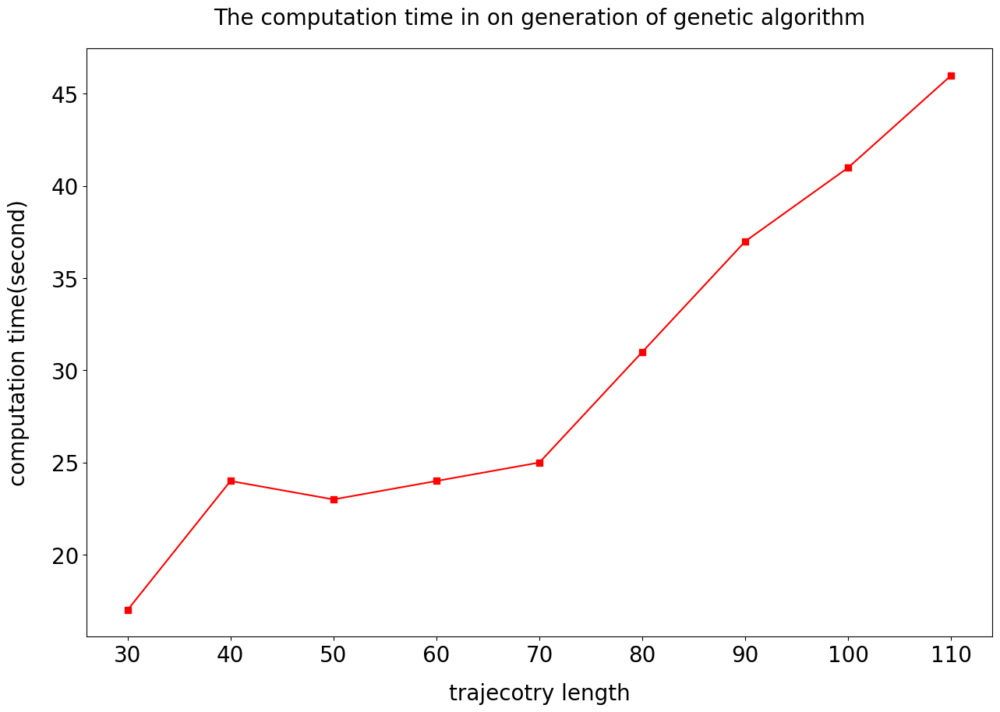

In [10]:
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
sequence = [30,40,50,60,70,80,90,100,110]
generation_time = [17,24,23,24,25,31,37,41,46]
plt.figure(figsize=(15,10),dpi=100,linewidth = 2)
plt.title("The computation time in on generation of genetic algorithm",fontsize=20, x=0.5, y=1.03)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.plot(sequence,generation_time,'s-',color = 'r')
plt.xlabel("trajecotry length", fontsize=20, labelpad = 15)
plt.ylabel("computation time(second)", fontsize=20, labelpad = 20)
plt.show()